In [1]:
%pylab nbagg
#%matplotlib inline
#%matplotlib widget

Populating the interactive namespace from numpy and matplotlib


In [2]:
import numpy as np
import matplotlib.pyplot as plt   

from sklearn.decomposition import FastICA
from sklearn.decomposition import PCA

from mpl_toolkits import mplot3d

import scipy
import scipy.io as io
from scipy import stats
from scipy import signal as sig
from scipy.signal import argrelextrema
from scipy import signal


#import importlib
#import Time_delay_embedding
#importlib.reload(Time_delay_embedding)

#import AAL_Atlas_ordclu as AAL
#import Preprocess_Signal as PPS
#import Time_delay_embedding as TDE

import pickle
import scipy.io
import h5py

def save_obj(obj, name ):
    with open('/Users/giovanni/Desktop/Neuro/Pierpaolo-MEG/HigherOrder/'+ name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

def load_obj(name ):
    with open('/Users/giovanni/Desktop/Neuro/Pierpaolo-MEG/ArticleResults_I_py2/' + name + '.pkl', 'rb') as f:
        return pickle.load(f)

ModuleNotFoundError: No module named 'h5py'

In [18]:
import math

def divisorGenerator(n):
    large_divisors = []
    for i in range(1, int(math.sqrt(n) + 1)):
        if n % i == 0:
            yield i
            if i*i != n:
                large_divisors.append(n / i)
    for divisor in reversed(large_divisors):
        yield divisor

In [19]:
def transprob(aval): #(t,r)
    mat=np.zeros((nregions,nregions))
    norm=np.sum(aval,axis=0)
    for t in range(len(aval)-1):
        ini=np.where(aval[t]==1)
        mat[ini]+=aval[t+1]
    mat[norm!=0]=mat[norm!=0]/norm[norm!=0][:,None]
    return mat

def Transprob(ZBIN): #(t,r)
    mat=np.zeros((nregions,nregions))
    A=np.sum(ZBIN,axis=1)
    a=np.arange(len(ZBIN))
    idx = np.where(A!=0)[0]
    aout = np.split(a[idx],np.where(np.diff(idx)!=1)[0]+1)
    ifi=0
    for iaut in range(len(aout)):
        if len(aout[iaut])>2:
            mat+=transprob(ZBIN[aout[iaut]])
            ifi+=1
    mat=mat/ifi
    return mat 

In [20]:
def go_avalanches(data,thre=3.,direc=0,binsize=1):
    if direc==1:
        Zb=np.where(stats.zscore(data)>thre,1,0)
    elif direc==-1:
        Zb=np.where(stats.zscore(data)<-thre,1,0)
    elif direc==0:
        Zb=np.where(np.abs(stats.zscore(data))>thre,1,0)
    else:
        print('wrong direc')
    
    nregions=len(data[0])

    Zbin=np.reshape(Zb,(-1,binsize,nregions))
    Zbin=np.where(np.sum(Zbin,axis=1)>0,1,0)

    dfb_ampl=np.sum(Zbin,axis=1).astype(float)
    dfb_a=dfb_ampl[dfb_ampl!=0]
    bratio=np.exp(np.mean(np.log(dfb_a[1:]/dfb_a[:-1])))
    NoAval=np.where(dfb_ampl==0)[0]
    
    inter=np.arange(1,len(Zbin)+1); inter[NoAval]=0
    Avals_ranges=consecutiveRanges(inter)
    Avals_ranges=Avals_ranges[1:-1] #remove the first and last avalanche for avoiding boundary effects
    
    Naval=len(Avals_ranges)   #number of avalanches
    Avalanches={'dur':[],'siz':[],'ranges':Avals_ranges,'Zbin':Zbin,'bratio':bratio} #duration and size
    for i in range(Naval):
        xi=Avals_ranges[i][0];xf=Avals_ranges[i][1]
        Avalanches['dur'].append(xf-xi)
        Avalanches['siz'].append(len(np.where(np.sum(Zbin[xi:xf],axis=0)>0)[0]))
        
    return Avalanches

def consecutiveRanges(a):
    n=len(a)
    length = 1;list = []
    if (n == 0):
        return list
    for i in range (1, n + 1):
        if (i == n or a[i] - a[i - 1] != 1):
            if (length > 0):
                if (a[i - length]!=0):
                    temp = (a[i - length]-1, a[i - 1])
                    list.append(temp)
            length = 1        
        else:
            length += 1
    return list

def Extract(lst): 
    return list(list(zip(*lst))[0]) 

def Extract_end(lst): 
    return list(list(zip(*lst))[1]) 

# DATASET EXTRACTION

In [21]:
#remove suject 11,15,20
subjects = ['43','39','38','35','34','29','26','21','20','19','18','17','15','13','9','8','6','5']
Nsubs=44
subject='1'
nregions=90
#original sampling at 1024 Hz. Data downsampled to 256 Hz.
f_MEG=1024
Tlen=160*f_MEG

nedges=int(nregions**2/2-nregions/2)

iTriup= np.triu_indices(nregions,k=1)  #nedges=len(iTriup[0])

#Edge to Nodes
dic={}
for e in range(nedges):
    dic['%d'%e]=[iTriup[0][e],iTriup[1][e]]

In [22]:
#path='/Users/giovanni/Desktop/Neuro/Pierpaolo-MEG/'
path='D:GIOVANNI/'
tempi = scipy.io.loadmat(path+'tempi_pz_melbourne.mat')

In [23]:
f = h5py.File(path+'serie_Melbourne.mat','r')
struArray = f['D']

In [24]:
data={}
for i in range(Nsubs):
    data['%d'%i]=np.swapaxes(f[struArray[i, 0]][:nregions,:],0,1)

In [25]:
len(data)

44

In [26]:
data[subject].shape

(92060, 90)

In [27]:
from scipy.ndimage import gaussian_filter1d
Avalanches_human=go_avalanches(data[subject],thre=3,direc=0,binsize=1)
Mag=np.mean(Avalanches_human['Zbin'],axis=1)

In [28]:
Avalanches_human.keys()

dict_keys(['dur', 'siz', 'ranges', 'Zbin', 'bratio'])

In [29]:
Avalanches_human['Zbin'].shape

(92060, 90)

In [30]:
data.keys()

dict_keys(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43'])

In [33]:
avalanches_bin = []
avalanches_sum = []
for subject in subjects:
    Avalanches_human=go_avalanches(data[subject],thre=3,direc=0,binsize=1)
    Mag=np.mean(Avalanches_human['Zbin'],axis=1)
    out=[[] for i in range(len(Avalanches_human['ranges']))]
    out_sum=[[] for i in range(len(Avalanches_human['ranges']))]
    for kk1 in range(len(Avalanches_human['ranges'])):
        begin = Avalanches_human['ranges'][kk1][0]
        end = Avalanches_human['ranges'][kk1][1]
        sum_kk = np.sum(Avalanches_human['Zbin'][begin:end,:],0)
        out_sum[kk1] = sum_kk
        out[kk1]= np.zeros(nregions)
        out[kk1][np.where(sum_kk>=1)]=1

    avalanches_bin.append(np.concatenate([out],axis=1))
    avalanches_sum.append(np.concatenate([out_sum],axis=1))
    out = np.concatenate([out],axis=1)
    out_sum = np.concatenate([out_sum],axis=1)
#avalanches_sum = np.concatenate(avalanches_sum)
#avalanches_bin = np.concatenate(avalanches_bin)

In [34]:
len(avalanches_sum)

18

In [26]:
io.savemat('subject_'+str(subject)+'.mat',{'source_reconstruction_MEG':data,'avalanches_binarize':out,'avalanches_sum':out_sum})

In [27]:
out[0]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
       0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.])

In [7]:
import phate
import scipy.spatial
jaccard = scipy.spatial.distance.jaccard
from sklearn.cluster import KMeans
import os

In [ ]:
# for knn_dist in ['cosine','euclidean',jaccard]:
#     for mds_dist in ['euclidean','cosine']:
#         for n_components in range(2,6):
#             for n_pca in [5,10,15]:
#                 for gamma in [-1.0,0.0,1.0]:
#                     if knn_dist != 'cosine' and  knn_dist != 'euclidean':
#                         knn_dist_name='jaccard'
#                     else:
#                         knn_dist_name=knn_dist
#                     if not os.path.exists("test_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy"):
#                         phate_operator = phate.PHATE(n_components=n_components, n_jobs=-2, decay=1.0,  n_pca=n_pca, gamma=gamma, knn=5, knn_dist=knn_dist, mds_dist=mds_dist )
#                         Y_phate = phate_operator.fit_transform(out)
#                         np.save("test_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy",Y_phate)

Calculating PHATE...
  Running PHATE on 3182 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.12 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 0.34 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 9716 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 0.68 seconds.
  Calculated graph and diffusion operator in 1.21 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 1.59 seconds.
    Calculating KMeans...
    Calculated KMeans in 9.00 seconds.
  Calculated landmark operator in 12.29 seconds.
  Calculating optimal t...
    Automatically selected t = 16
  Calculated optimal t in 1.57 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.33 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.84 seconds.
Calculated PHATE in 20.24 seconds.
Calculating PHATE...
  Running PHATE on 3182 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.02 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 0.33 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 8006 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 0.68 seconds.
  Calculated graph and diffusion operator in 1.10 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 1.62 seconds.
    Calculating KMeans...


In [24]:
knn_dist = 'cosine'
mds_dist = 'cosine'
knn_dist_name=knn_dist
for n_components in range(2,6):
    for n_pca in [5]:
        for gamma in [-1.0,0.0,1.0]:
            if not os.path.exists("all_subject_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy"):
                phate_operator = phate.PHATE(n_components=n_components, n_jobs=-2, decay=1.0,  n_pca=n_pca, gamma=gamma, knn=5, knn_dist=knn_dist, mds_dist=mds_dist )
                Y_phate = phate_operator.fit_transform(avalanches_bin)
                np.save("all_subject_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy",Y_phate)


Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.47 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 123.96 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 293292 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 224.21 seconds.
  Calculated graph and diffusion operator in 354.82 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 126.47 seconds.
    Calculating KMeans...
    Calculated KMeans in 30.15 seconds.
  Calculated landmark operator in 163.10 seconds.
  Calculating optimal t...
    Automatically selected t = 20
  Calculated optimal t in 3.20 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 1.13 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 55.64 seconds.
Calculated PHATE in 577.98 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.55 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 132.72 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 339555 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 213.01 seconds.
  Calculated graph and diffusion operator in 352.76 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 116.10 seconds.
    Calculating KMeans...
    Calculated KMeans in 21.59 seconds.
  Calculated landmark operator in 143.18 seconds.
  Calculating optimal t...
    Automatically selected t = 18
  Calculated optimal t in 2.31 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.54 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 28.38 seconds.
Calculated PHATE in 527.27 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.55 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 121.26 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 318054 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 214.14 seconds.
  Calculated graph and diffusion operator in 342.09 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 117.87 seconds.
    Calculating KMeans...
    Calculated KMeans in 21.21 seconds.
  Calculated landmark operator in 144.47 seconds.
  Calculating optimal t...
    Automatically selected t = 20
  Calculated optimal t in 2.33 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.57 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 8.87 seconds.
Calculated PHATE in 498.39 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.53 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 124.38 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 301457 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 217.56 seconds.
  Calculated graph and diffusion operator in 348.60 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 112.82 seconds.
    Calculating KMeans...
    Calculated KMeans in 20.47 seconds.
  Calculated landmark operator in 138.64 seconds.
  Calculating optimal t...
    Automatically selected t = 21
  Calculated optimal t in 2.29 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.61 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 76.09 seconds.
Calculated PHATE in 566.32 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.56 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 121.98 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 292093 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 211.44 seconds.
  Calculated graph and diffusion operator in 339.71 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 113.15 seconds.
    Calculating KMeans...
    Calculated KMeans in 20.13 seconds.
  Calculated landmark operator in 138.67 seconds.
  Calculating optimal t...
    Automatically selected t = 21
  Calculated optimal t in 2.43 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.67 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 53.89 seconds.
Calculated PHATE in 535.44 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.51 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 121.50 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 310600 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 211.73 seconds.
  Calculated graph and diffusion operator in 339.22 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 113.46 seconds.
    Calculating KMeans...
    Calculated KMeans in 21.51 seconds.
  Calculated landmark operator in 141.14 seconds.
  Calculating optimal t...
    Automatically selected t = 21
  Calculated optimal t in 2.33 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.69 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 14.10 seconds.
Calculated PHATE in 497.56 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.54 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 124.34 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 304797 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 215.16 seconds.
  Calculated graph and diffusion operator in 345.80 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 124.40 seconds.
    Calculating KMeans...
    Calculated KMeans in 22.47 seconds.
  Calculated landmark operator in 153.23 seconds.
  Calculating optimal t...
    Automatically selected t = 23
  Calculated optimal t in 2.42 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.87 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 77.14 seconds.
Calculated PHATE in 579.54 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.55 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 133.58 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 299068 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 226.89 seconds.
  Calculated graph and diffusion operator in 367.03 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 113.33 seconds.
    Calculating KMeans...
    Calculated KMeans in 20.30 seconds.
  Calculated landmark operator in 140.55 seconds.
  Calculating optimal t...
    Automatically selected t = 23
  Calculated optimal t in 2.40 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.81 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 38.66 seconds.
Calculated PHATE in 549.54 seconds.
Calculating PHATE...
  Running PHATE on 61688 observations and 90 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.51 seconds.
    Calculating KNN search...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:233: UserWarning: Metric cosine not valid for `sklearn.neighbors.BallTree`. Graph instantiation may be slower than normal.
  warnings.warn(


    Calculated KNN search in 120.79 seconds.
    Calculating affinities...


C:\Users\ppsor\anaconda3\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 327587 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


    Calculated affinities in 213.93 seconds.
  Calculated graph and diffusion operator in 341.73 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 113.22 seconds.
    Calculating KMeans...
    Calculated KMeans in 20.69 seconds.
  Calculated landmark operator in 139.46 seconds.
  Calculating optimal t...
    Automatically selected t = 21
  Calculated optimal t in 2.43 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.69 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 7.18 seconds.
Calculated PHATE in 491.57 seconds.


In [ ]:
#phate_operator = phate.PHATE(n_components=3, n_jobs=-2, decay=1.0,  n_pca=10, gamma=1, knn=5, knn_dist=jaccard, knn_max=10, mds_dist=jaccard,   )
phate_operator = phate.PHATE(n_components=3, n_jobs=-2, decay=1.0,  n_pca=10, gamma=1, knn=5, knn_dist='cosine'   )
Y_phate = phate_operator.fit_transform(out)

In [ ]:
shuffle_index= np.arange(out.shape[0])
np.random.shuffle(shuffle_index)
out_shuffle = np.squeeze(out[shuffle_index])
Y_phate_shuffle = phate_operator.fit_transform(out_shuffle)

# Test of Visualisation of the output

In [ ]:
shuffle_index

In [ ]:
Y_phate.shape

In [ ]:
plt.scatter(Y_phate[:,0],Y_phate[:,1])

In [ ]:
plt.scatter(Y_phate_shuffle[:,0],Y_phate_shuffle[:,1])

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(Y_phate[:,0],Y_phate[:,1],Y_phate[:,2],s=0.8)

In [ ]:
y_pred = KMeans(n_clusters=5, random_state=123).fit_predict(Y_phate)

In [ ]:
plt.scatter(Y_phate[:,0],Y_phate[:,1],c=y_pred)

In [ ]:
plt.scatter(Y_phate_shuffle[:,0],Y_phate_shuffle[:,1],c=np.arange(Y_phate_shuffle.shape[0]))

In [ ]:
plt.scatter(Y_phate_shuffle[:,0],Y_phate_shuffle[:,1],c=shuffle_index)

In [ ]:
plt.scatter(Y_phate[:,0],Y_phate[:,1],c=np.arange(Y_phate.shape[0]))

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(Y_phate[:,0],Y_phate[:,1],Y_phate[:,2],c=y_pred,s=0.8)

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(Y_phate[:,0],Y_phate[:,1],Y_phate[:,2],c=np.arange(Y_phate.shape[0]),s=0.8)

In [ ]:
phate_operator_2 = phate.PHATE(n_components=3, n_jobs=-2, decay=10, gamma=1, knn=5, knn_dist='cosine', n_pca=10)
Y_phate_sum = phate_operator_2.fit_transform(out_sum)

In [ ]:
Y_phate_sum.shape

In [ ]:
plt.scatter(Y_phate_sum[:,0],Y_phate_sum[:,1])

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(Y_phate_sum[:,0],Y_phate_sum[:,1],Y_phate_sum[:,2],s=0.8)

# Visualisation of the output

In [51]:
from sklearn.cluster import KMeans, DBSCAN

In [ ]:
data = np.load("Y_phate_nb_comp_"+str(3)+"_nb_pca_"+str(5)+"_gamma_"+str(1.0)+".npy")
cluster_point = KMeans(n_clusters=5, random_state=123).fit_predict(data)
fig = plt.figure(figsize=(9,5))
plt.title('test')
plt.axis('off')
ax_1 = fig.add_subplot(121,projection='3d')
ax_1.scatter(data[:,0],data[:,1],data[:,2],c=np.arange(data.shape[0]),s=0.8)
ax_1.set_title('time')
ax_2 = fig.add_subplot(122,projection='3d')
ax_2.scatter(data[:,0],data[:,1],data[:,2],c=cluster_point,s=0.8)
ax_2.set_title('cluster')

In [46]:
def plot_figure_3D_Kmeans(data,title):
    cluster_point = KMeans(n_clusters=5, random_state=123).fit_predict(data)
    fig = plt.figure(figsize=(9,5))
    plt.title(title)
    plt.axis('off')
    ax_1 = fig.add_subplot(121,projection='3d')
    ax_1.scatter(data[:,0],data[:,1],data[:,2],c=np.arange(data.shape[0]),s=0.8)
    ax_1.set_title('time')
    ax_2 = fig.add_subplot(122,projection='3d')
    ax_2.scatter(data[:,0],data[:,1],data[:,2],c=cluster_point,s=0.8)
    ax_2.set_title('cluster')
    plt.show()

def plot_figure_2D_Kmeans(data,title):
    cluster_point = KMeans(n_clusters=5, random_state=123).fit_predict(data)
    fig = plt.figure(figsize=(9,5))
    plt.title(title)
    plt.axis('off')
    ax_1 = fig.add_subplot(121)
    ax_1.scatter(data[:,0],data[:,1],c=np.arange(data.shape[0]),s=0.8)
    ax_1.set_title('time')
    ax_2 = fig.add_subplot(122)
    ax_2.scatter(data[:,0],data[:,1],c=cluster_point,s=0.8)
    ax_2.set_title('cluster')

cnames = {
'aliceblue':            '#F0F8FF',
'antiquewhite':         '#FAEBD7',
'aqua':                 '#00FFFF',
'aquamarine':           '#7FFFD4',
'azure':                '#F0FFFF',
'beige':                '#F5F5DC',
'bisque':               '#FFE4C4',
'black':                '#000000',
'blanchedalmond':       '#FFEBCD',
'blue':                 '#0000FF',
'blueviolet':           '#8A2BE2',
'brown':                '#A52A2A',
'burlywood':            '#DEB887',
'cadetblue':            '#5F9EA0',
'chartreuse':           '#7FFF00',
'chocolate':            '#D2691E',
'coral':                '#FF7F50',
'cornflowerblue':       '#6495ED',
'cornsilk':             '#FFF8DC',
'crimson':              '#DC143C',
'cyan':                 '#00FFFF',
'darkblue':             '#00008B',
'darkcyan':             '#008B8B',
'darkgoldenrod':        '#B8860B',
'darkgray':             '#A9A9A9',
'darkgreen':            '#006400',
'darkkhaki':            '#BDB76B',
'darkmagenta':          '#8B008B',
'darkolivegreen':       '#556B2F',
'darkorange':           '#FF8C00',
'darkorchid':           '#9932CC',
'darkred':              '#8B0000',
'darksalmon':           '#E9967A',
'darkseagreen':         '#8FBC8F',
'darkslateblue':        '#483D8B',
'darkslategray':        '#2F4F4F',
'darkturquoise':        '#00CED1',
'darkviolet':           '#9400D3',
'deeppink':             '#FF1493',
'deepskyblue':          '#00BFFF',
'dimgray':              '#696969',
'dodgerblue':           '#1E90FF',
'firebrick':            '#B22222',
'floralwhite':          '#FFFAF0',
'forestgreen':          '#228B22',
'fuchsia':              '#FF00FF',
'gainsboro':            '#DCDCDC',
'ghostwhite':           '#F8F8FF',
'gold':                 '#FFD700',
'goldenrod':            '#DAA520',
'gray':                 '#808080',
'green':                '#008000',
'greenyellow':          '#ADFF2F',
'honeydew':             '#F0FFF0',
'hotpink':              '#FF69B4',
'indianred':            '#CD5C5C',
'indigo':               '#4B0082',
'ivory':                '#FFFFF0',
'khaki':                '#F0E68C',
'lavender':             '#E6E6FA',
'lavenderblush':        '#FFF0F5',
'lawngreen':            '#7CFC00',
'lemonchiffon':         '#FFFACD',
'lightblue':            '#ADD8E6',
'lightcoral':           '#F08080',
'lightcyan':            '#E0FFFF',
'lightgoldenrodyellow': '#FAFAD2',
'lightgreen':           '#90EE90',
'lightgray':            '#D3D3D3',
'lightpink':            '#FFB6C1',
'lightsalmon':          '#FFA07A',
'lightseagreen':        '#20B2AA',
'lightskyblue':         '#87CEFA',
'lightslategray':       '#778899',
'lightsteelblue':       '#B0C4DE',
'lightyellow':          '#FFFFE0',
'lime':                 '#00FF00',
'limegreen':            '#32CD32',
'linen':                '#FAF0E6',
'magenta':              '#FF00FF',
'maroon':               '#800000',
'mediumaquamarine':     '#66CDAA',
'mediumblue':           '#0000CD',
'mediumorchid':         '#BA55D3',
'mediumpurple':         '#9370DB',
'mediumseagreen':       '#3CB371',
'mediumslateblue':      '#7B68EE',
'mediumspringgreen':    '#00FA9A',
'mediumturquoise':      '#48D1CC',
'mediumvioletred':      '#C71585',
'midnightblue':         '#191970',
'mintcream':            '#F5FFFA',
'mistyrose':            '#FFE4E1',
'moccasin':             '#FFE4B5',
'navajowhite':          '#FFDEAD',
'navy':                 '#000080',
'oldlace':              '#FDF5E6',
'olive':                '#808000',
'olivedrab':            '#6B8E23',
'orange':               '#FFA500',
'orangered':            '#FF4500',
'orchid':               '#DA70D6',
'palegoldenrod':        '#EEE8AA',
'palegreen':            '#98FB98',
'paleturquoise':        '#AFEEEE',
'palevioletred':        '#DB7093',
'papayawhip':           '#FFEFD5',
'peachpuff':            '#FFDAB9',
'peru':                 '#CD853F',
'pink':                 '#FFC0CB',
'plum':                 '#DDA0DD',
'powderblue':           '#B0E0E6',
'purple':               '#800080',
'red':                  '#FF0000',
'rosybrown':            '#BC8F8F',
'royalblue':            '#4169E1',
'saddlebrown':          '#8B4513',
'salmon':               '#FA8072',
'sandybrown':           '#FAA460',
'seagreen':             '#2E8B57',
'seashell':             '#FFF5EE',
'sienna':               '#A0522D',
'silver':               '#C0C0C0',
'skyblue':              '#87CEEB',
'slateblue':            '#6A5ACD',
'slategray':            '#708090',
'snow':                 '#FFFAFA',
'springgreen':          '#00FF7F',
'steelblue':            '#4682B4',
'tan':                  '#D2B48C',
'teal':                 '#008080',
'thistle':              '#D8BFD8',
'tomato':               '#FF6347',
'turquoise':            '#40E0D0',
'violet':               '#EE82EE',
'wheat':                '#F5DEB3',
'white':                '#FFFFFF',
'whitesmoke':           '#F5F5F5',
'yellow':               '#FFFF00',
'yellowgreen':          '#9ACD32'}
    
    
def plot_figure_2D_patient(data,title,avalanches):
    fig = plt.figure(figsize=(9,5))
    plt.title(title)
    plt.axis('off')
    ax_1 = fig.add_subplot(121)
    ax_1.set_title('time')
    ax_2 = fig.add_subplot(122)
    ax_2.set_title('cluster')
    begin = 0
    for index,avalanche in enumerate(avalanches):
        end = begin + len(avalanche)
        ax_1.scatter(data[begin:end,0],data[begin:end,1],c=np.arange(len(avalanche)),s=0.8)
        ax_2.scatter(data[begin:end,0],data[begin:end,1],c =list(cnames.values())[index], s=0.8)
        begin = end
    

In [ ]:
for n_components in range(2,6):
    for n_pca in [5,10,15]:
        for gamma in [-1.0,0.0,1.0]:
            file = "Y_phate_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy"
            if n_components == 2:
                plot_figure_2D(np.load(file),file)
            else:
                plot_figure_3D(np.load(file),file)


<IPython.core.display.Javascript object>


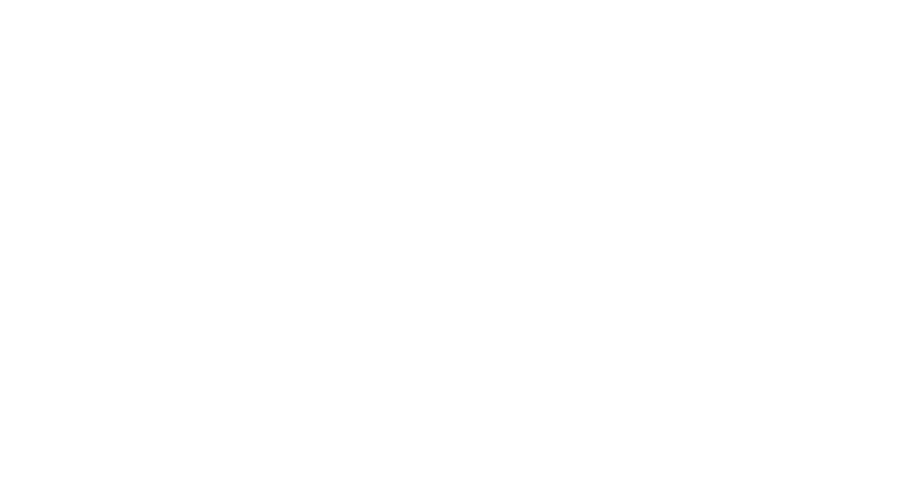

<IPython.core.display.Javascript object>


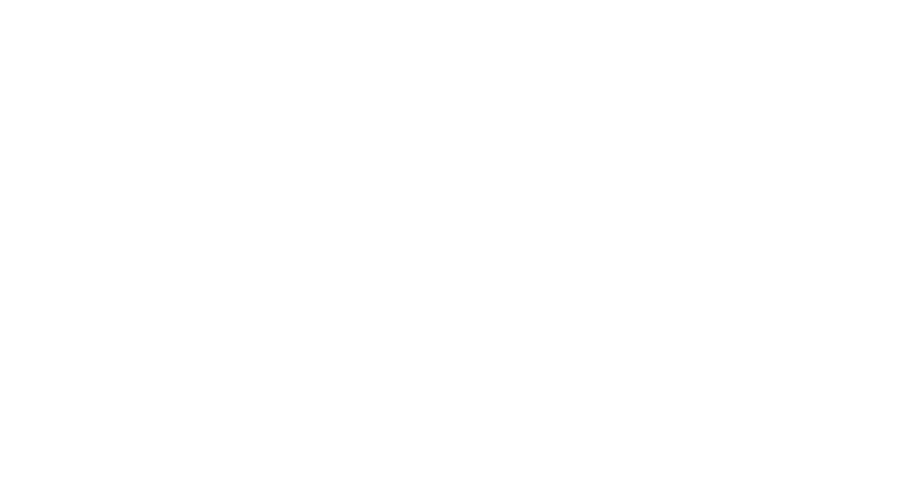

<IPython.core.display.Javascript object>


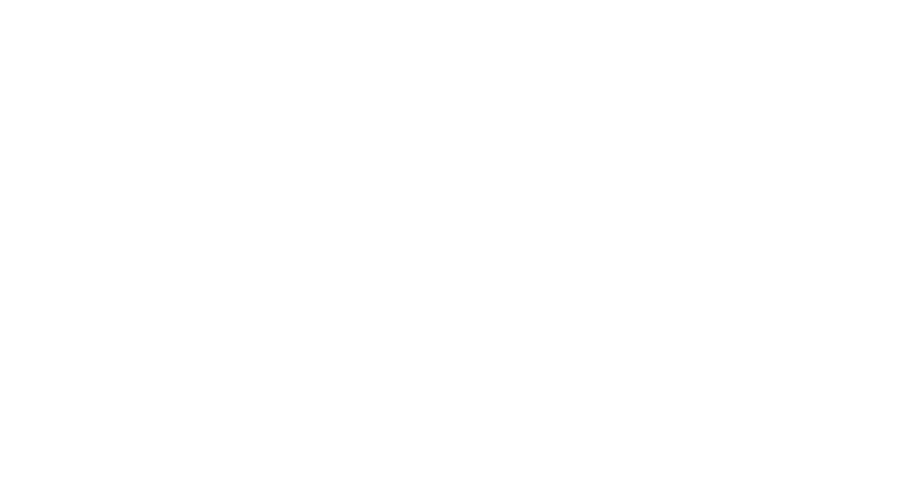

<IPython.core.display.Javascript object>


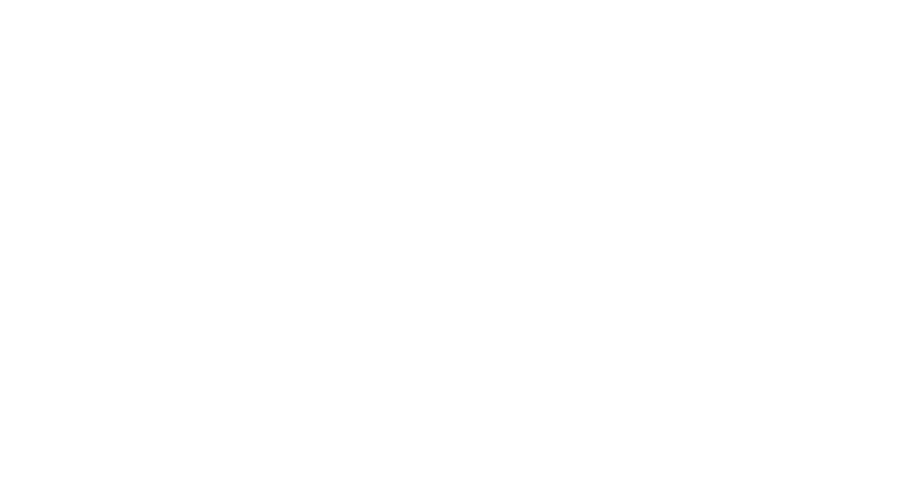

<IPython.core.display.Javascript object>


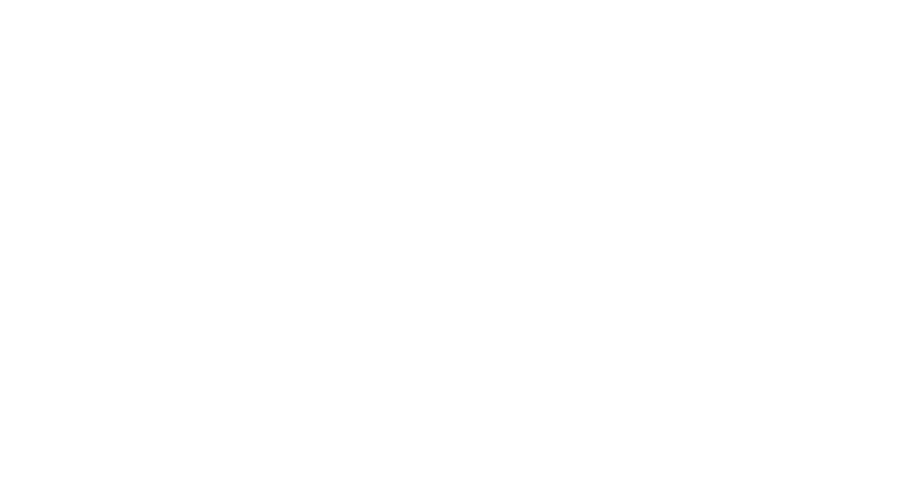

<IPython.core.display.Javascript object>


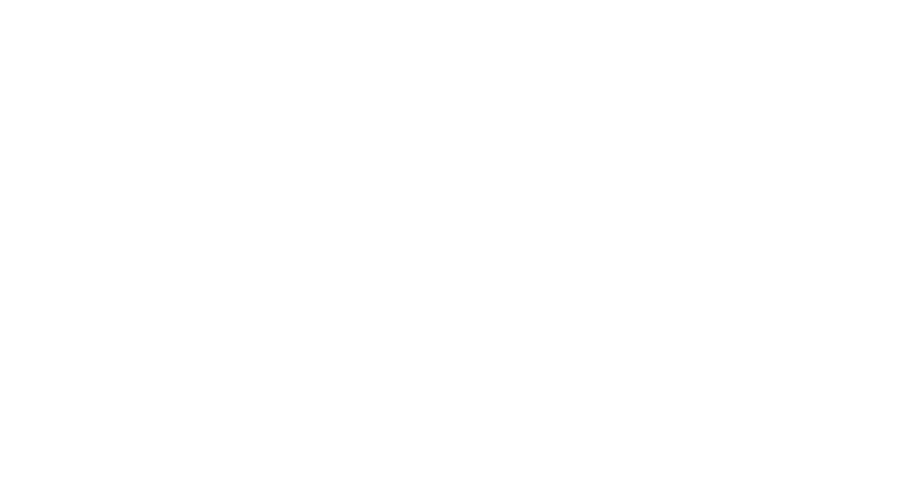

<IPython.core.display.Javascript object>


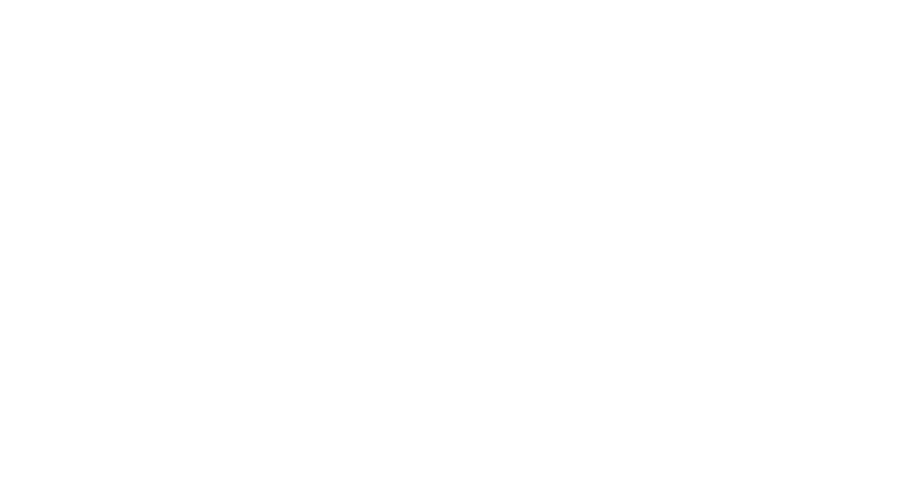

<IPython.core.display.Javascript object>


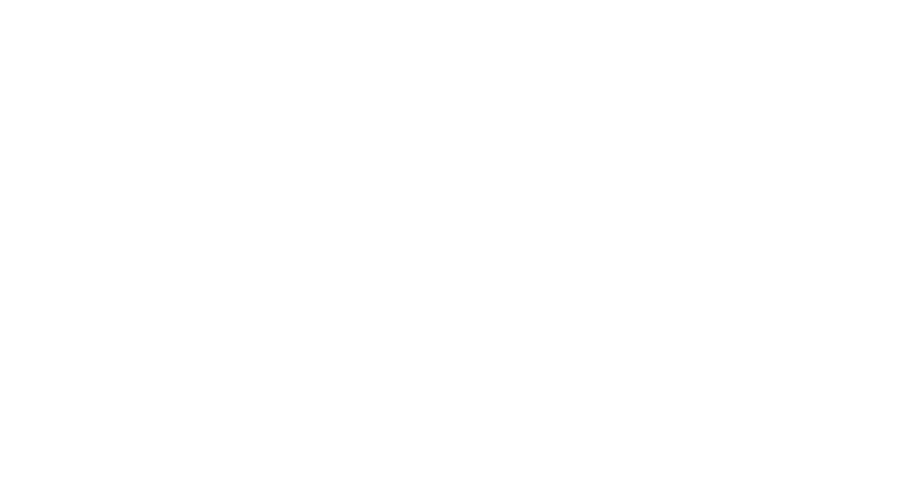

<IPython.core.display.Javascript object>


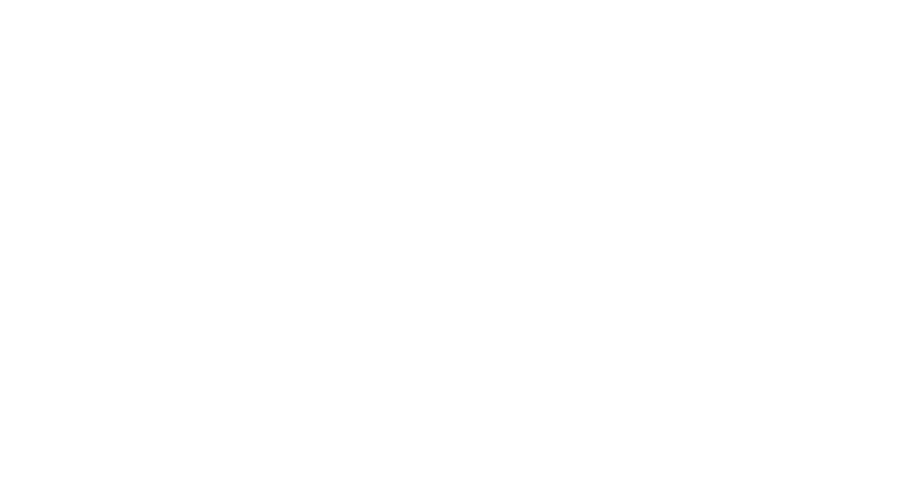

<IPython.core.display.Javascript object>


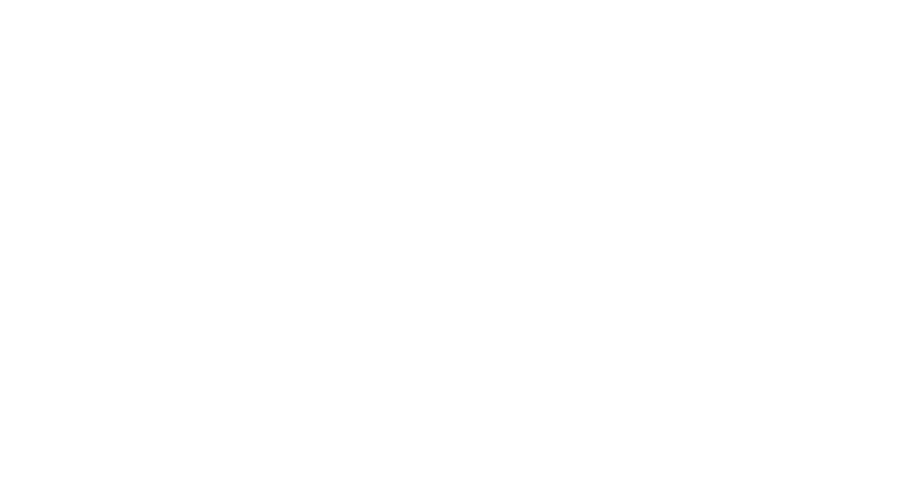

<IPython.core.display.Javascript object>


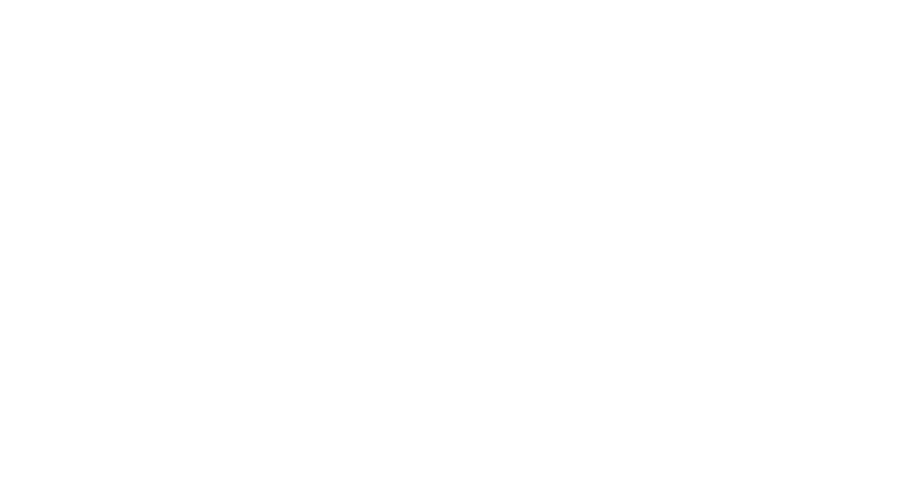

<IPython.core.display.Javascript object>


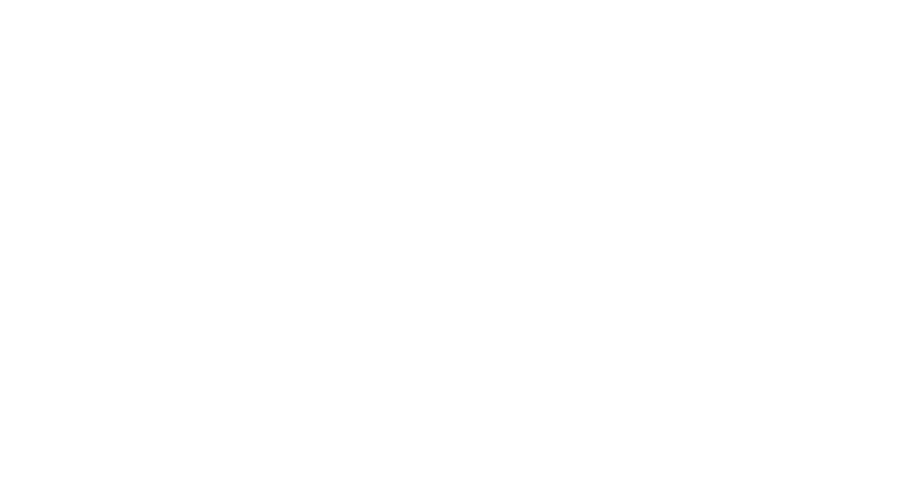

<IPython.core.display.Javascript object>


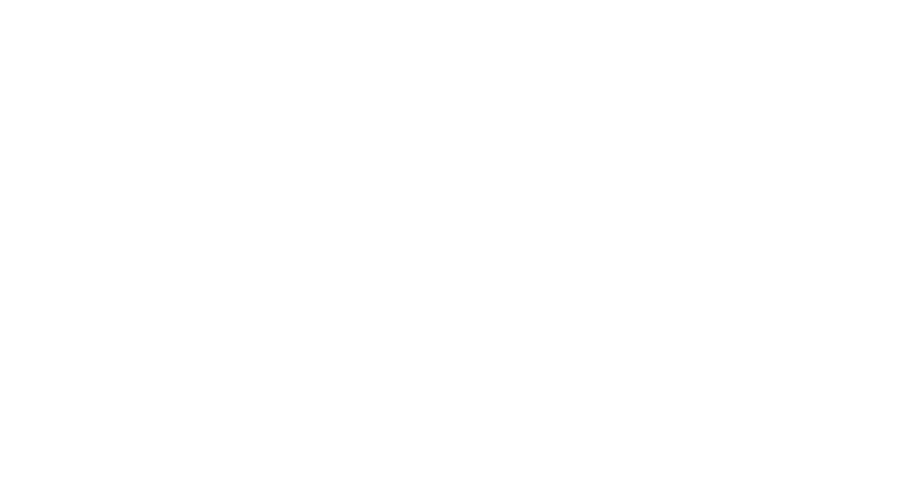

<IPython.core.display.Javascript object>


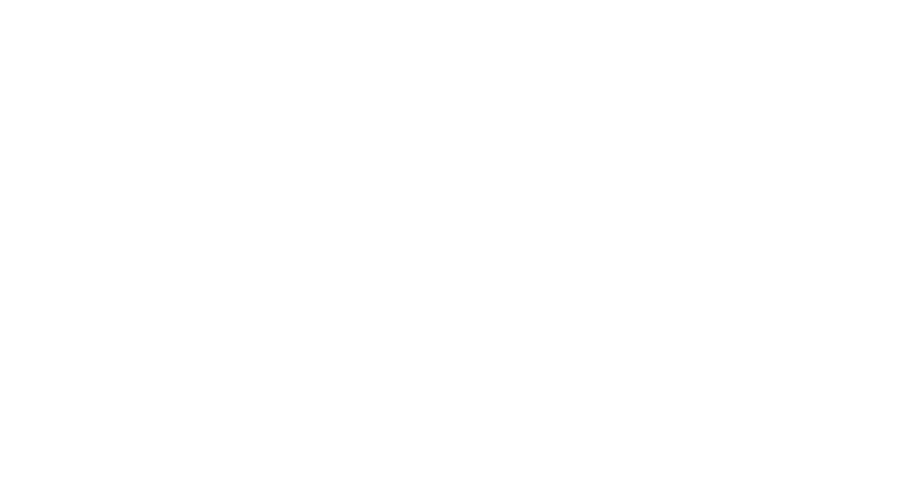

<IPython.core.display.Javascript object>


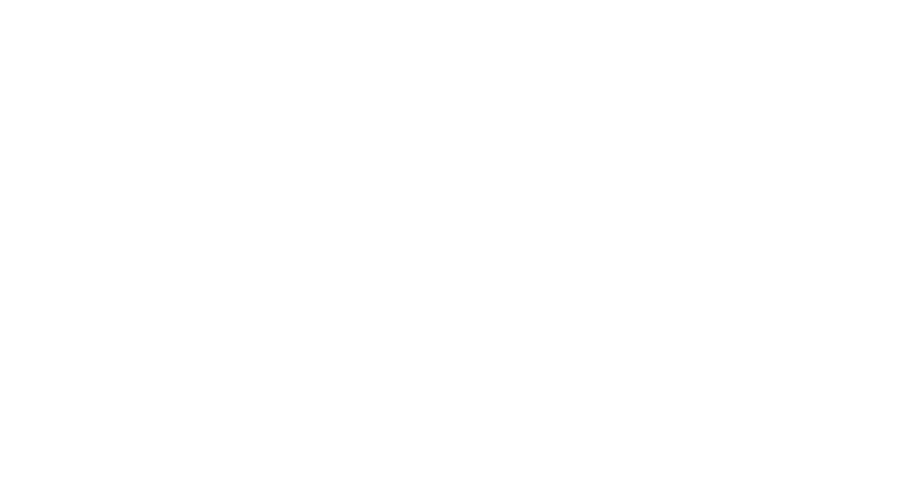

<IPython.core.display.Javascript object>


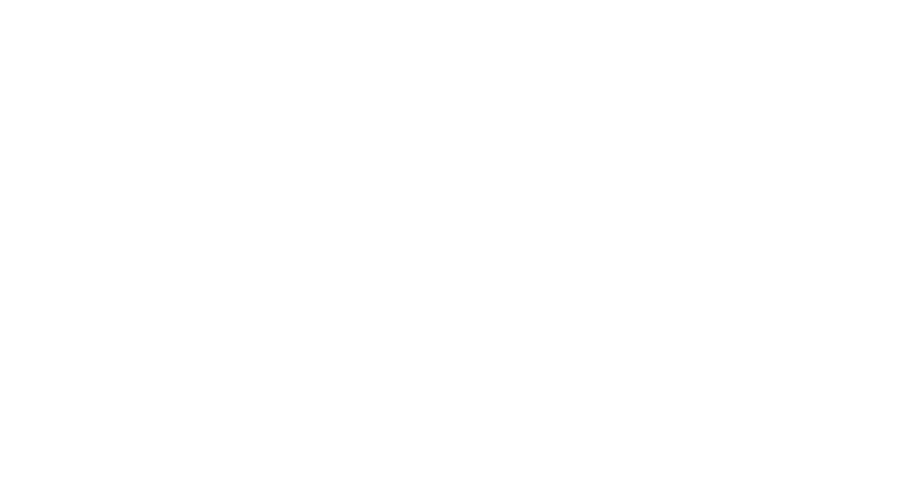

<IPython.core.display.Javascript object>


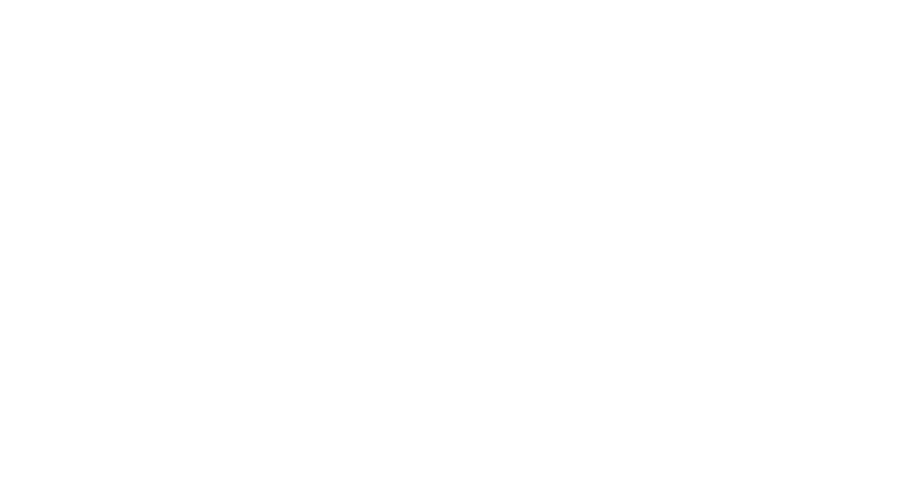

<IPython.core.display.Javascript object>


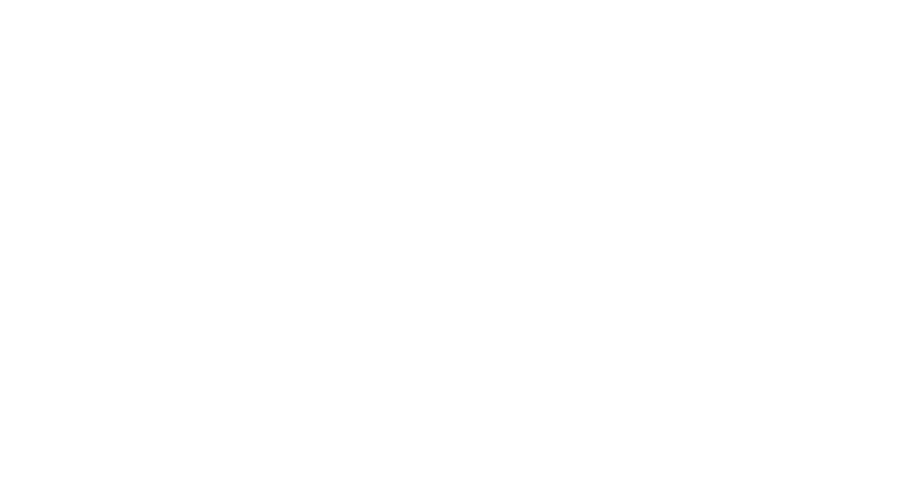

<IPython.core.display.Javascript object>


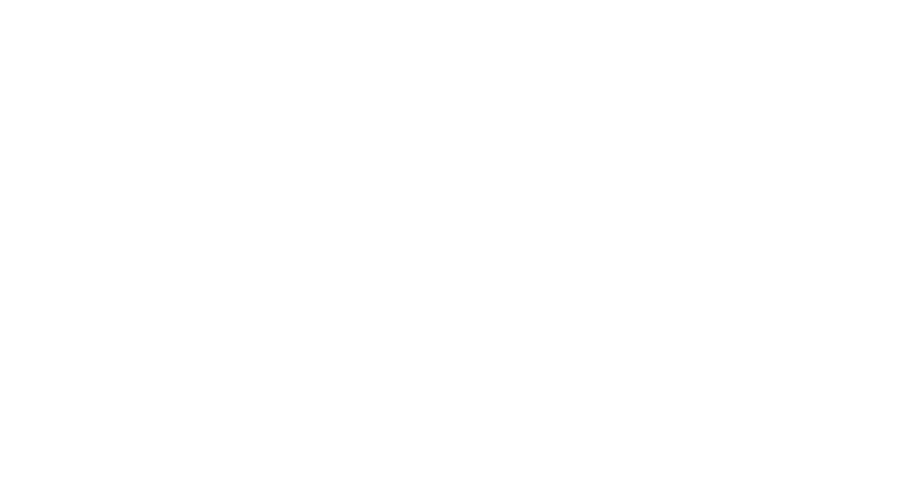

<IPython.core.display.Javascript object>


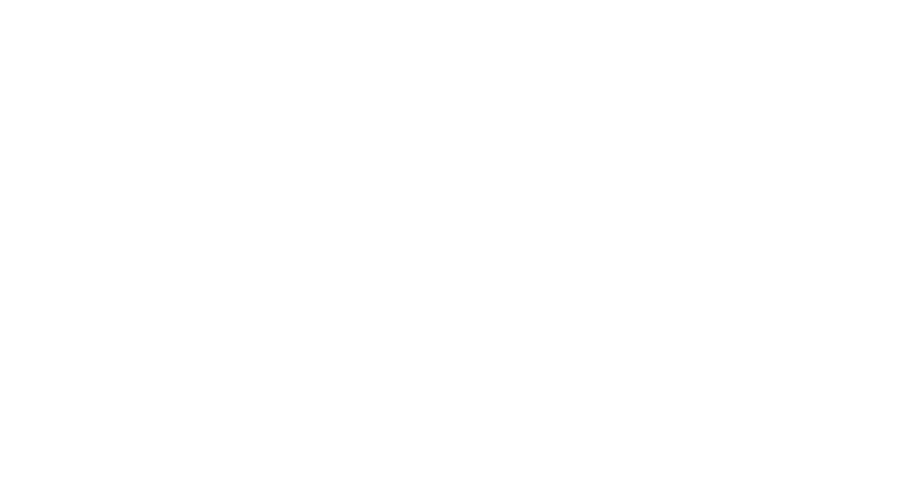

<IPython.core.display.Javascript object>


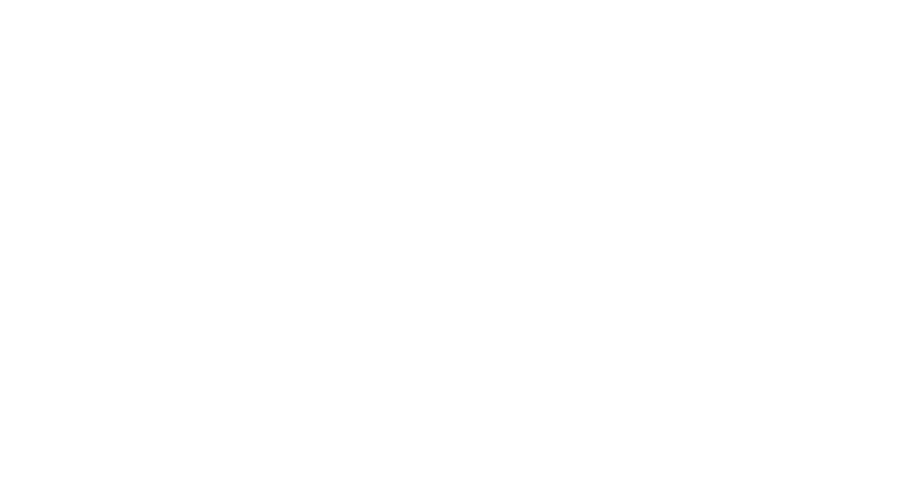

<IPython.core.display.Javascript object>


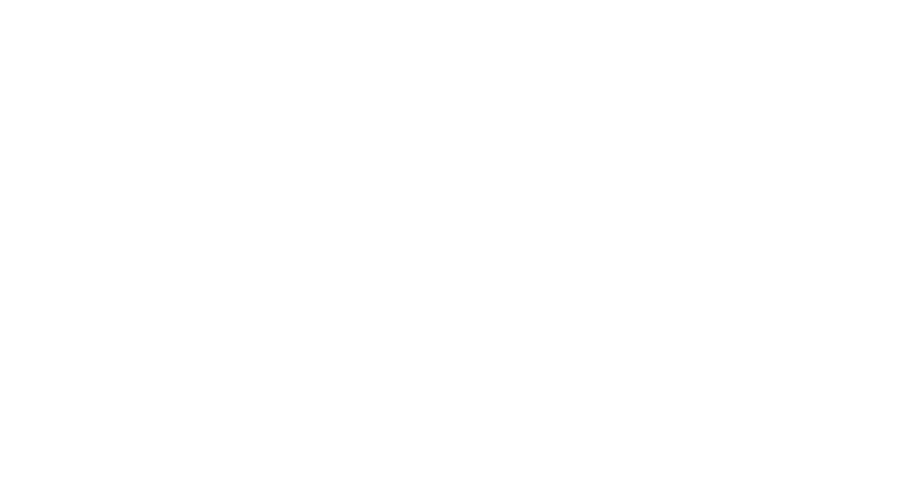

<IPython.core.display.Javascript object>


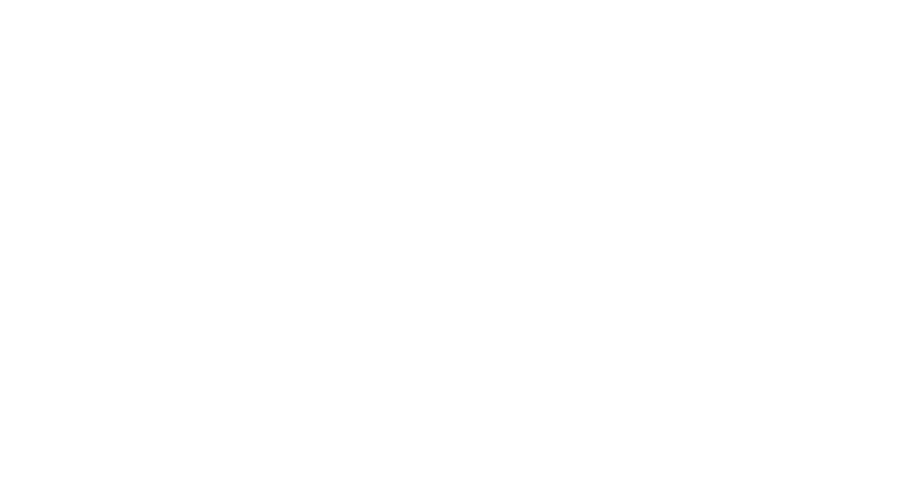

<IPython.core.display.Javascript object>


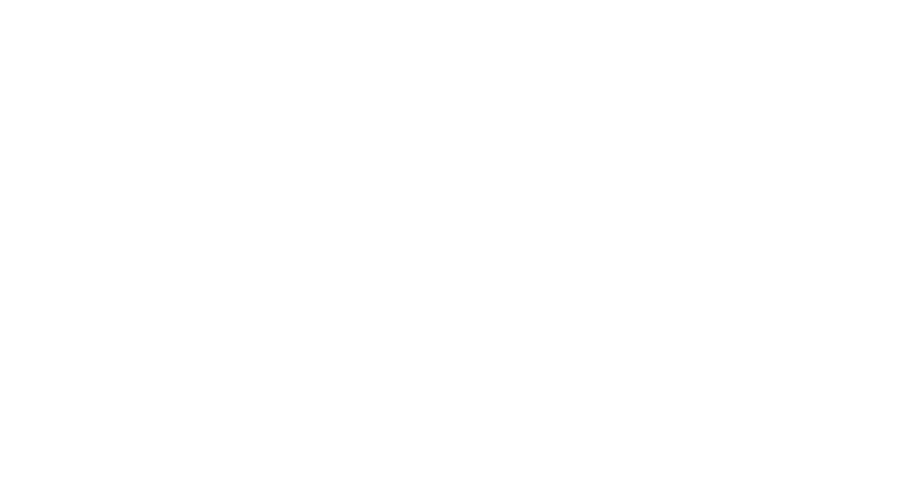

<IPython.core.display.Javascript object>


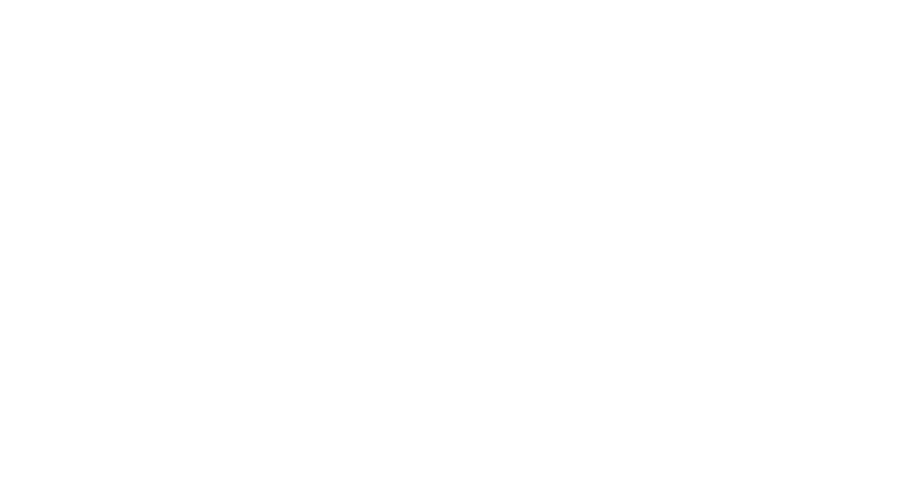

<IPython.core.display.Javascript object>


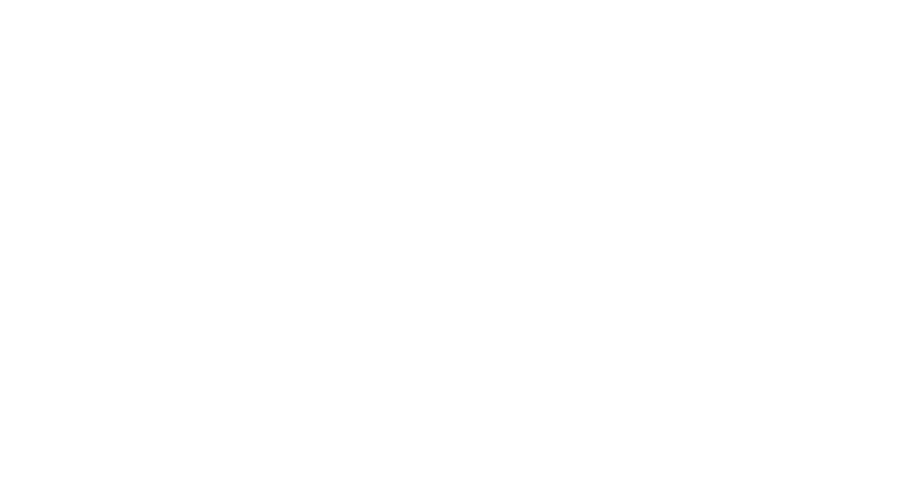

<IPython.core.display.Javascript object>


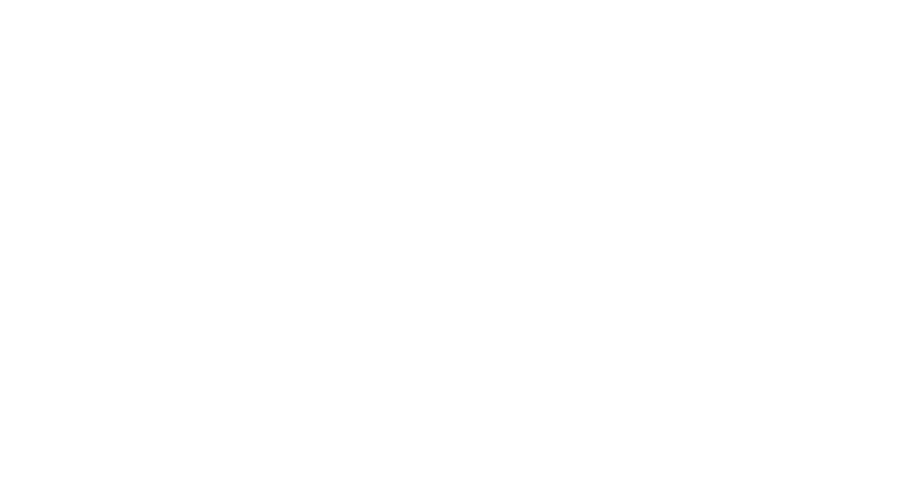

<IPython.core.display.Javascript object>


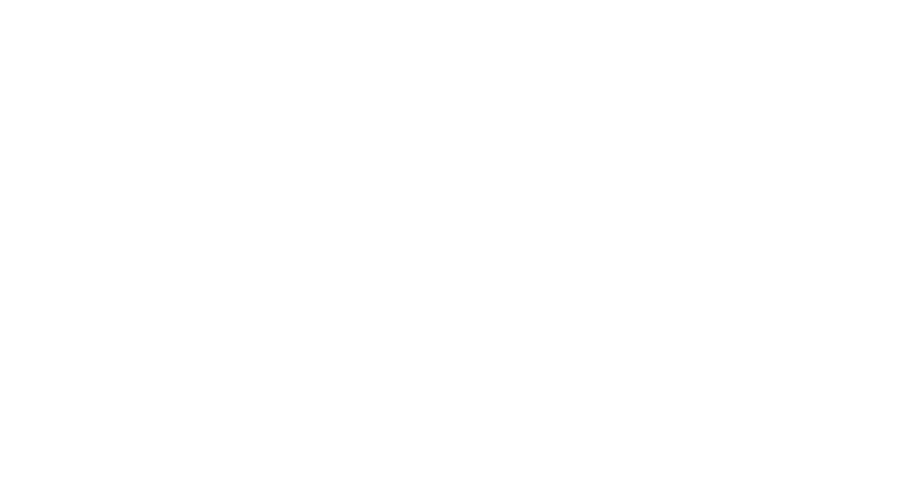

<IPython.core.display.Javascript object>


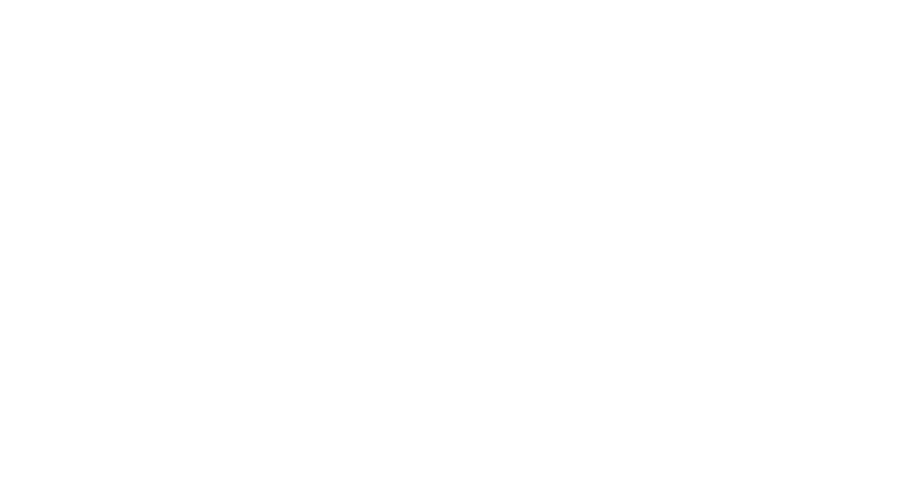

<IPython.core.display.Javascript object>


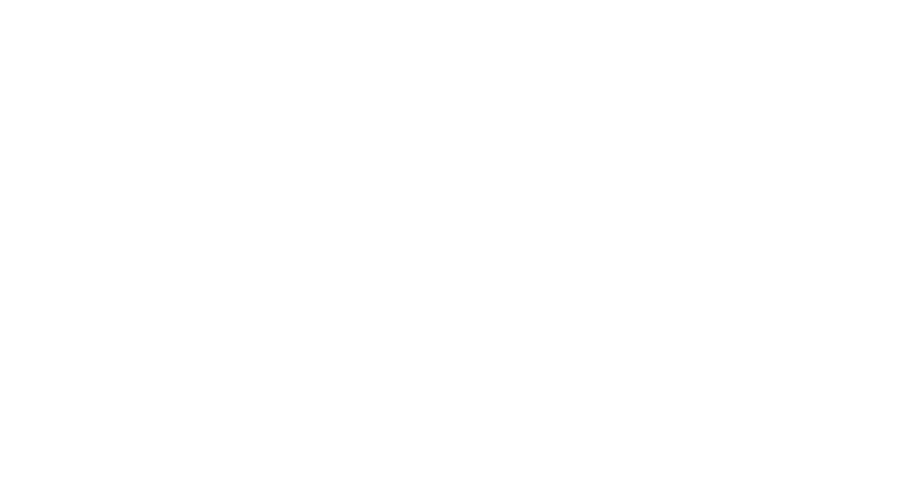

<IPython.core.display.Javascript object>


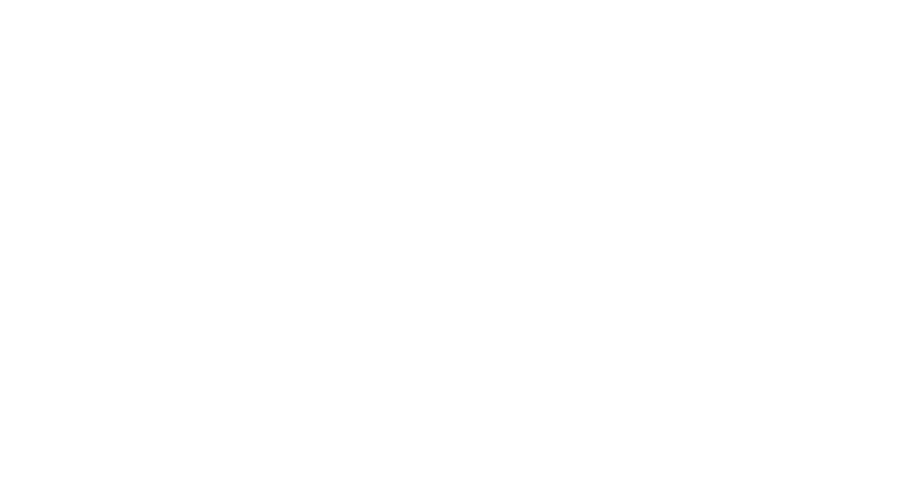

<IPython.core.display.Javascript object>


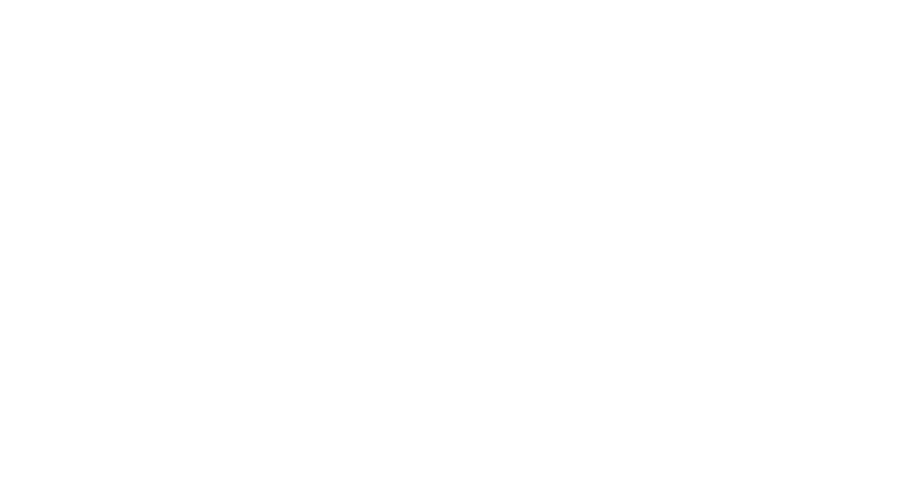

<IPython.core.display.Javascript object>


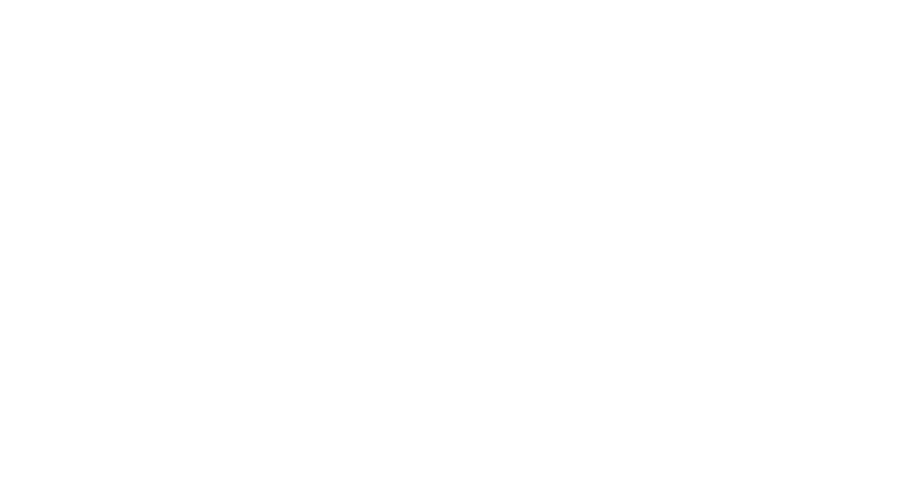

<IPython.core.display.Javascript object>


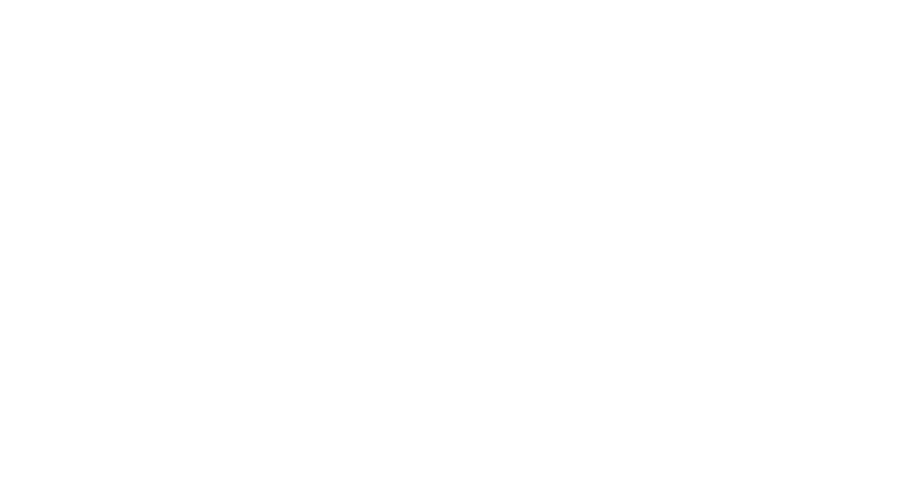

<IPython.core.display.Javascript object>


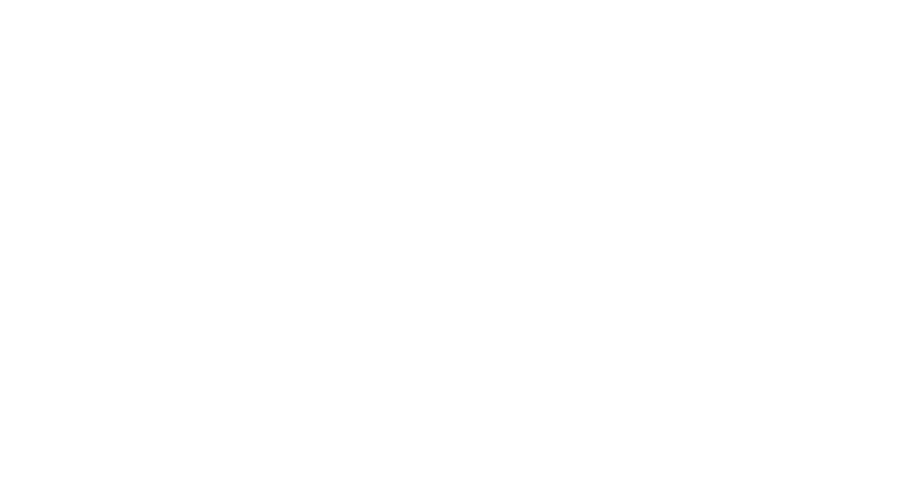

<IPython.core.display.Javascript object>


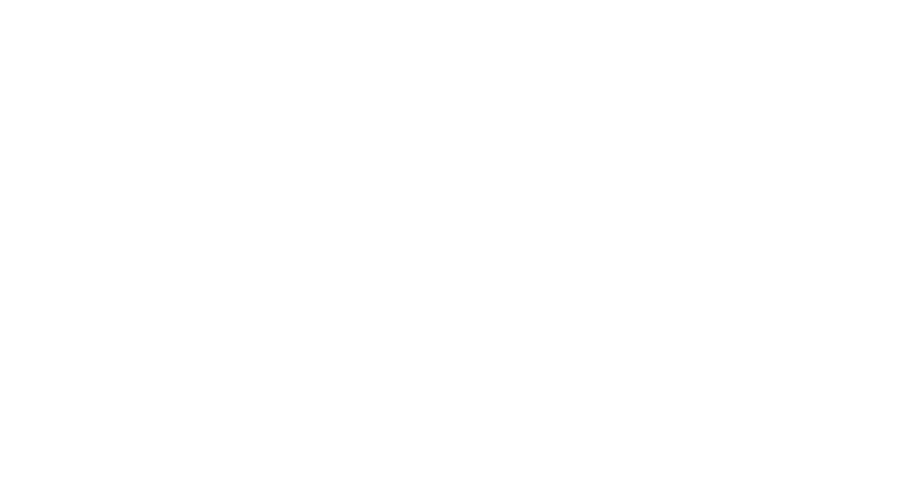

<IPython.core.display.Javascript object>


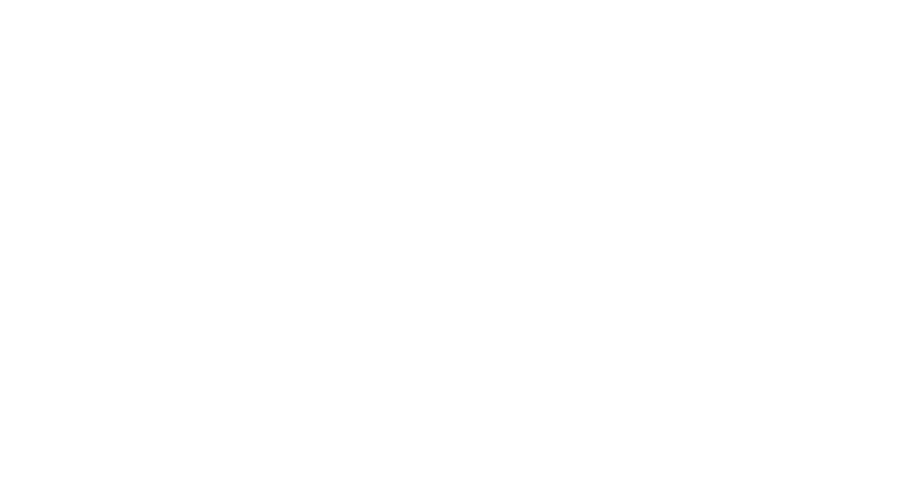

<IPython.core.display.Javascript object>


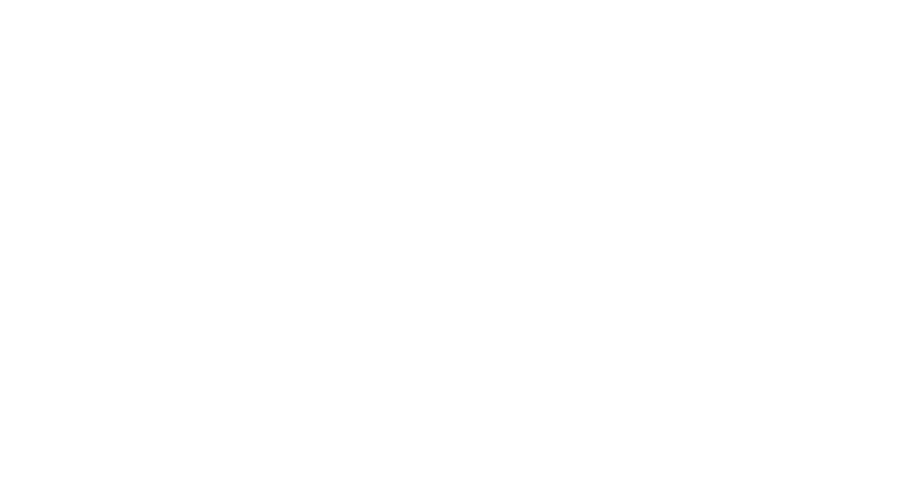

<IPython.core.display.Javascript object>


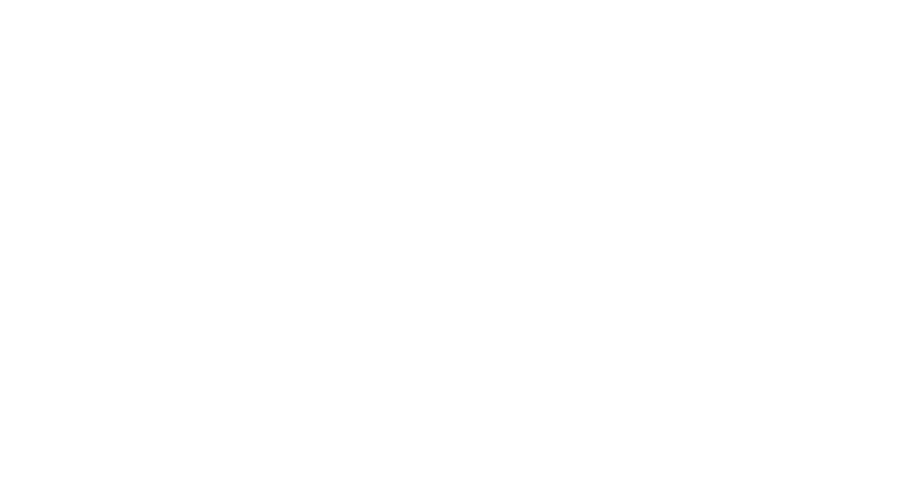

<IPython.core.display.Javascript object>


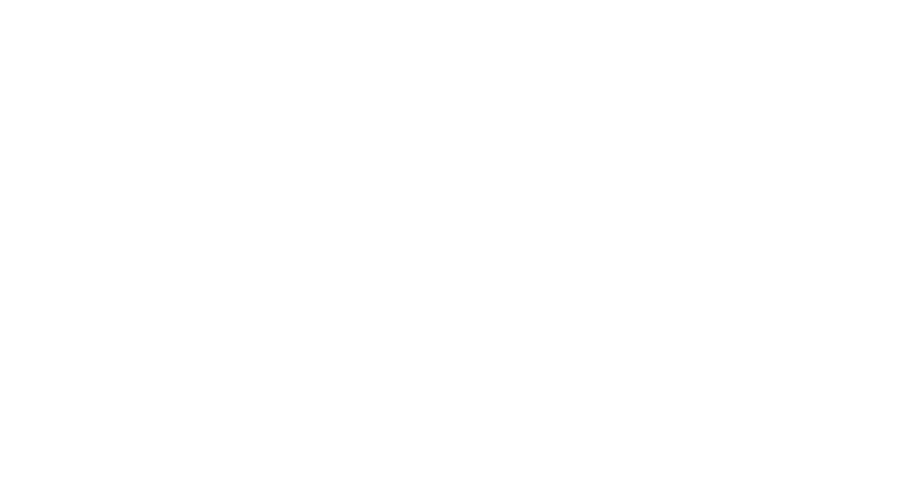

<IPython.core.display.Javascript object>


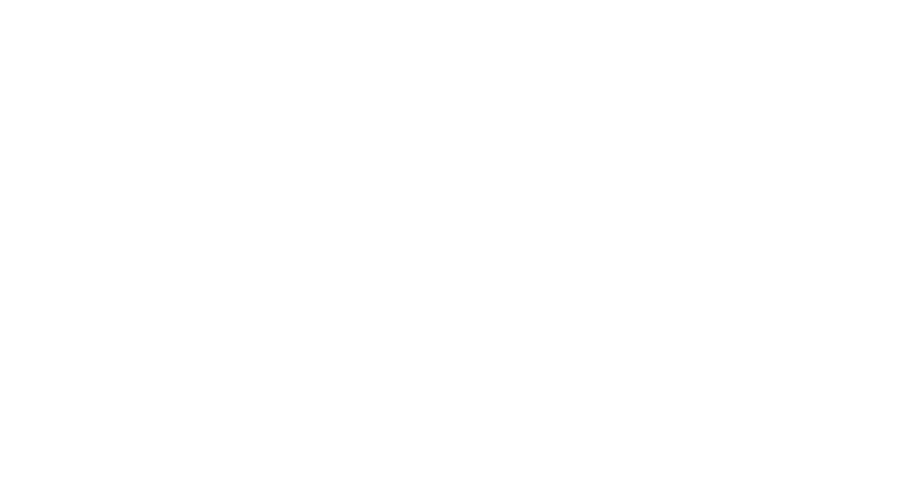

<IPython.core.display.Javascript object>


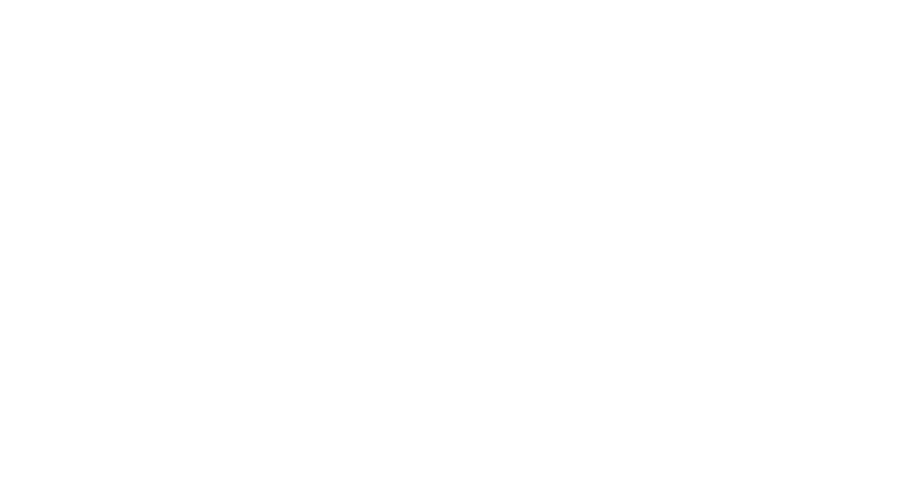

<IPython.core.display.Javascript object>


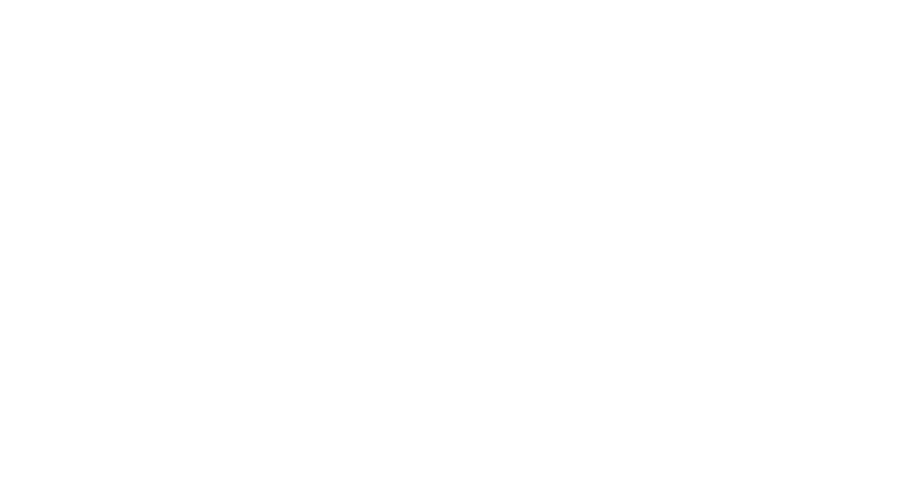

<IPython.core.display.Javascript object>


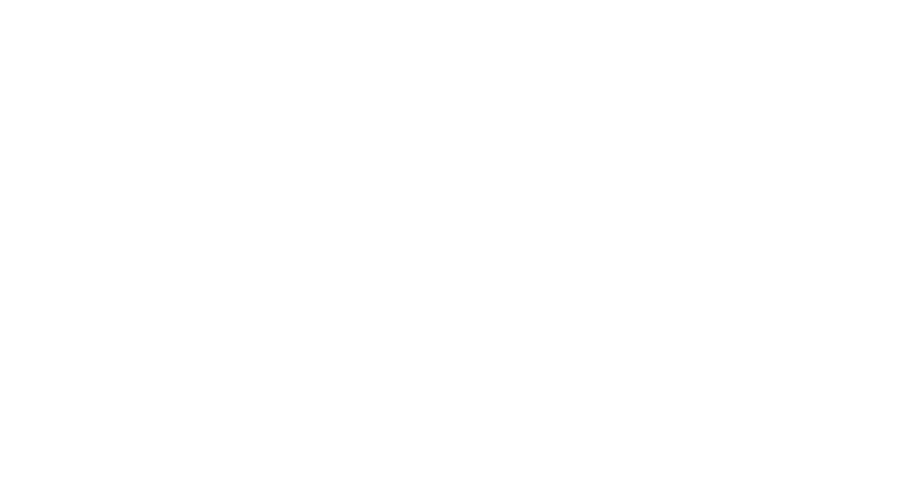

<IPython.core.display.Javascript object>


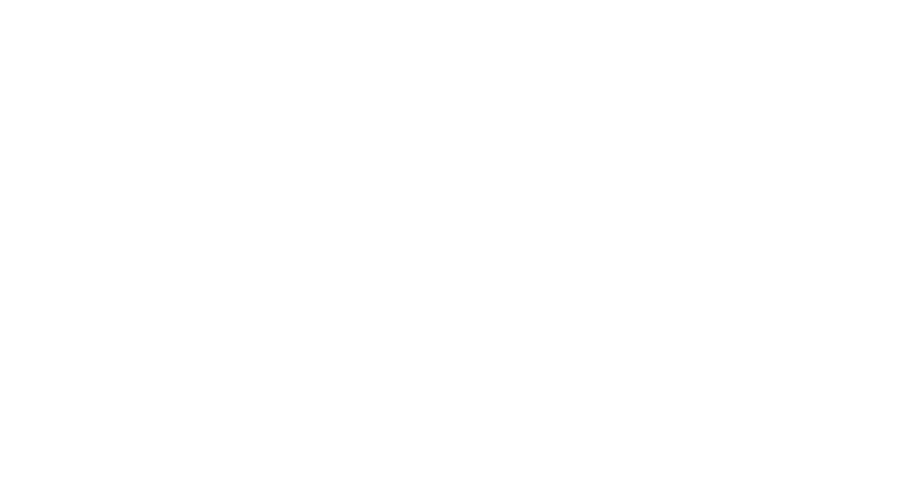

<IPython.core.display.Javascript object>


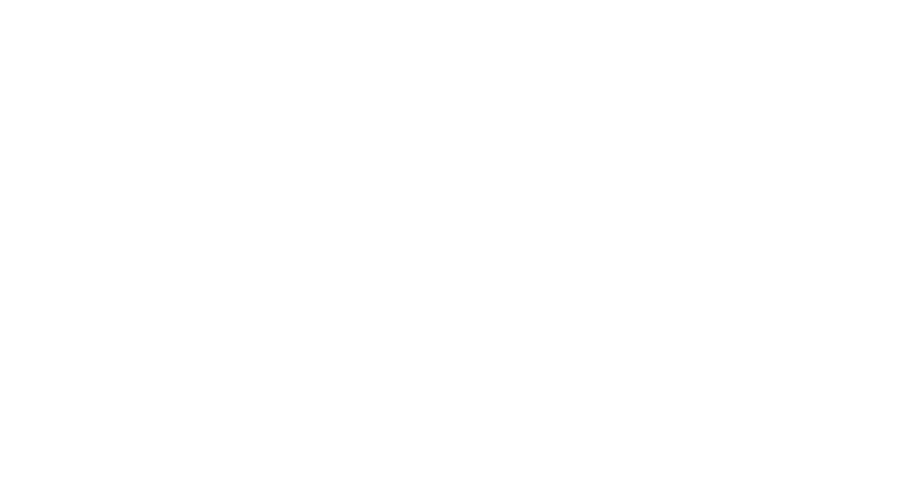

<IPython.core.display.Javascript object>


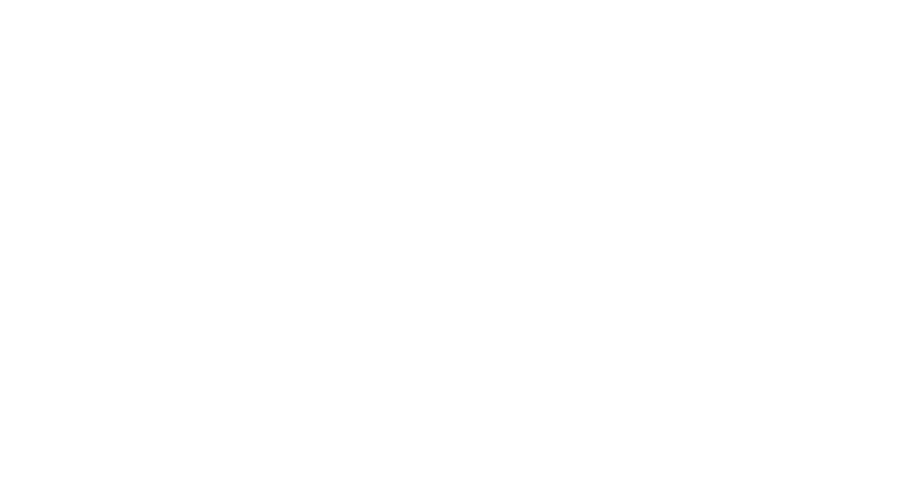

<IPython.core.display.Javascript object>


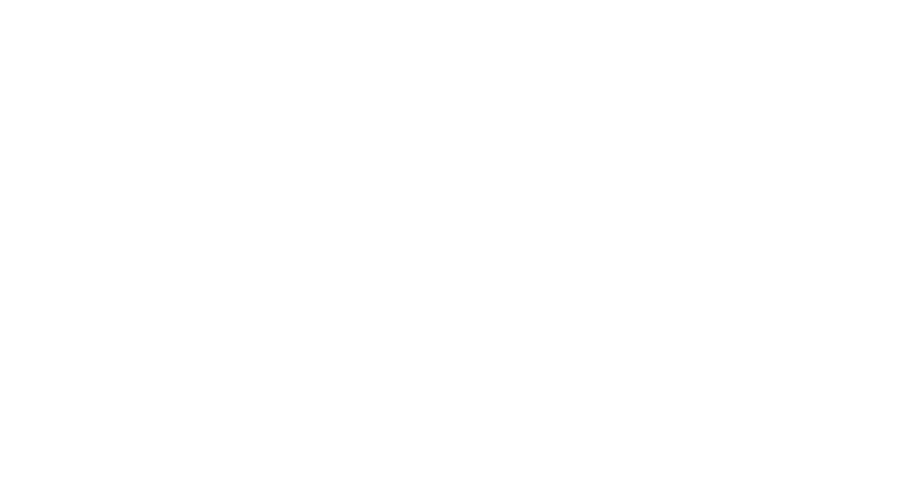

<IPython.core.display.Javascript object>


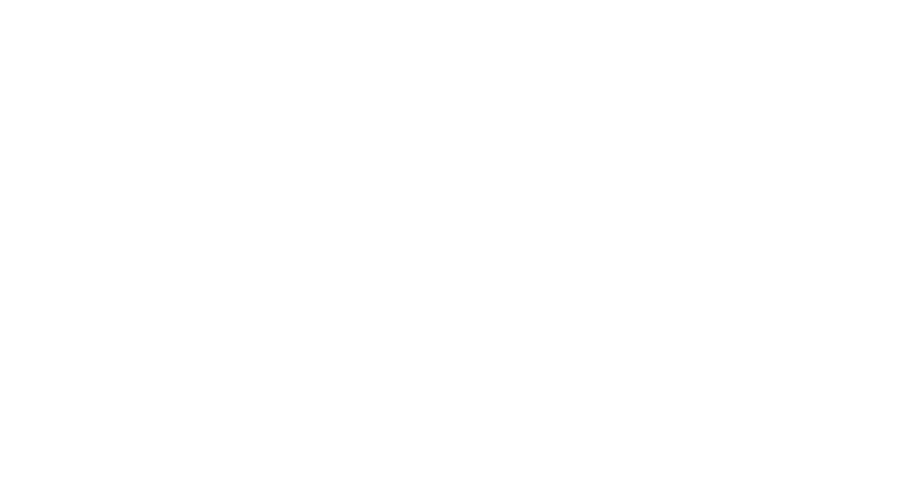

<IPython.core.display.Javascript object>


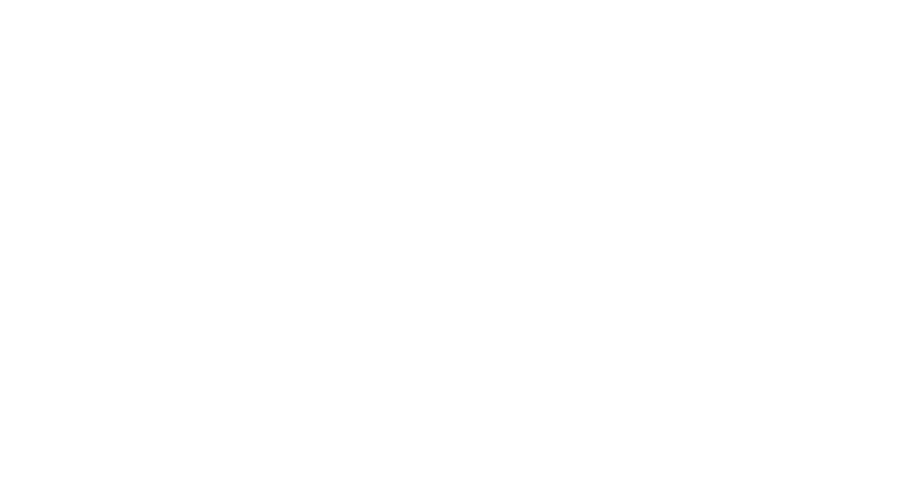

<IPython.core.display.Javascript object>


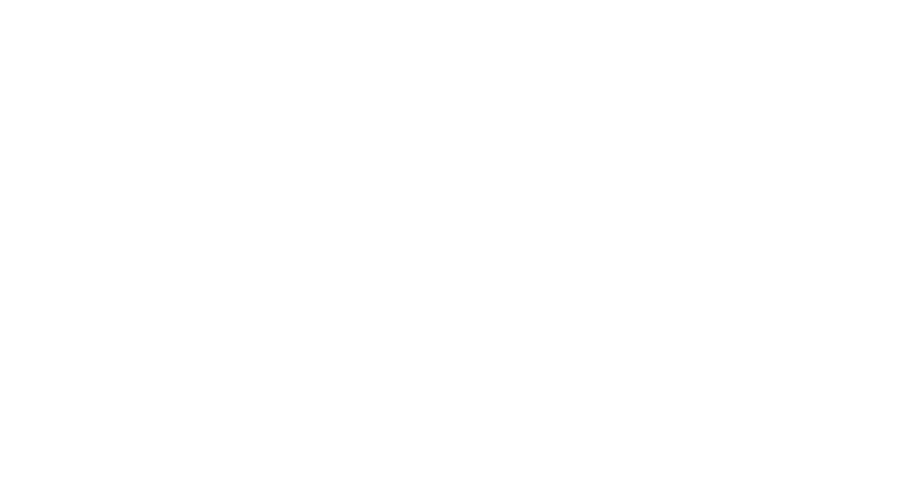

<IPython.core.display.Javascript object>


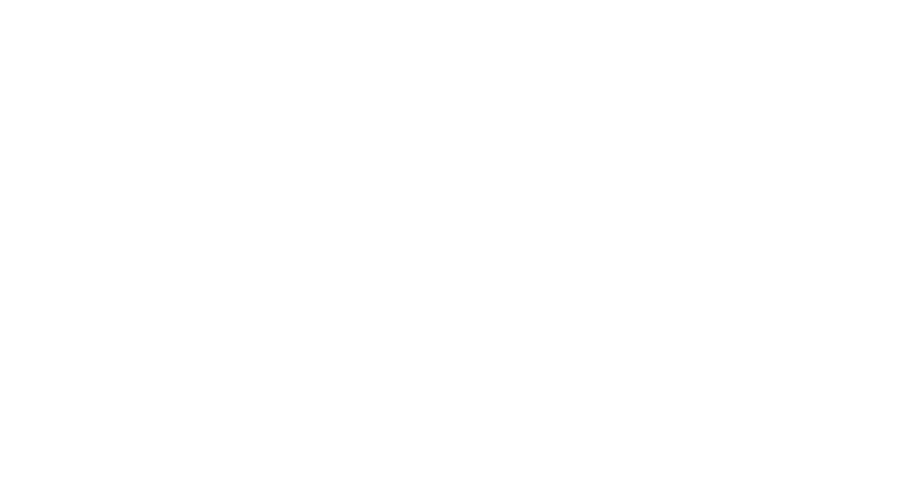

<IPython.core.display.Javascript object>


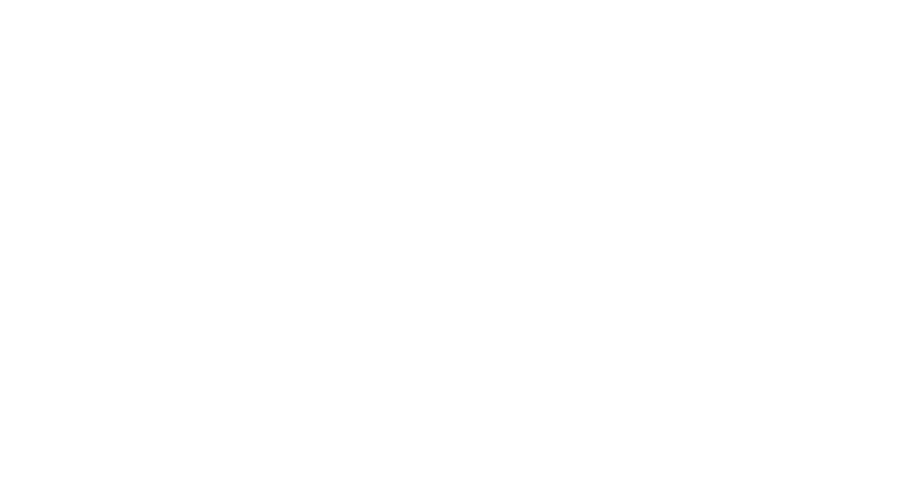

<IPython.core.display.Javascript object>


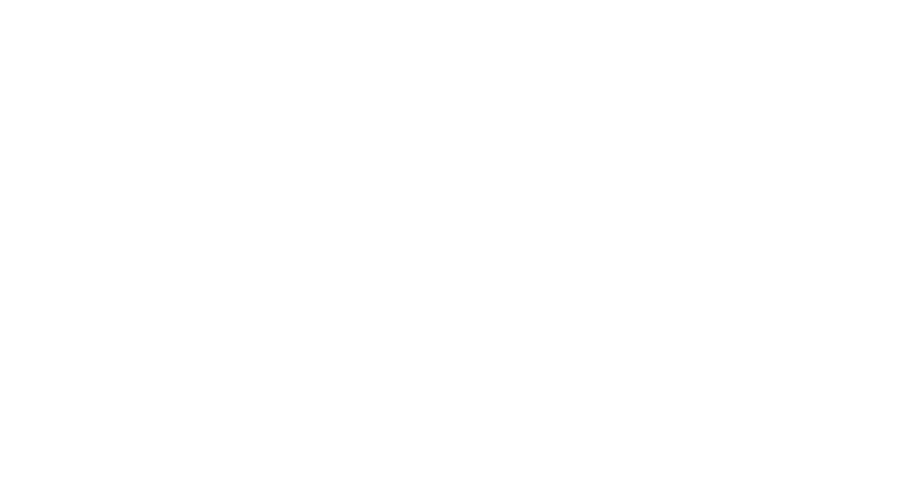

<IPython.core.display.Javascript object>


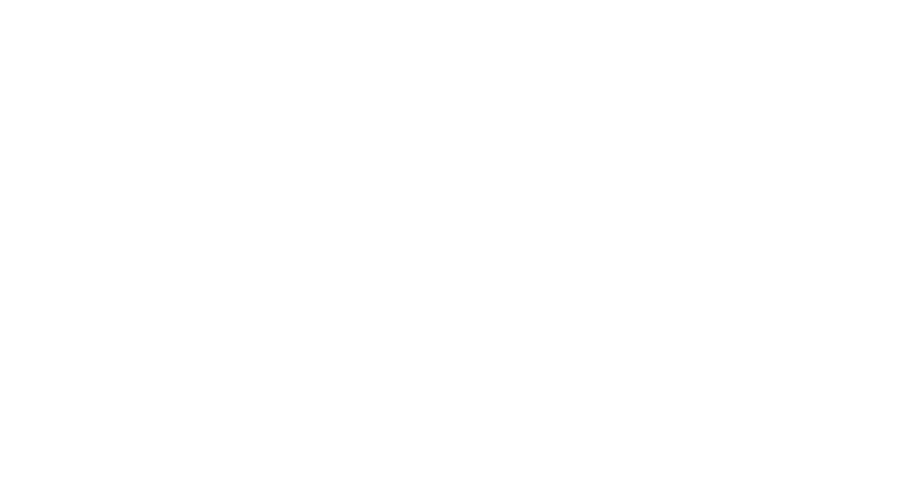

<IPython.core.display.Javascript object>


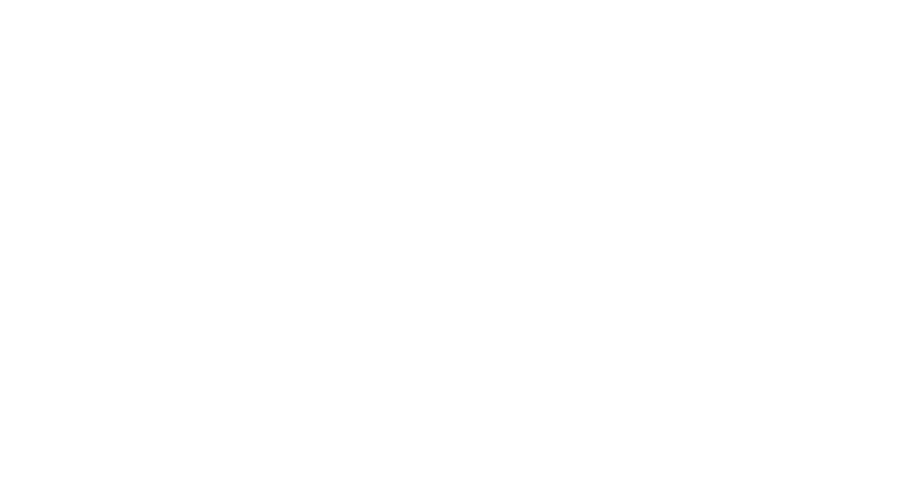

<IPython.core.display.Javascript object>


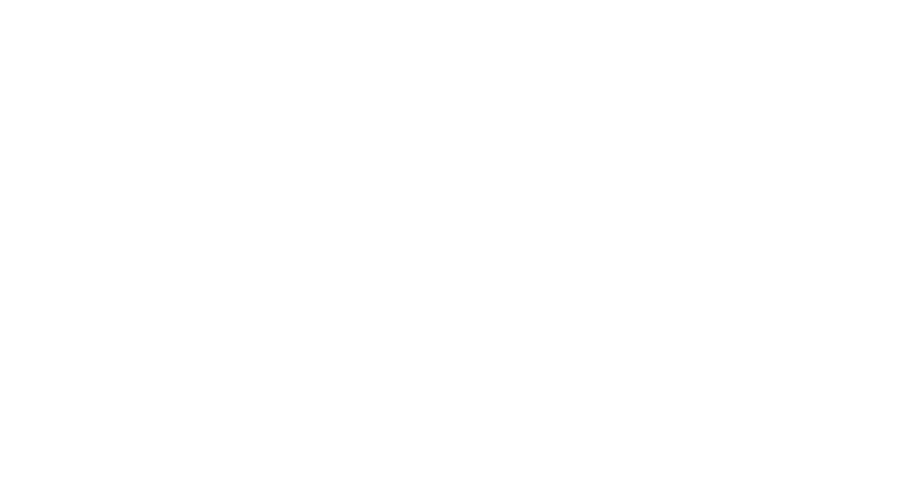

<IPython.core.display.Javascript object>


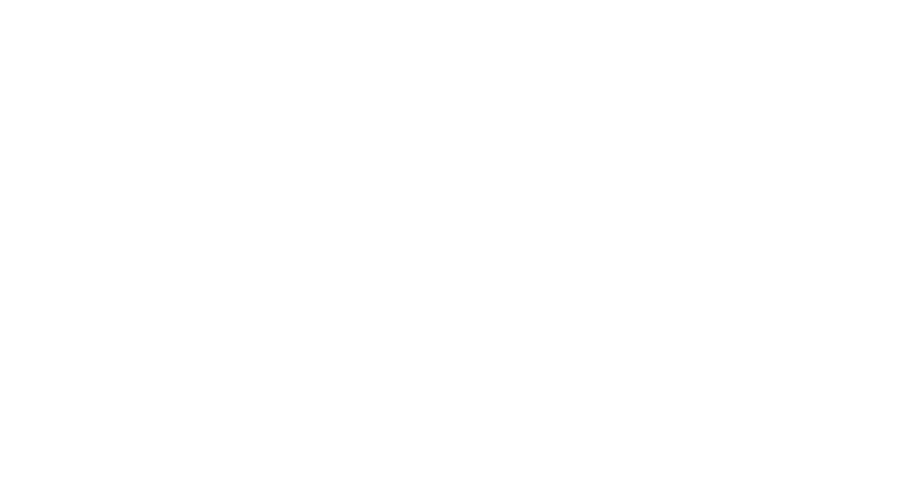

<IPython.core.display.Javascript object>


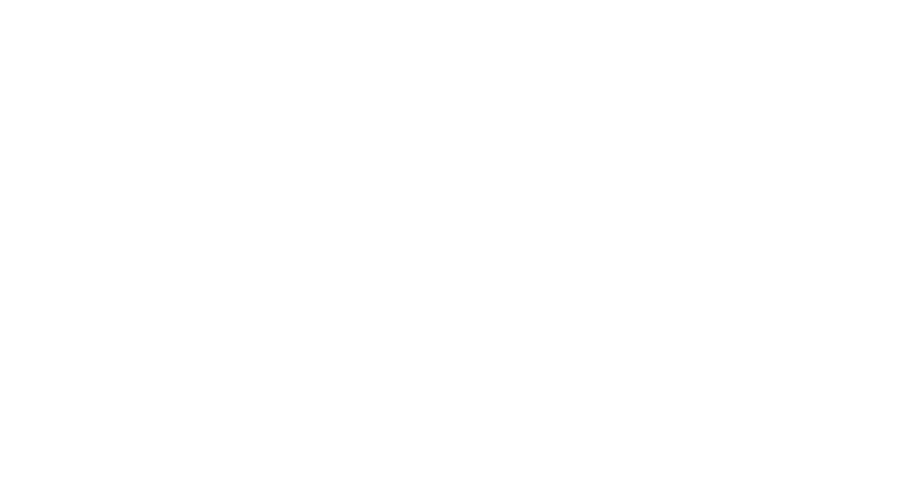

<IPython.core.display.Javascript object>


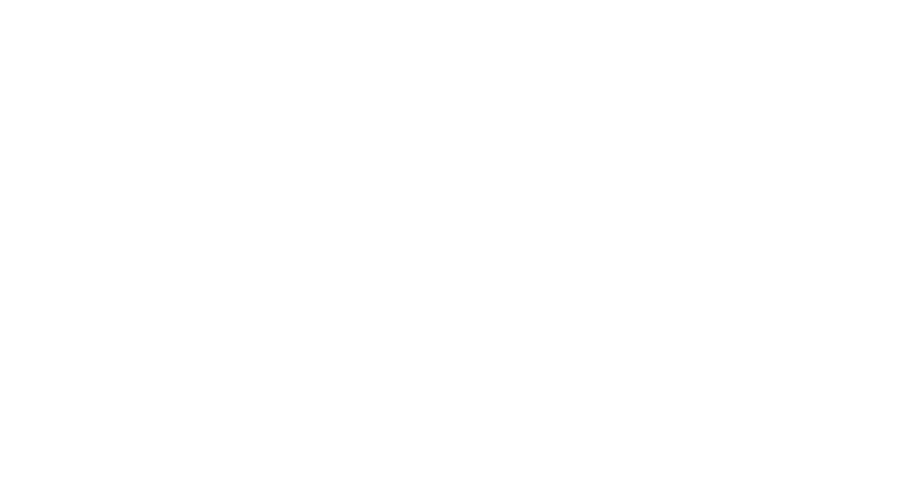

<IPython.core.display.Javascript object>


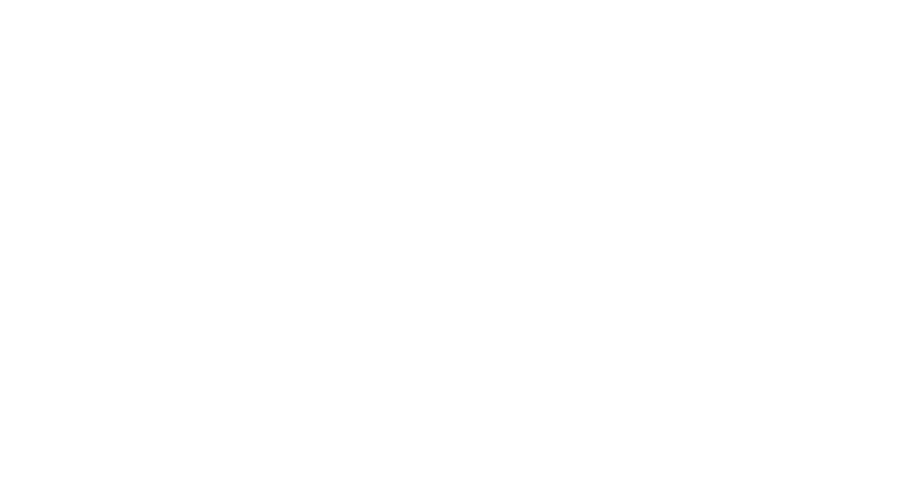

<IPython.core.display.Javascript object>


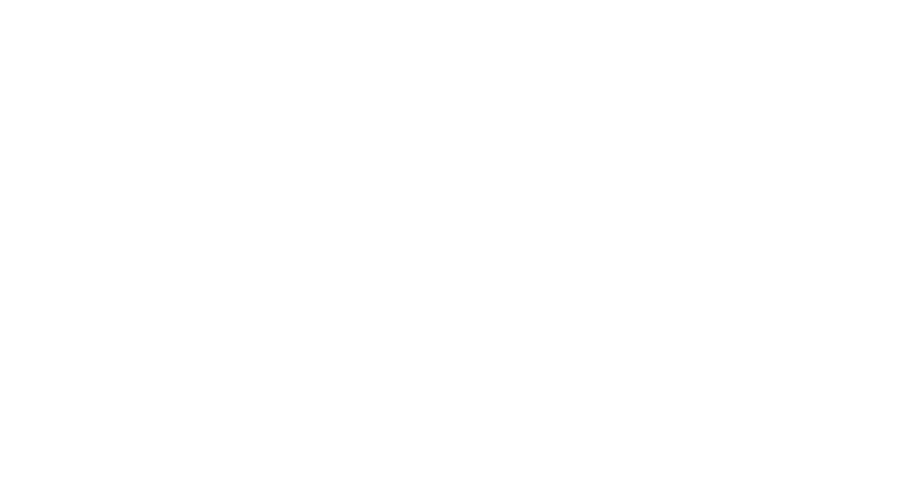

<IPython.core.display.Javascript object>


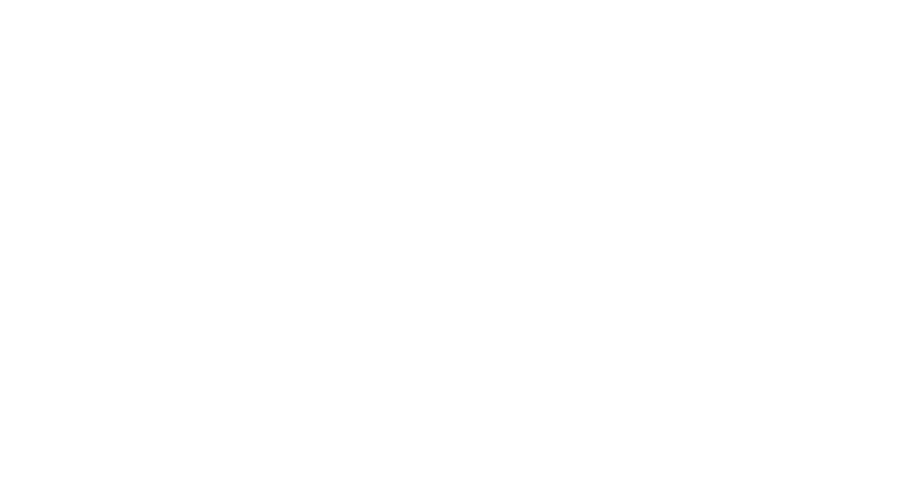

<IPython.core.display.Javascript object>


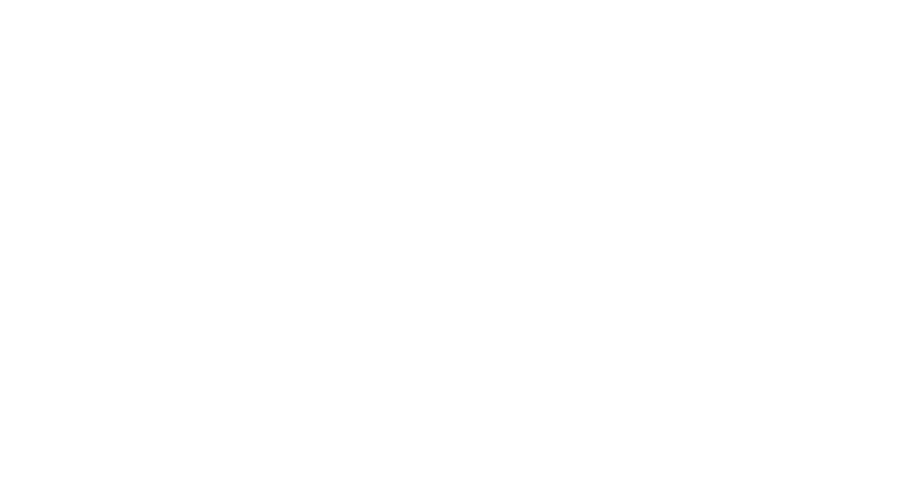

<IPython.core.display.Javascript object>


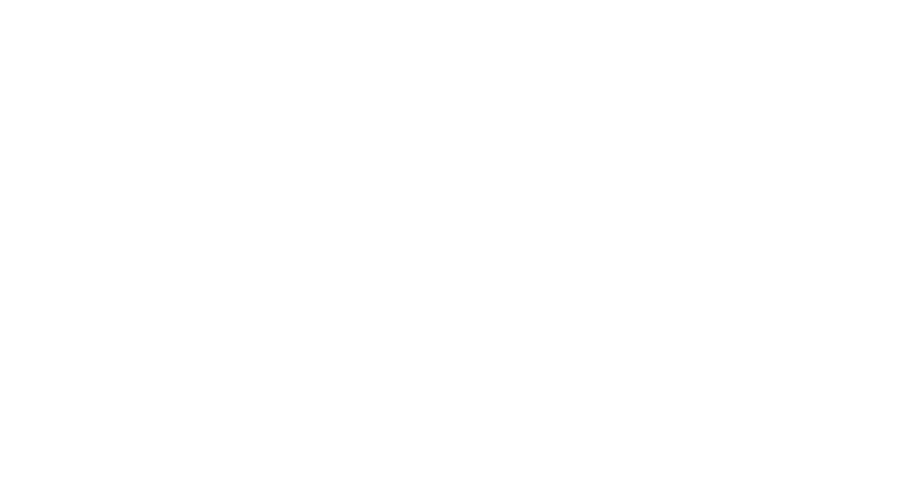

<IPython.core.display.Javascript object>


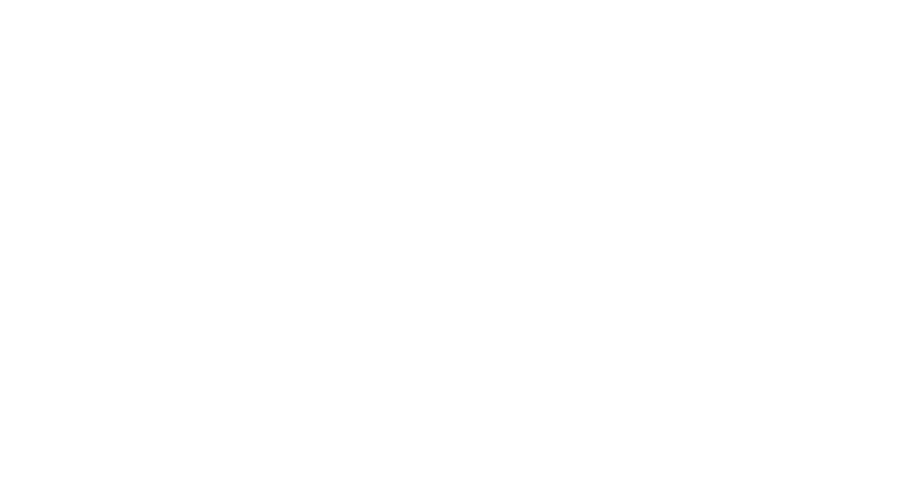

<IPython.core.display.Javascript object>


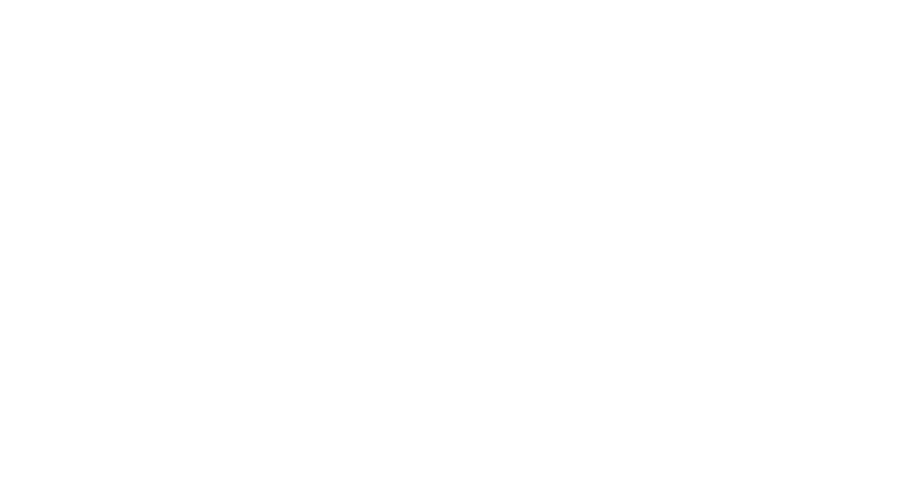

<IPython.core.display.Javascript object>


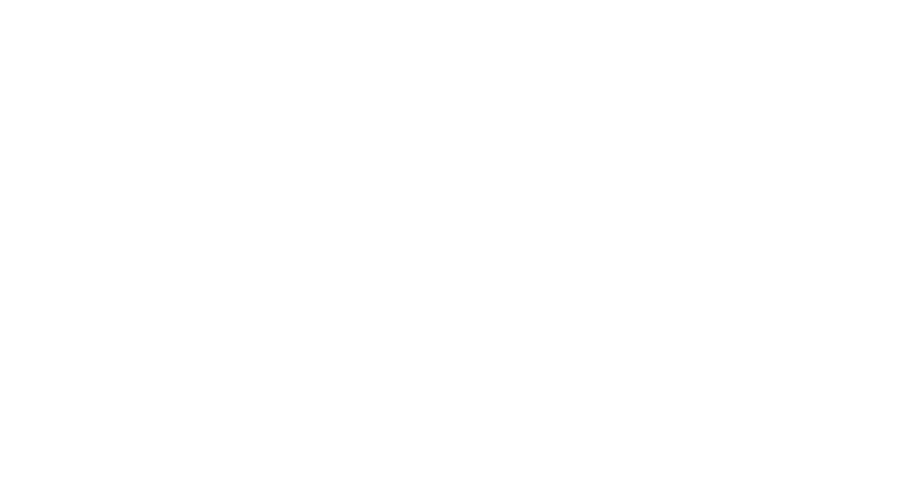

<IPython.core.display.Javascript object>


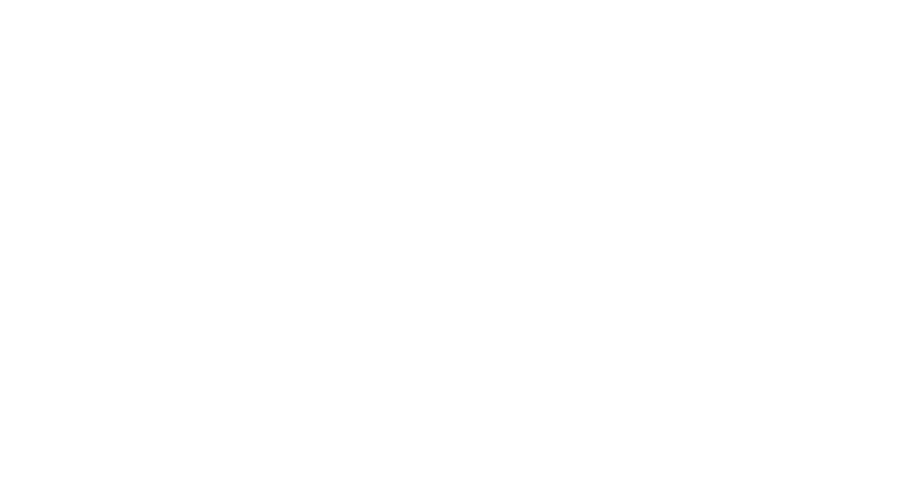

<IPython.core.display.Javascript object>


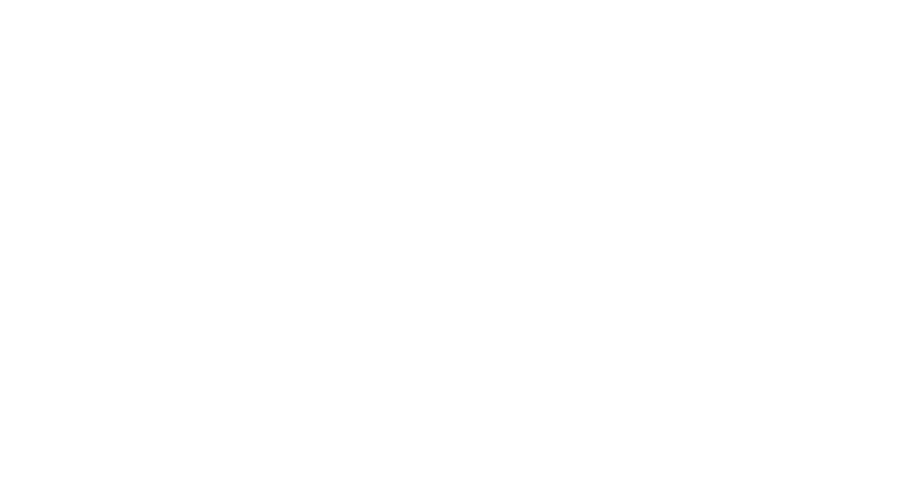

<IPython.core.display.Javascript object>


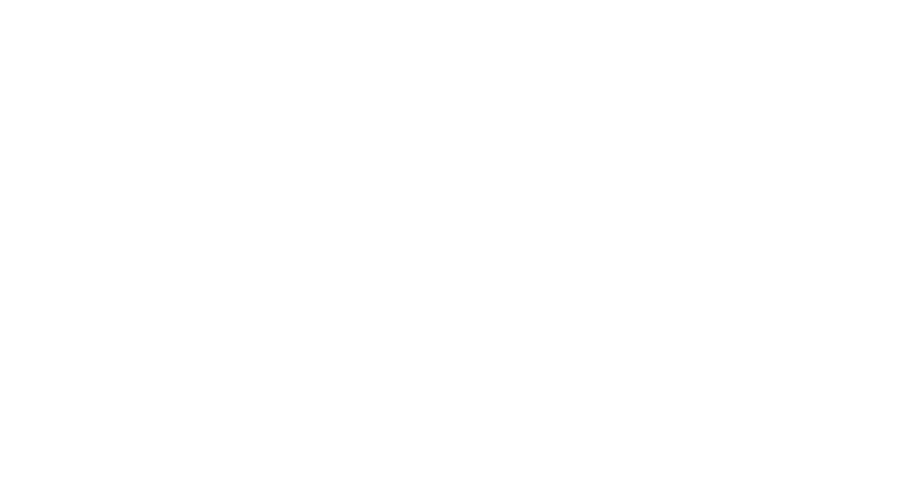

<IPython.core.display.Javascript object>


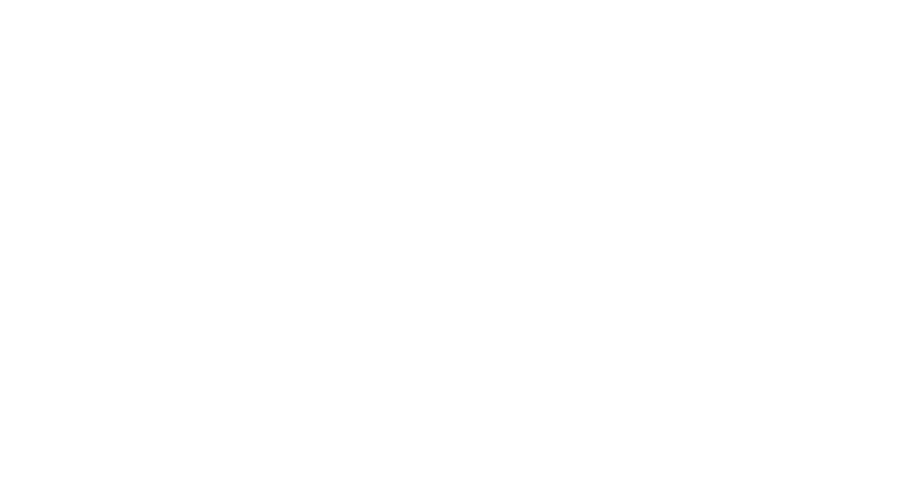

<IPython.core.display.Javascript object>


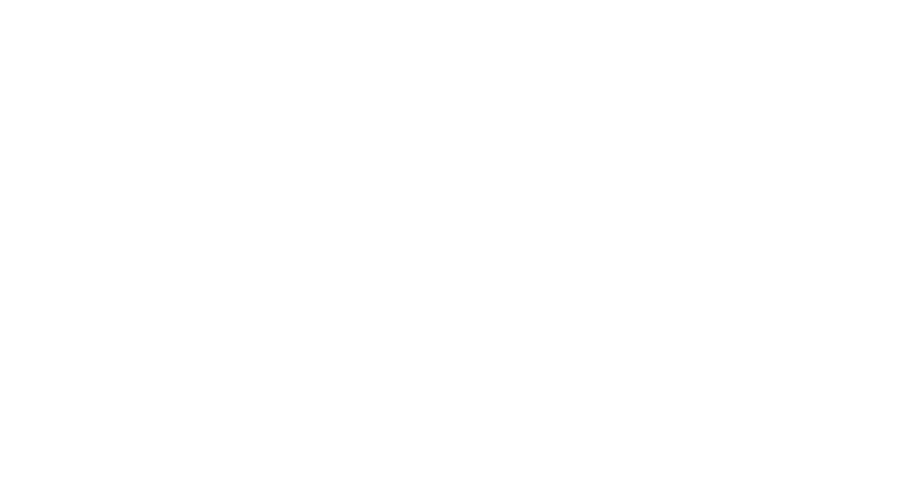

<IPython.core.display.Javascript object>


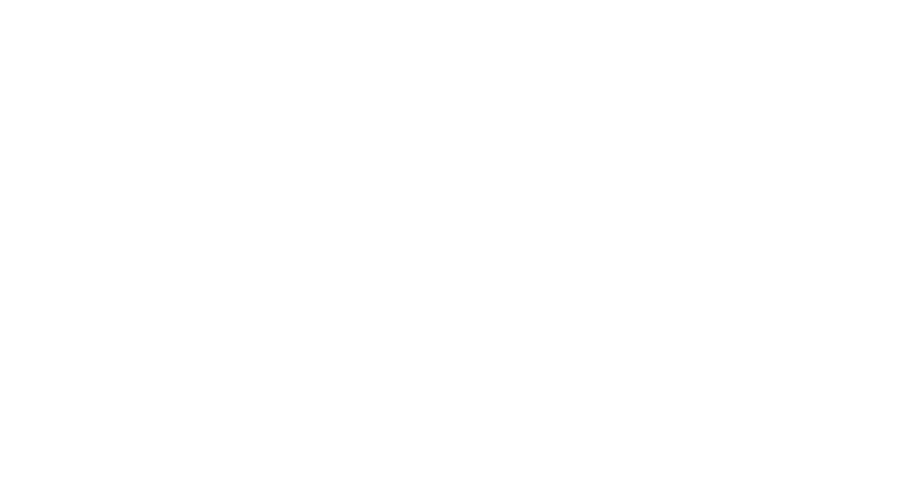

<IPython.core.display.Javascript object>


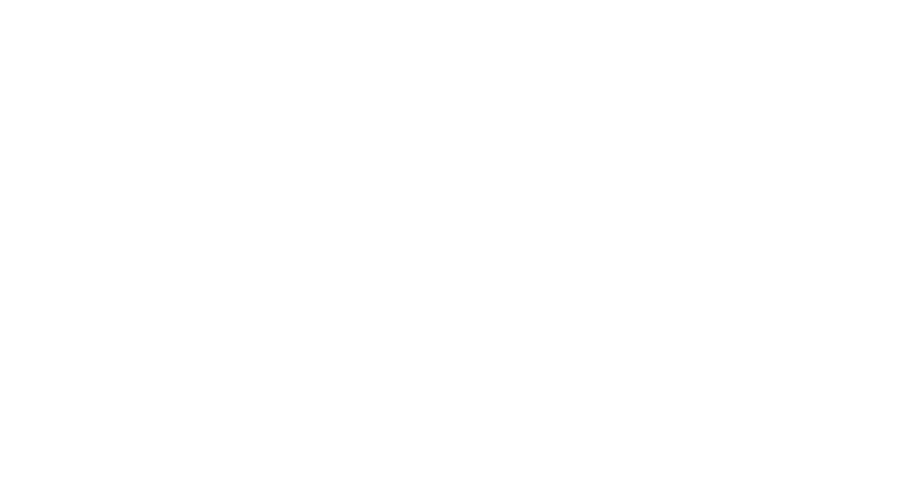

<IPython.core.display.Javascript object>


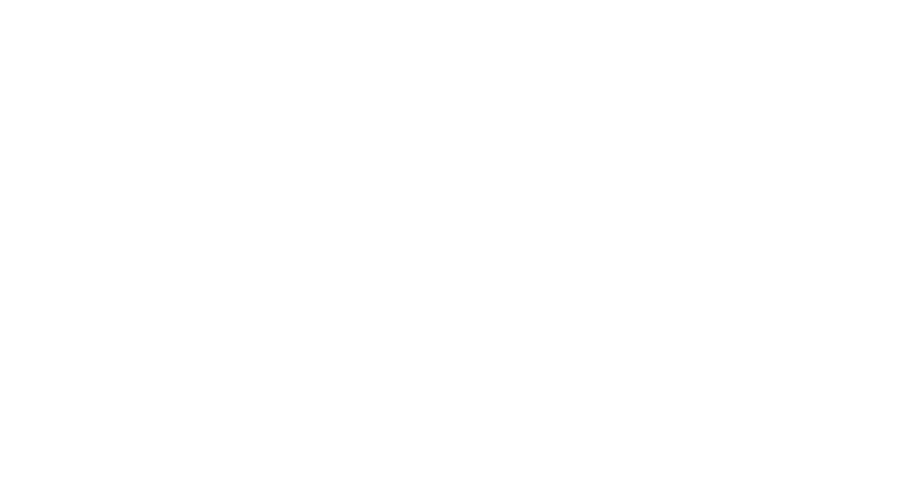

<IPython.core.display.Javascript object>


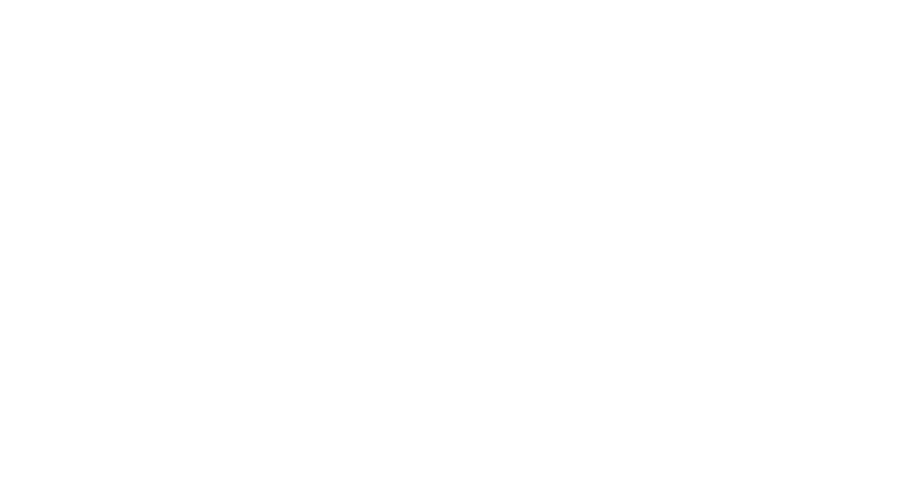

<IPython.core.display.Javascript object>


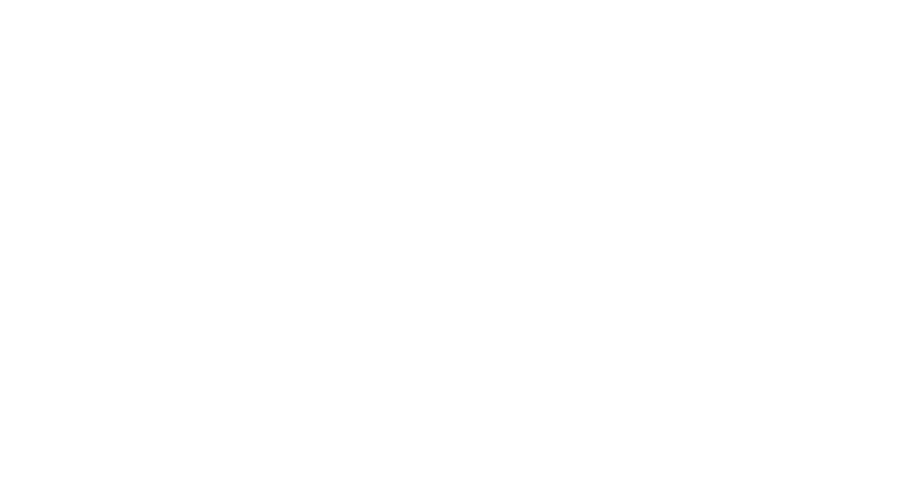

<IPython.core.display.Javascript object>


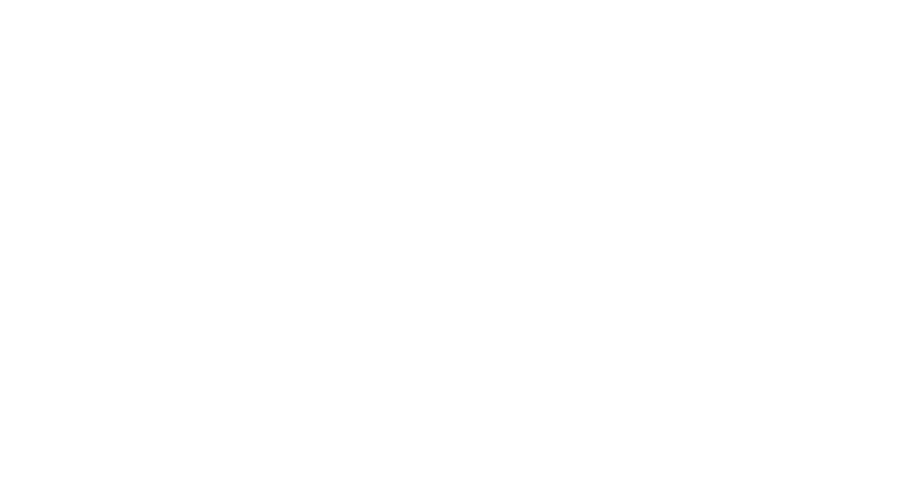

<IPython.core.display.Javascript object>


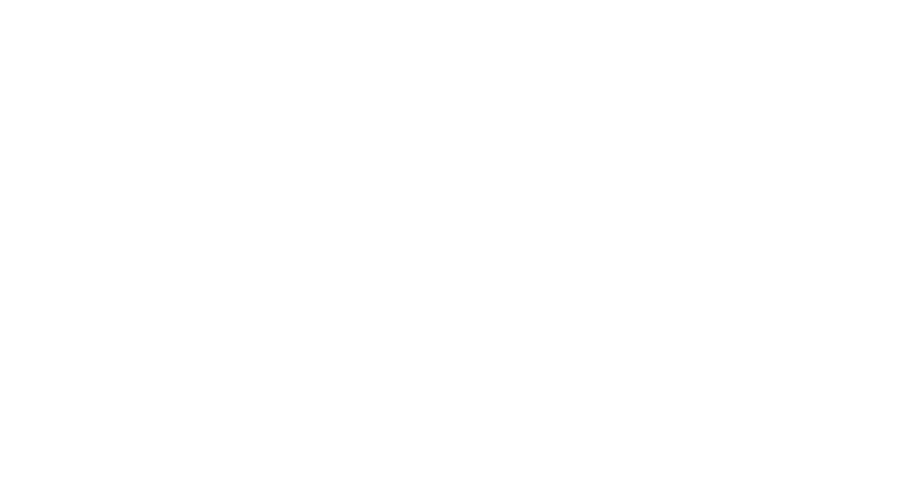

<IPython.core.display.Javascript object>


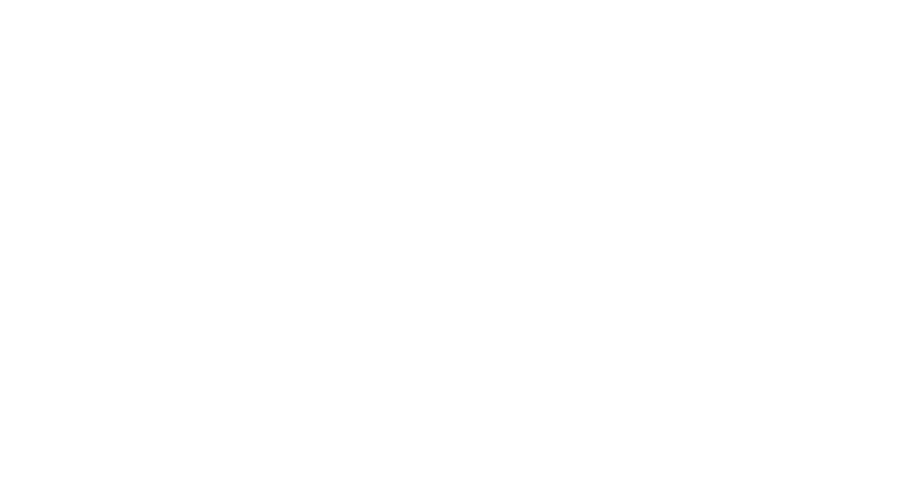

<IPython.core.display.Javascript object>


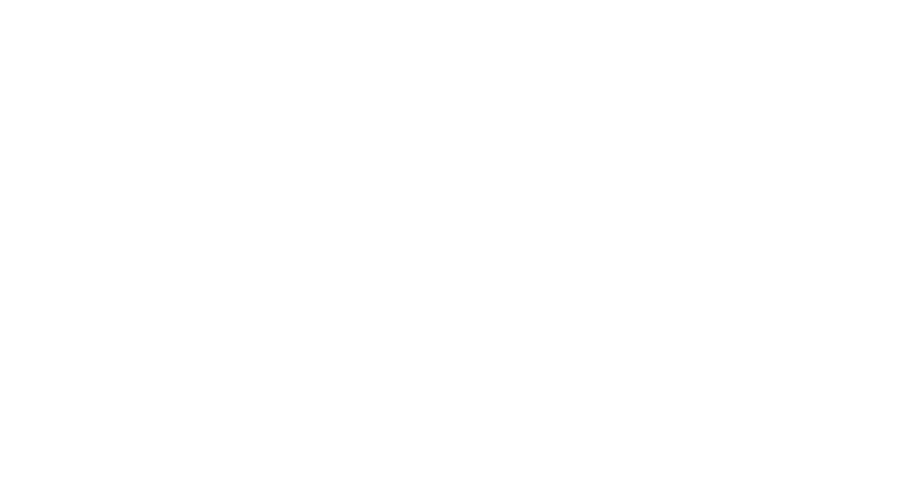

<IPython.core.display.Javascript object>


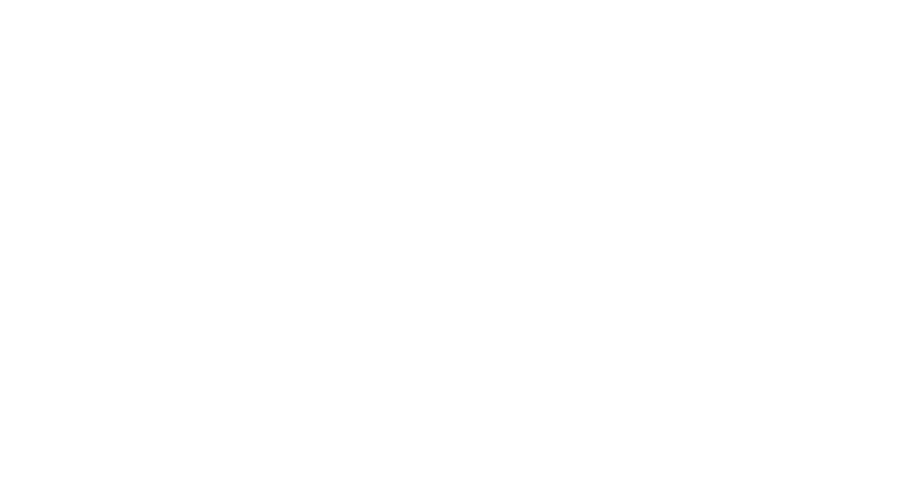

<IPython.core.display.Javascript object>


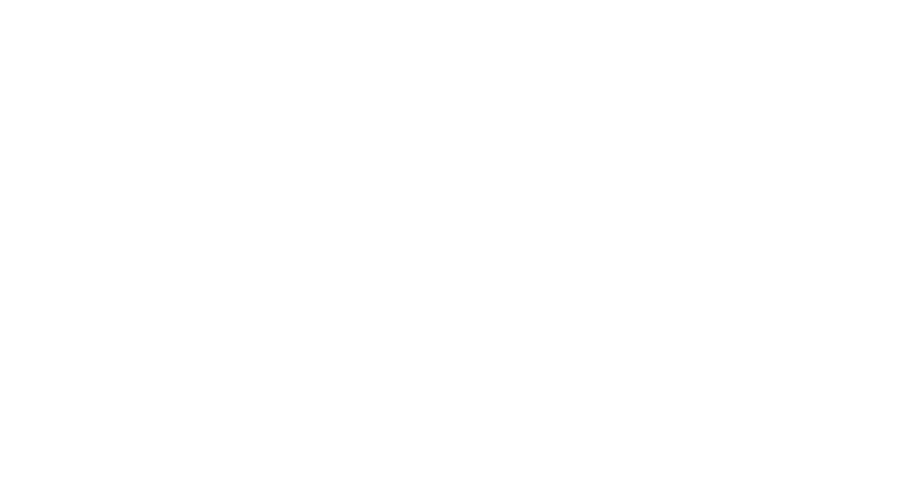

<IPython.core.display.Javascript object>


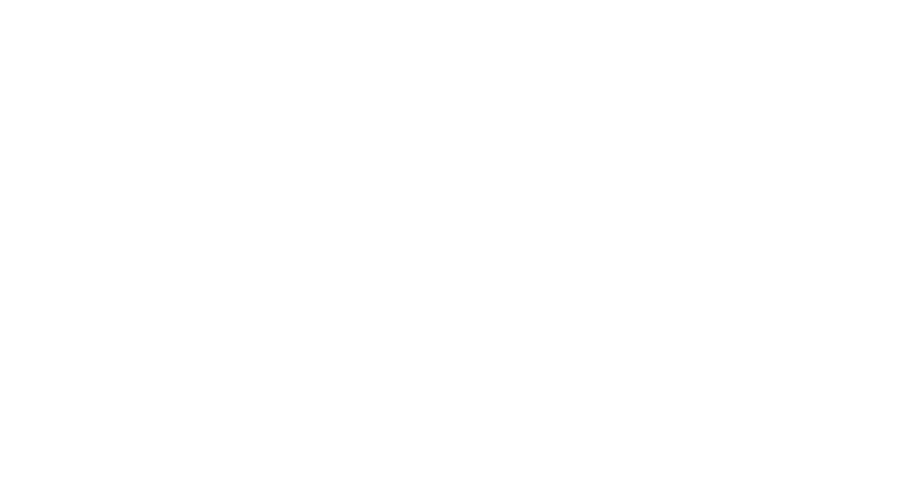

<IPython.core.display.Javascript object>


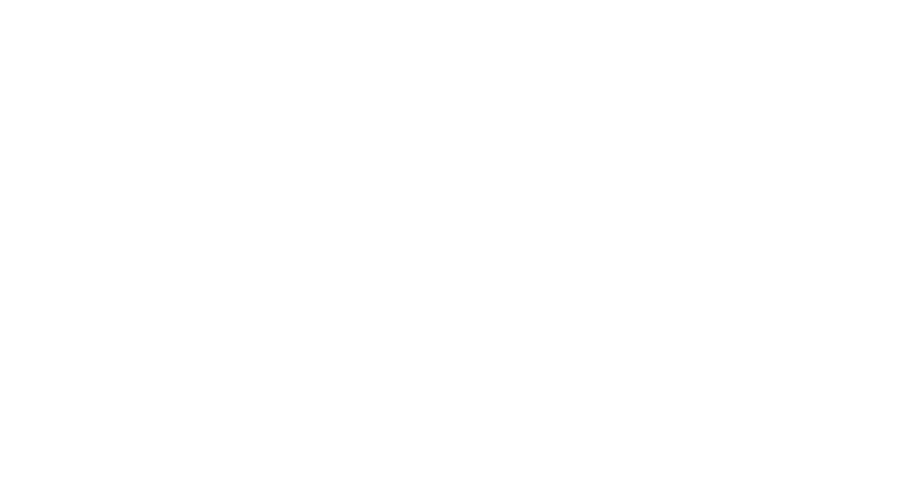

<IPython.core.display.Javascript object>


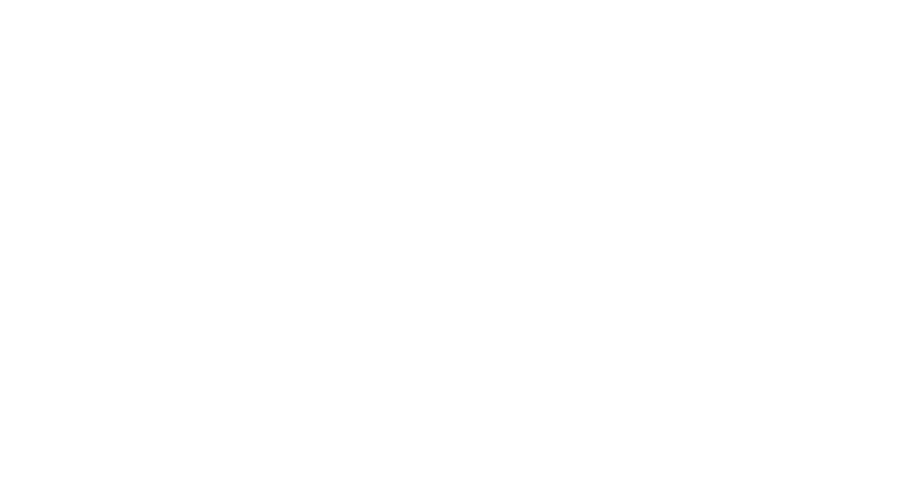

<IPython.core.display.Javascript object>


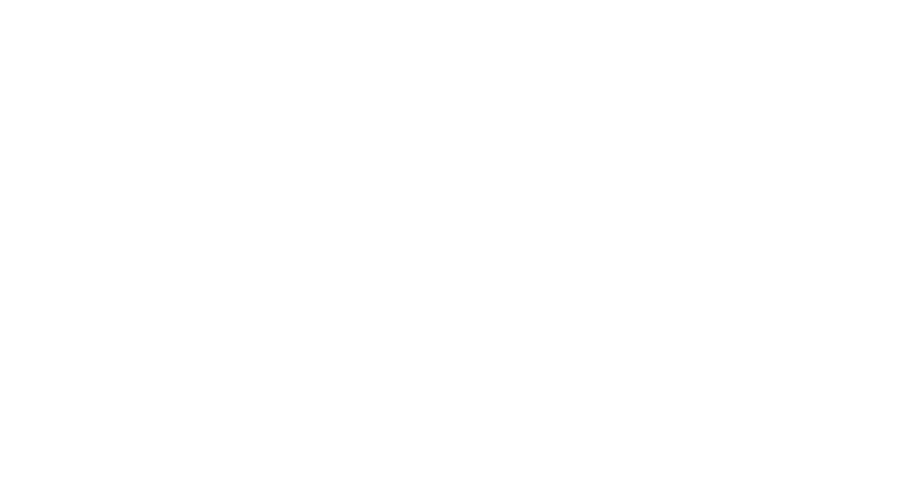

<IPython.core.display.Javascript object>


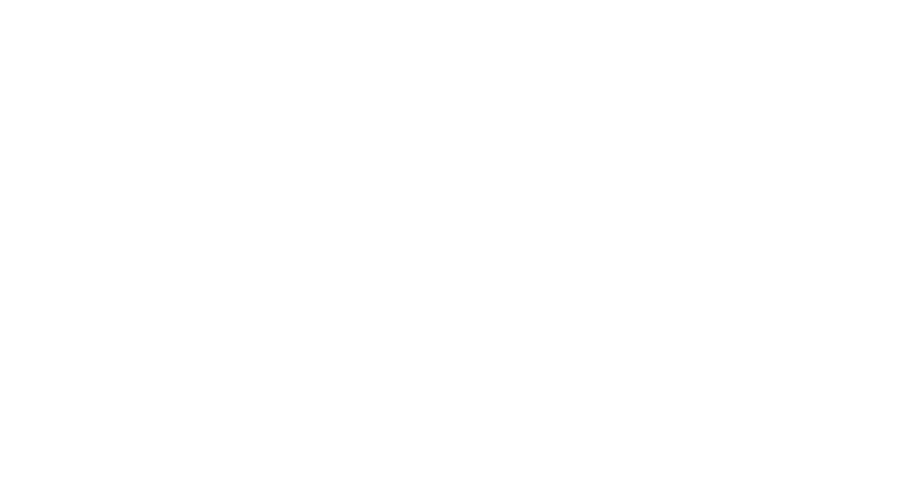

<IPython.core.display.Javascript object>


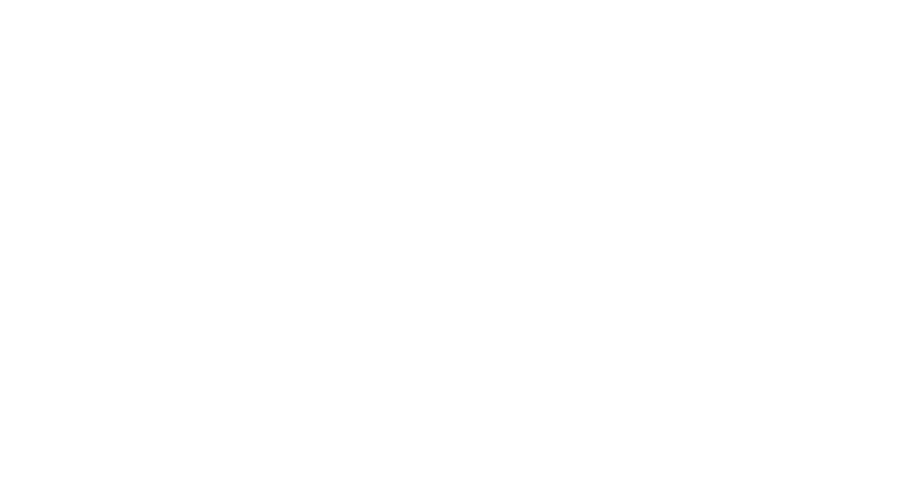

<IPython.core.display.Javascript object>


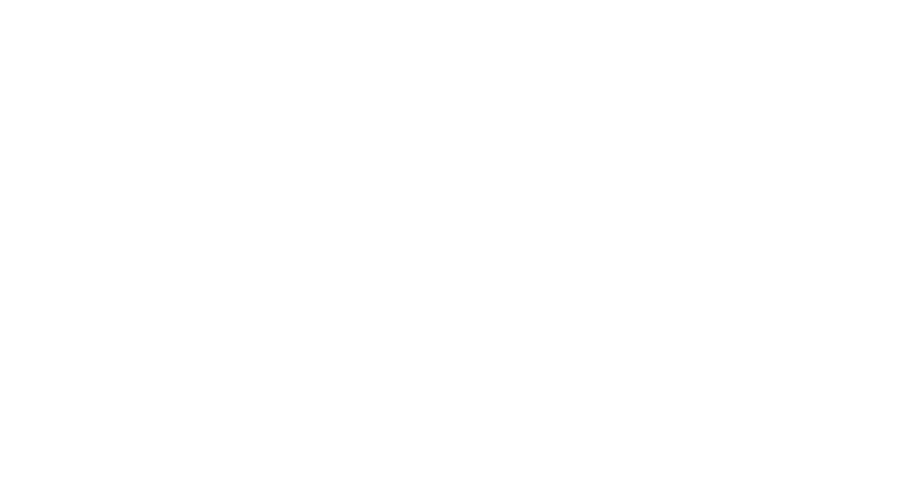

<IPython.core.display.Javascript object>


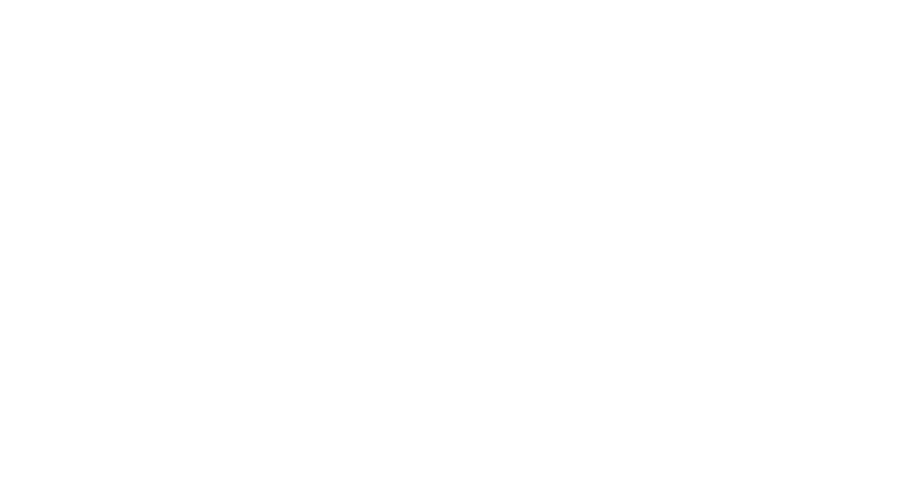

<IPython.core.display.Javascript object>


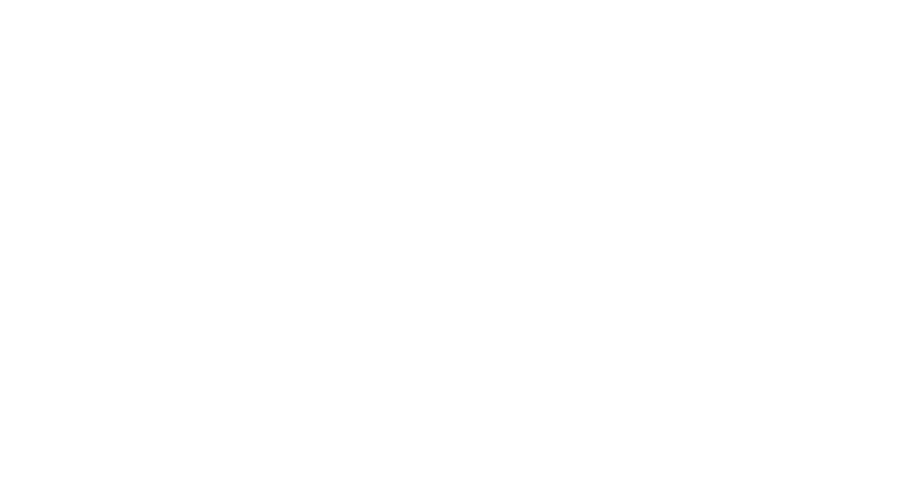

<IPython.core.display.Javascript object>


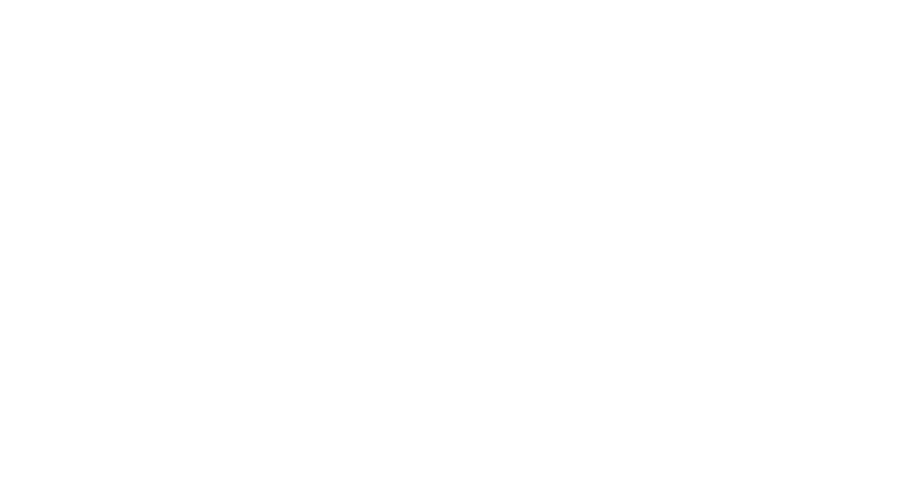

<IPython.core.display.Javascript object>


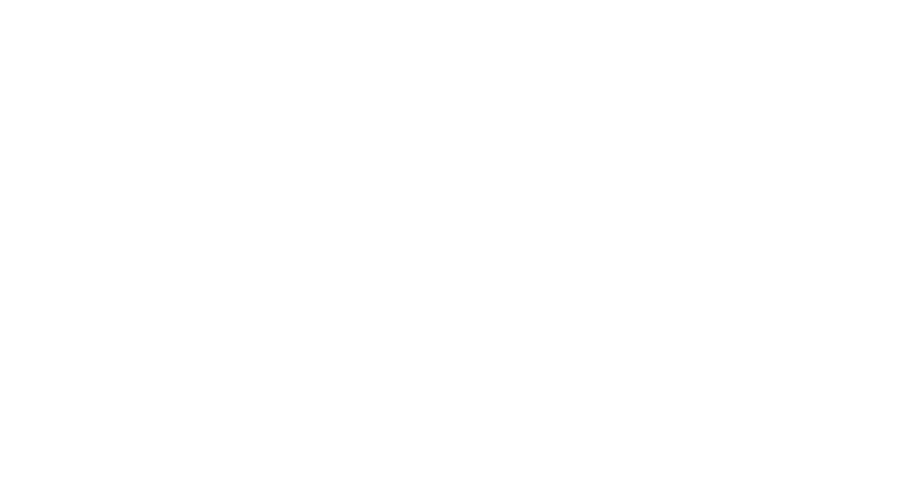

<IPython.core.display.Javascript object>


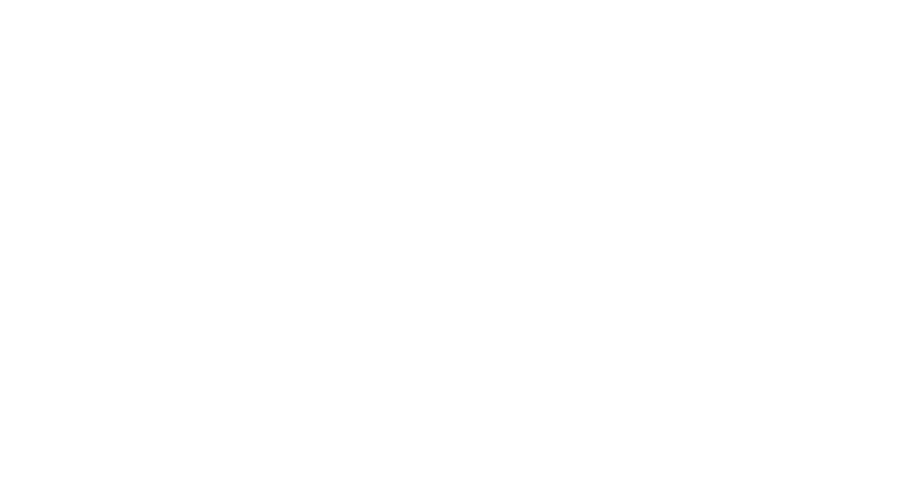

<IPython.core.display.Javascript object>


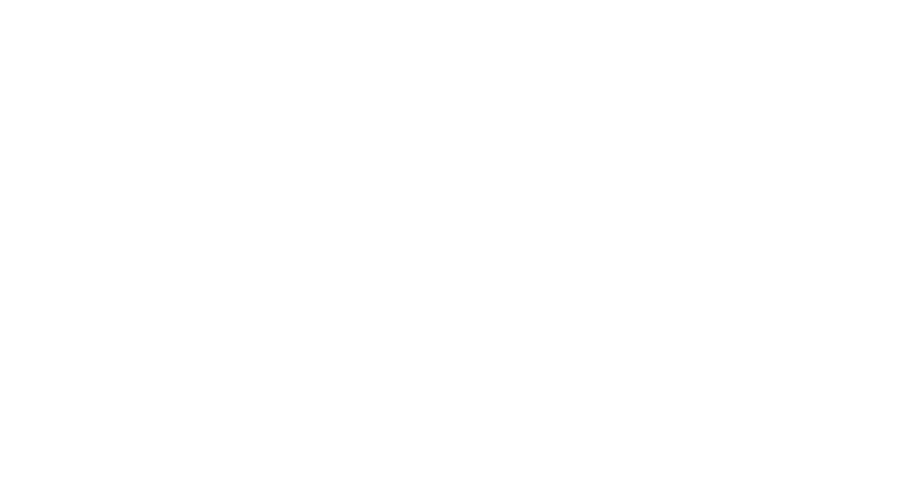

<IPython.core.display.Javascript object>


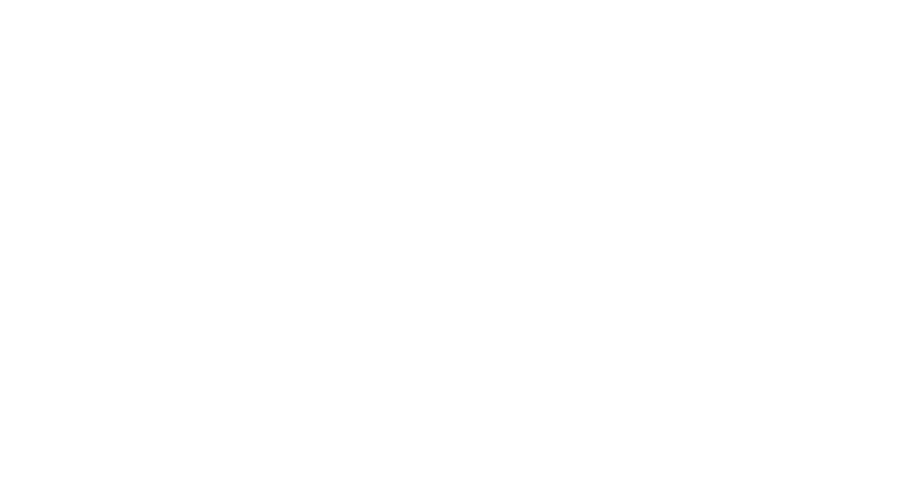

<IPython.core.display.Javascript object>


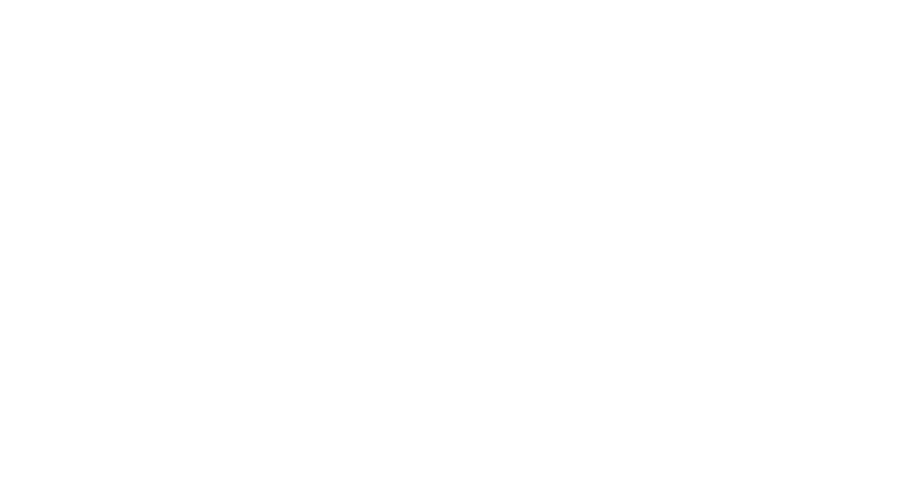

<IPython.core.display.Javascript object>


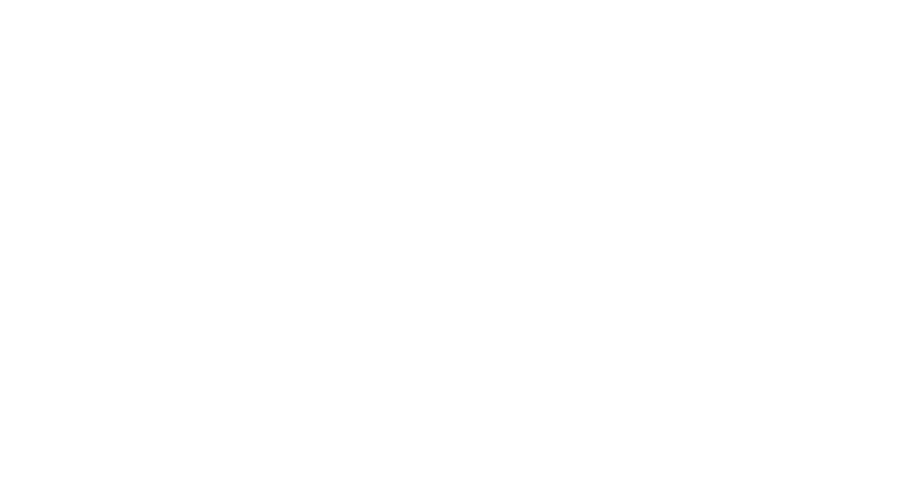

<IPython.core.display.Javascript object>


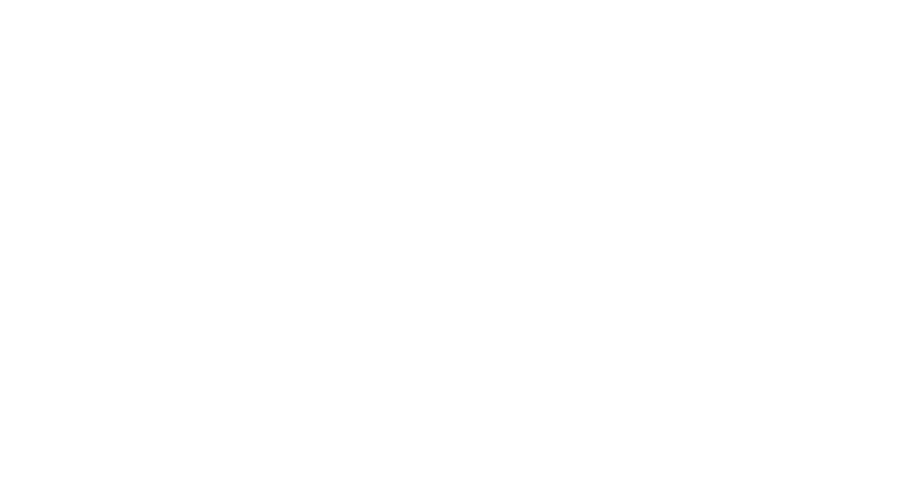

<IPython.core.display.Javascript object>


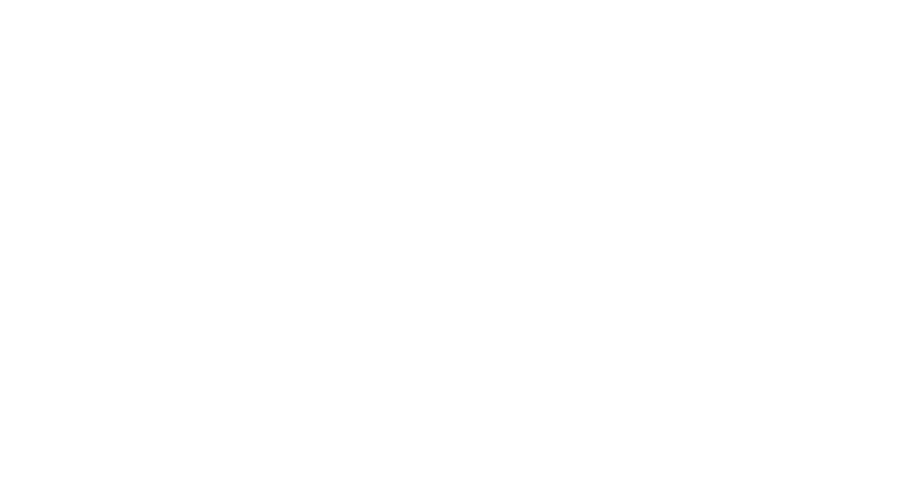

<IPython.core.display.Javascript object>


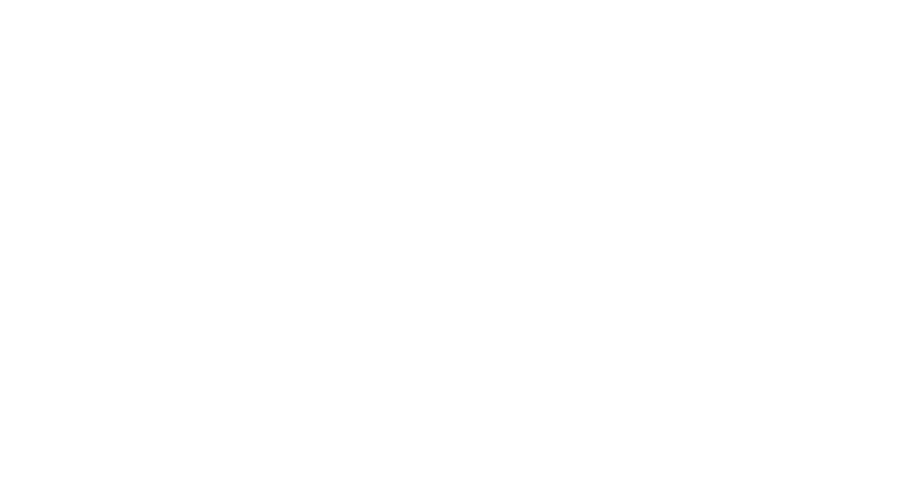

<IPython.core.display.Javascript object>


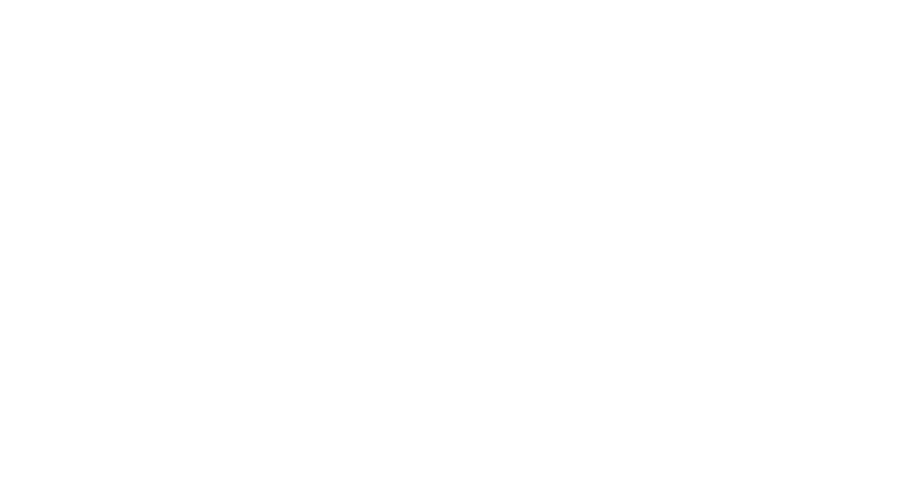

<IPython.core.display.Javascript object>


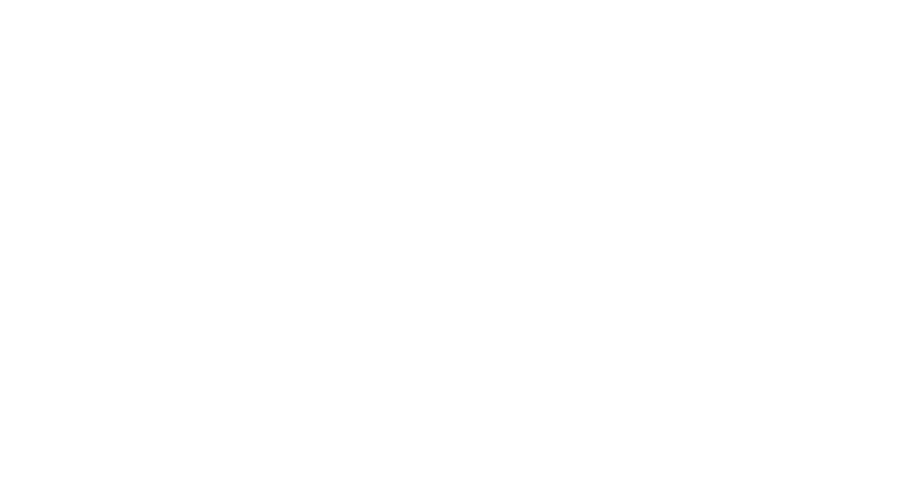

<IPython.core.display.Javascript object>


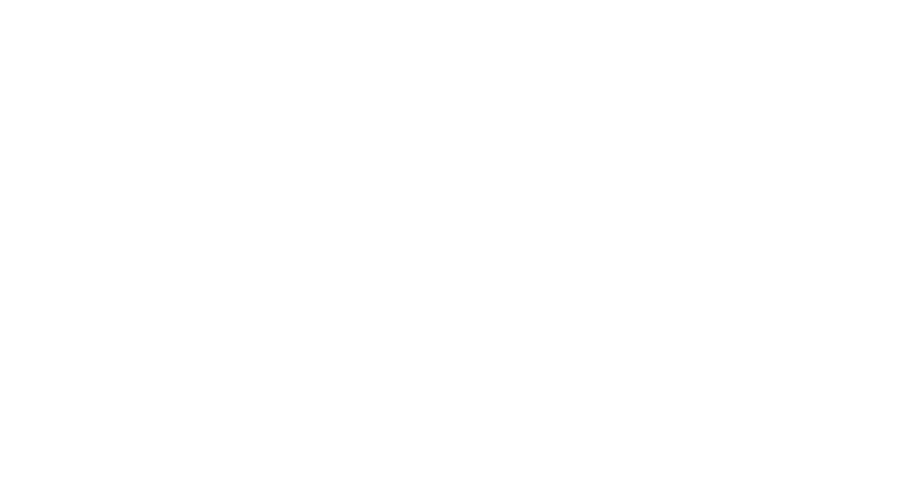

<IPython.core.display.Javascript object>


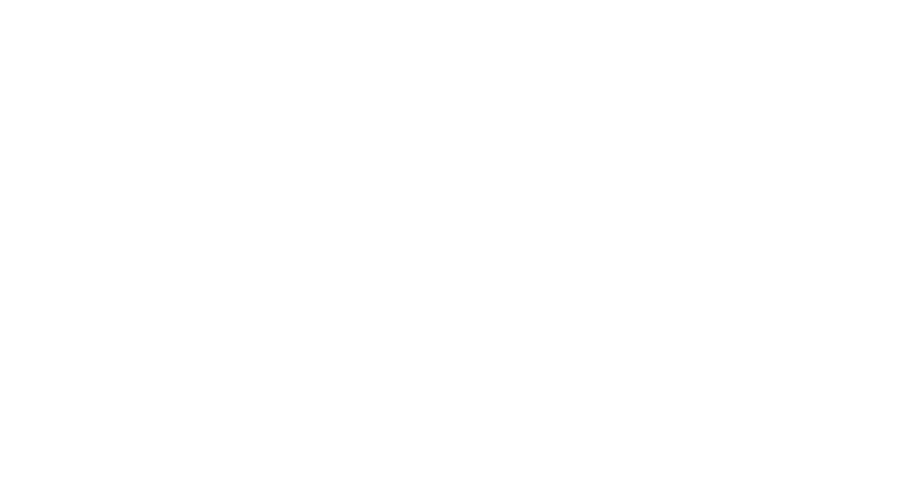

<IPython.core.display.Javascript object>


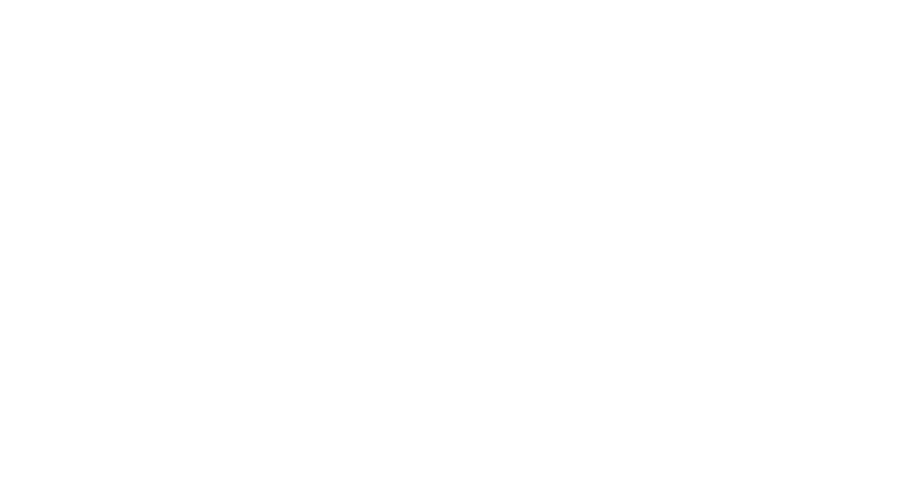

<IPython.core.display.Javascript object>


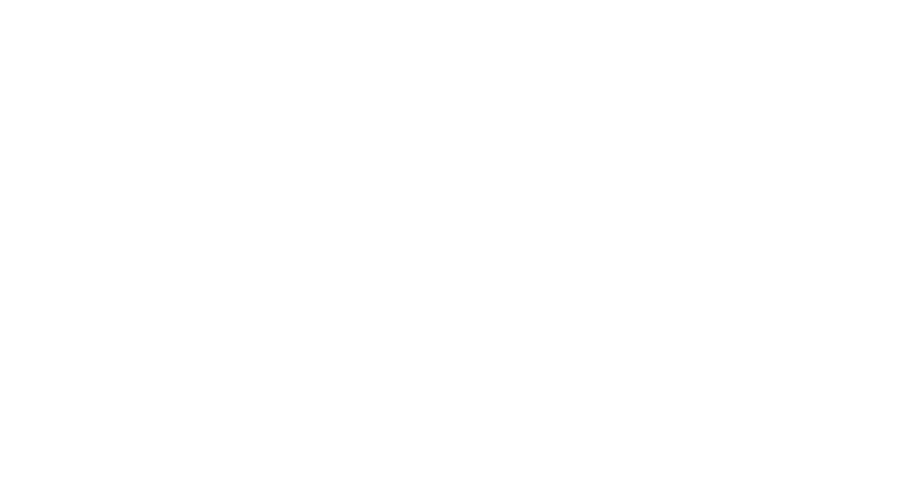

<IPython.core.display.Javascript object>


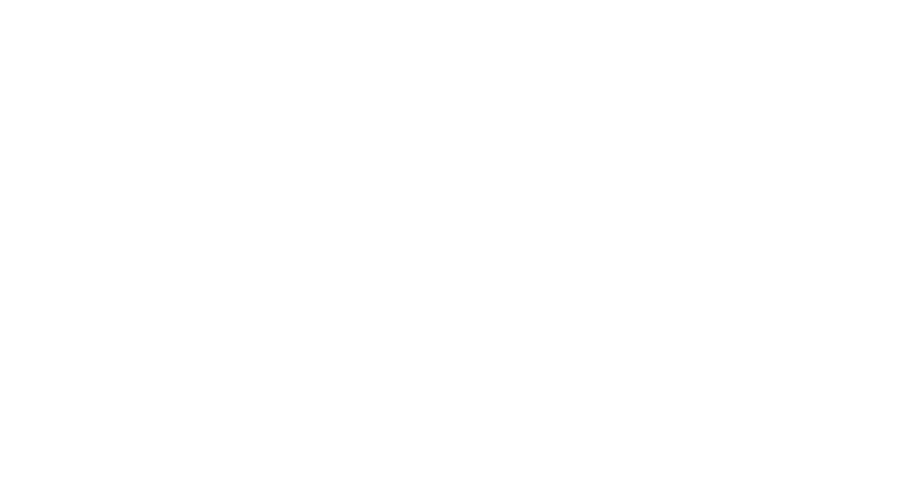

<IPython.core.display.Javascript object>


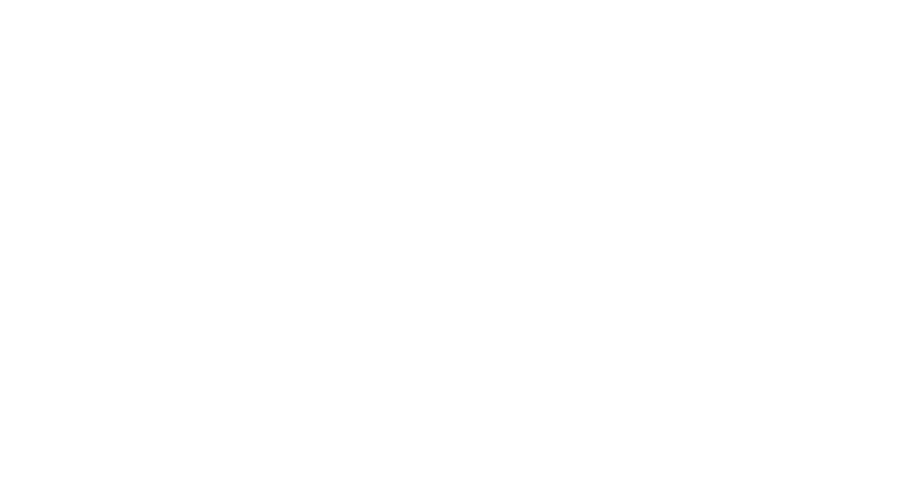

<IPython.core.display.Javascript object>


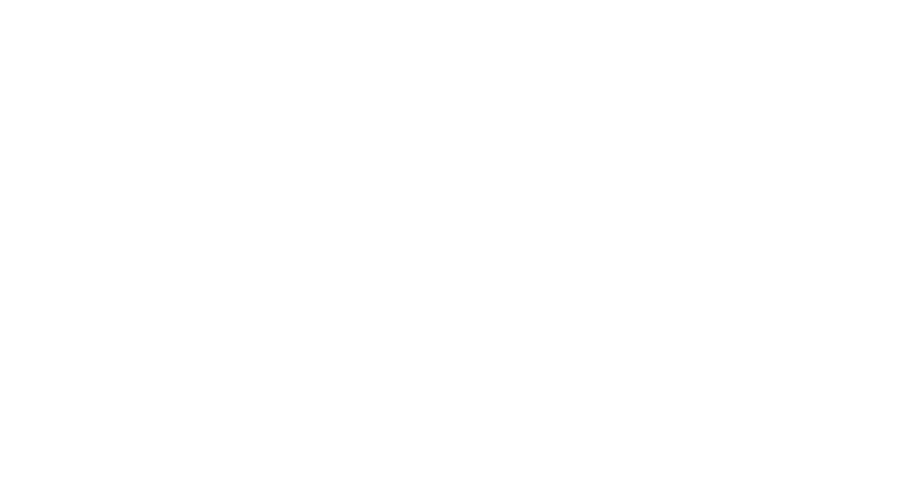

<IPython.core.display.Javascript object>


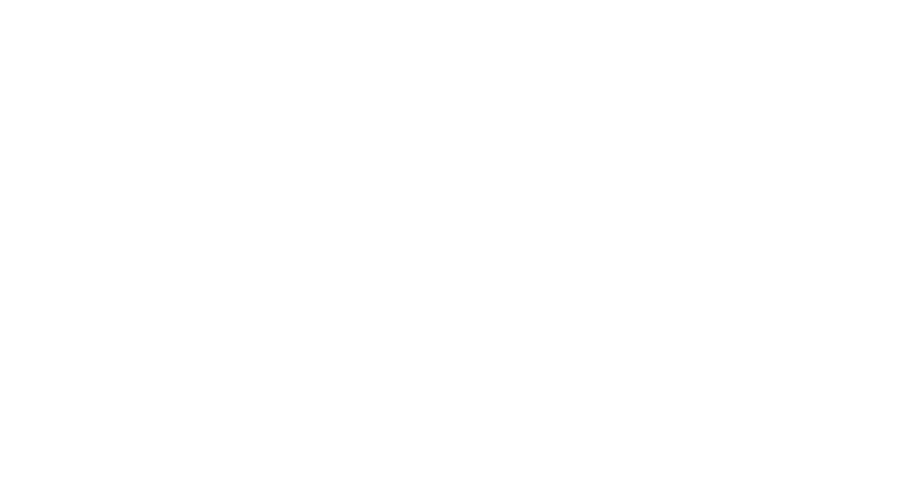

<IPython.core.display.Javascript object>


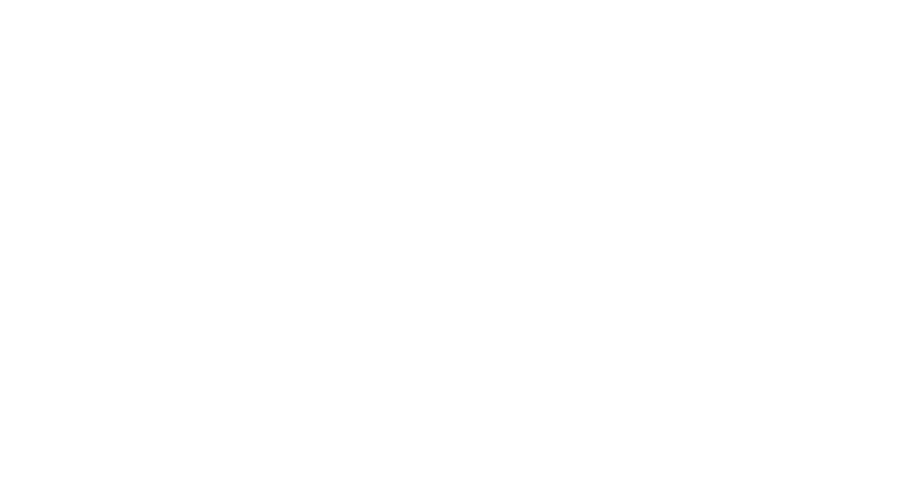

<IPython.core.display.Javascript object>


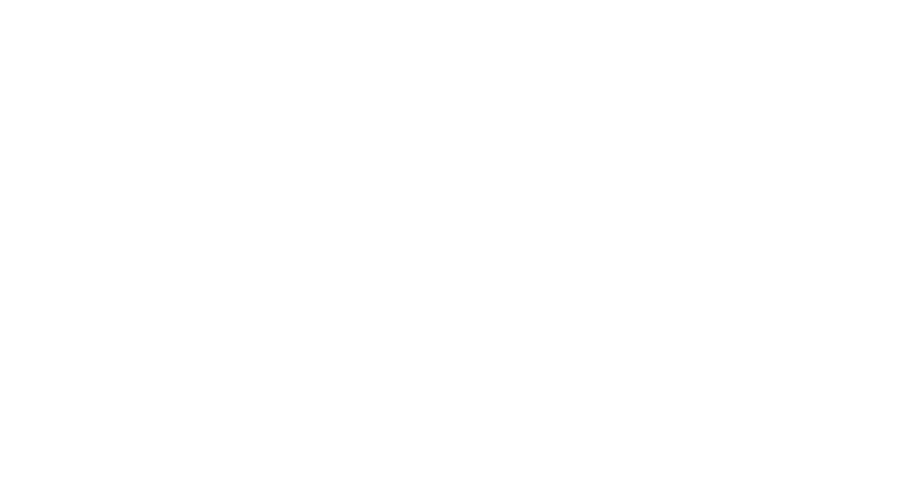

<IPython.core.display.Javascript object>


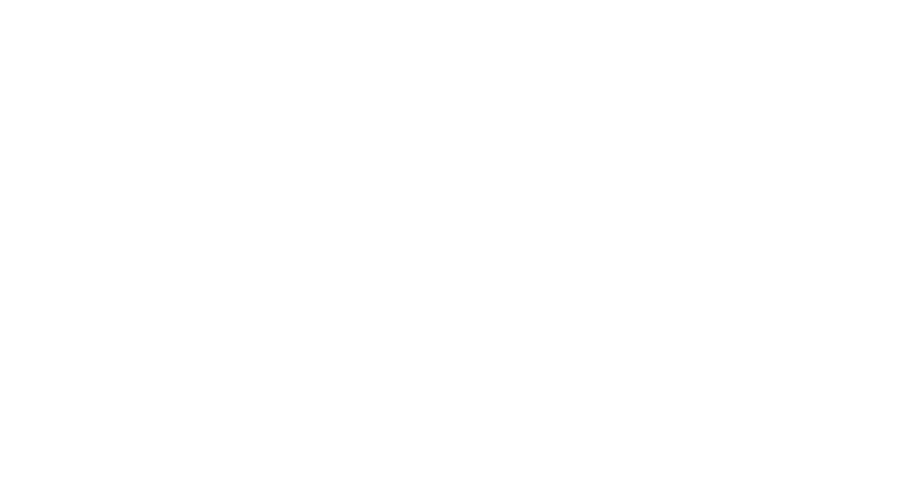

<IPython.core.display.Javascript object>


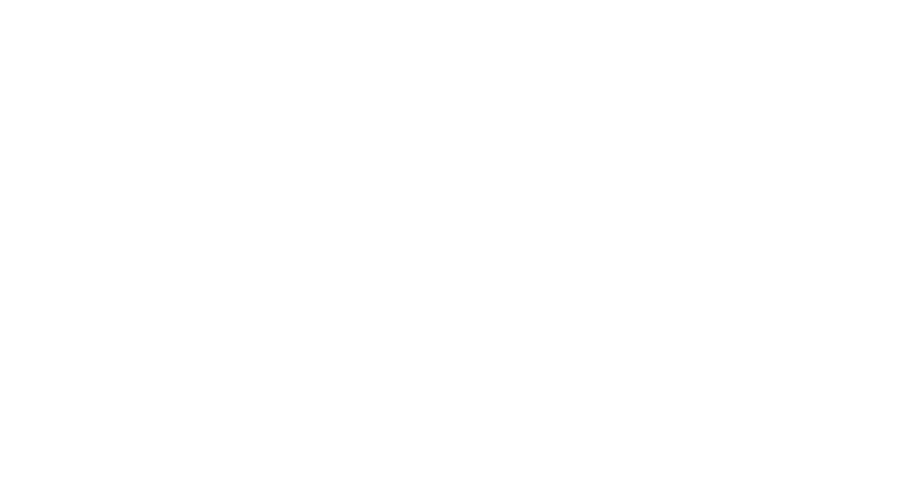

<IPython.core.display.Javascript object>


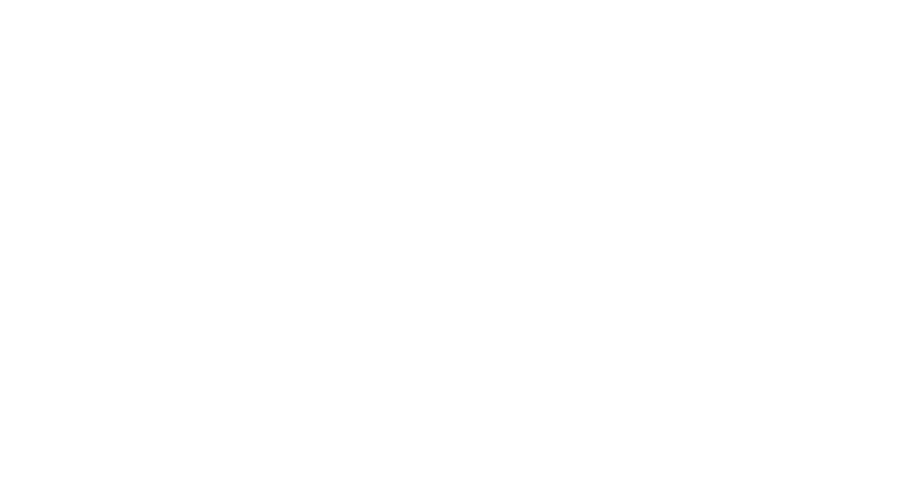

<IPython.core.display.Javascript object>


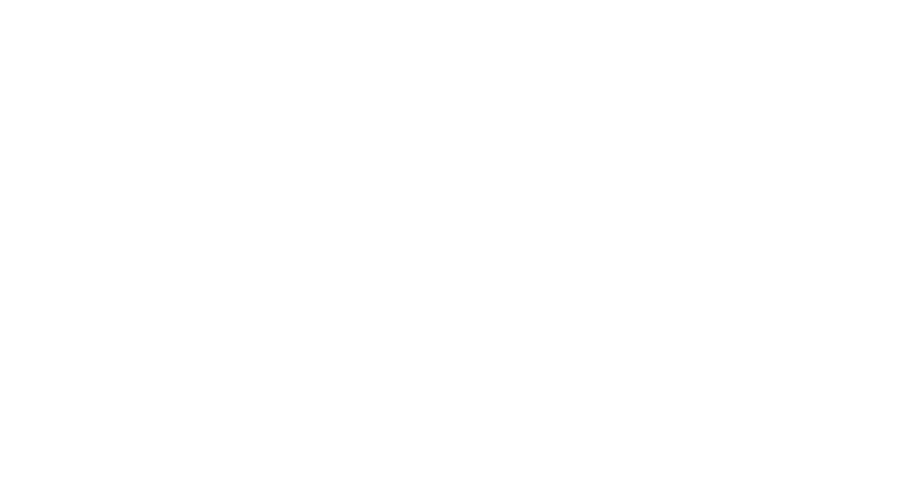

<IPython.core.display.Javascript object>


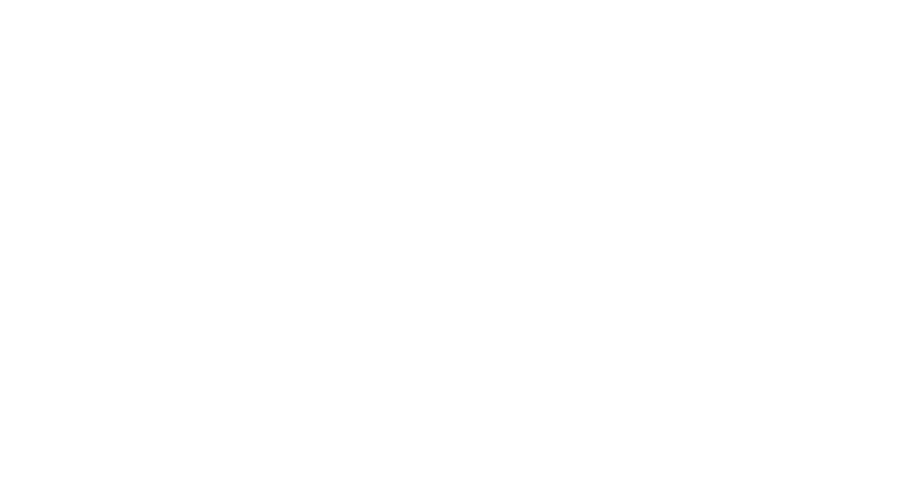

<IPython.core.display.Javascript object>


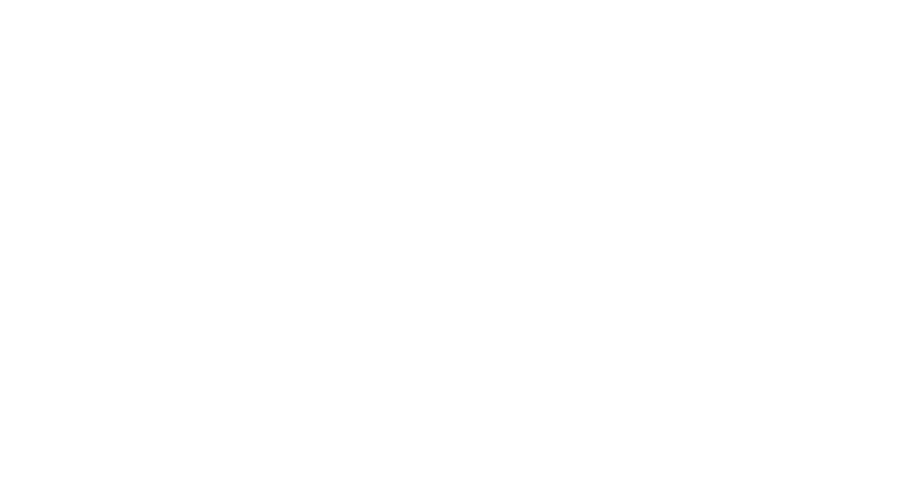

<IPython.core.display.Javascript object>


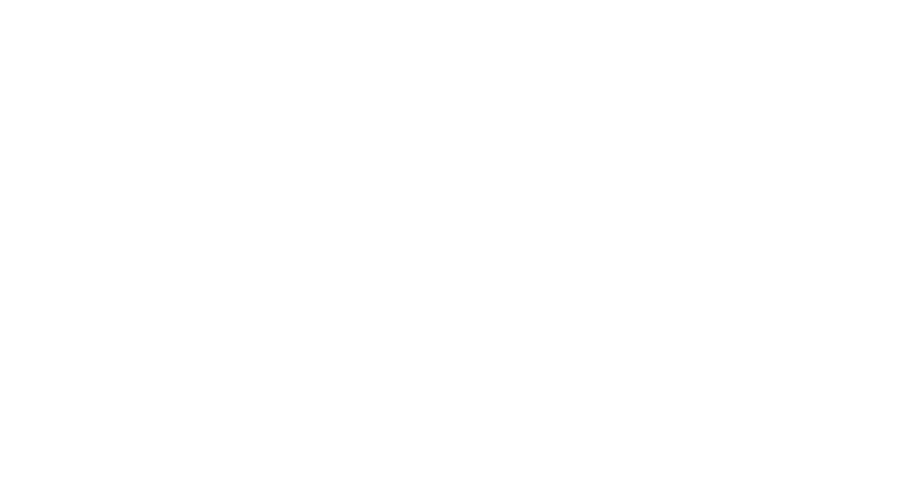

<IPython.core.display.Javascript object>


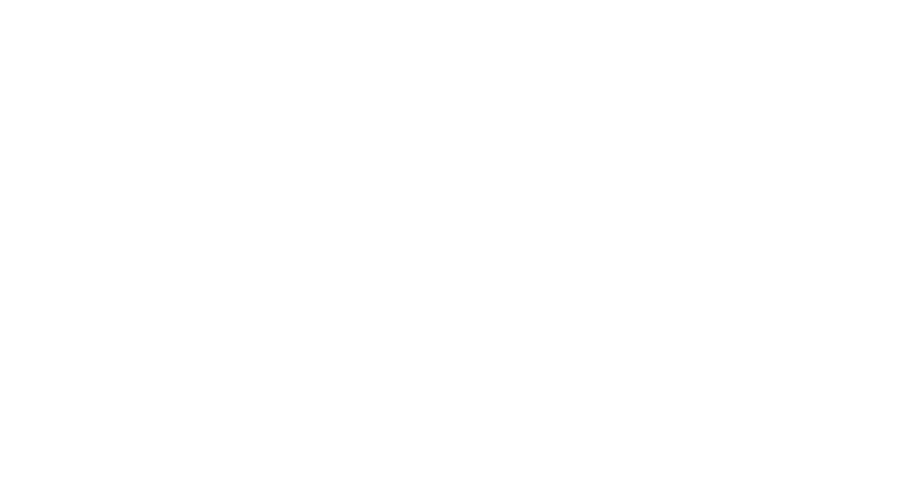

<IPython.core.display.Javascript object>


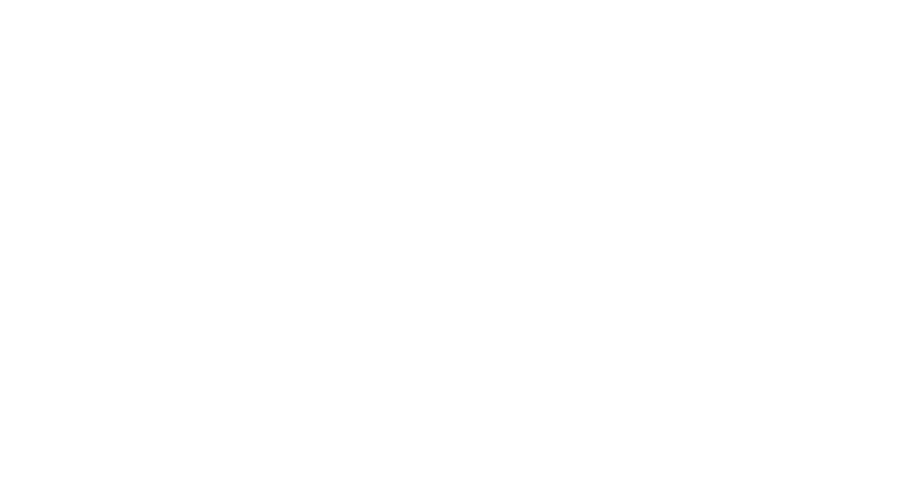

<IPython.core.display.Javascript object>


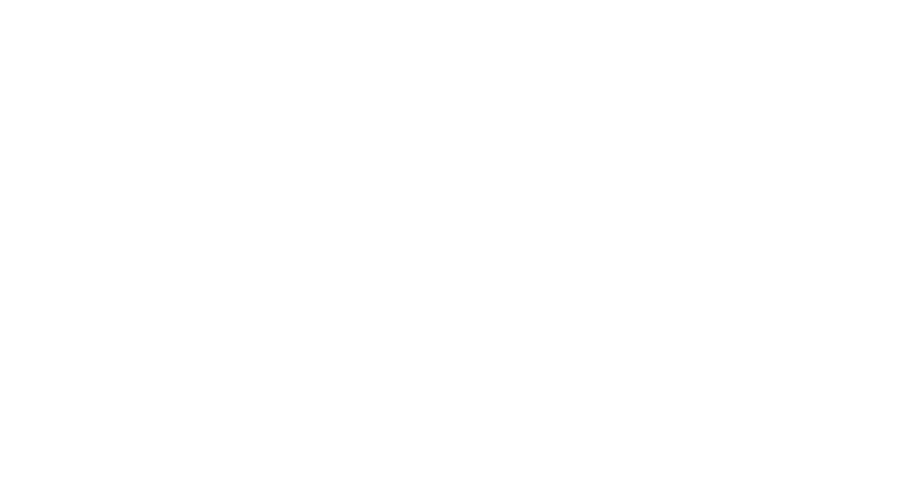

<IPython.core.display.Javascript object>


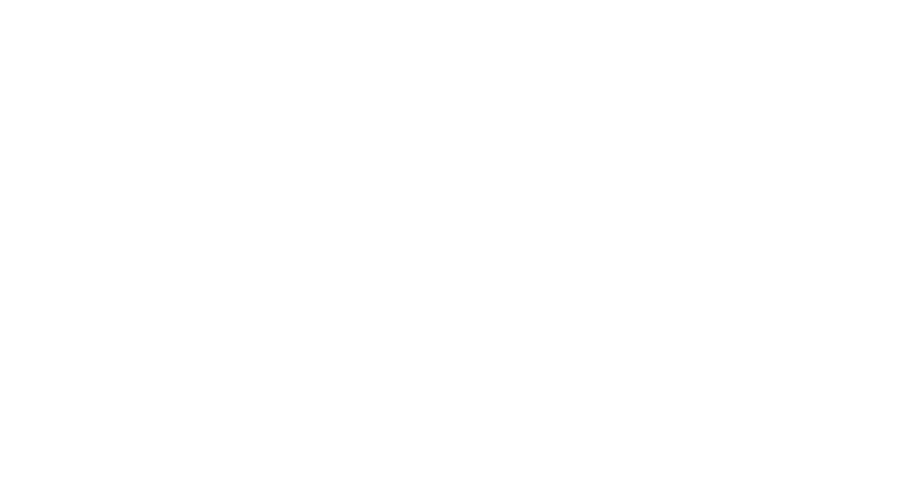

<IPython.core.display.Javascript object>


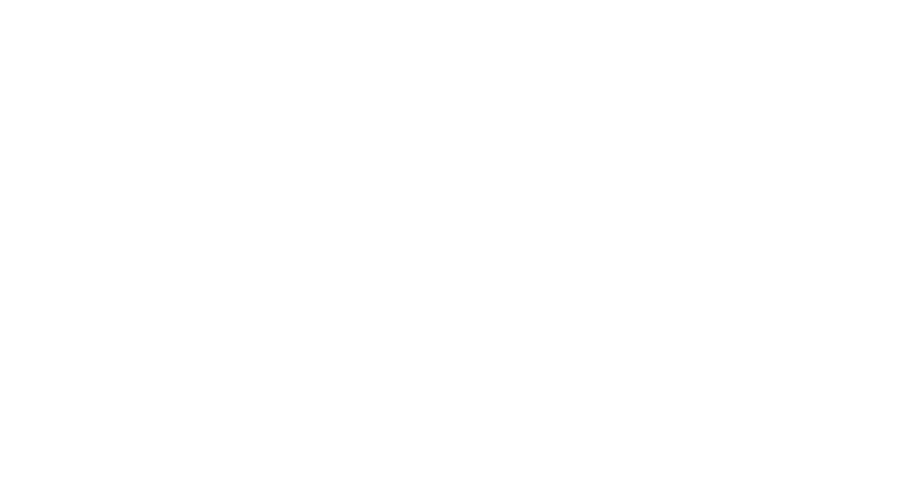

<IPython.core.display.Javascript object>


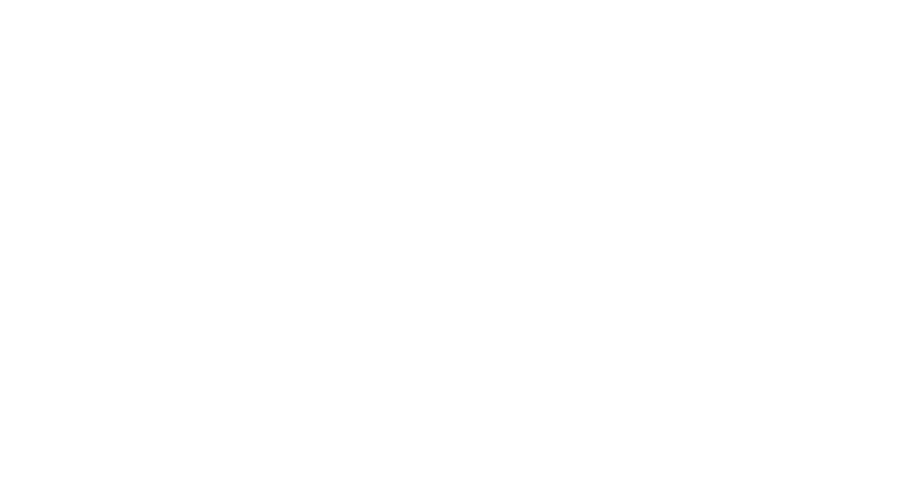

<IPython.core.display.Javascript object>


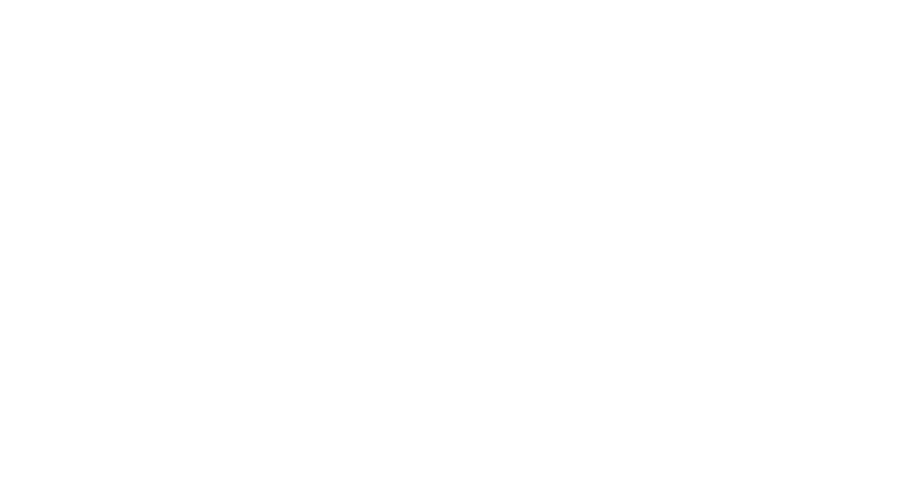

<IPython.core.display.Javascript object>


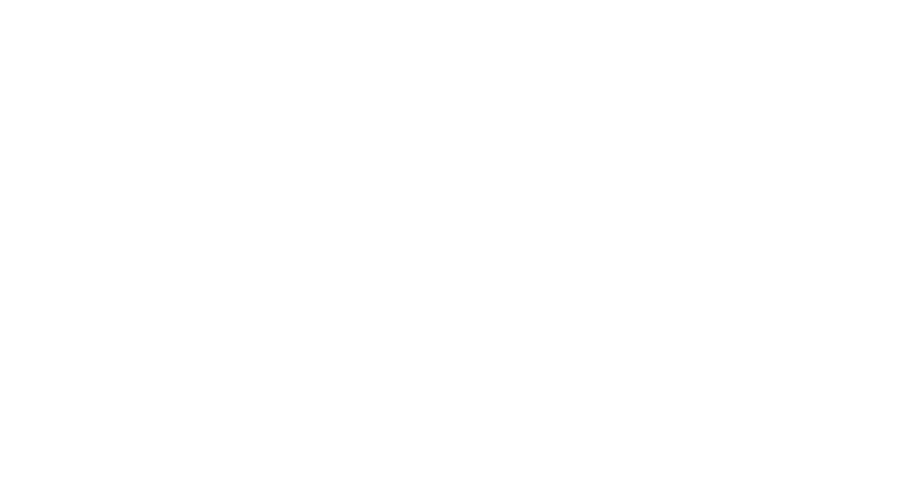

<IPython.core.display.Javascript object>


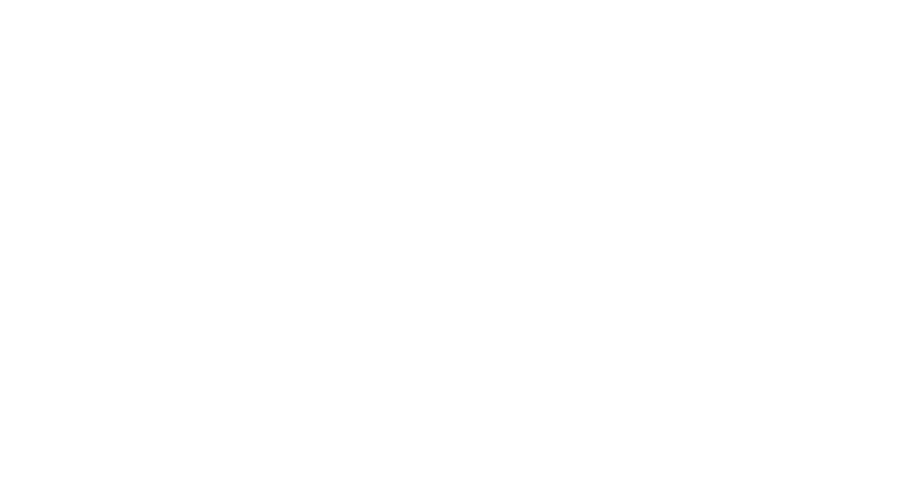

<IPython.core.display.Javascript object>


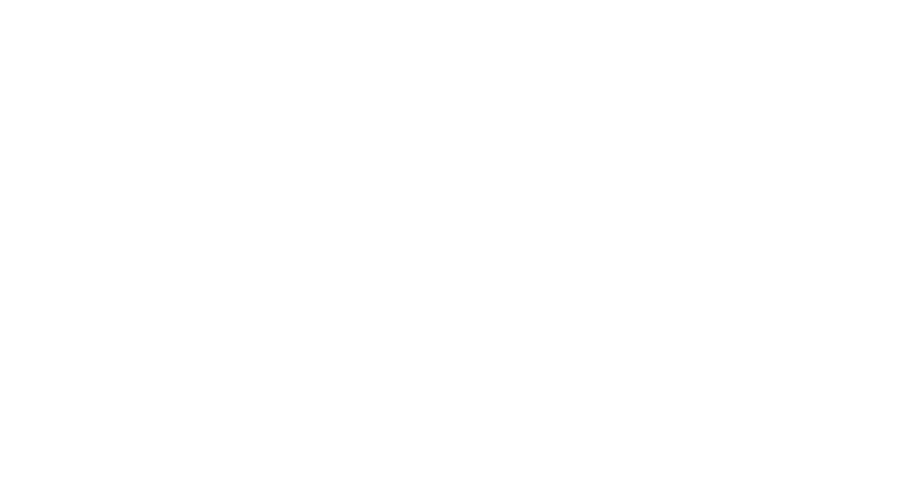

<IPython.core.display.Javascript object>


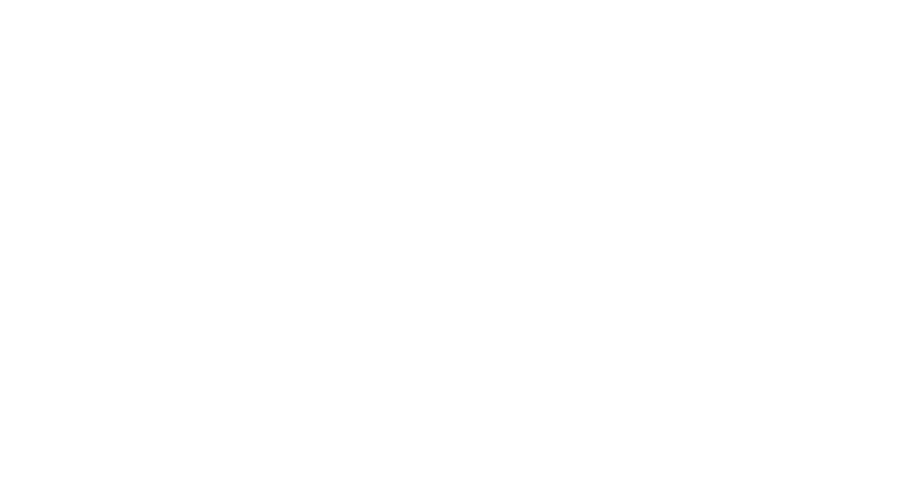

<IPython.core.display.Javascript object>


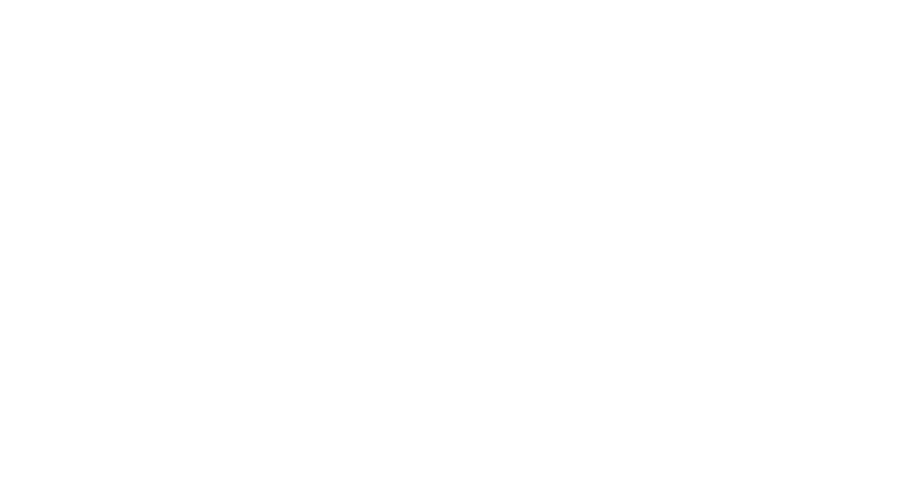

<IPython.core.display.Javascript object>


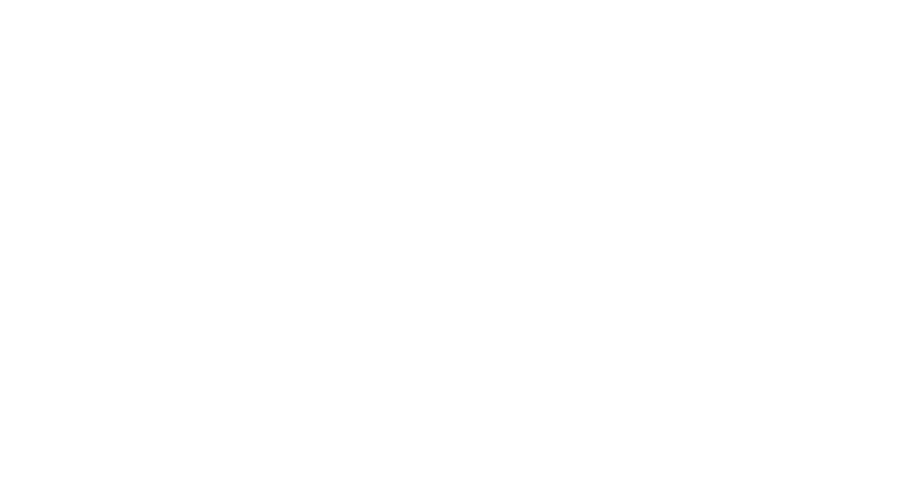

<IPython.core.display.Javascript object>


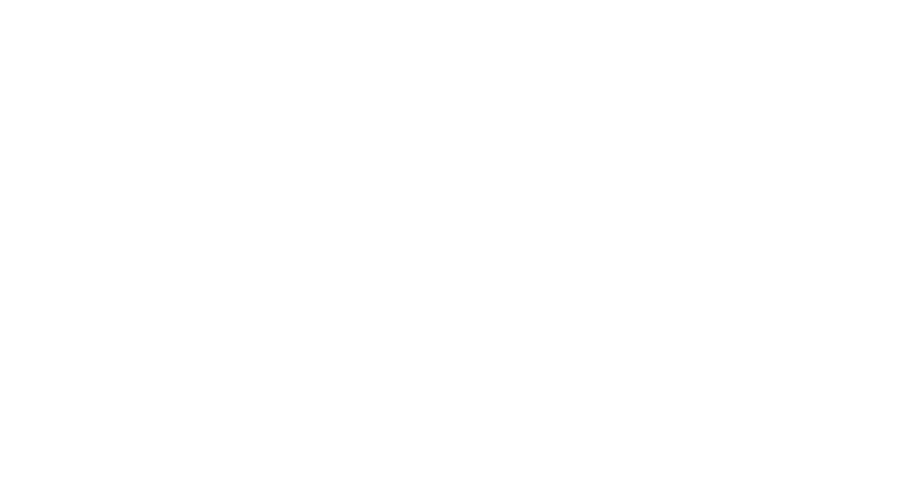

<IPython.core.display.Javascript object>


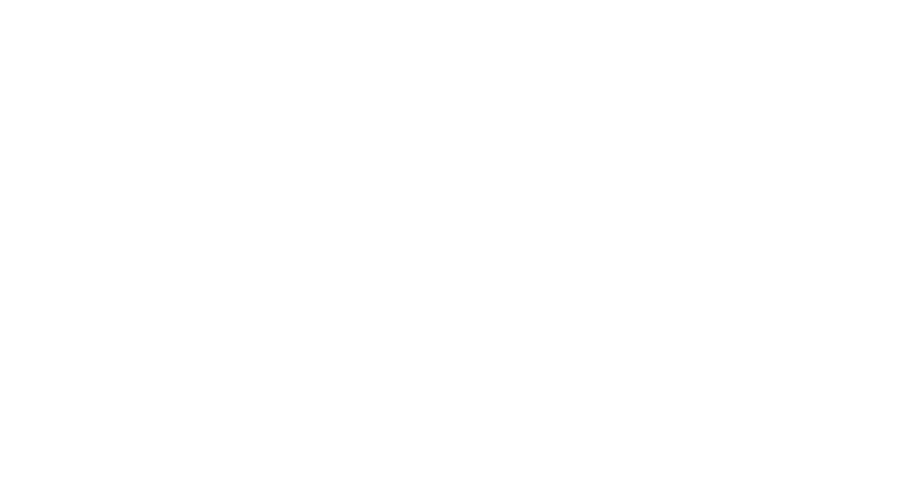

<IPython.core.display.Javascript object>


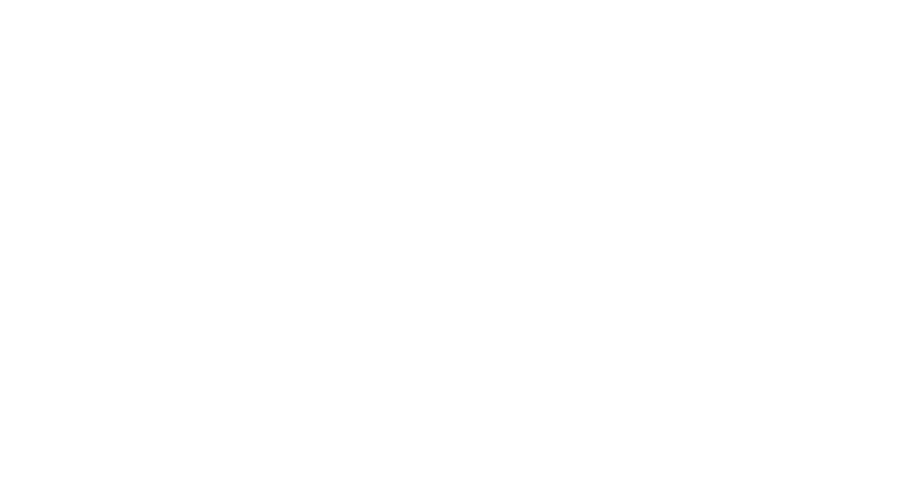

<IPython.core.display.Javascript object>


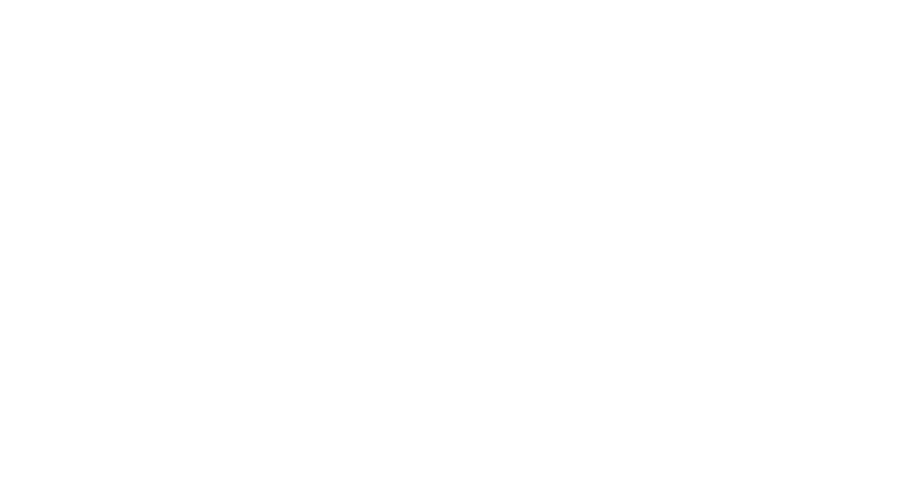

<IPython.core.display.Javascript object>


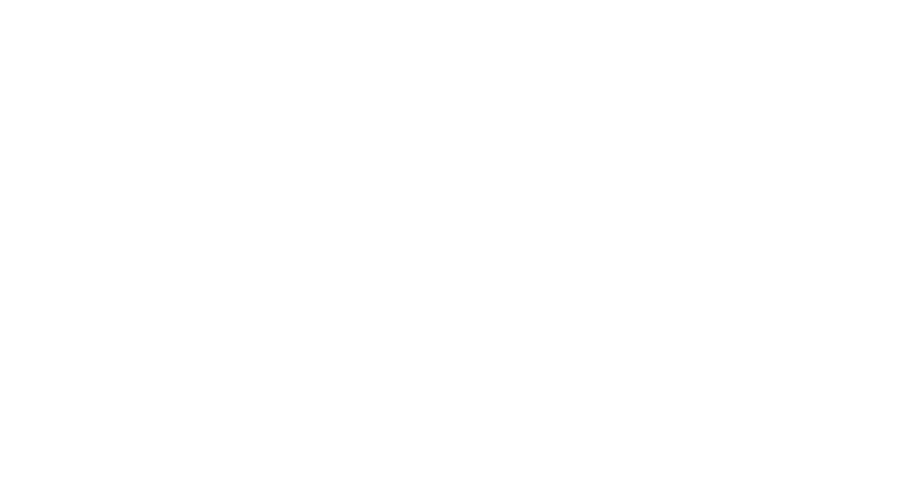

<IPython.core.display.Javascript object>


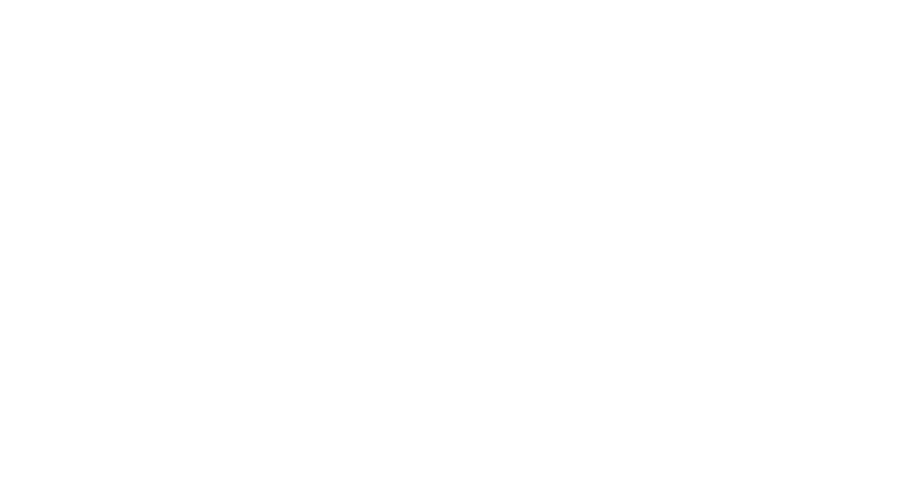

<IPython.core.display.Javascript object>


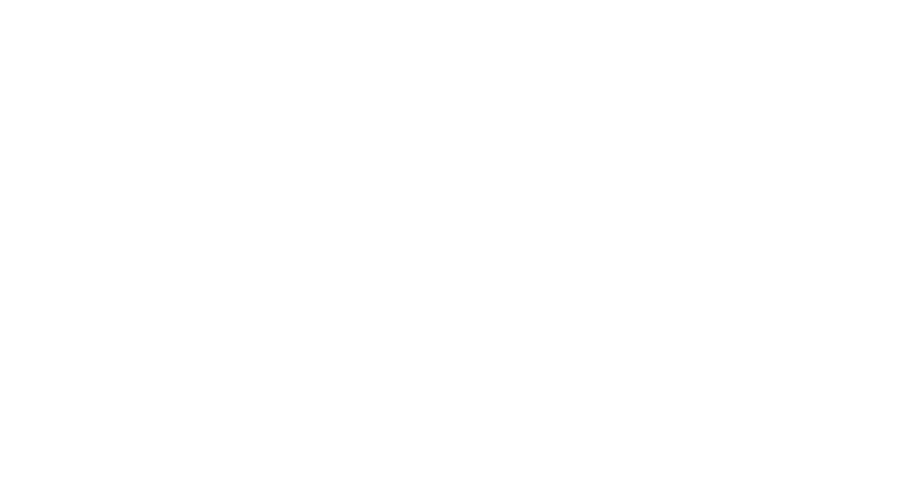

<IPython.core.display.Javascript object>


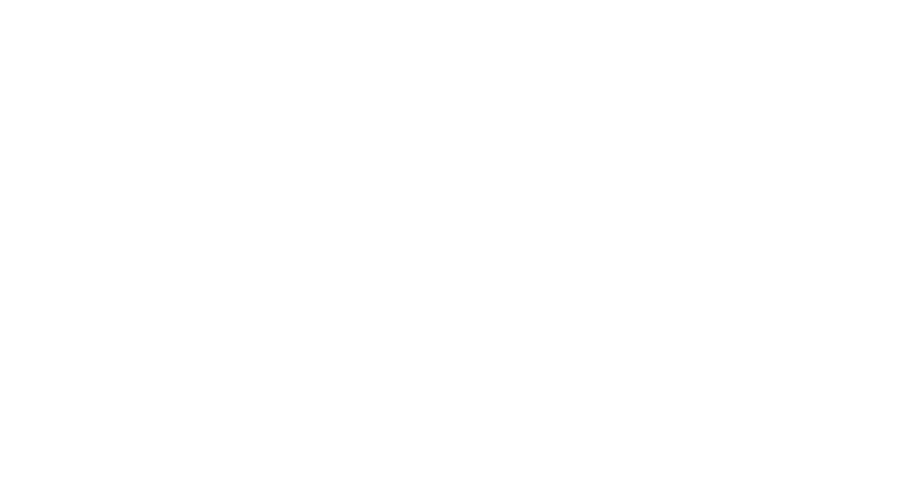

<IPython.core.display.Javascript object>


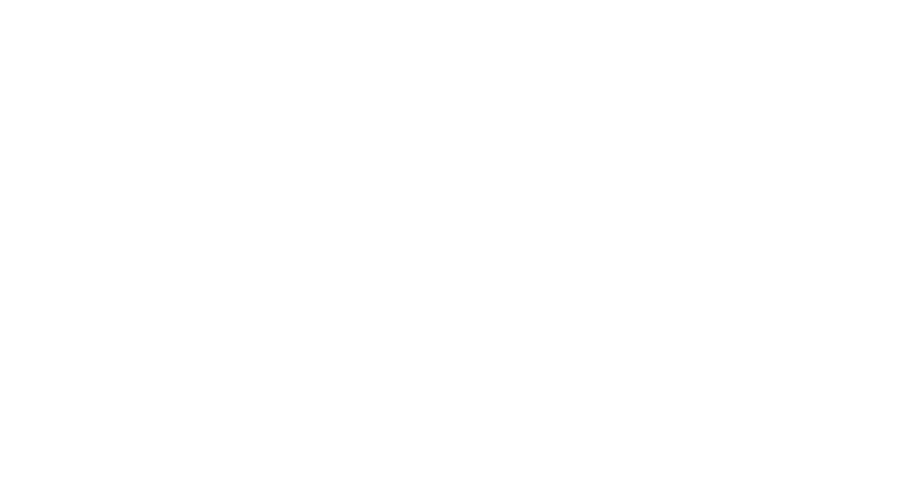

<IPython.core.display.Javascript object>


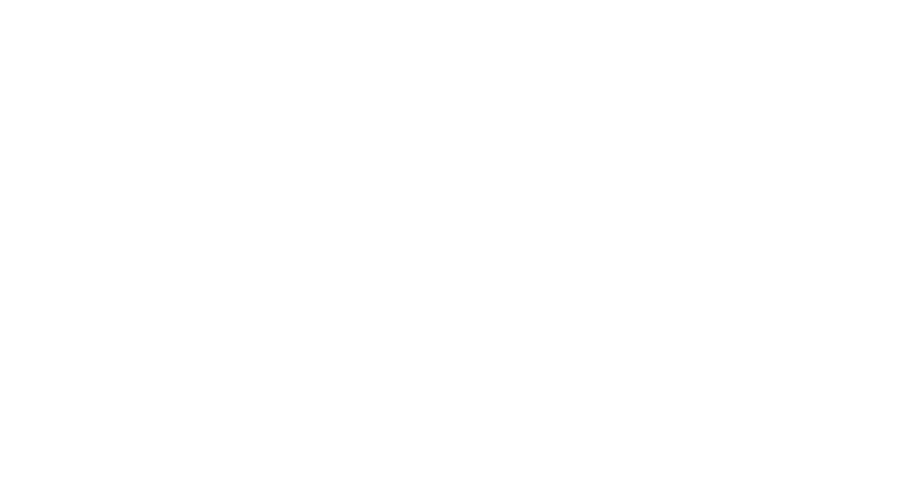

<IPython.core.display.Javascript object>


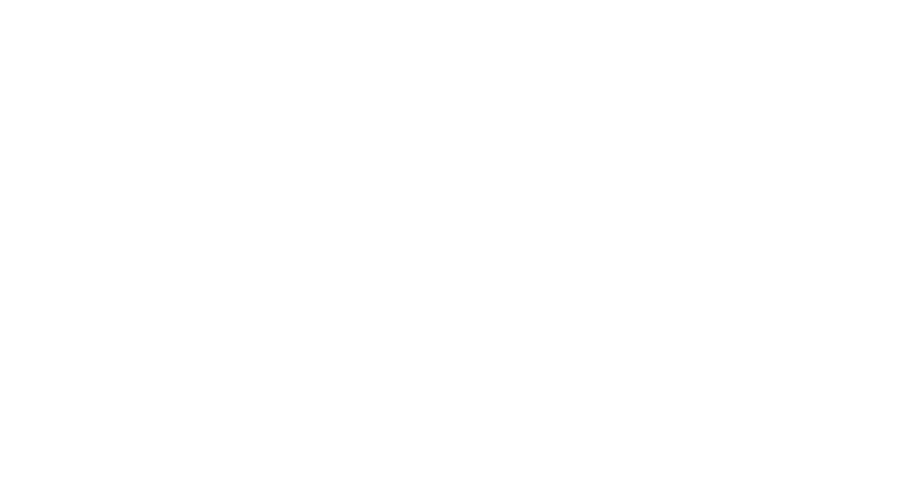

<IPython.core.display.Javascript object>


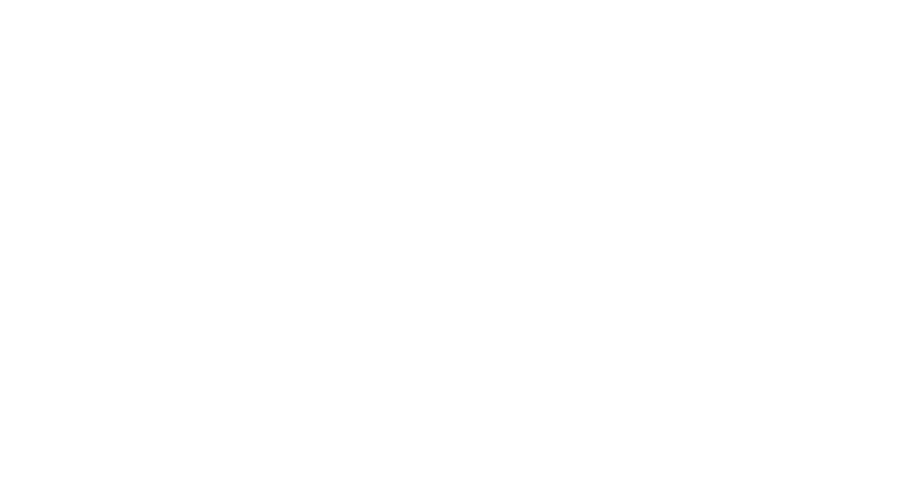

<IPython.core.display.Javascript object>


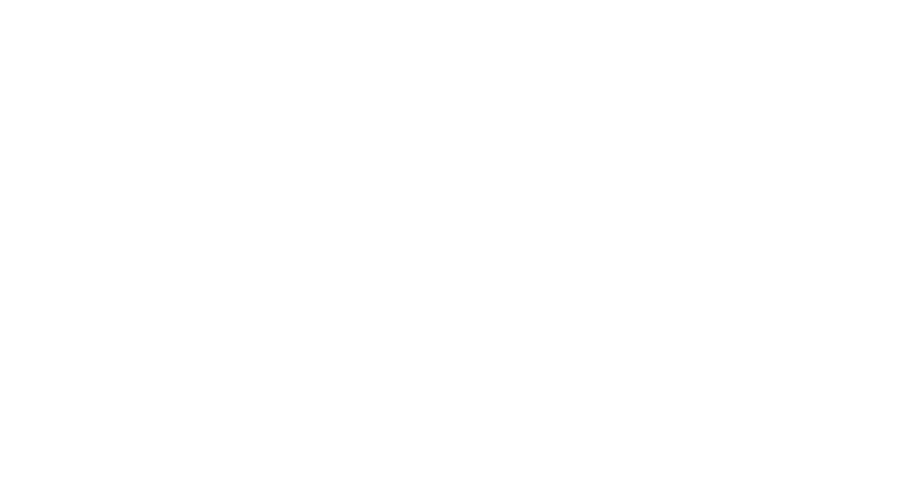

<IPython.core.display.Javascript object>


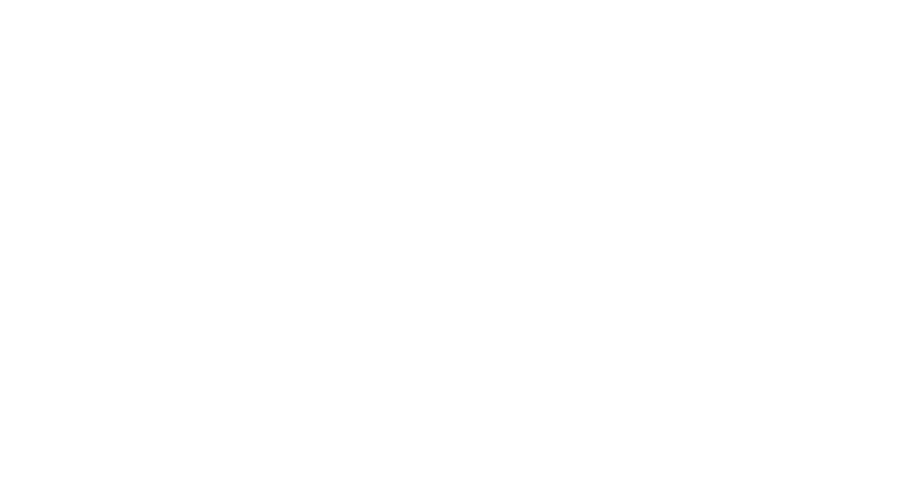

<IPython.core.display.Javascript object>


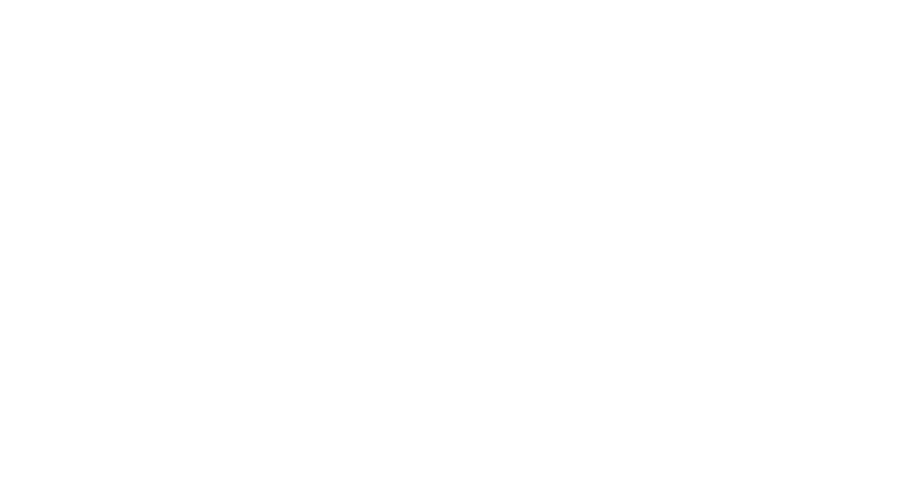

<IPython.core.display.Javascript object>


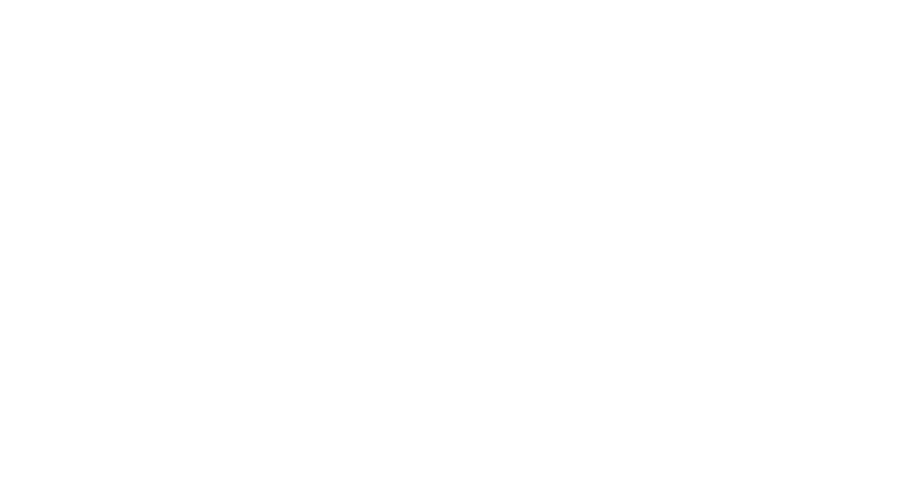

<IPython.core.display.Javascript object>


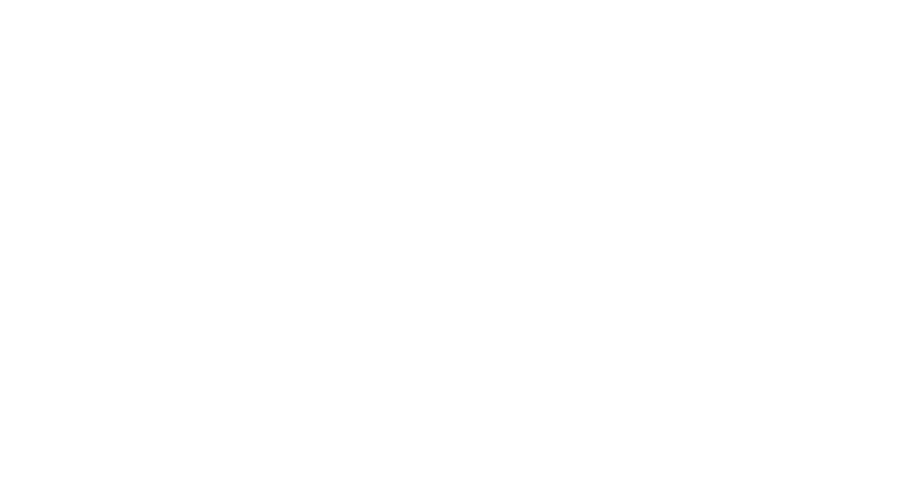

<IPython.core.display.Javascript object>


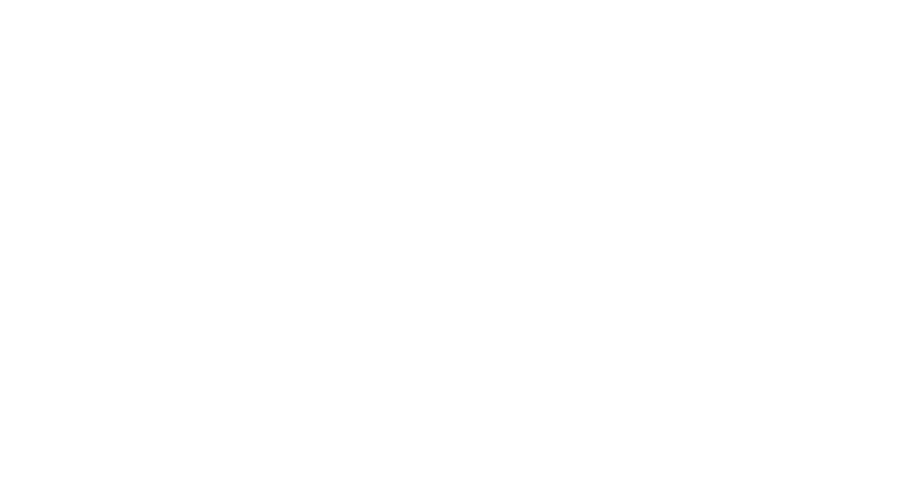

<IPython.core.display.Javascript object>


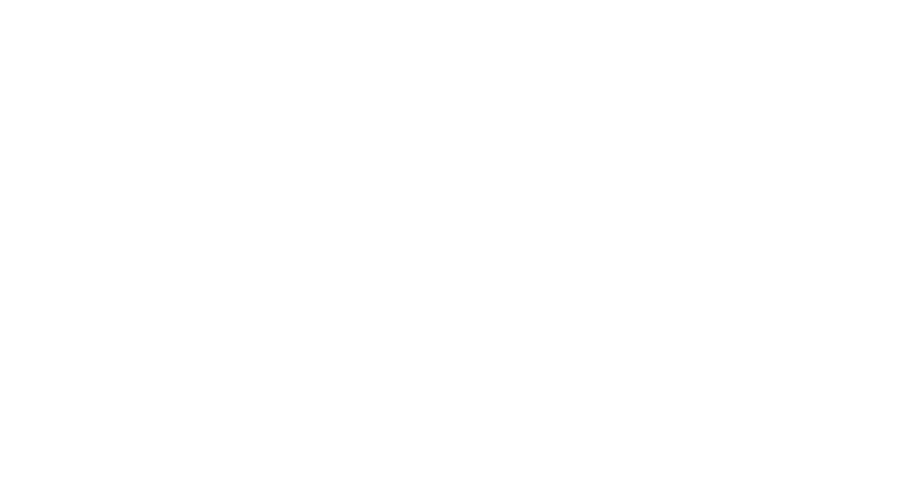

<IPython.core.display.Javascript object>


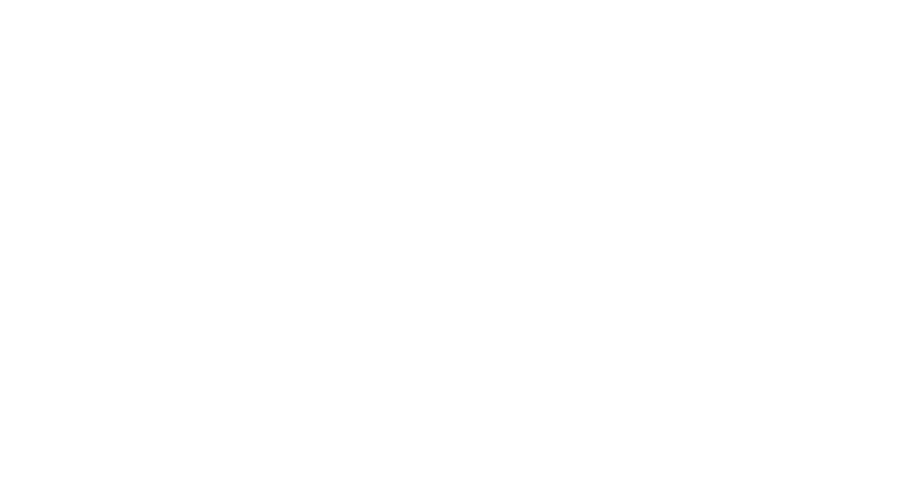

<IPython.core.display.Javascript object>


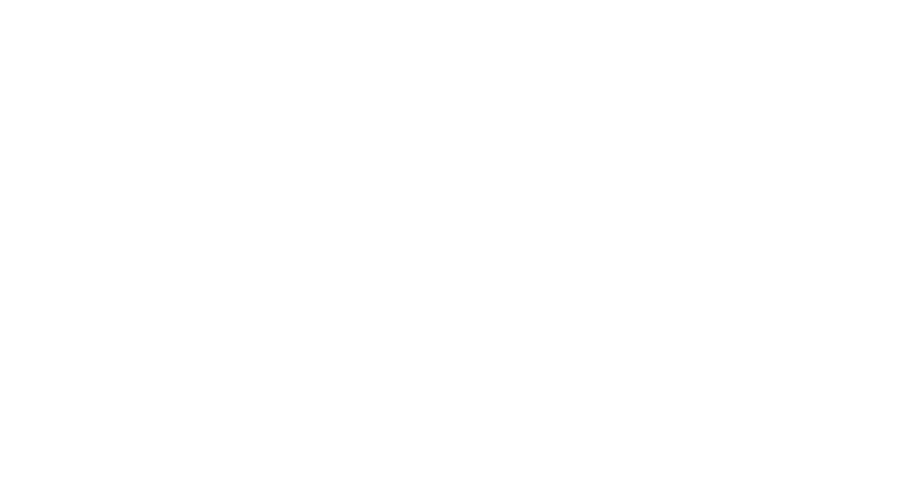

<IPython.core.display.Javascript object>


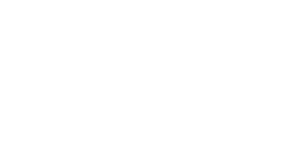

<IPython.core.display.Javascript object>


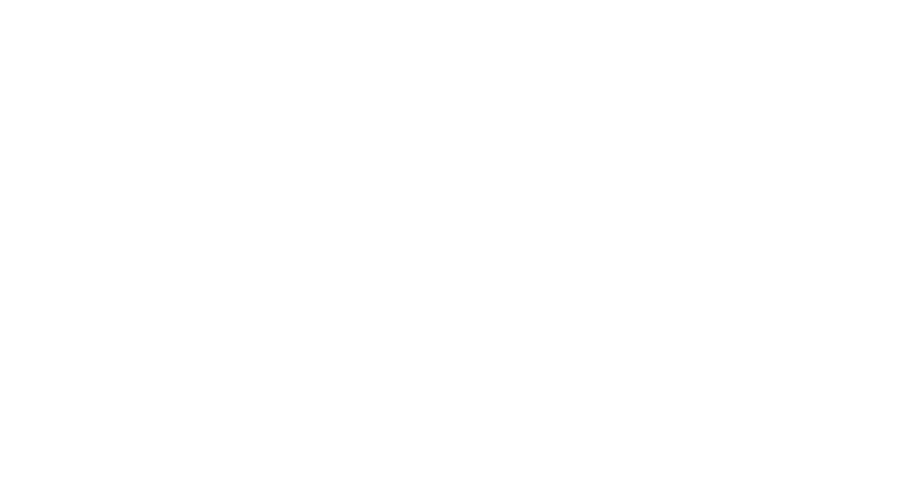

<IPython.core.display.Javascript object>


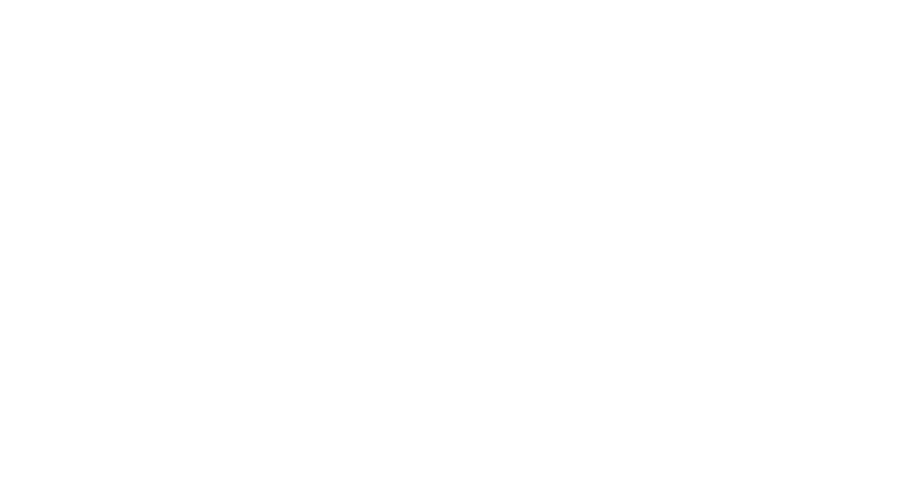

<IPython.core.display.Javascript object>


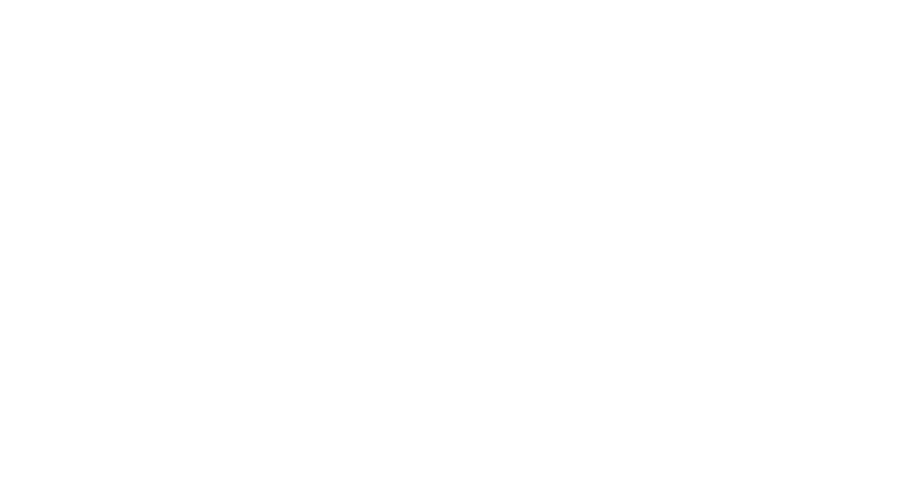

<IPython.core.display.Javascript object>


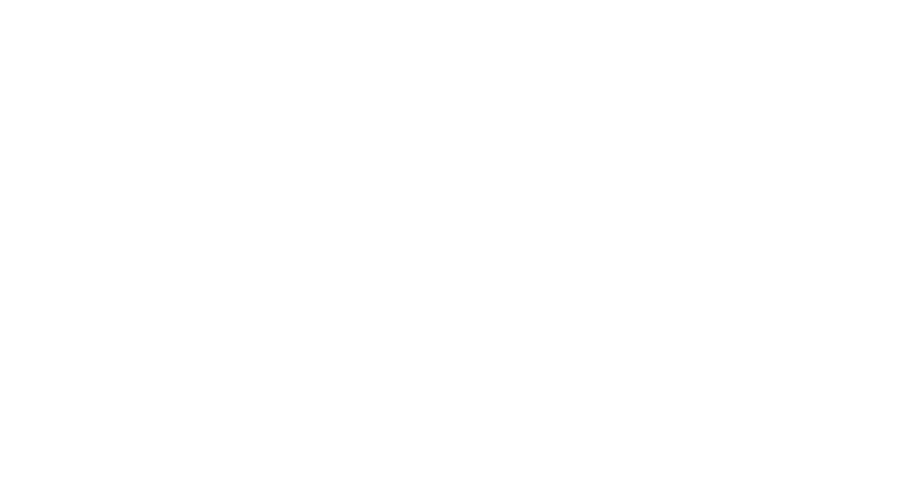

<IPython.core.display.Javascript object>


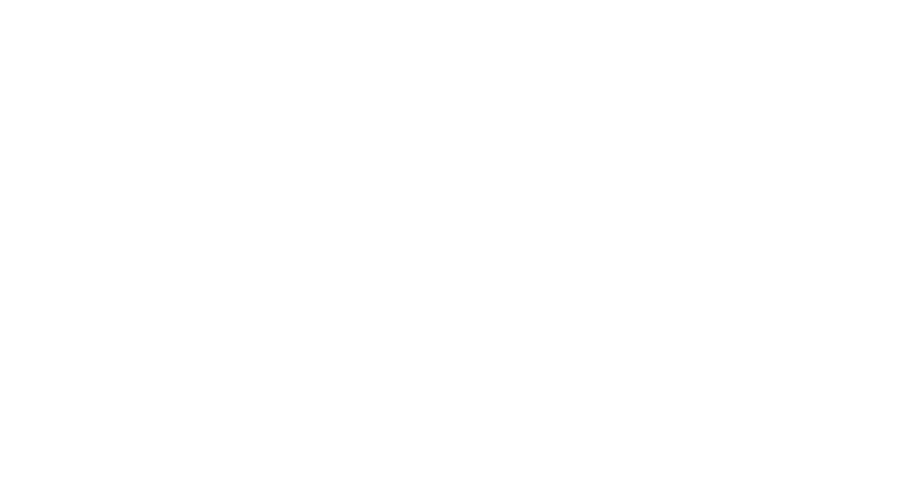

<IPython.core.display.Javascript object>


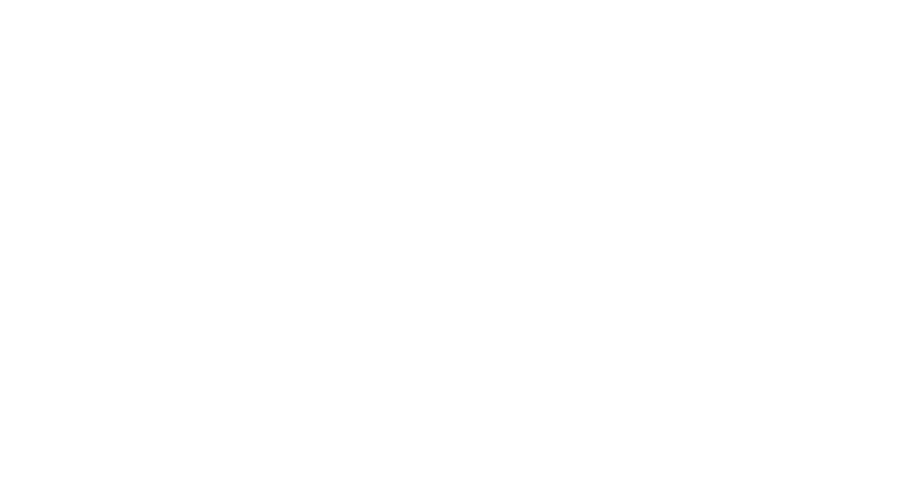

<IPython.core.display.Javascript object>


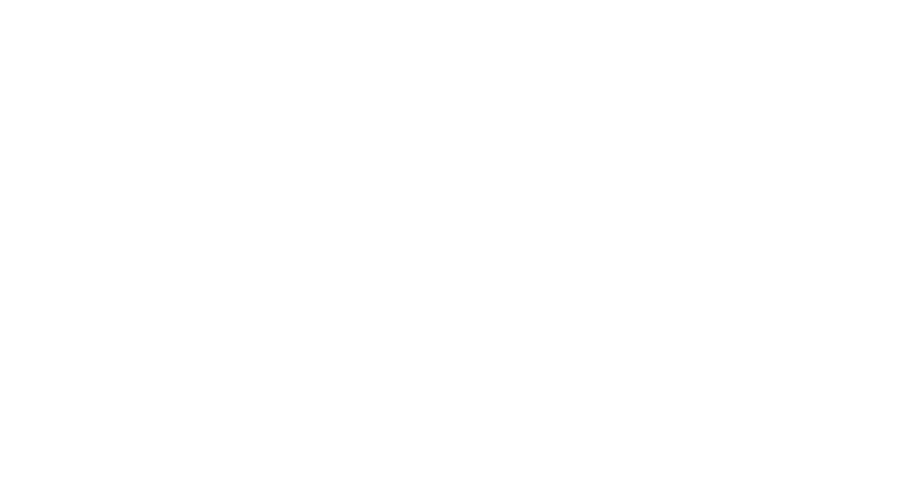

<IPython.core.display.Javascript object>


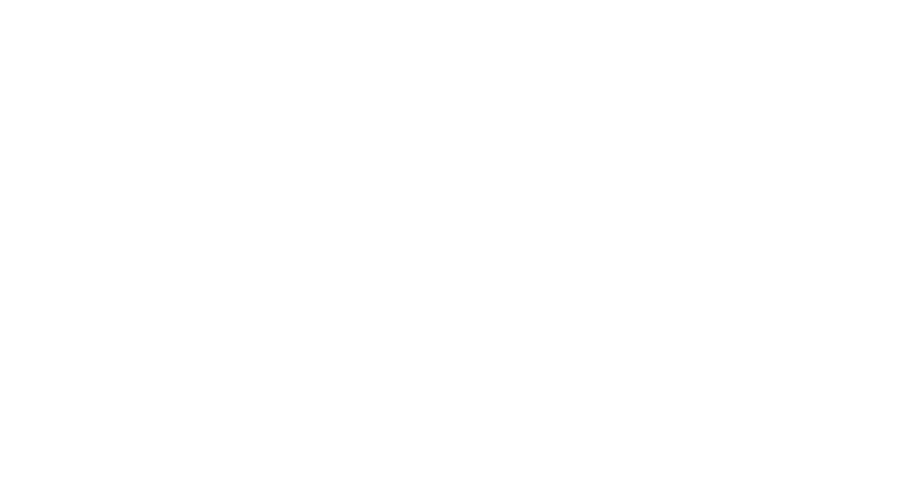

<IPython.core.display.Javascript object>


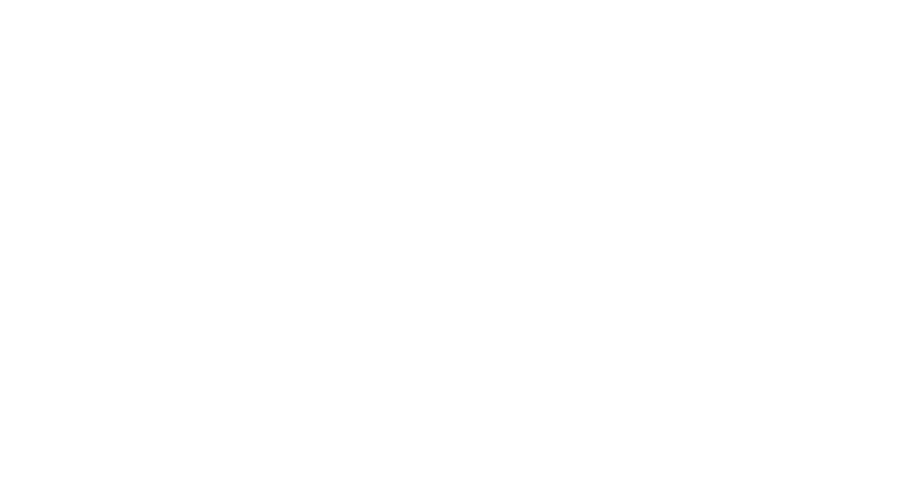

<IPython.core.display.Javascript object>


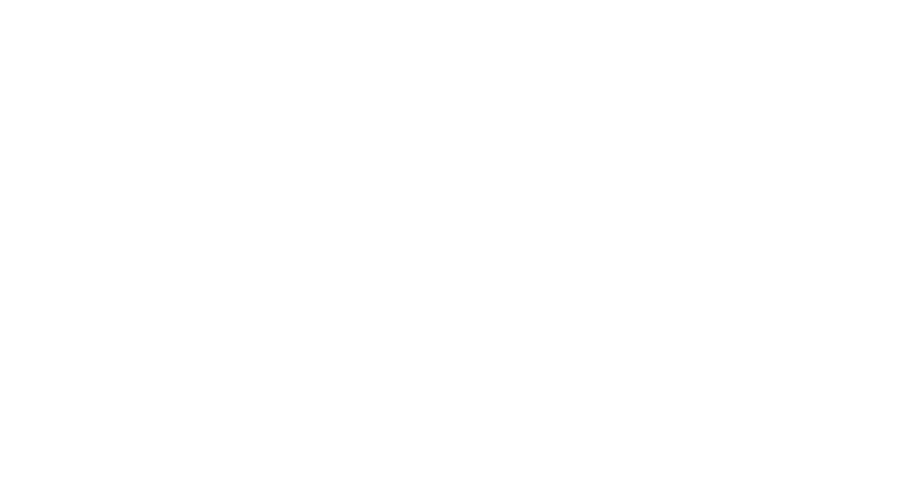

<IPython.core.display.Javascript object>


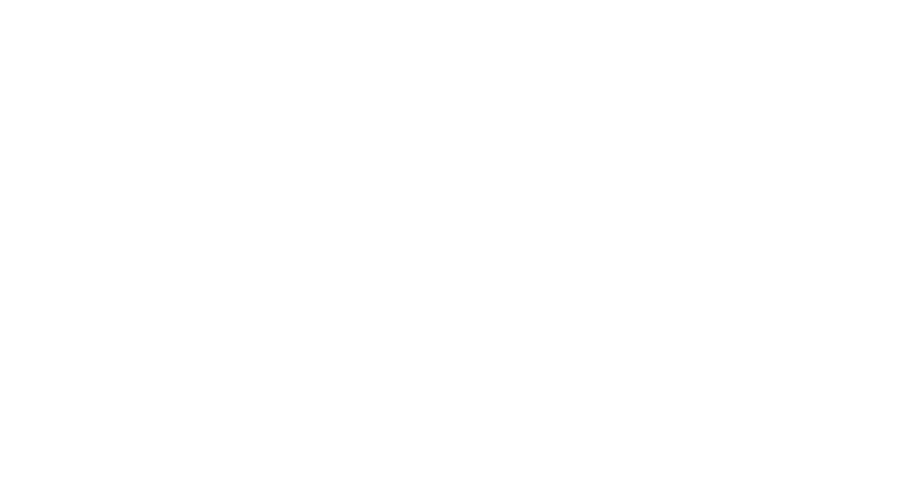

<IPython.core.display.Javascript object>


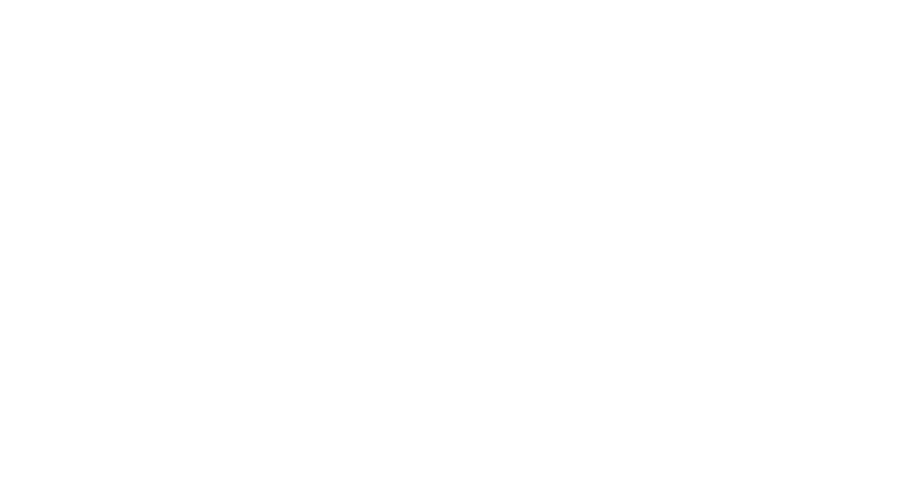

<IPython.core.display.Javascript object>


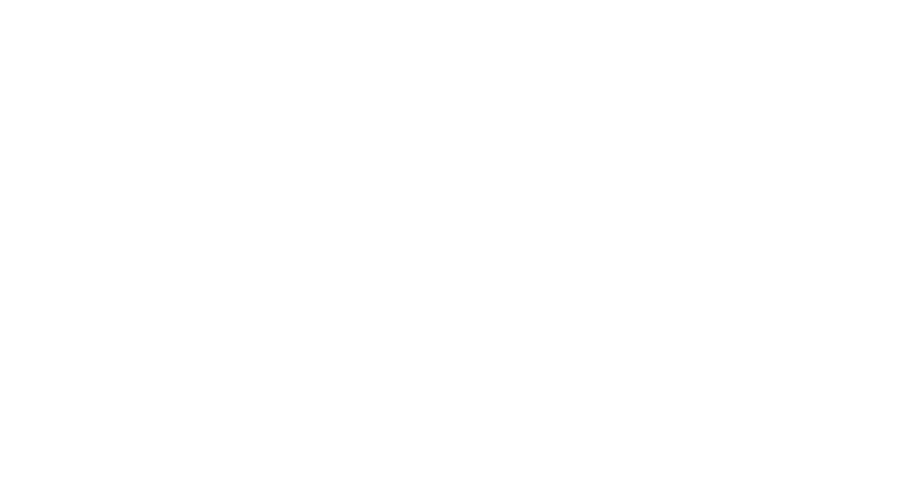

<IPython.core.display.Javascript object>


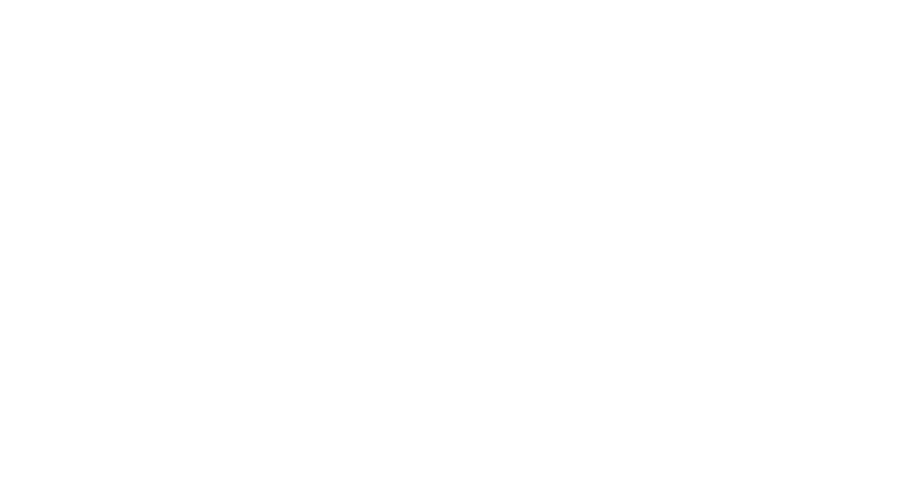

<IPython.core.display.Javascript object>


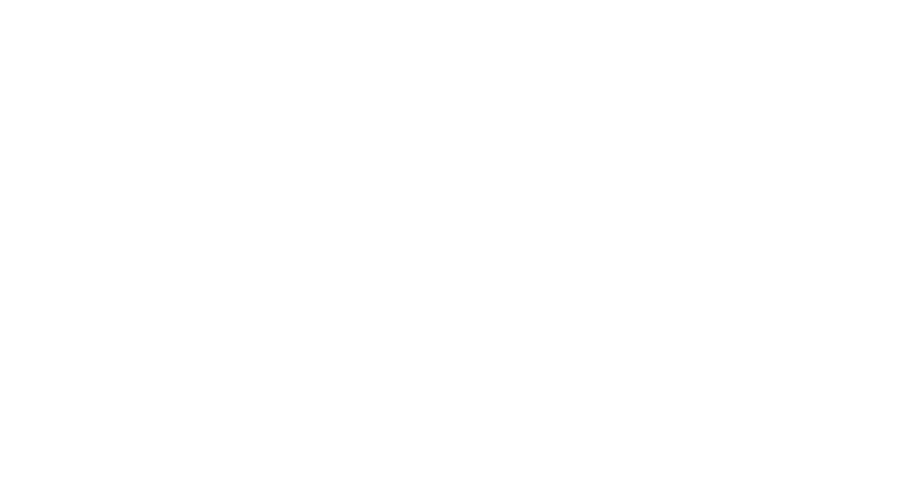

<IPython.core.display.Javascript object>


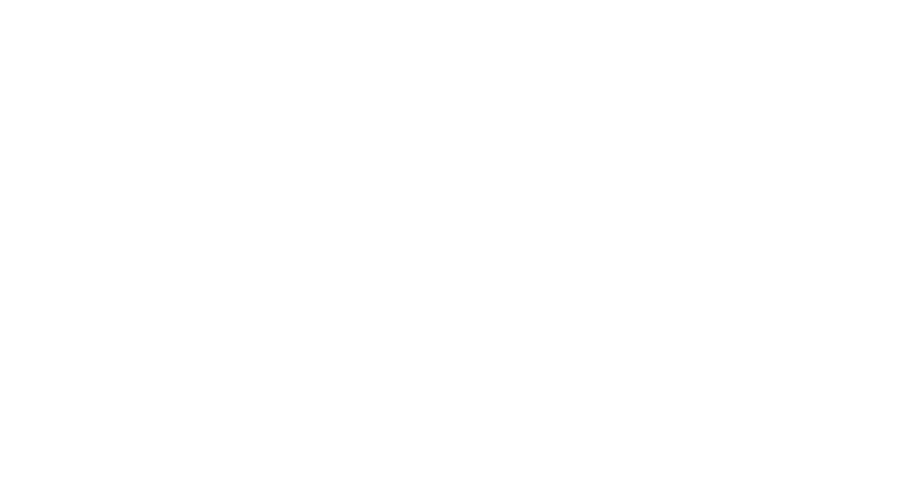

<IPython.core.display.Javascript object>


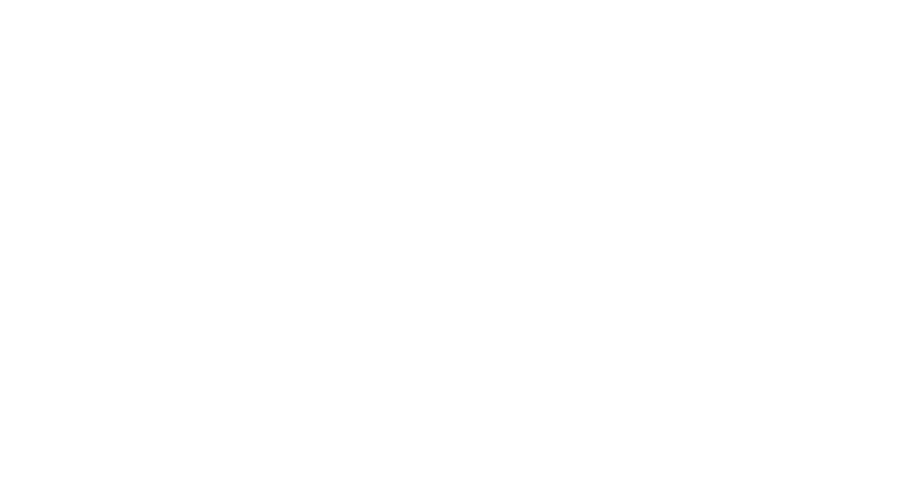

<IPython.core.display.Javascript object>


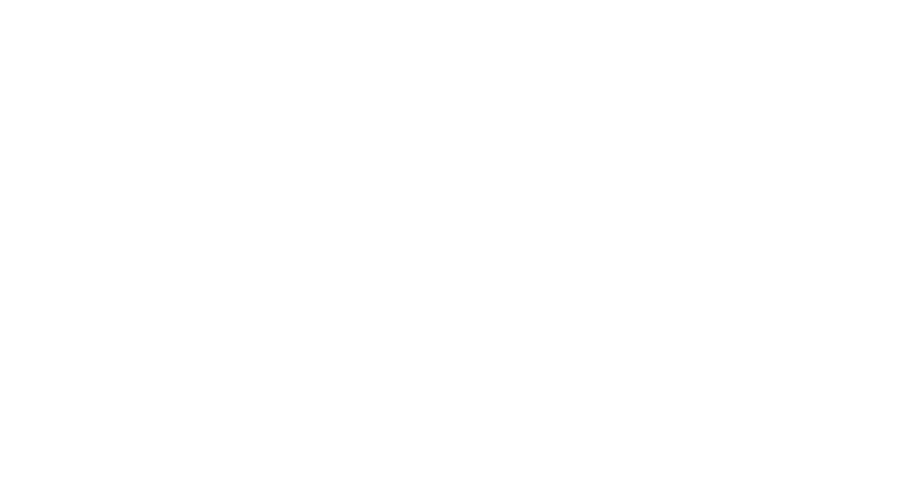

<IPython.core.display.Javascript object>


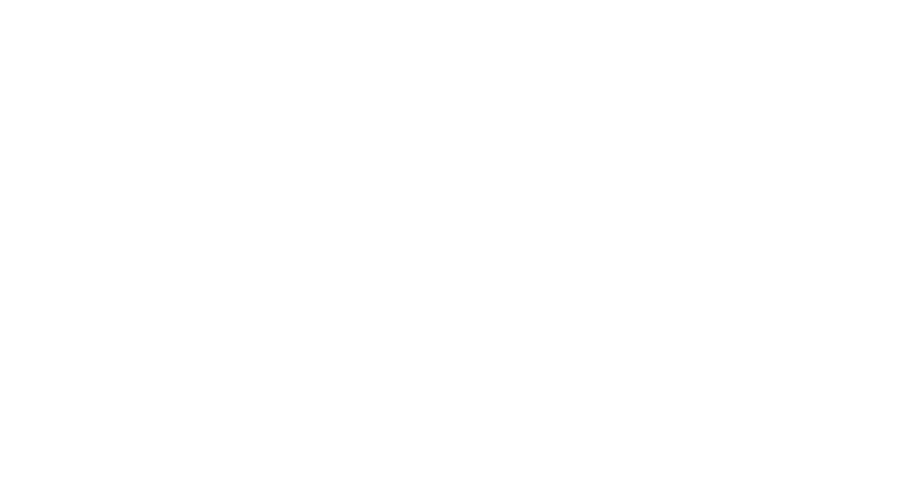

<IPython.core.display.Javascript object>


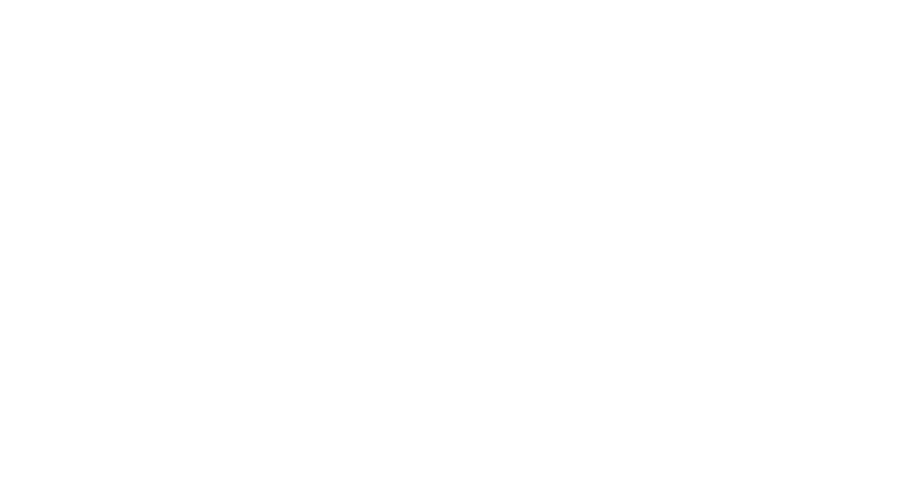

<IPython.core.display.Javascript object>


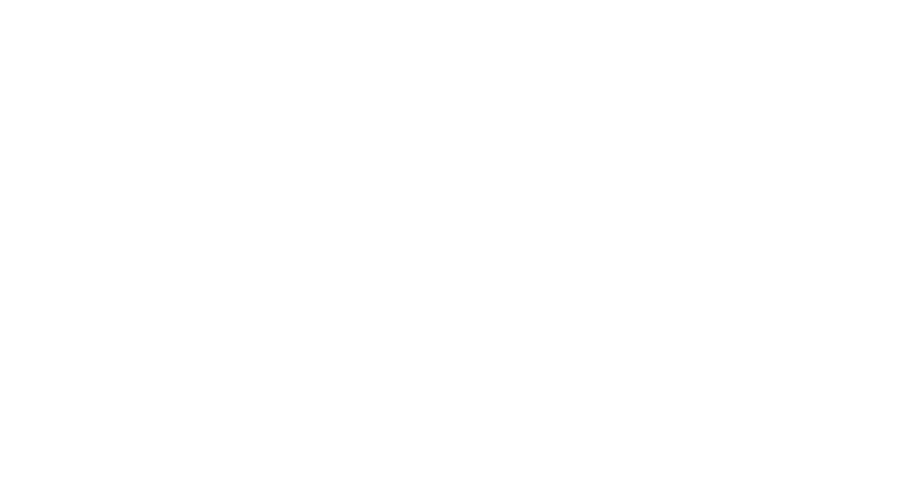

<IPython.core.display.Javascript object>


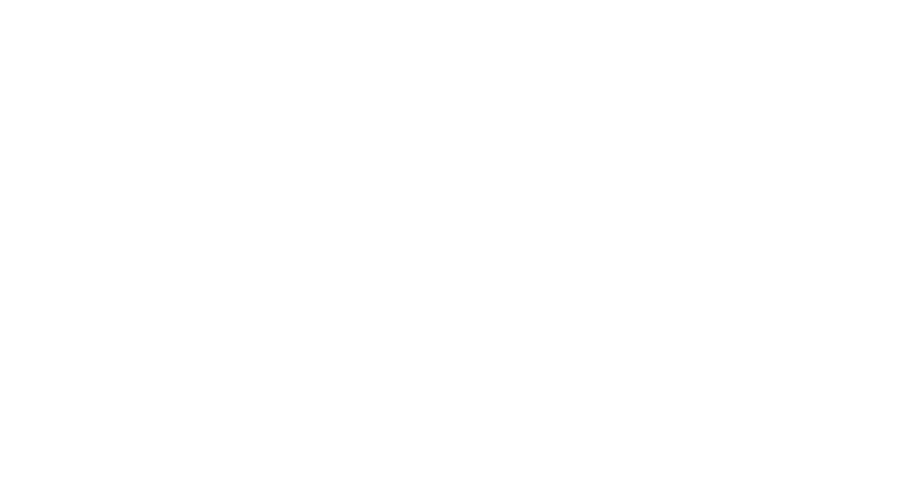

<IPython.core.display.Javascript object>


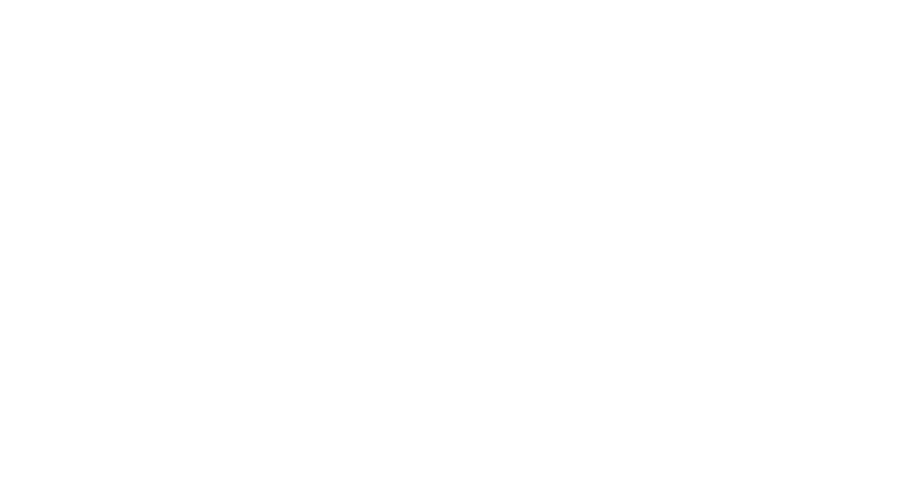

<IPython.core.display.Javascript object>


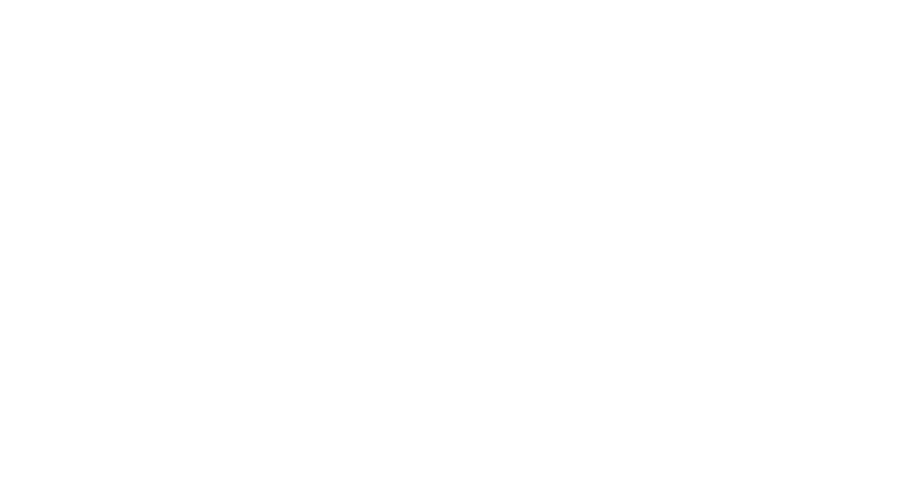

<IPython.core.display.Javascript object>


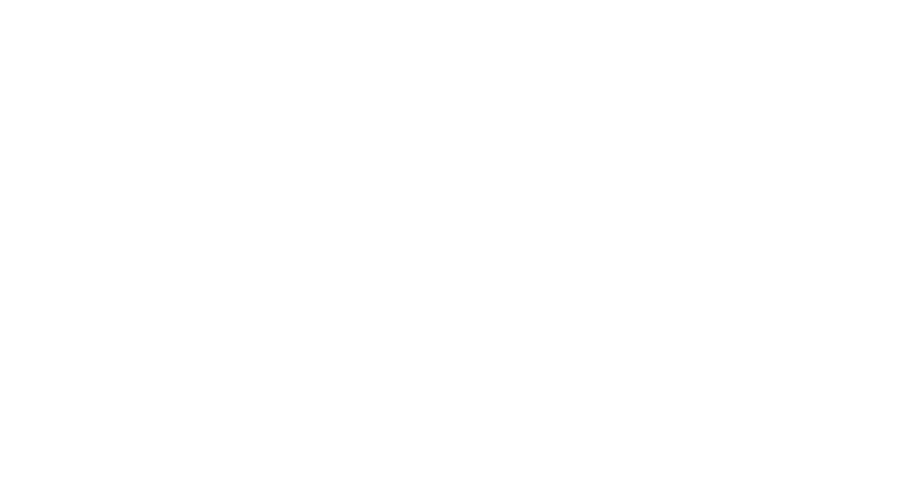

<IPython.core.display.Javascript object>


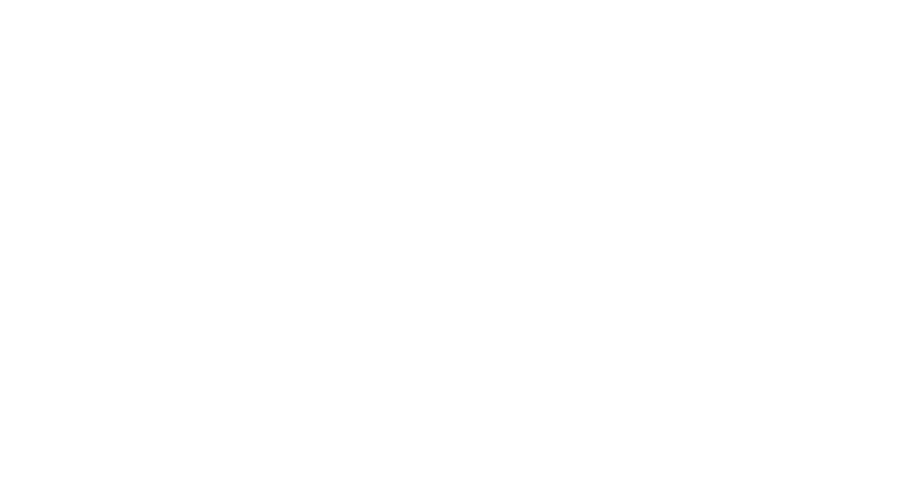

<IPython.core.display.Javascript object>


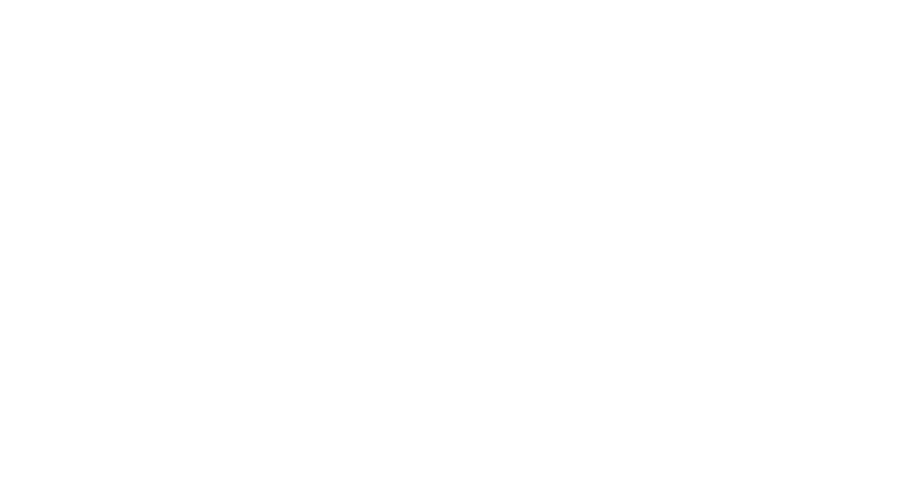

<IPython.core.display.Javascript object>


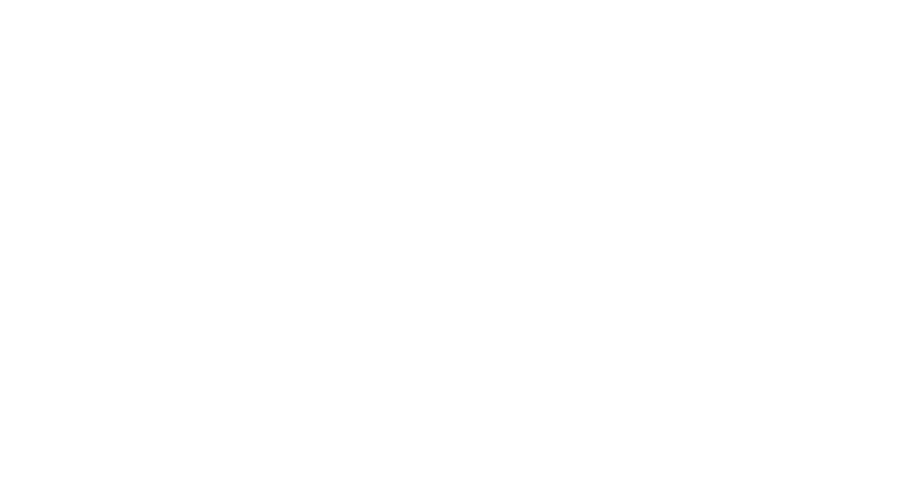

<IPython.core.display.Javascript object>


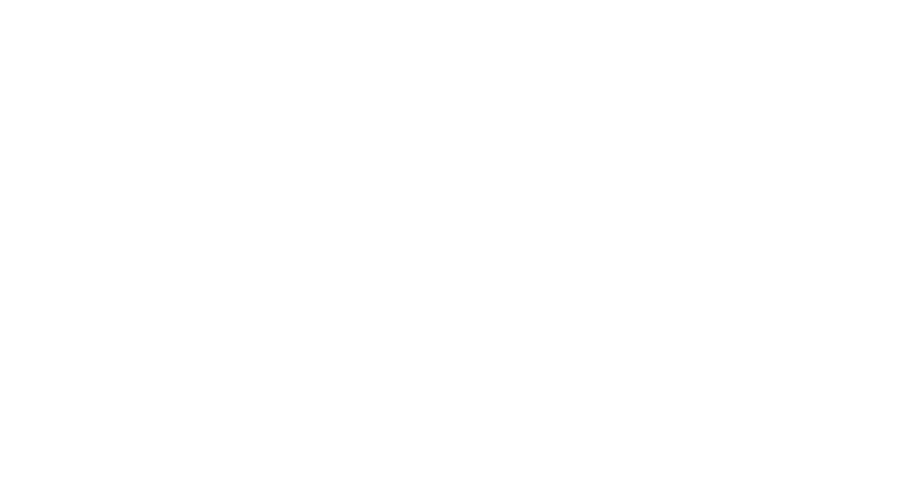

<IPython.core.display.Javascript object>


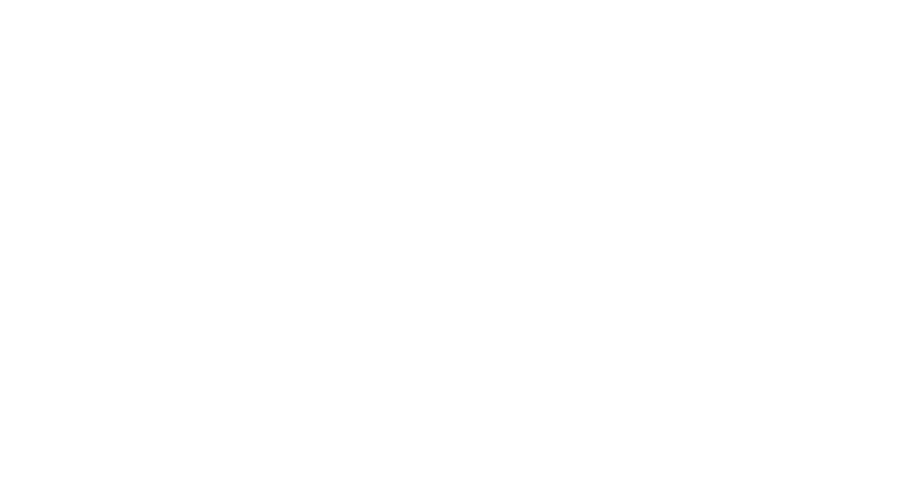

<IPython.core.display.Javascript object>


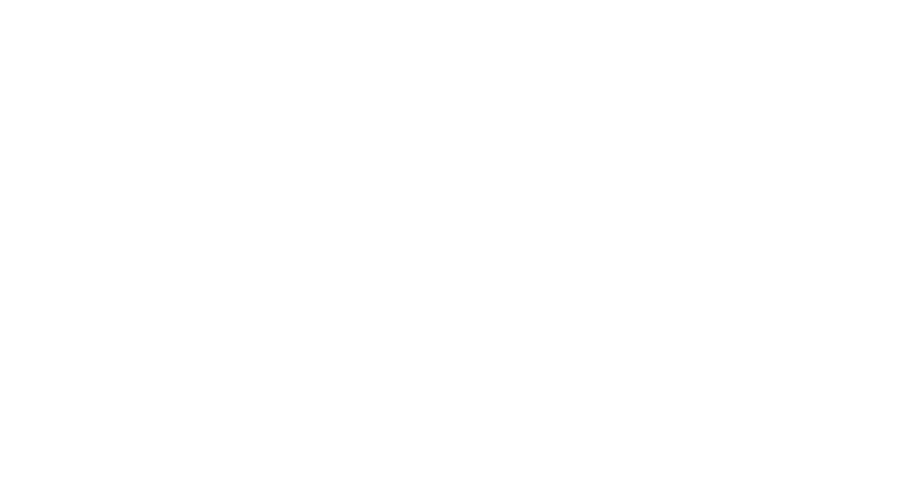

<IPython.core.display.Javascript object>


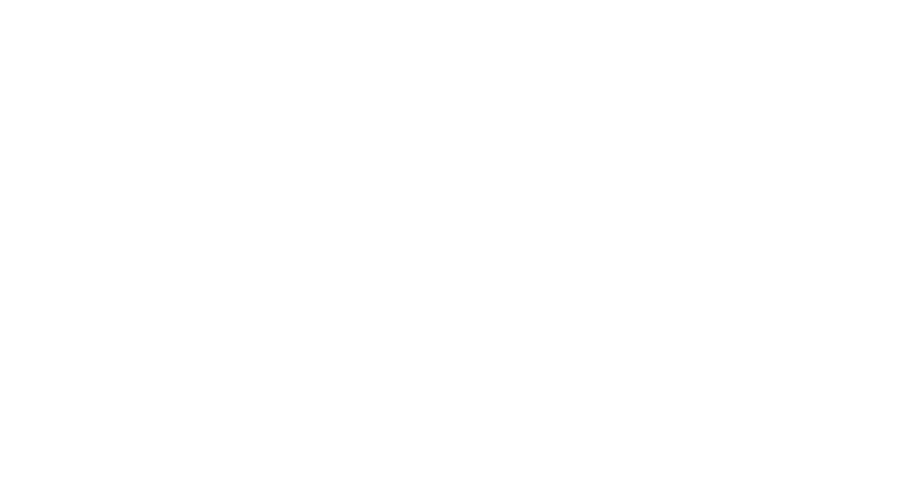

<IPython.core.display.Javascript object>


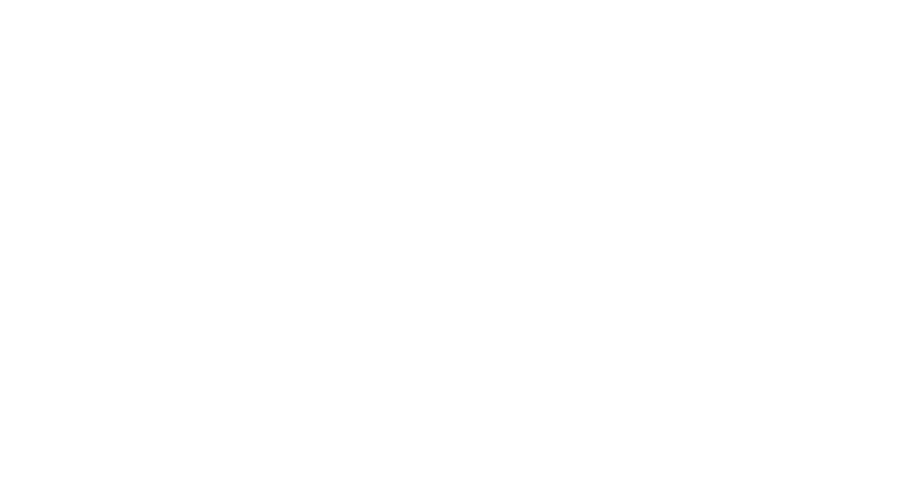

<IPython.core.display.Javascript object>


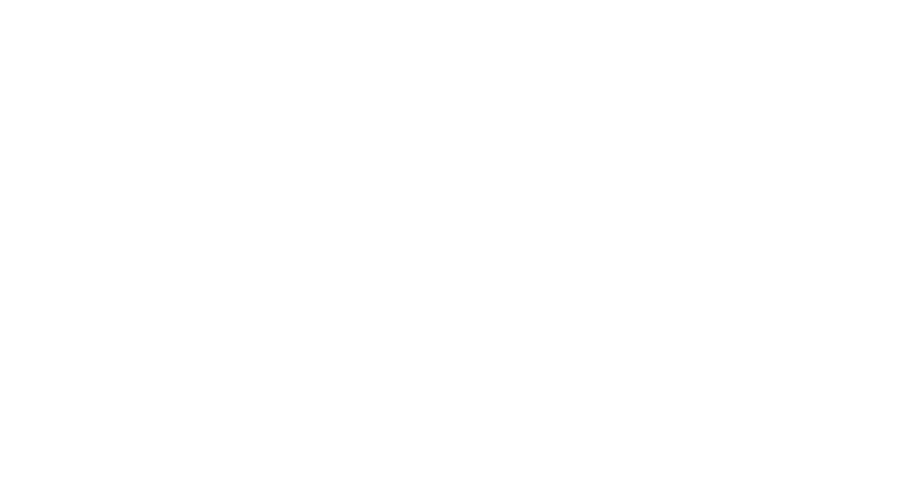

<IPython.core.display.Javascript object>


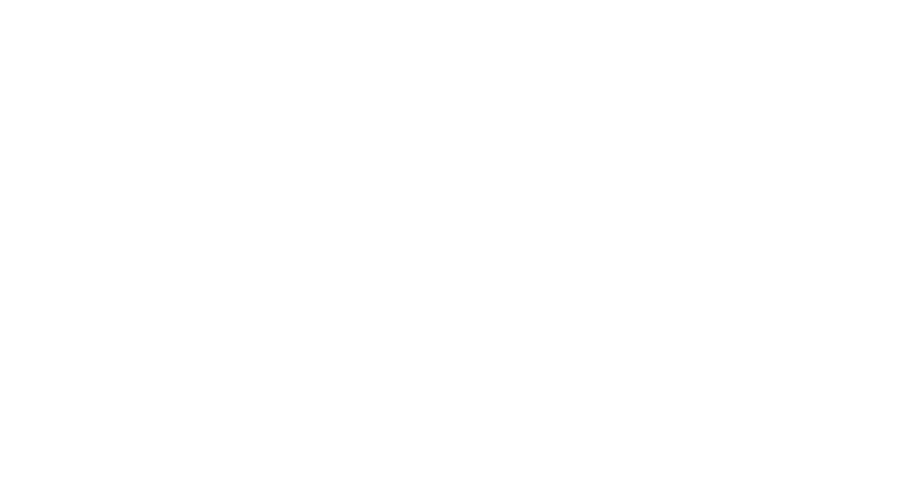

<IPython.core.display.Javascript object>


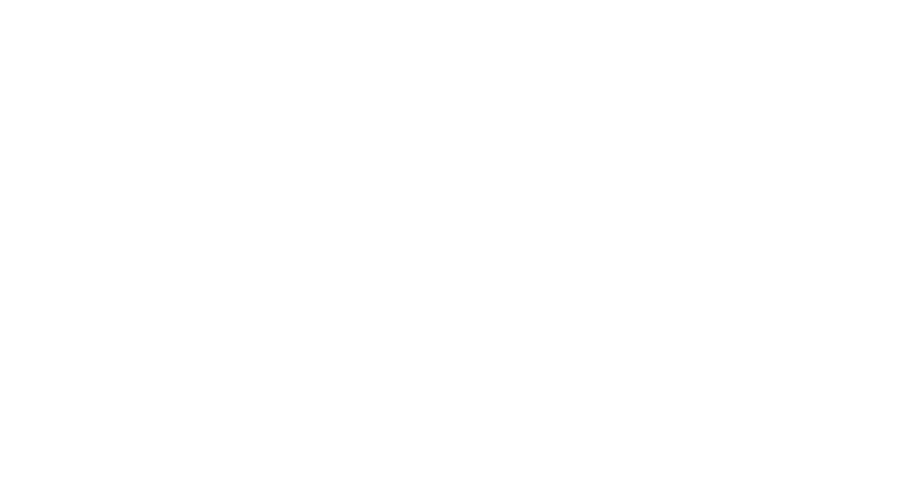

<IPython.core.display.Javascript object>


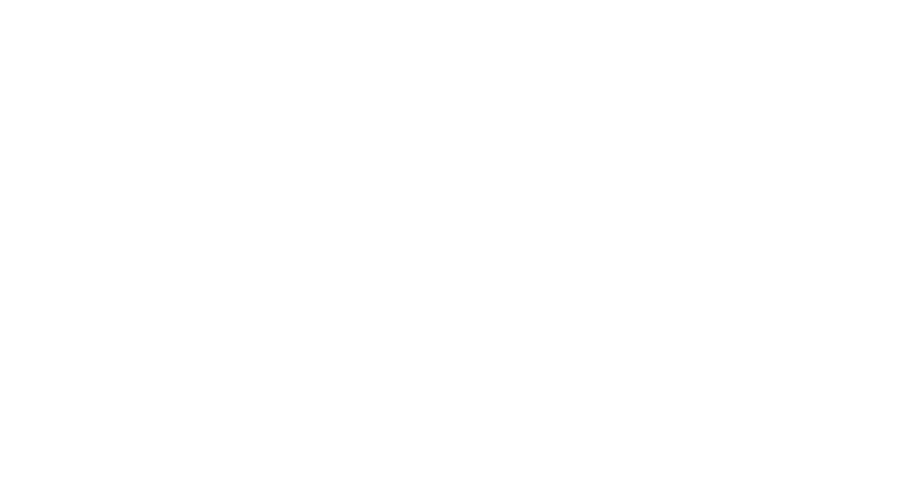

<IPython.core.display.Javascript object>


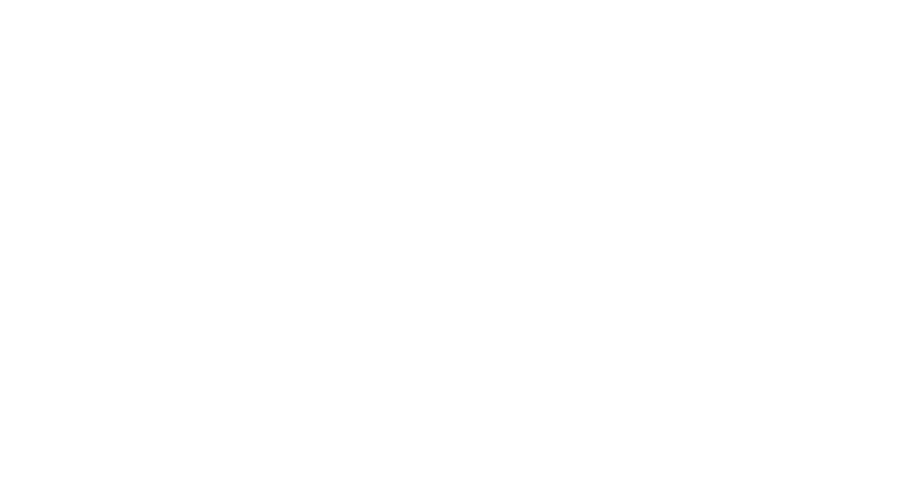

<IPython.core.display.Javascript object>


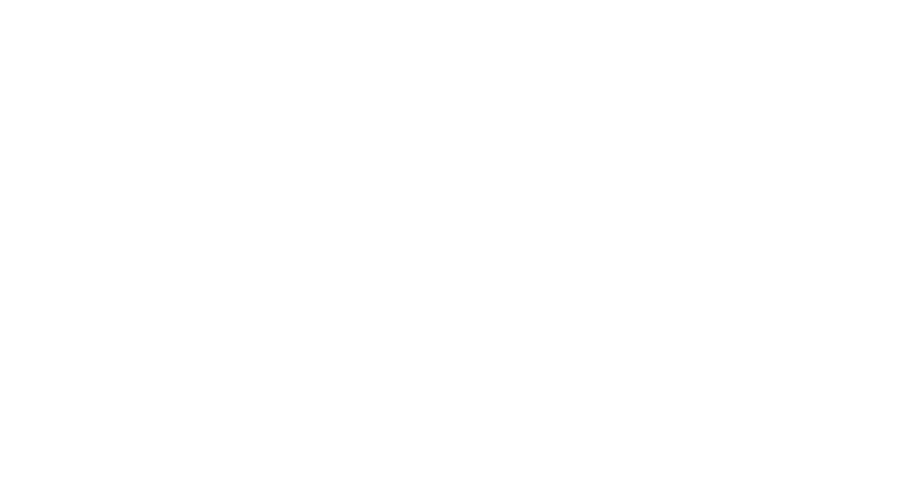

<IPython.core.display.Javascript object>


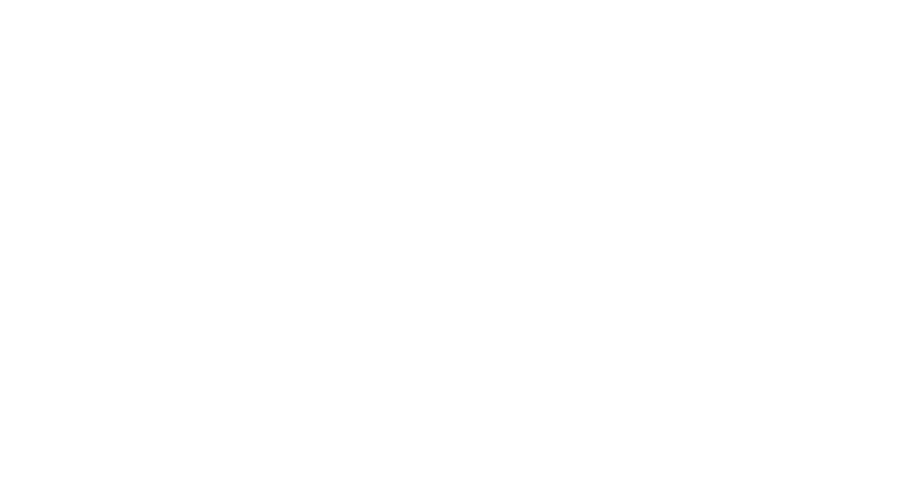

<IPython.core.display.Javascript object>


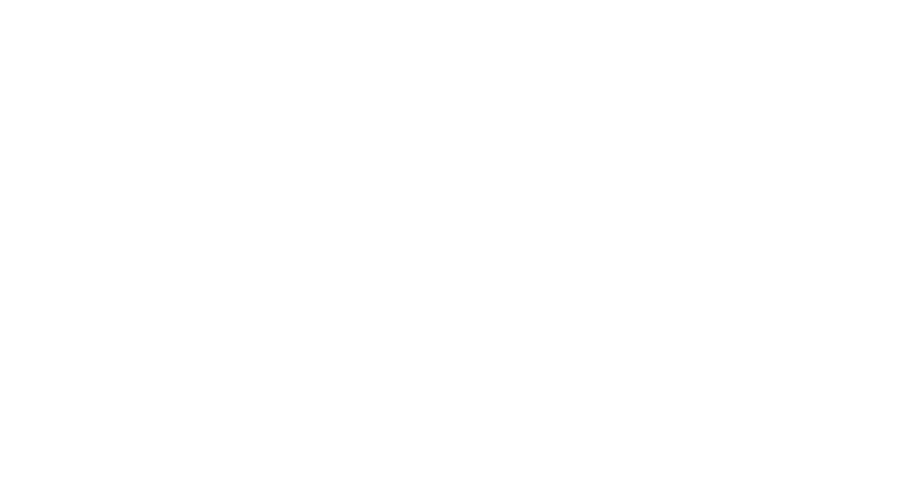

<IPython.core.display.Javascript object>


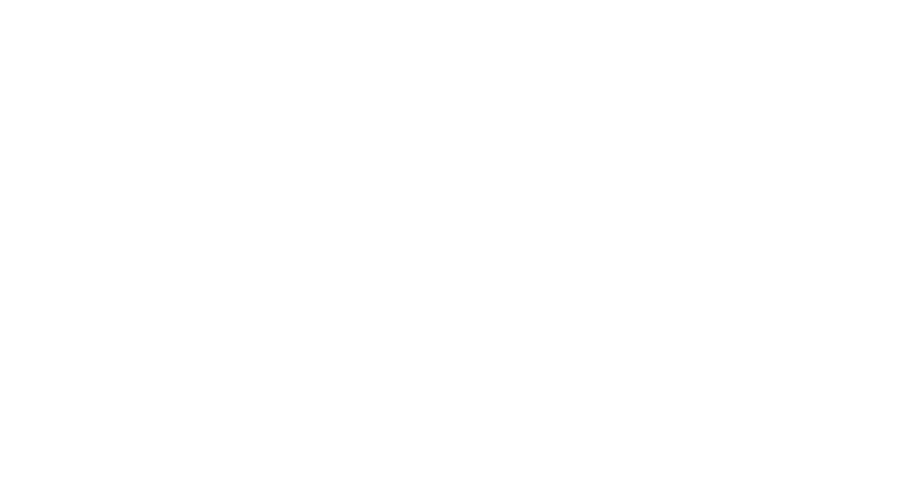

<IPython.core.display.Javascript object>


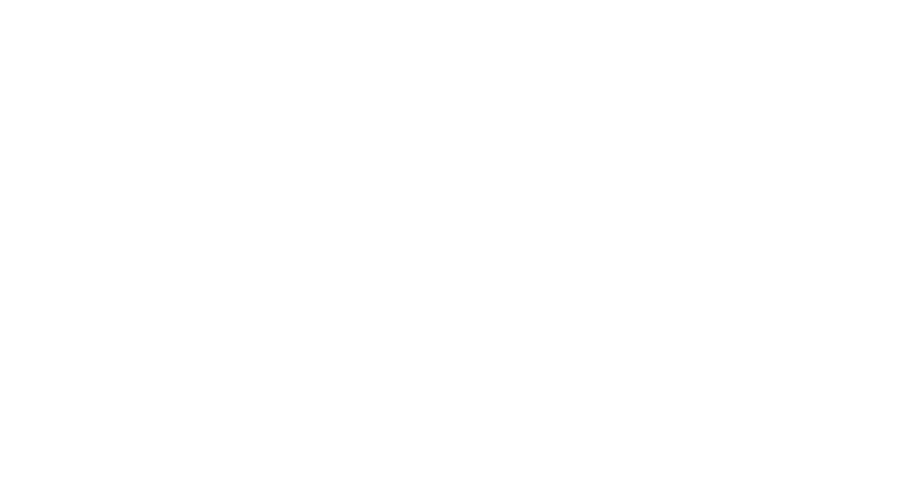

<IPython.core.display.Javascript object>


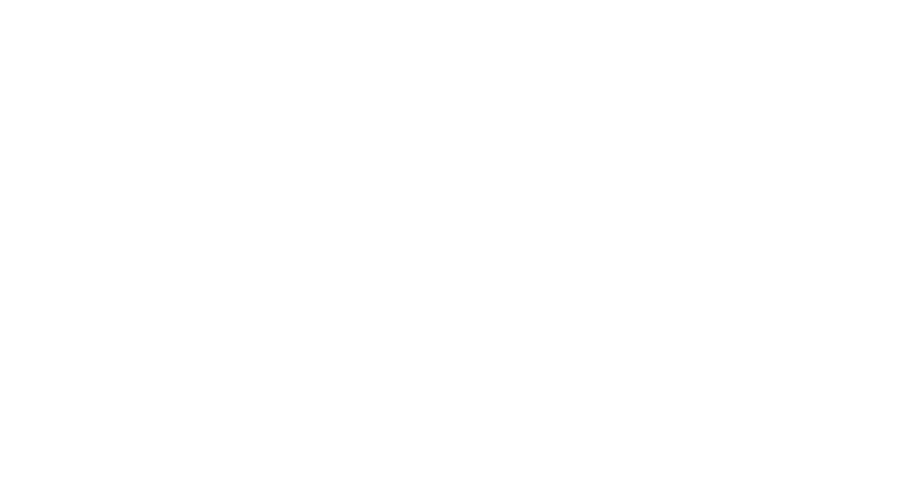

<IPython.core.display.Javascript object>


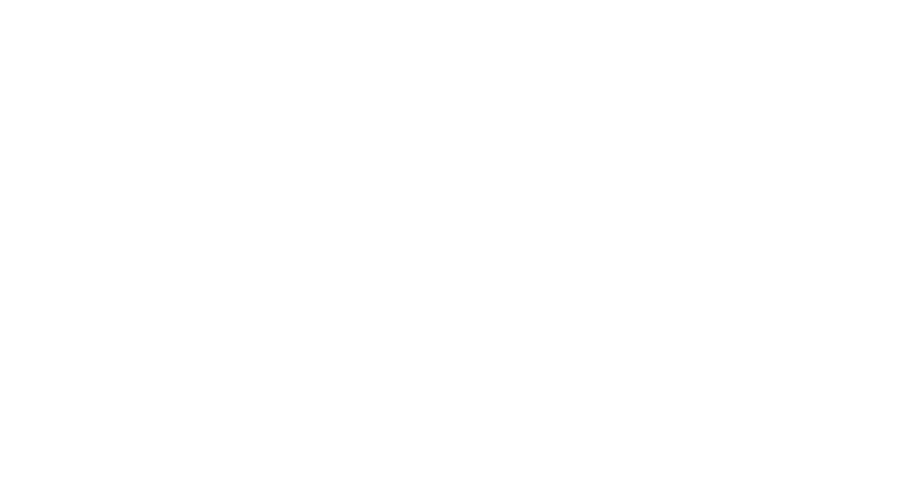

<IPython.core.display.Javascript object>


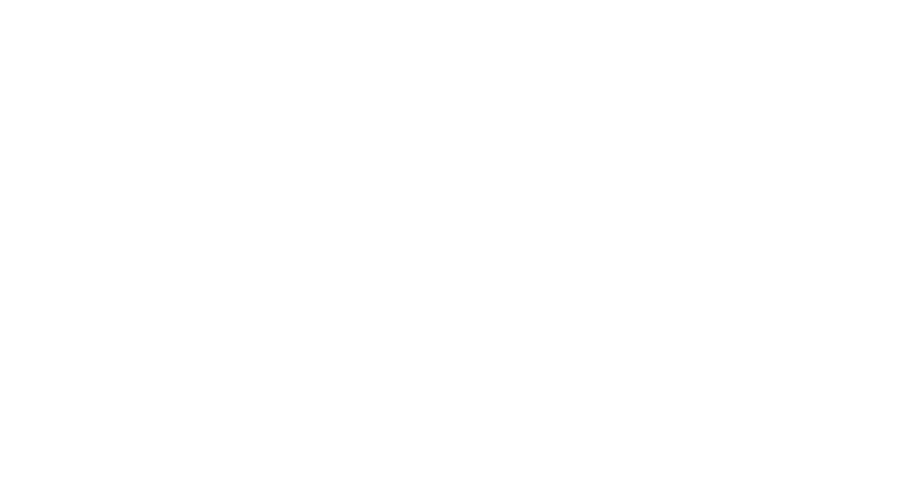

<IPython.core.display.Javascript object>


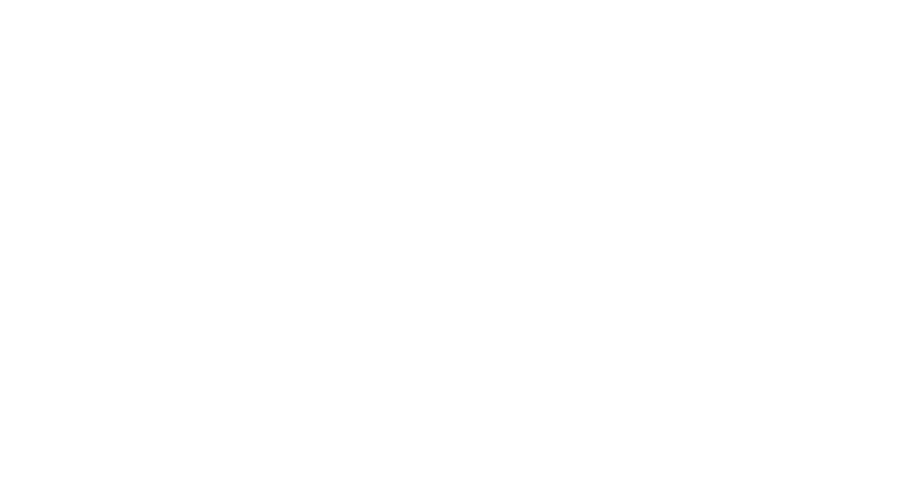

<IPython.core.display.Javascript object>


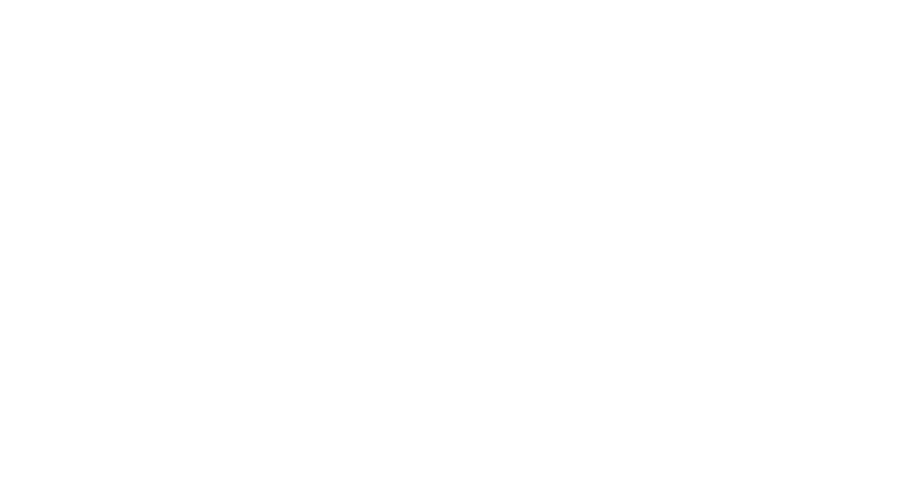

<IPython.core.display.Javascript object>


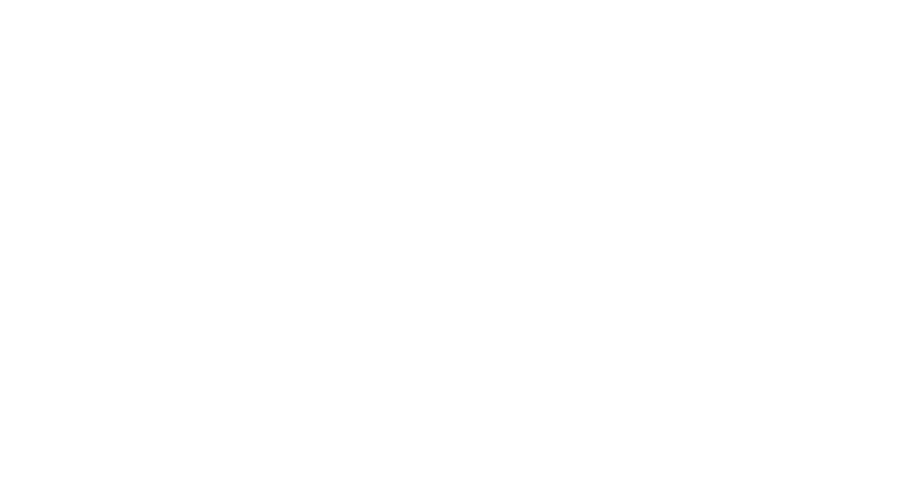

<IPython.core.display.Javascript object>


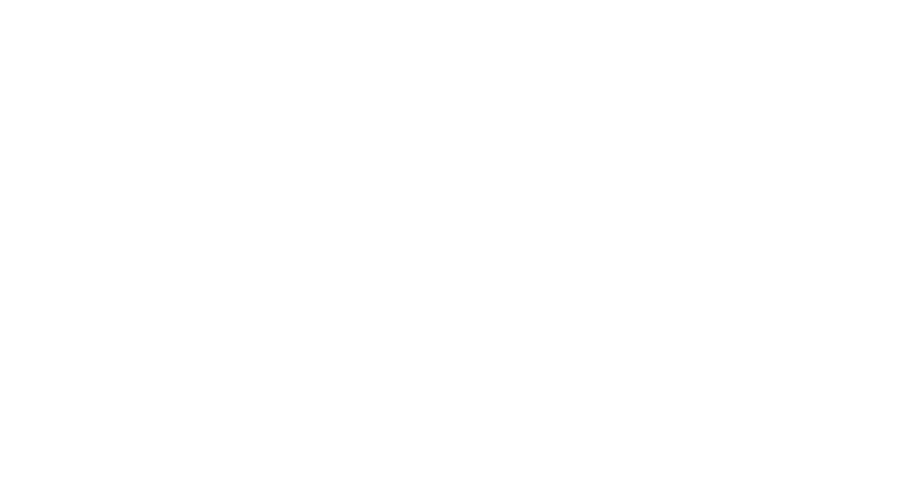

<IPython.core.display.Javascript object>


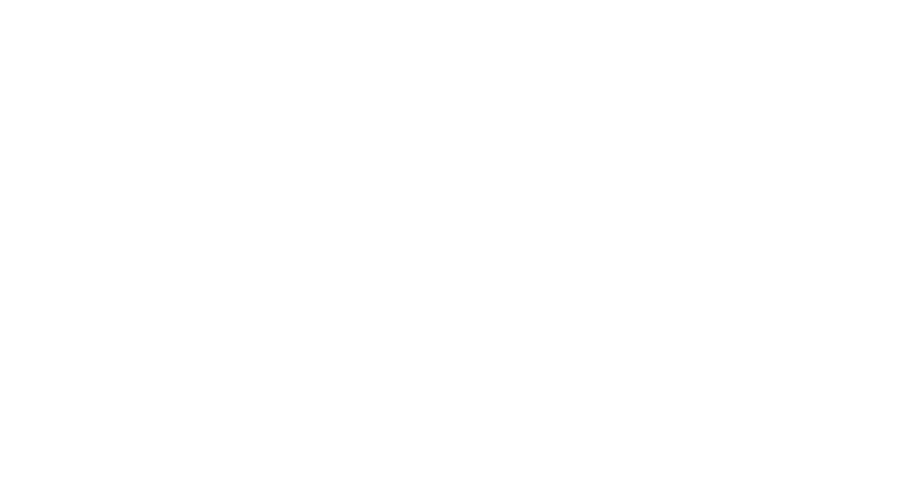

<IPython.core.display.Javascript object>


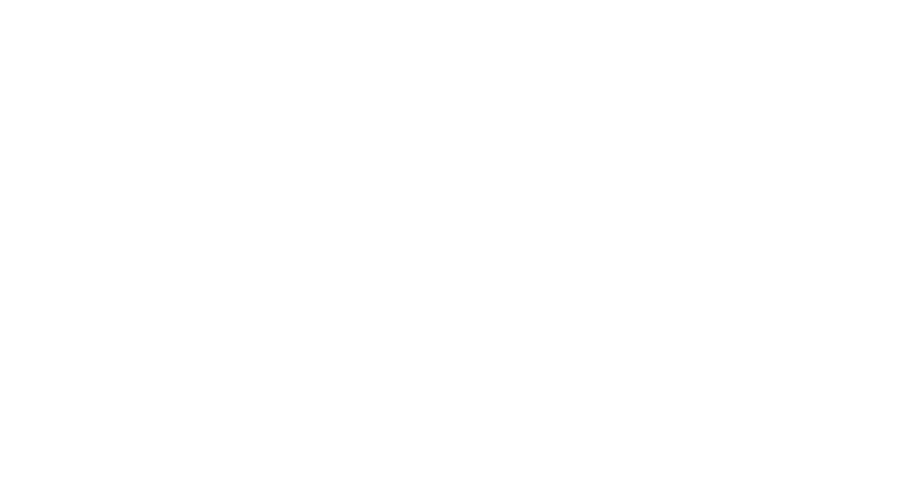

<IPython.core.display.Javascript object>


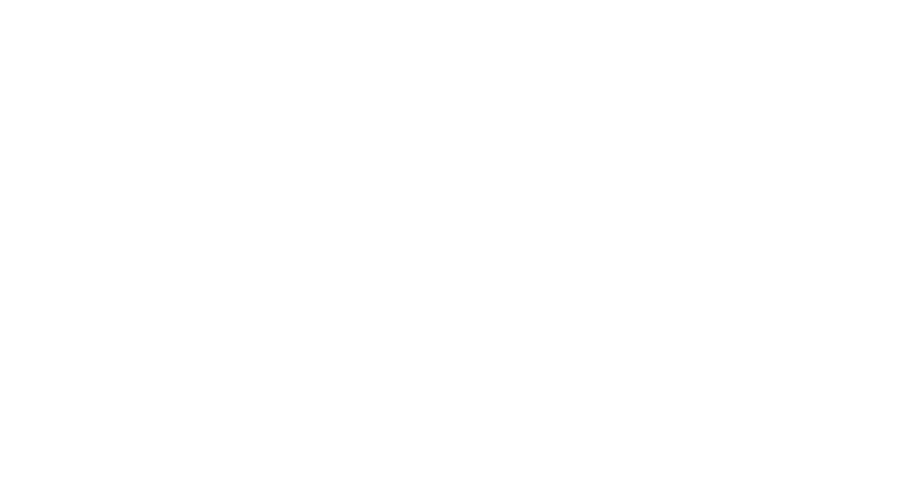

<IPython.core.display.Javascript object>


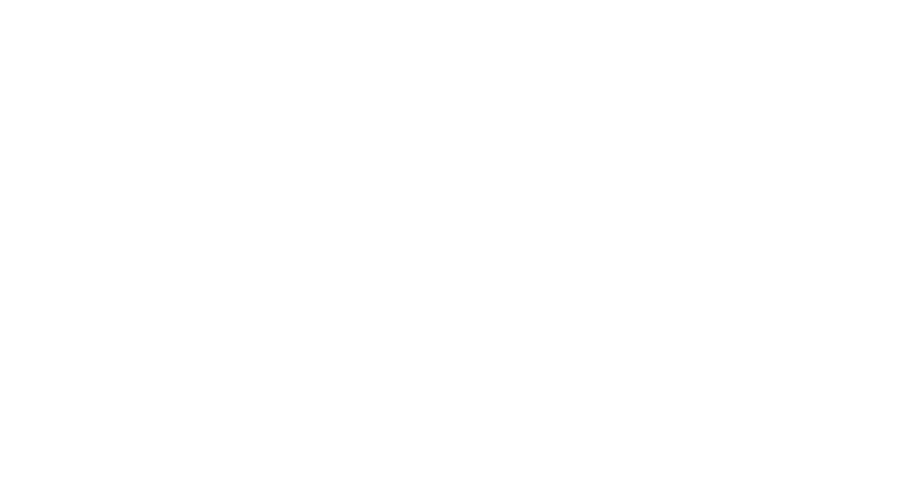

<IPython.core.display.Javascript object>


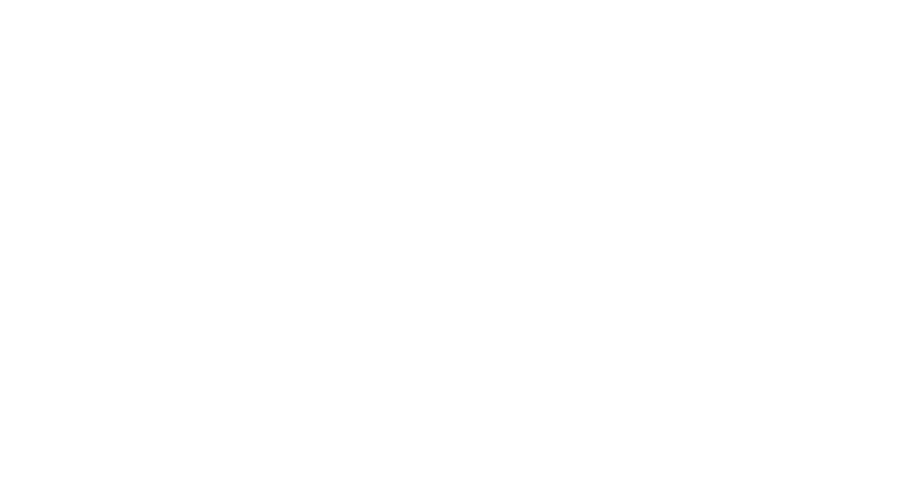

<IPython.core.display.Javascript object>


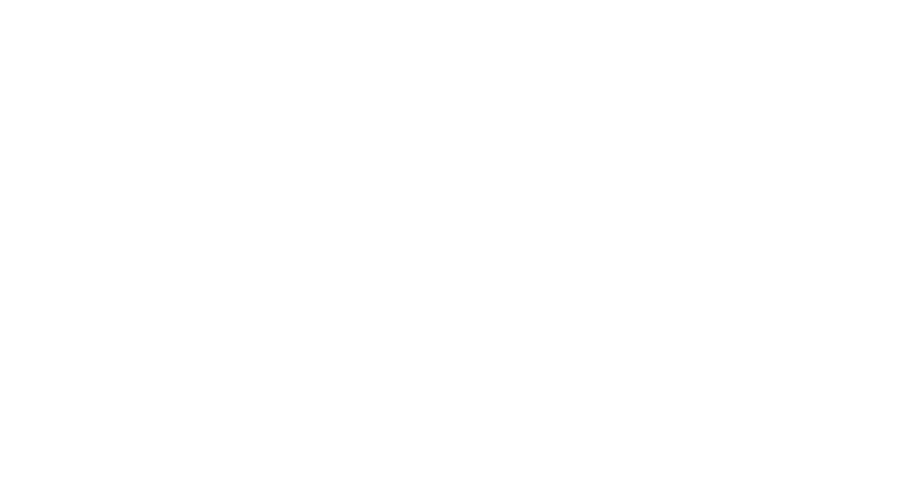

<IPython.core.display.Javascript object>


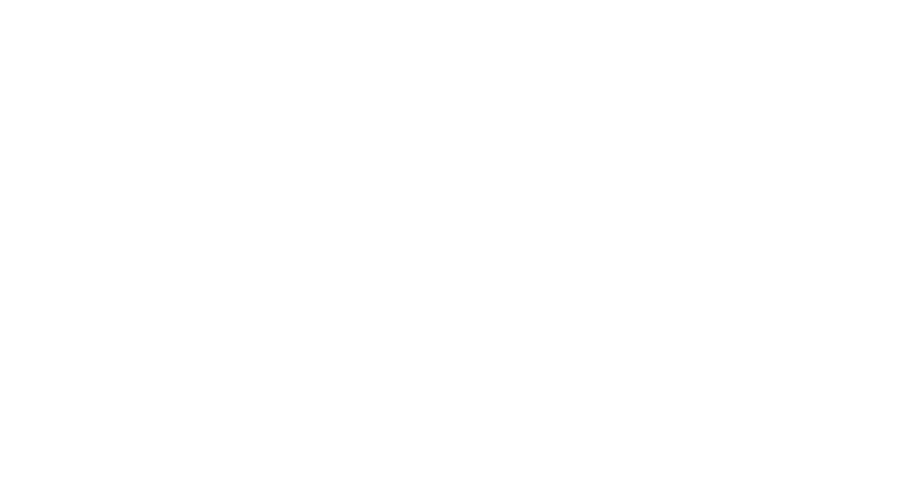

<IPython.core.display.Javascript object>


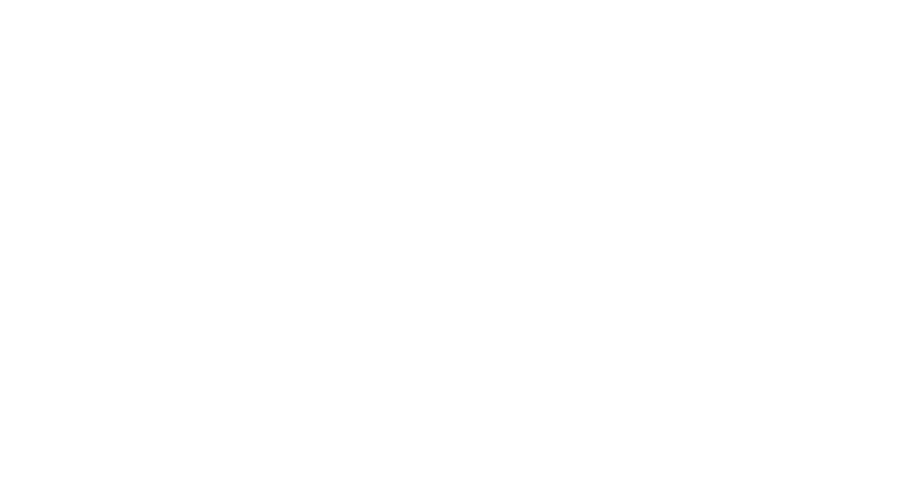

<IPython.core.display.Javascript object>


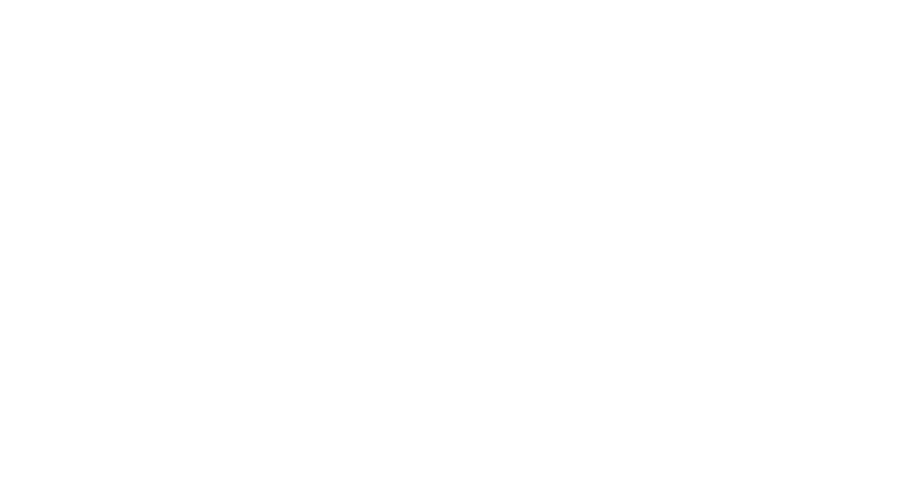

In [8]:
# for knn_dist in ['cosine','euclidean',jaccard]:
#     for mds_dist in ['euclidean','cosine']:
#         for n_components in range(2,6):
#             for n_pca in [5,10,15]:
#                 for gamma in [-1.0,0.0,1.0]:
#                     if knn_dist != 'cosine' and  knn_dist != 'euclidean':
#                         knn_dist_name='jaccard'
#                     else:
#                         knn_dist_name=knn_dist
#                     file = "Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy"
#                     if n_components == 2:
#                         plot_figure_2D_Kmeans(np.load(file),file)
#                         plt.savefig(file+".png")
#                         plt.close('all')
#                     else:
#                         plot_figure_3D_Kmeans(np.load(file),file)
#                         plt.savefig(file+".png")
#                         plt.close('all')


In [9]:
import scipy.io as io

In [30]:
# for knn_dist_name,mds_dist,n_components,n_pca,gamma in [('cosine','cosine',4,5,-1.0),('cosine','cosine',4,15,0.0),('cosine','cosine',4,15,1.0),('cosine','cosine',2,15,-1.0)]:
# for knn_dist_name,mds_dist,n_components,n_pca,gamma in [('cosine','cosine',2,10,-1.0)]:
#     file = "Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)
#     data = np.load(file+'.npy')
#     io.savemat(file+'.mat',{'kmeans':KMeans(n_clusters=5, random_state=123).fit_predict(data),'data':data,"knn_dist":knn_dist_name,"mds_dist":mds_dist,"nb_comp":n_components,"nb_pca":n_pca,"gamma":gamma})

In [10]:
from sklearn.metrics import silhouette_samples, silhouette_score

In [12]:
def plot_figure_2D(data,title,cluster_point):
    fig = plt.figure(figsize=(9,5))
    plt.title(title)
    plt.axis('off')
    ax_1 = fig.add_subplot(121)
    ax_1.scatter(data[:,0],data[:,1],c=np.arange(data.shape[0]),s=0.8)
    ax_1.set_title('time')
    ax_2 = fig.add_subplot(122)
    ax_2.scatter(data[:,0],data[:,1],c=cluster_point,s=0.8)
    ax_2.set_title('cluster')

def plot_figure_3D(data,title,cluster_point):
    fig = plt.figure(figsize=(9,5))
    plt.title(title)
    plt.axis('off')
    ax_1 = fig.add_subplot(121,projection='3d')
    ax_1.scatter(data[:,0],data[:,1],data[:,2],c=np.arange(data.shape[0]),s=0.8)
    ax_1.set_title('time')
    ax_2 = fig.add_subplot(122,projection='3d')
    a=ax_2.scatter(data[:,0],data[:,1],data[:,2],c=cluster_point,s=0.8,cmap='tab20')
    ax_2.set_title('cluster')
    plt.colorbar(a)
    plt.show()

<IPython.core.display.Javascript object>


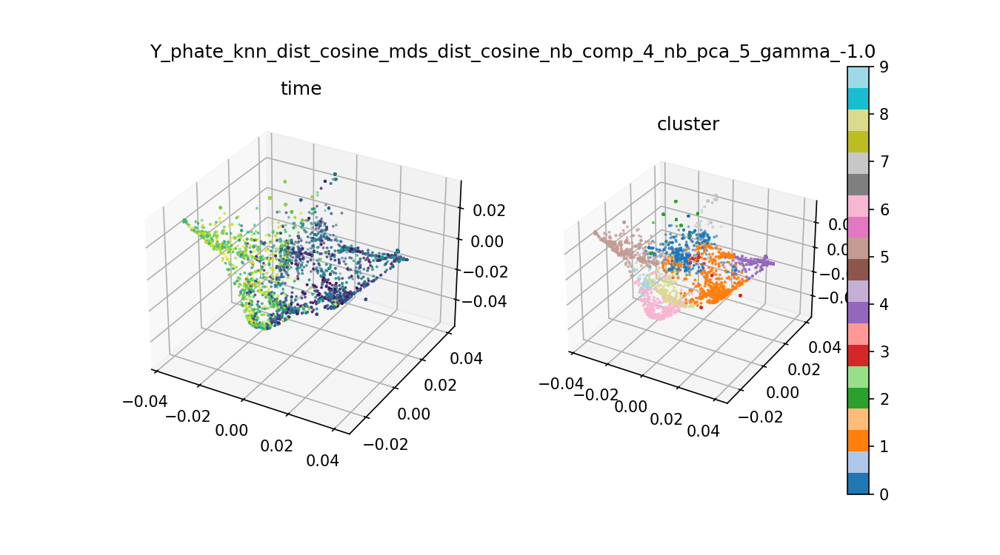

<IPython.core.display.Javascript object>


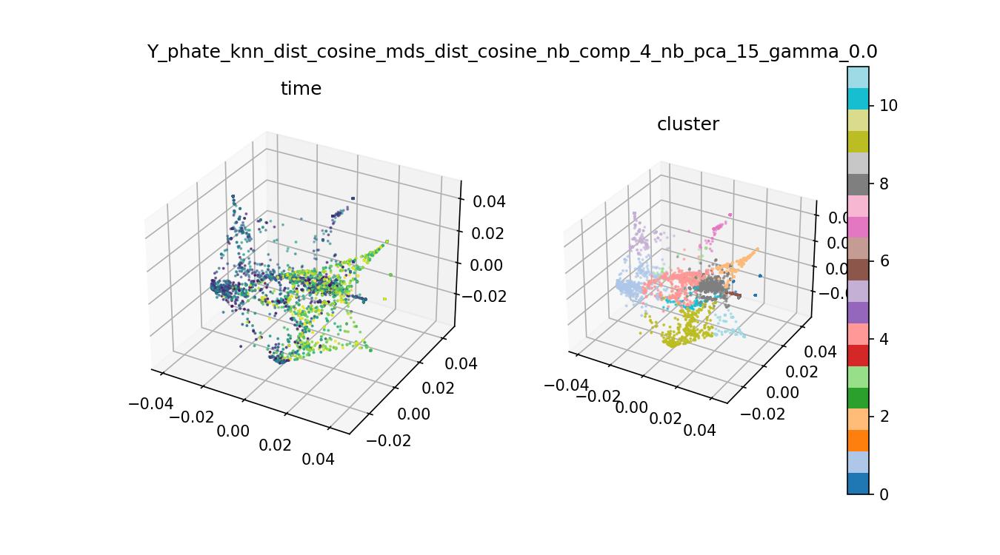

<IPython.core.display.Javascript object>


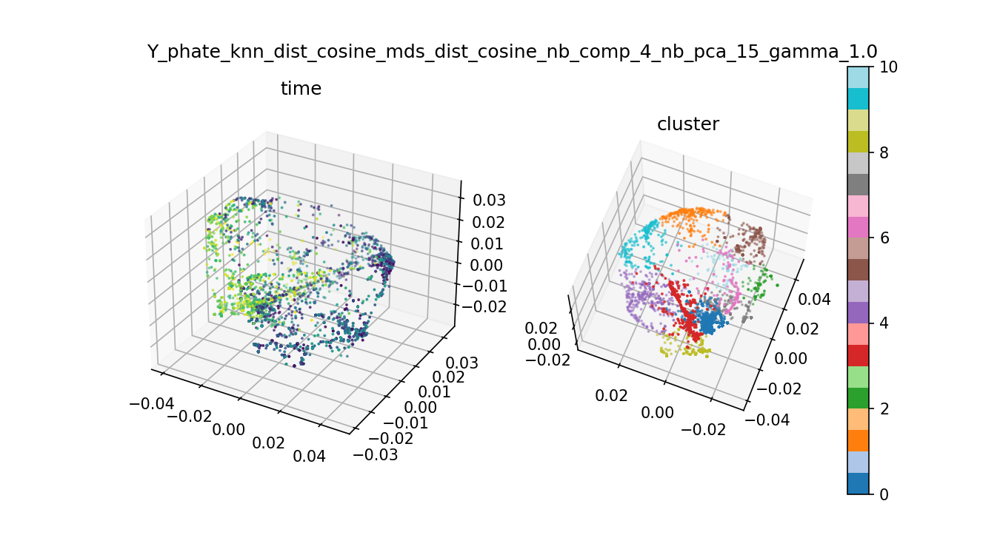

In [52]:
# for knn_dist_name,mds_dist,n_components,n_pca,gamma,nb_cluster in [('cosine','cosine',4,5,-1.0,10),('cosine','cosine',4,15,0.0,12),('cosine','cosine',4,15,1.0,11)]:#,('cosine','cosine',2,10,-1.0,8)]:
#     file = "Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)
#     data = np.load(file+'.npy')
#     plot_figure_3D(data,file,KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data))
#     io.savemat(file+'.mat',{'kmeans':KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data),'data':data,"knn_dist":knn_dist_name,"mds_dist":mds_dist,"nb_comp":n_components,"nb_pca":n_pca,"gamma":gamma,'nb_cluster':nb_cluster})
# for knn_dist_name,mds_dist,n_components,n_pca,gamma in [('cosine','cosine',4,5,-1.0),('cosine','cosine',4,15,0.0),('cosine','cosine',4,15,1.0)]:
#     file = "Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)
#     data = np.load(file+'.npy')
#     scores = []
#     for i in range(2,20):
#         cluster_point = KMeans(n_clusters=i, random_state=123).fit_predict(data)
#         scores.append( silhouette_score(data, cluster_point))
#         plot_figure_2D(data,file,cluster_point)
#     plt.figure()
#     plt.plot(range(2,20),scores)

<IPython.core.display.Javascript object>


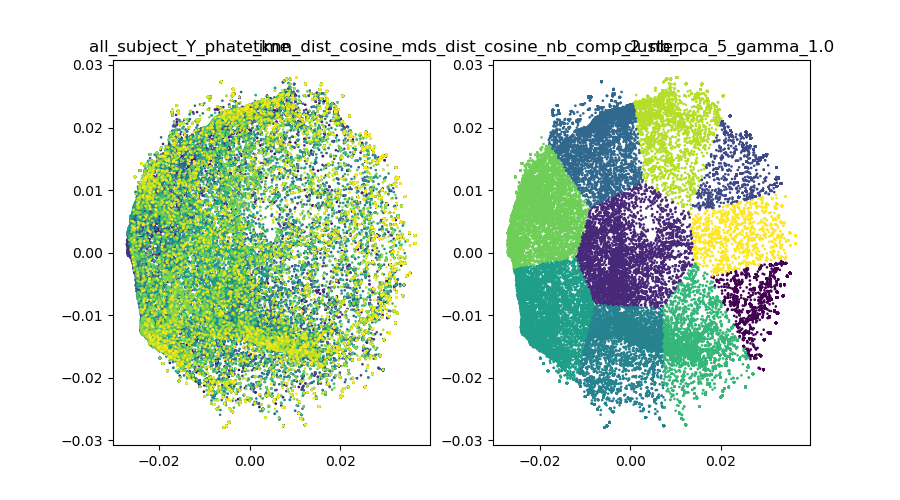

<IPython.core.display.Javascript object>


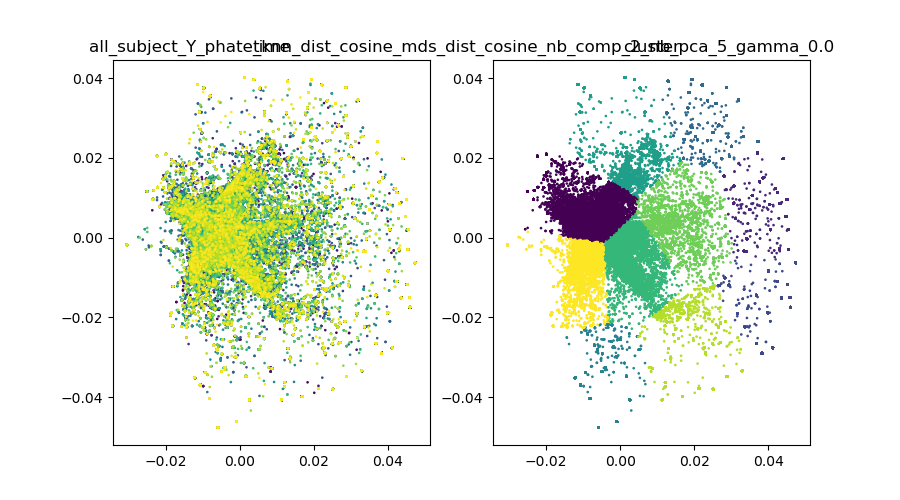

<IPython.core.display.Javascript object>


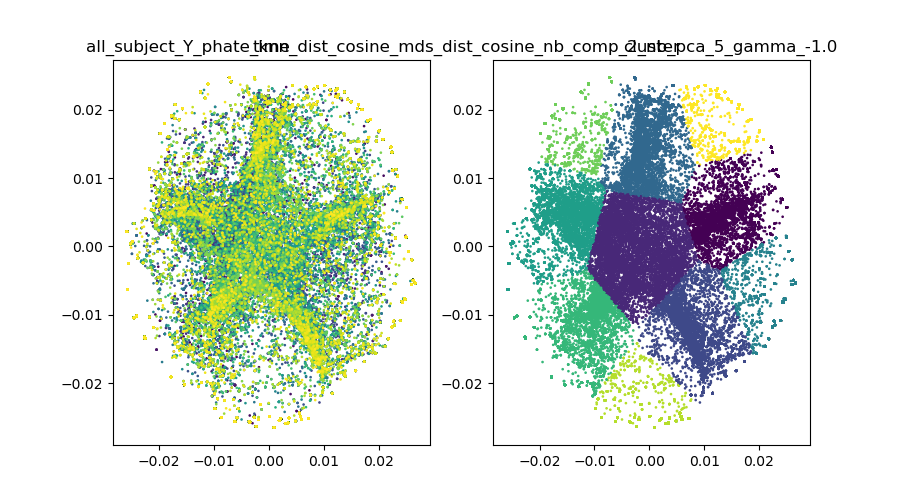

In [8]:
for knn_dist_name,mds_dist,n_components,n_pca,gamma,nb_cluster in [('cosine','cosine',2,5,1.0,10),('cosine','cosine',2,5,0.0,10),('cosine','cosine',2,5,-1.0,10)]:
    file = "all_subject_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)
    data = np.load(file+'.npy')
    plot_figure_2D(data,file,KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data))

<IPython.core.display.Javascript object>


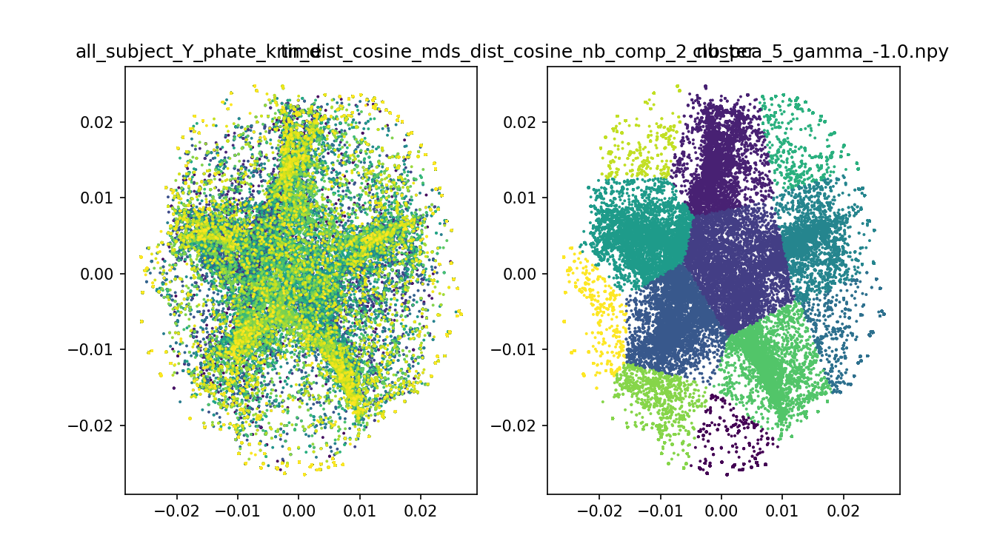

all_subject_Y_phate_knn_dist_cosine_mds_dist_cosine_nb_comp_2_nb_pca_5_gamma_-1.0.npy


In [119]:
knn_dist = 'cosine'
mds_dist = 'cosine'
knn_dist_name=knn_dist
nb_cluster= 12
n_components =2
n_pca=5
gamma=-1.0
file = "all_subject_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy"
data=np.load(file)
plot_figure_2D(data,file,KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data))

In [57]:
clusters = KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data)

<IPython.core.display.Javascript object>


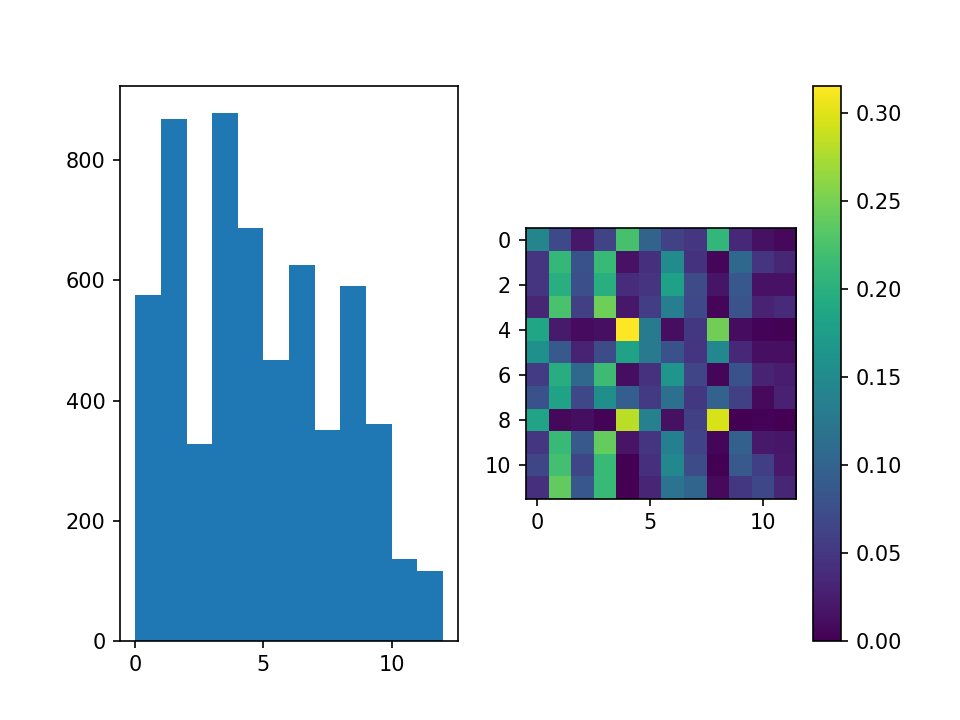

<IPython.core.display.Javascript object>


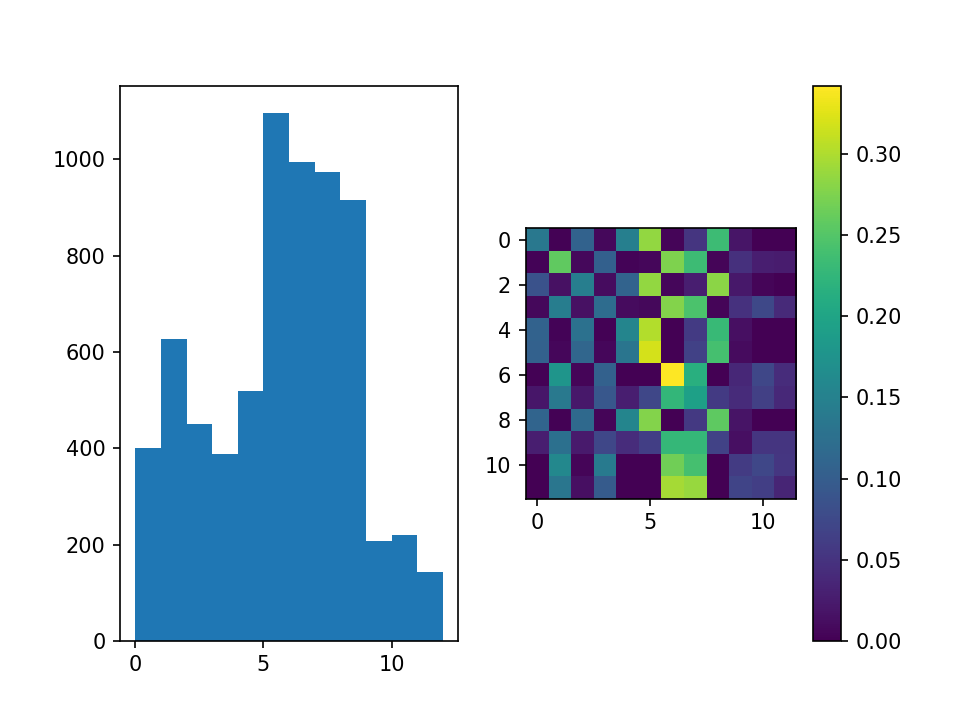

<IPython.core.display.Javascript object>


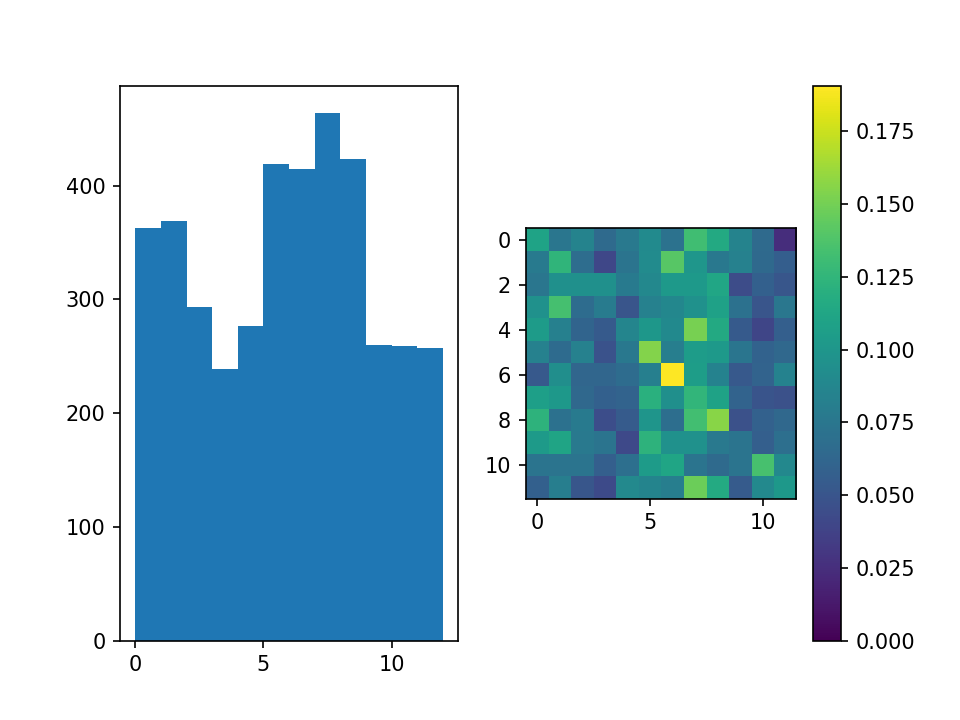

<IPython.core.display.Javascript object>


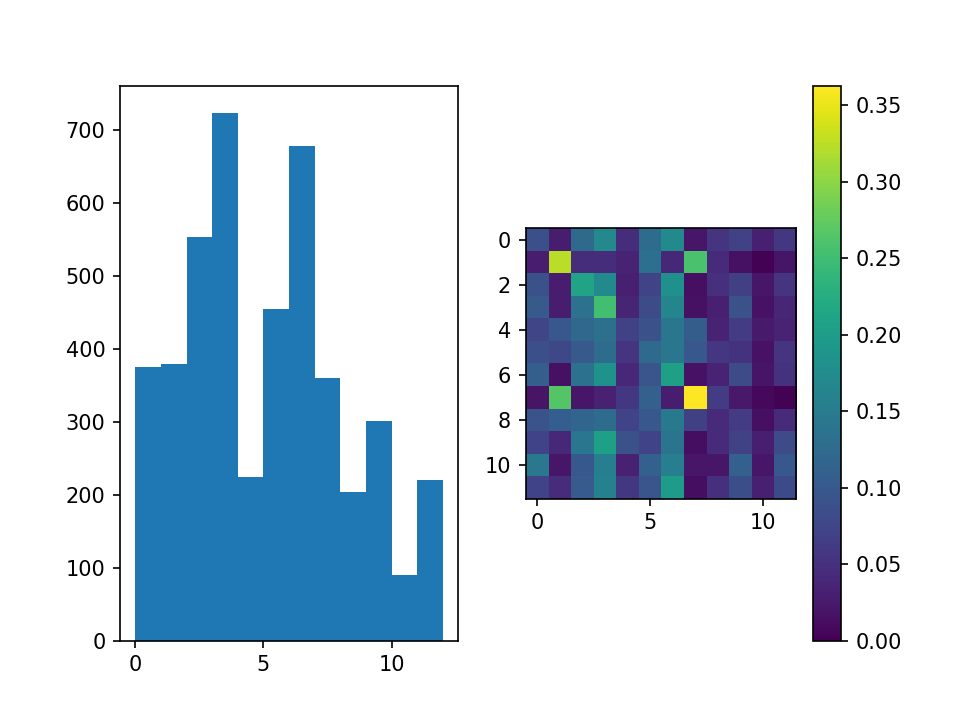

<IPython.core.display.Javascript object>


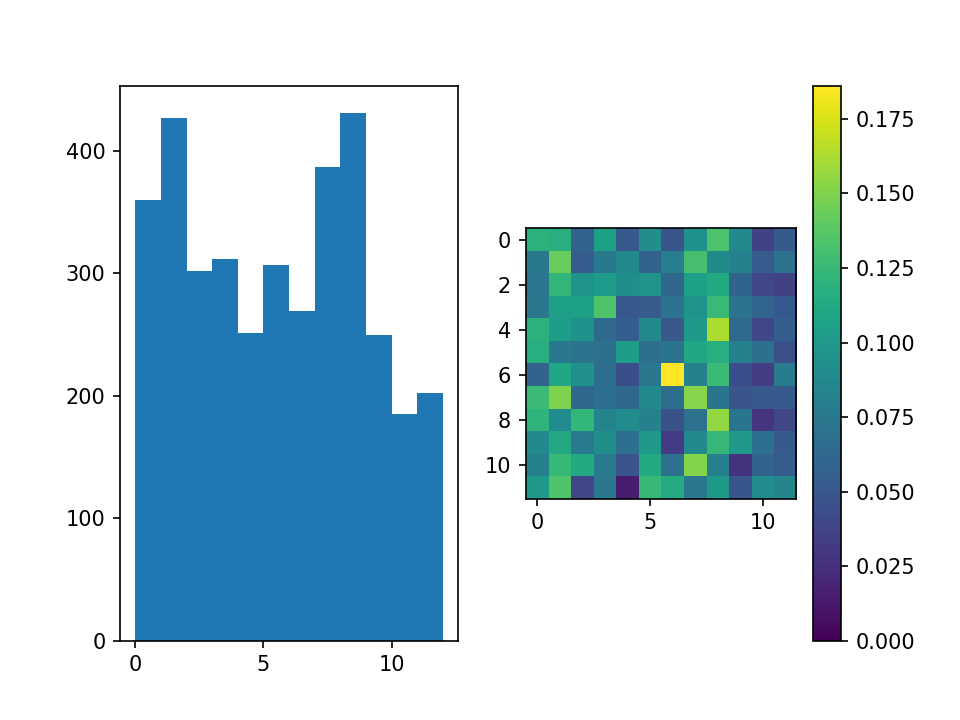

<IPython.core.display.Javascript object>


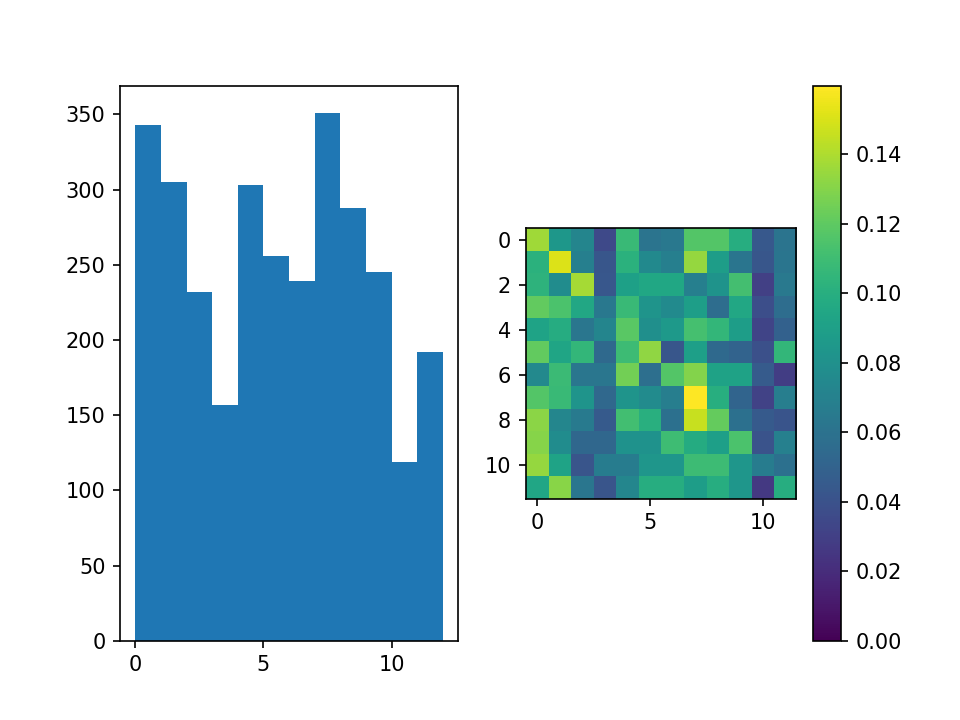

<IPython.core.display.Javascript object>


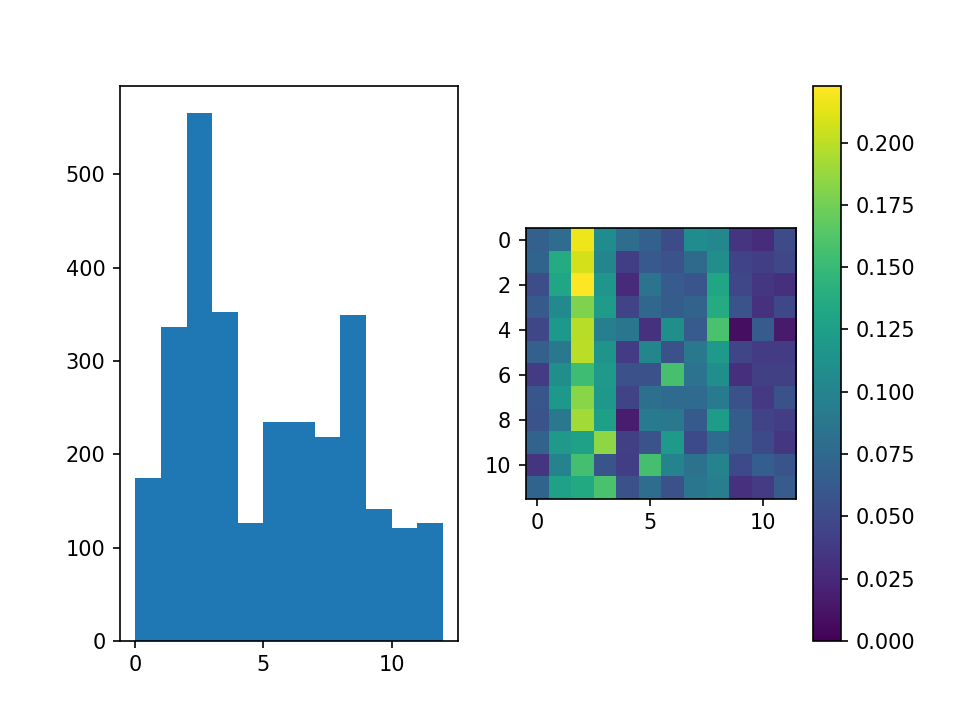

<IPython.core.display.Javascript object>


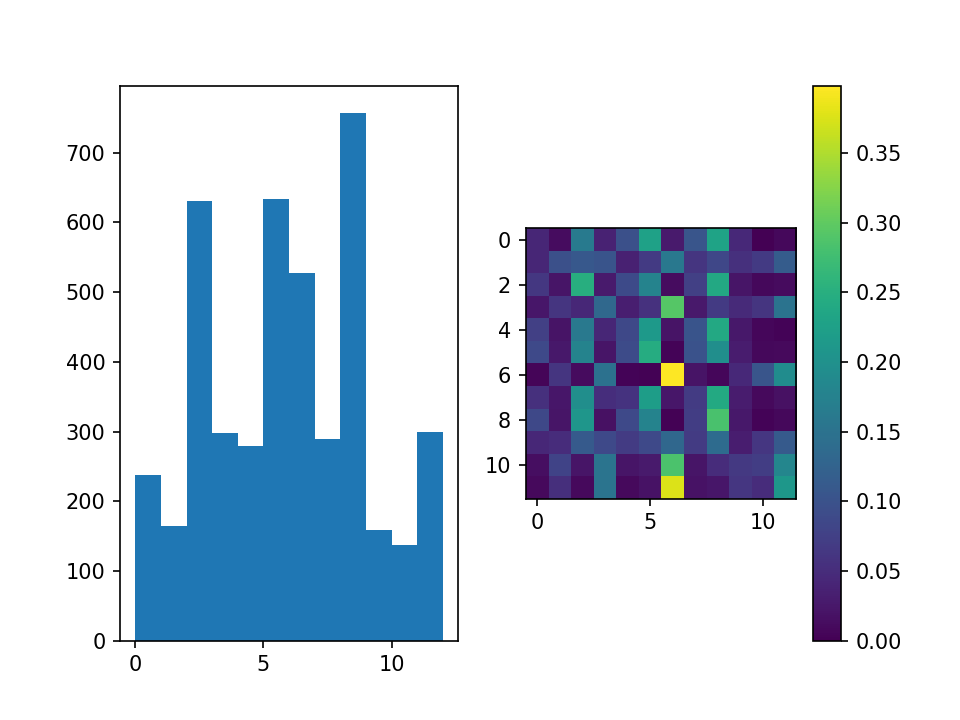

<IPython.core.display.Javascript object>


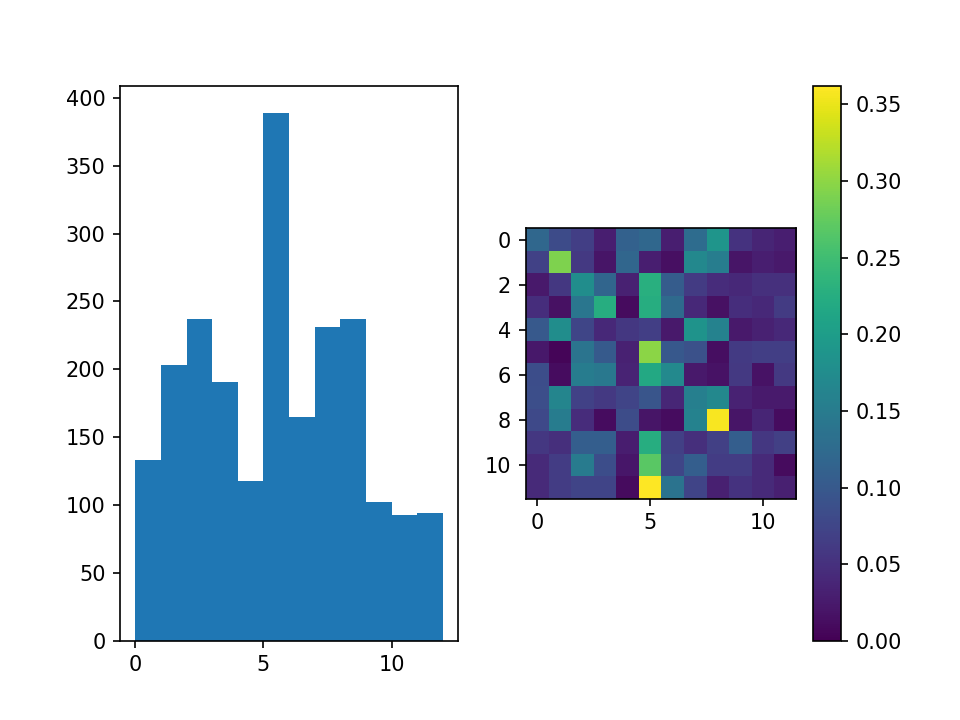

<IPython.core.display.Javascript object>


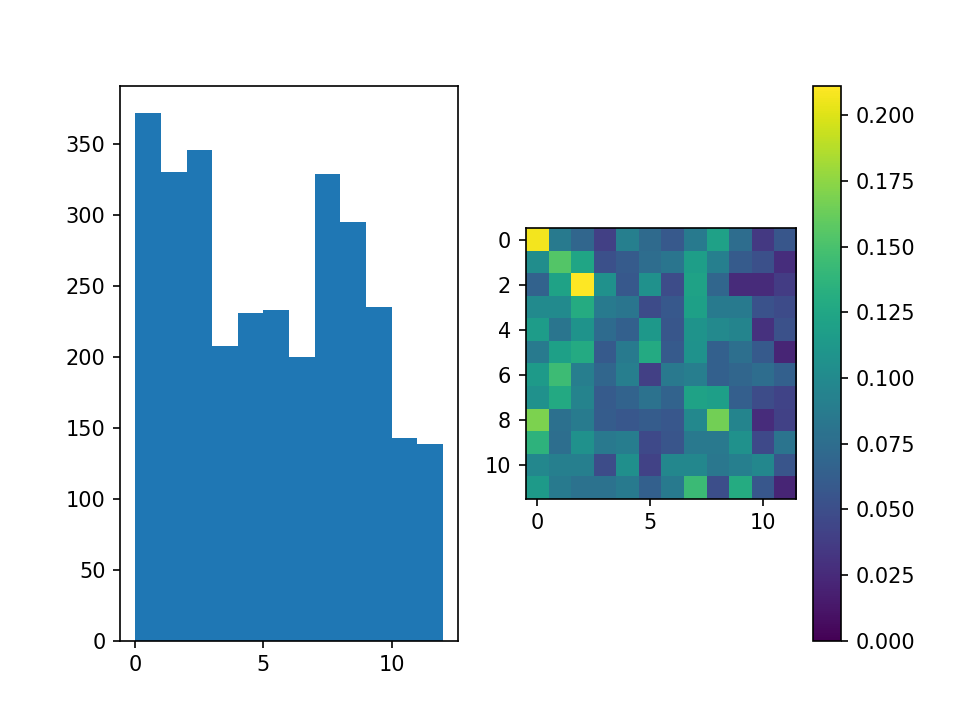

<IPython.core.display.Javascript object>


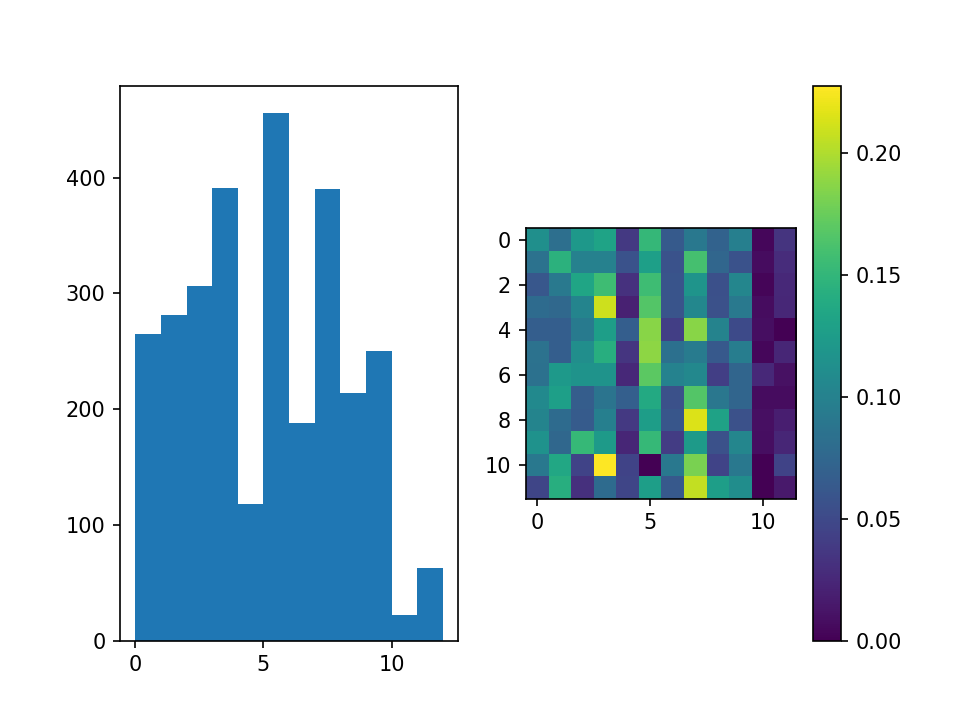

<IPython.core.display.Javascript object>


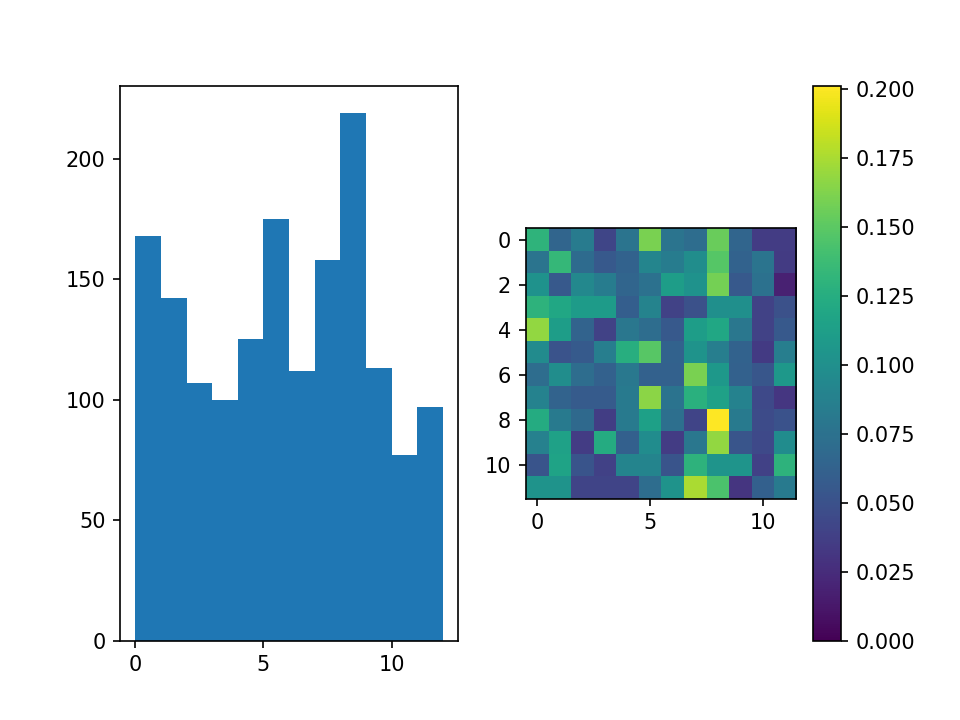

<IPython.core.display.Javascript object>


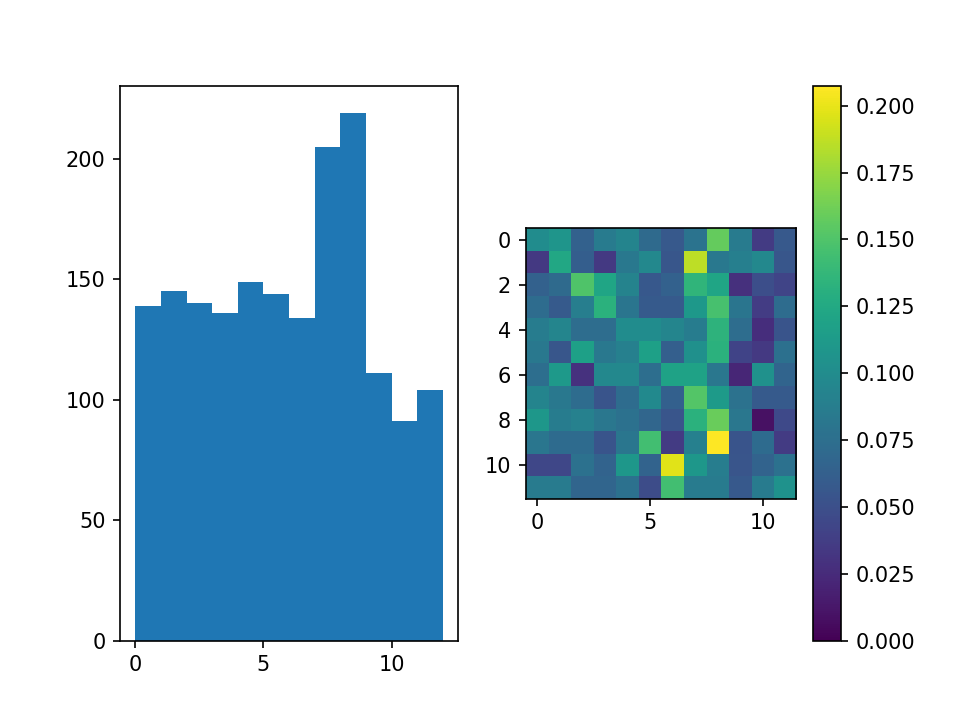

<IPython.core.display.Javascript object>


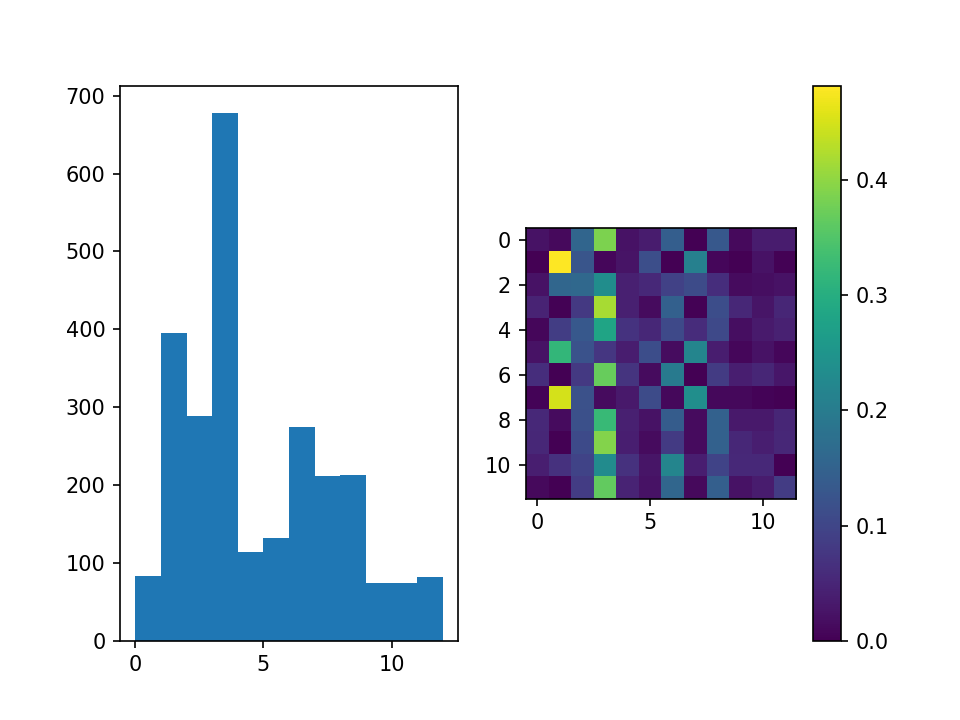

<IPython.core.display.Javascript object>


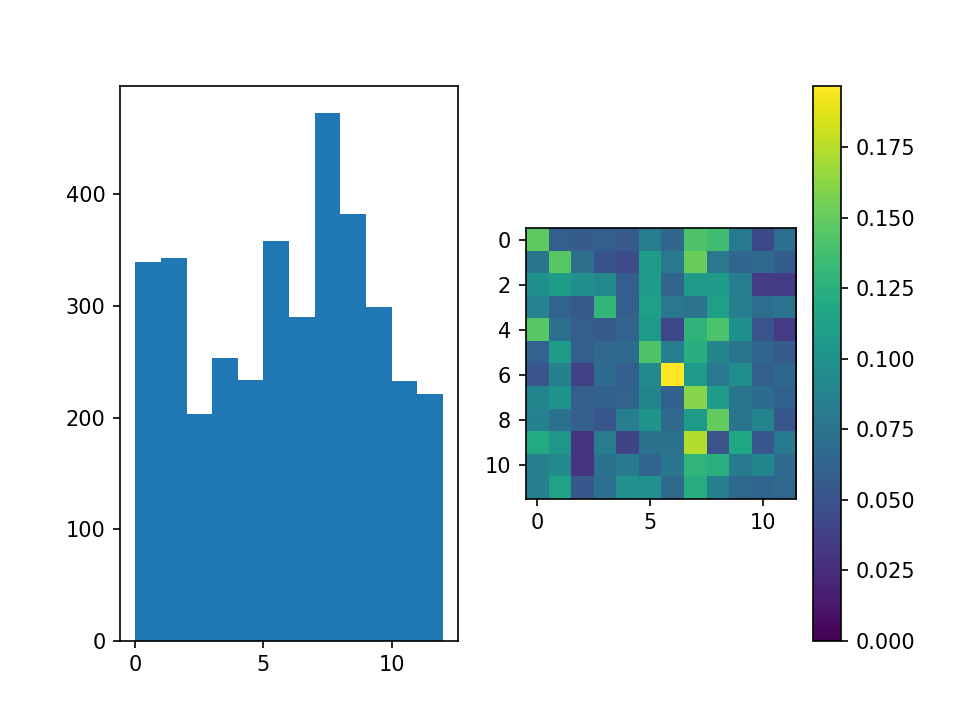

<IPython.core.display.Javascript object>


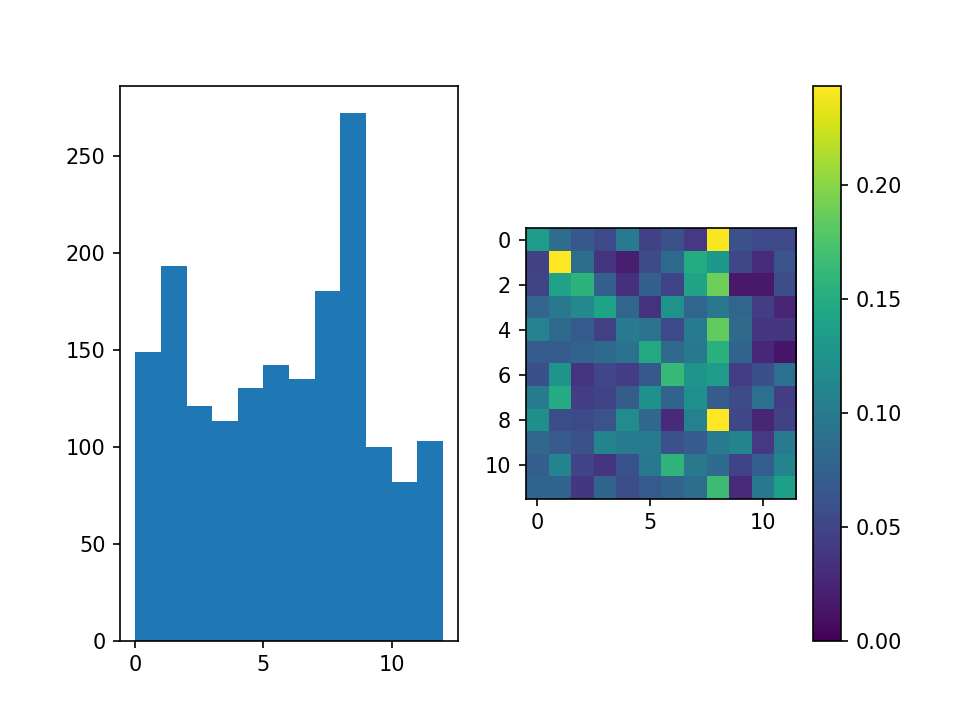

<IPython.core.display.Javascript object>


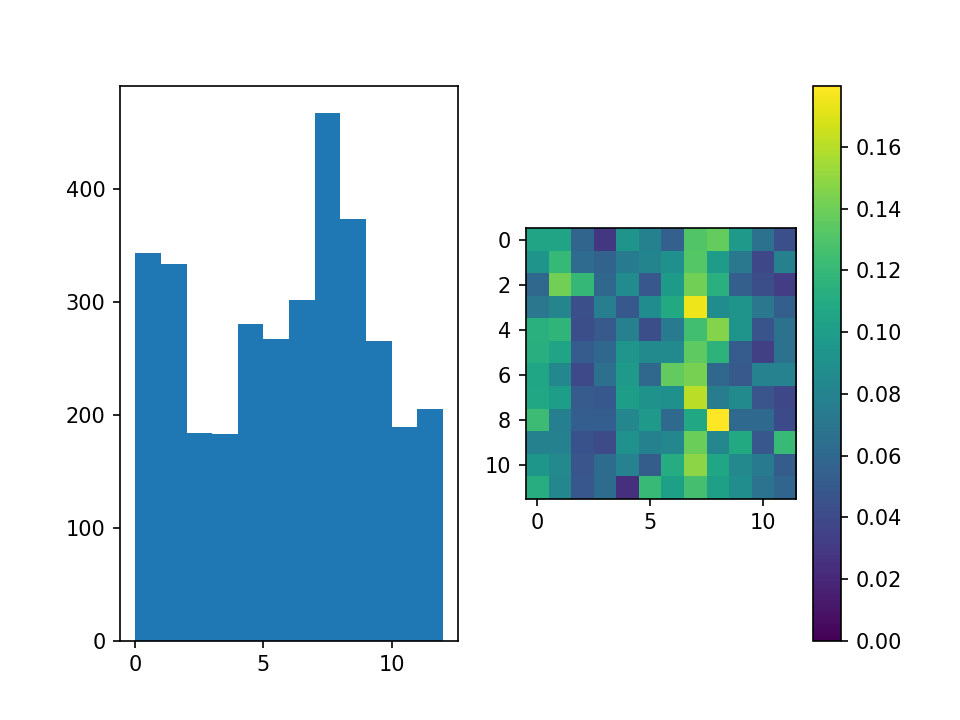

<IPython.core.display.Javascript object>


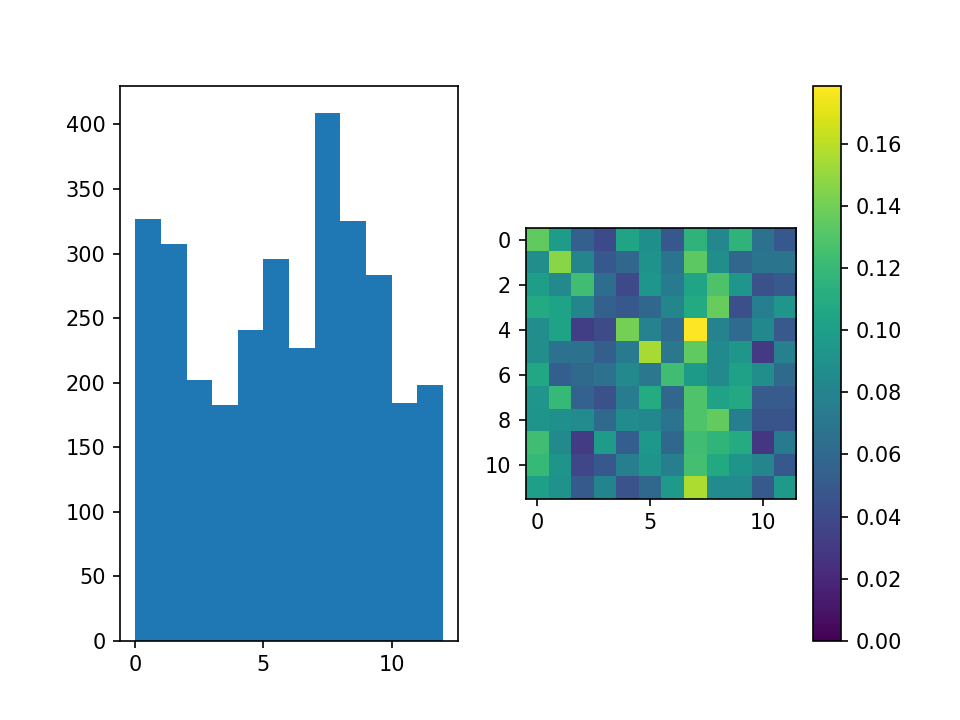

In [121]:
file = "all_subject_Y_phate_knn_dist_cosine_mds_dist_cosine_nb_comp_2_nb_pca_5_gamma_-1.0.npy"
save = True
plot = True
cluster_patient_data = []
begin = 0
for avalanche in avalanches_bin:
    end = begin + len(avalanche)
    cluster_patient_data.append(cluster[begin:end])
    begin = end
cluster_patient = np.empty((len(avalanches_bin),nb_cluster))
transition = np.empty((len(subjects),nb_cluster,nb_cluster))
histograms_patient = np.empty((len(subjects),nb_cluster))
for index_patient, cluster_k in enumerate(cluster_patient_data):
    hist = np.histogram(cluster_k,bins=nb_cluster,range=(0,12))
    histograms_patient[index_patient,:]=hist[0]
    next_step = cluster_k[1:]
    step = cluster_k[:-1]
    for i in range(nb_cluster):
        data = next_step[np.where(step==i)]
        percentage_trans = np.bincount(data)/len(data)
        if len(percentage_trans) < nb_cluster:
            percentage_trans = np.concatenate([percentage_trans,np.zeros(nb_cluster-percentage_trans.shape[0])])
        transition[index_patient,i,:] = percentage_trans
if plot:
    for index_patient, cluster_k in enumerate(cluster_patient_data):
        fig, axs = plt.subplots(1,2)
        axs[0].hist(cluster_k,bins=nb_cluster,range=(0,12))
        im = axs[1].imshow(transition[index_patient],vmin = 0.0)
        fig.colorbar(im)
if save :
    data = np.load(file)
    io.savemat('cluster_18_patients.mat',{'avalanches_binarize':np.concatenate(avalanches_bin),'cluster_index':KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data),'PHATE_position':data,
                                     'transition_matrix':transition, 'histogram':histograms_patient})

In [112]:
np.histogram(cluster_k,bins=nb_cluster,range=(0,12))

(array([576, 868, 327, 879, 688, 467, 626, 351, 591, 361, 136, 117],
       dtype=int64),
 array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.]))

<IPython.core.display.Javascript object>


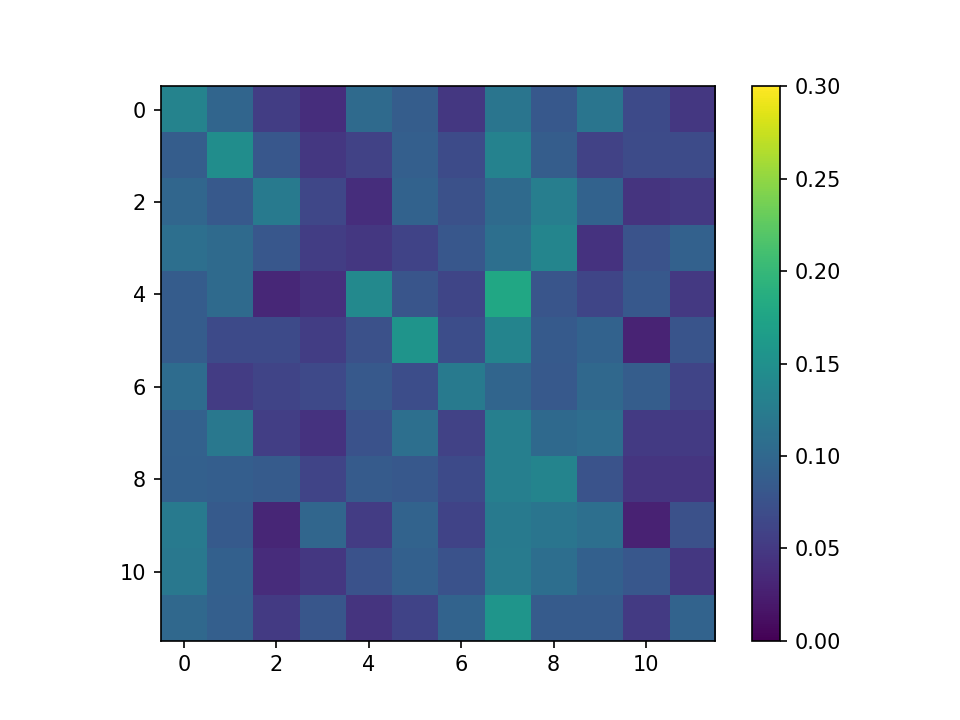

<IPython.core.display.Javascript object>


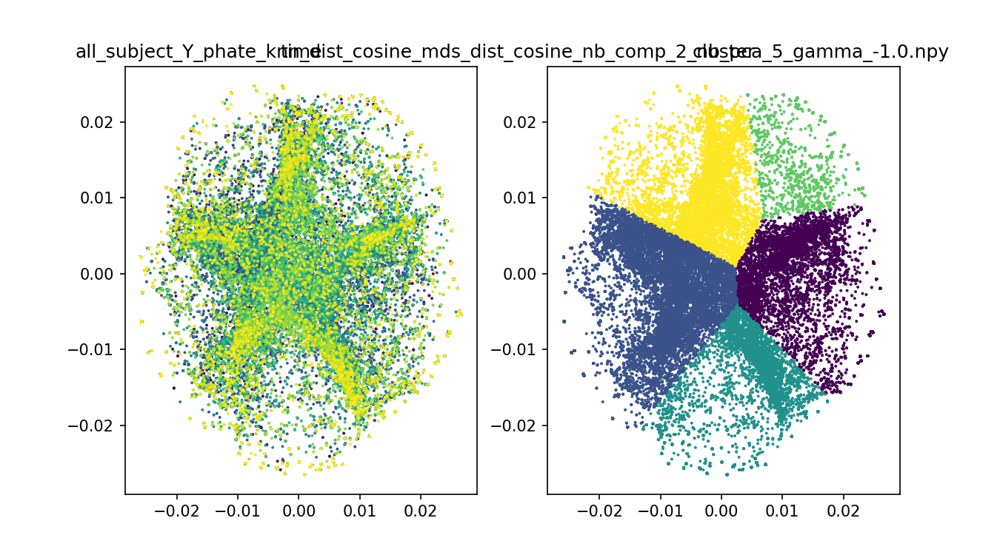

<IPython.core.display.Javascript object>


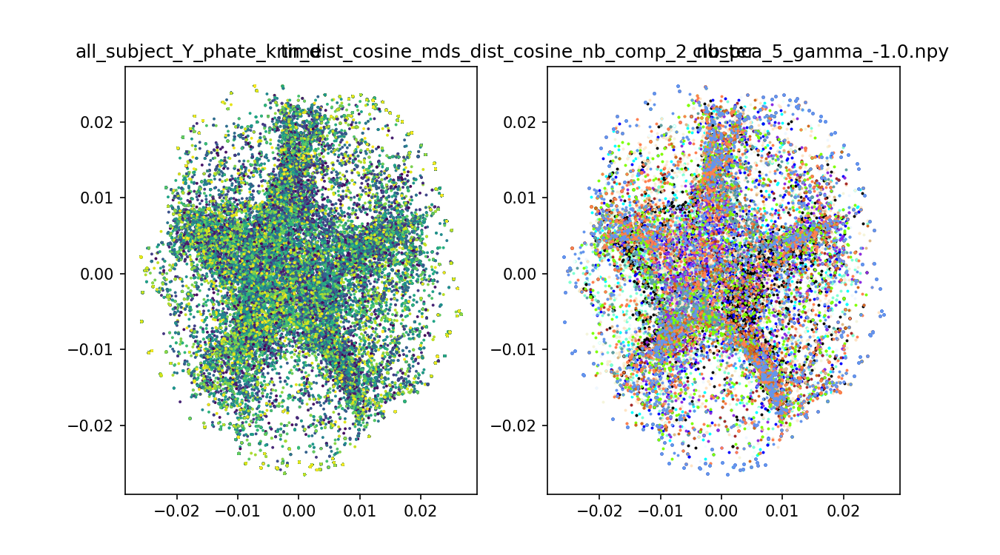

<IPython.core.display.Javascript object>


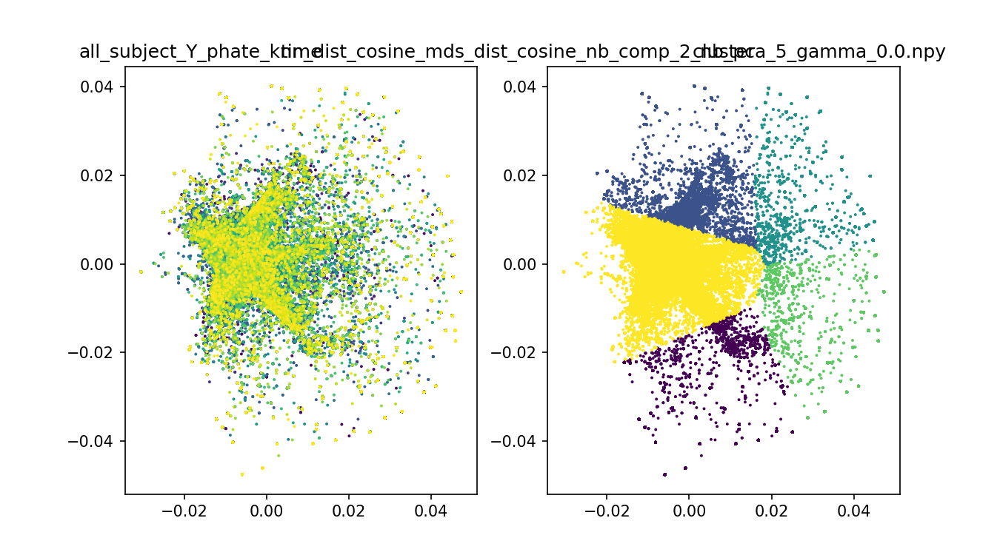

<IPython.core.display.Javascript object>


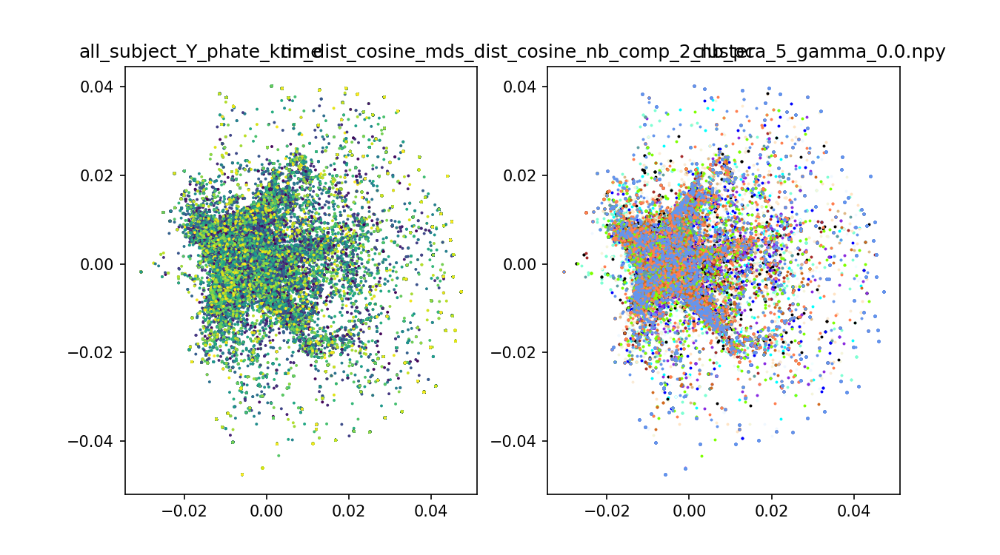

<IPython.core.display.Javascript object>


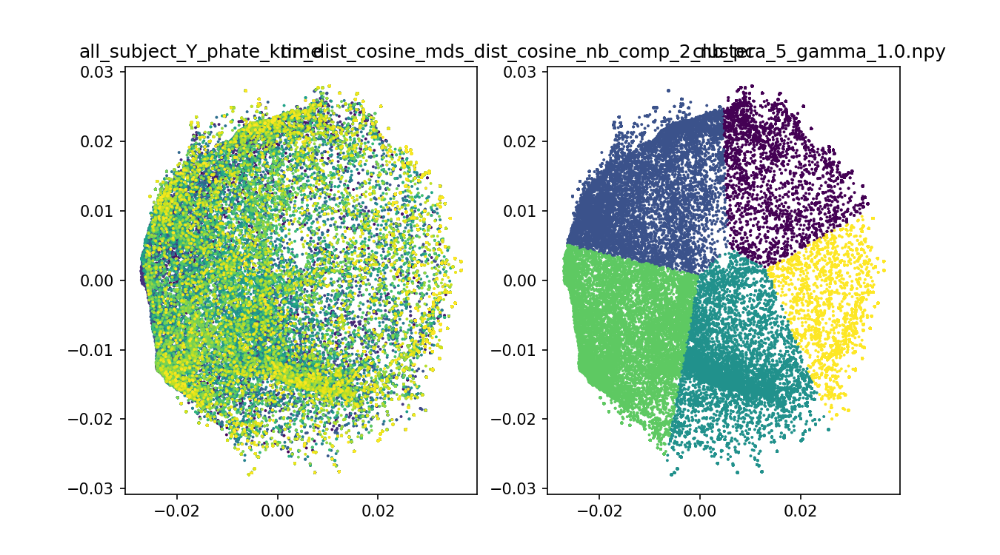

<IPython.core.display.Javascript object>


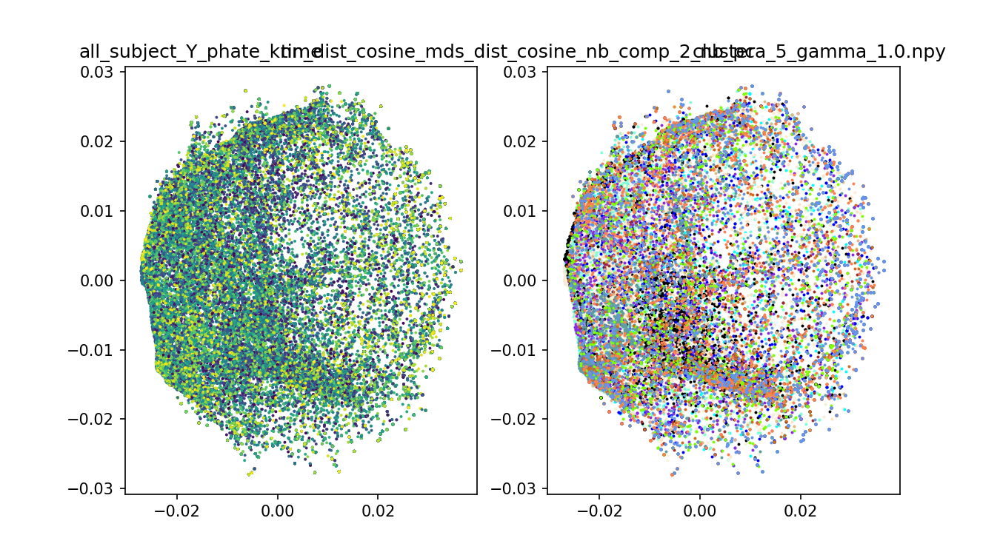

<IPython.core.display.Javascript object>


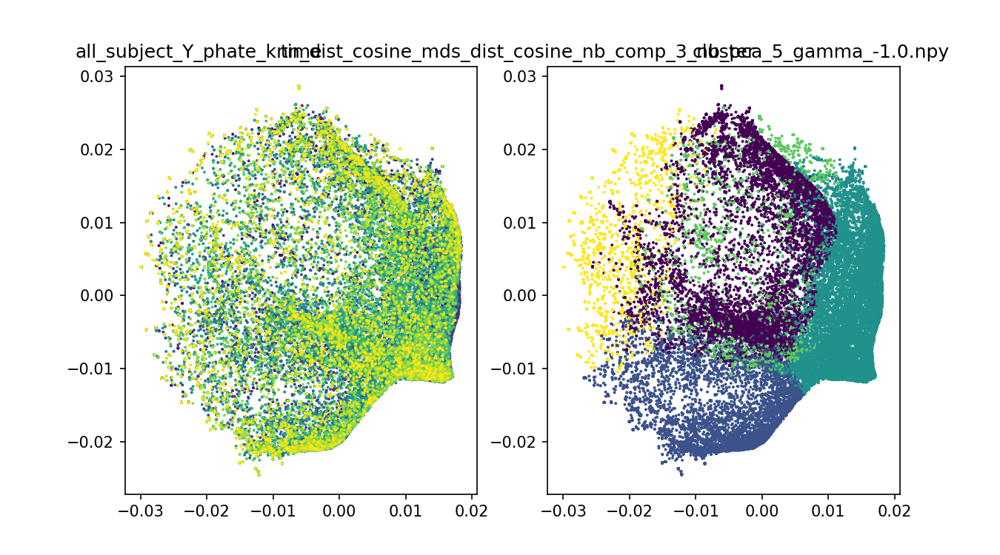

<IPython.core.display.Javascript object>


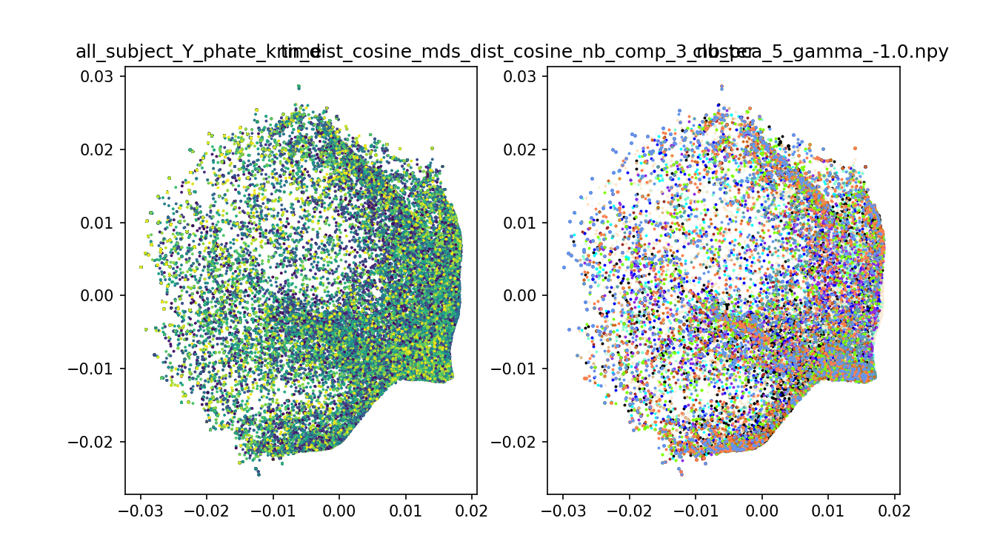

<IPython.core.display.Javascript object>


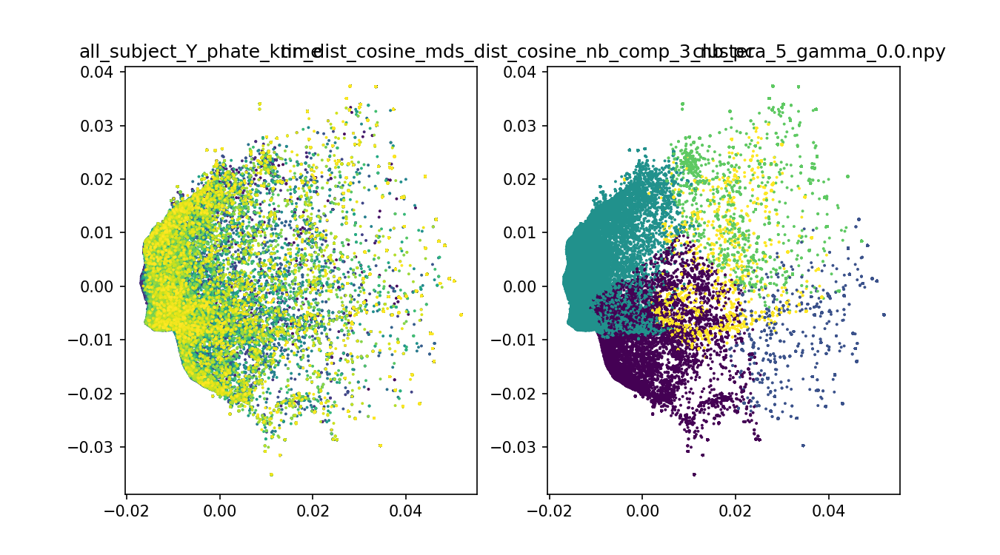

<IPython.core.display.Javascript object>


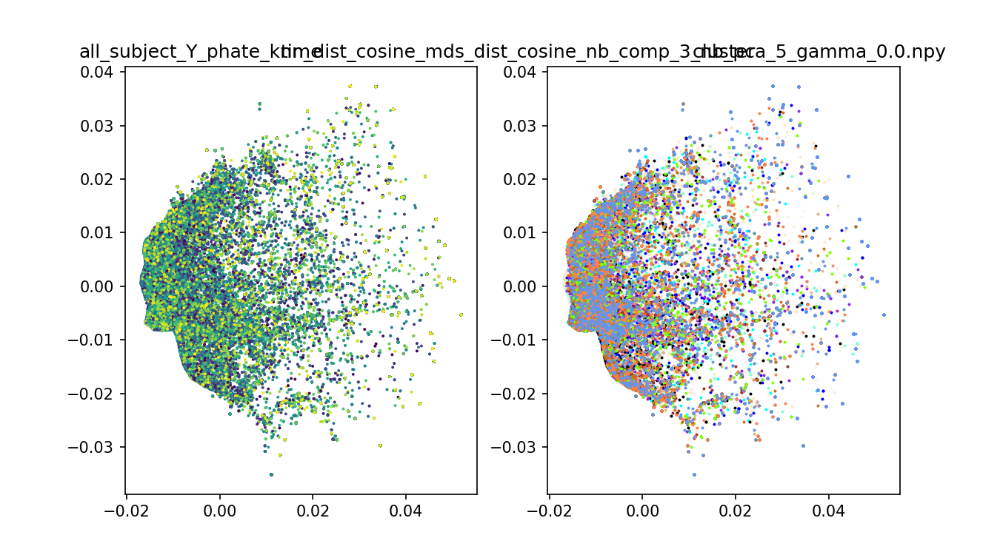

<IPython.core.display.Javascript object>


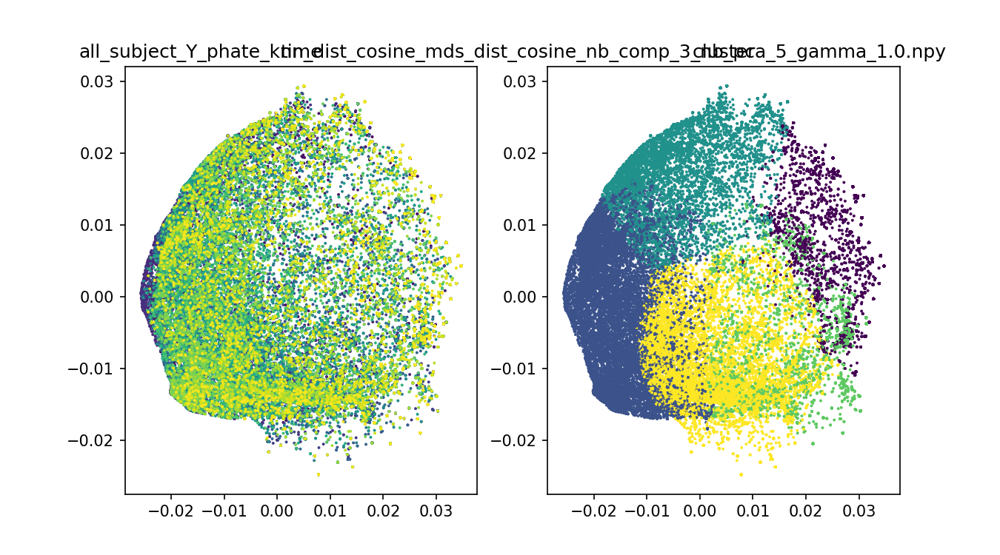

<IPython.core.display.Javascript object>


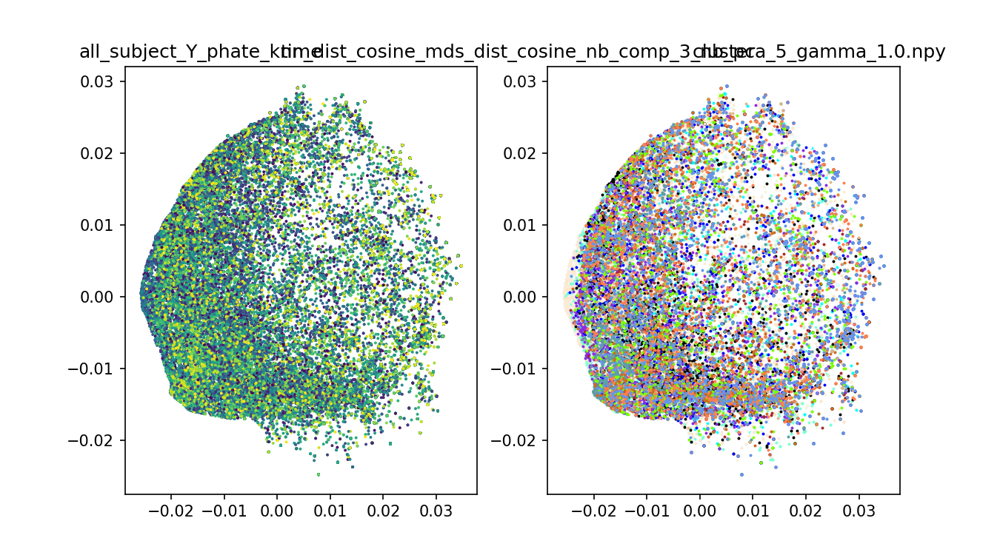

<IPython.core.display.Javascript object>


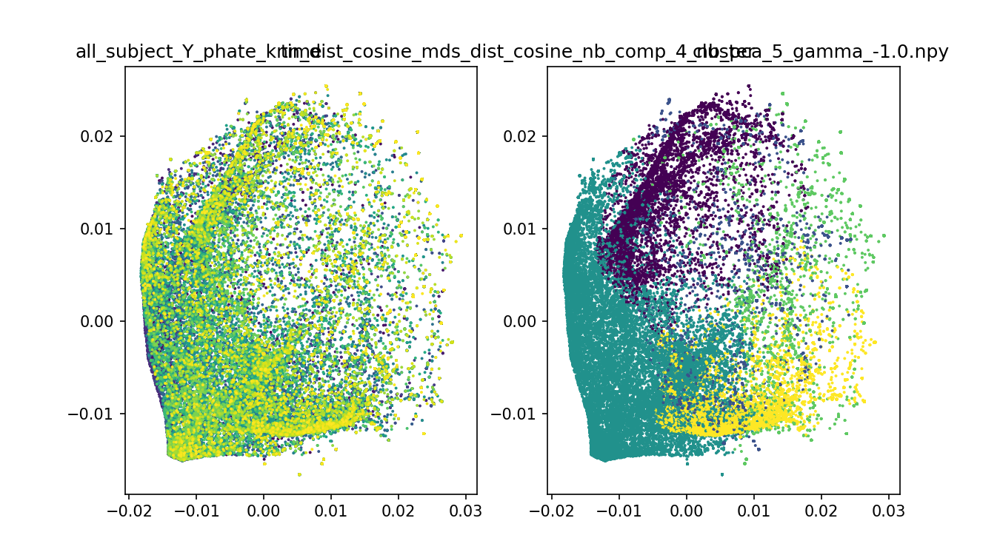

<IPython.core.display.Javascript object>


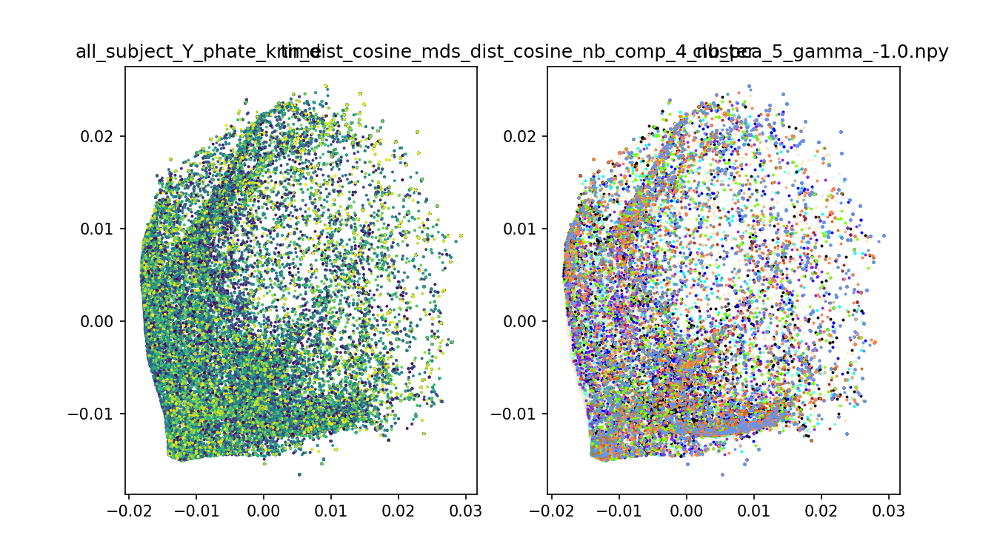

<IPython.core.display.Javascript object>


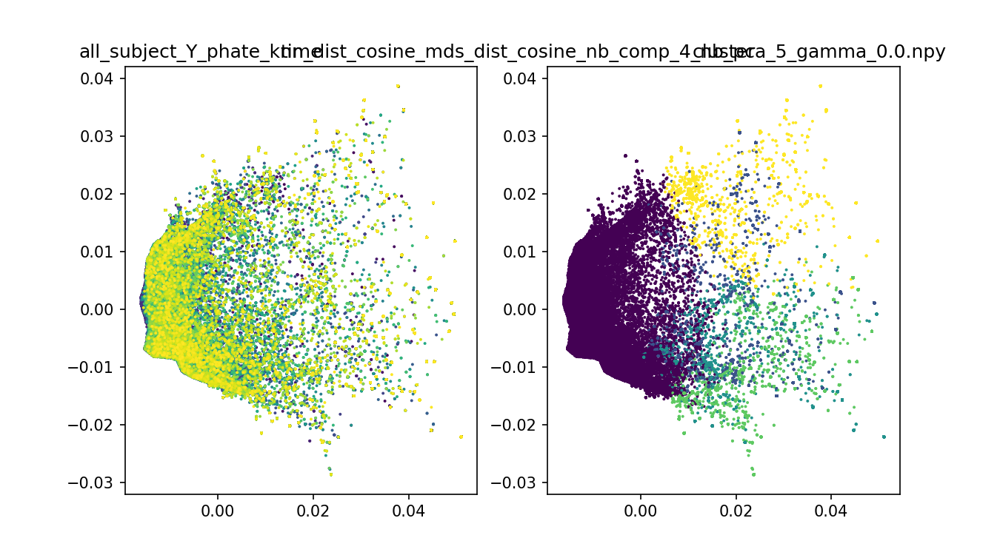

<IPython.core.display.Javascript object>


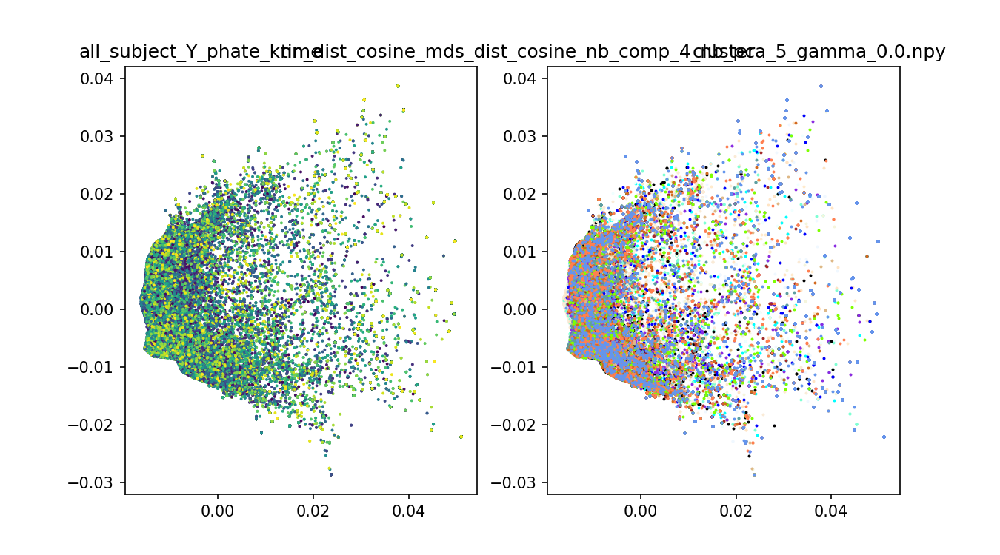

<IPython.core.display.Javascript object>


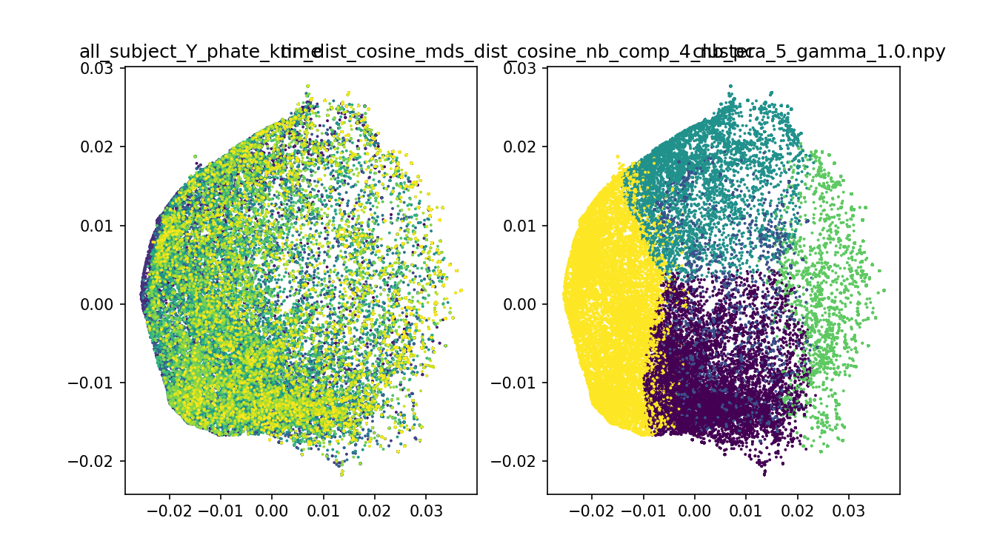

<IPython.core.display.Javascript object>


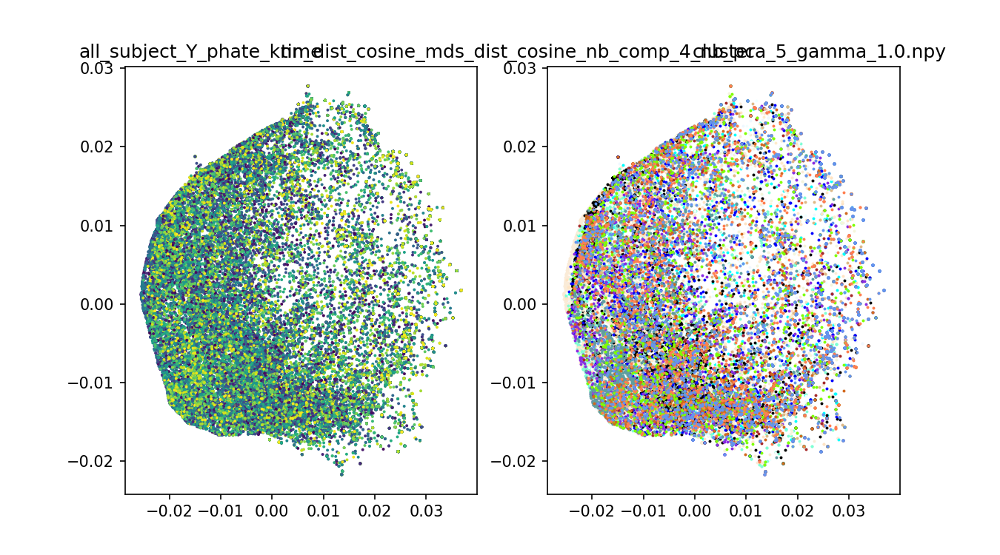

<IPython.core.display.Javascript object>


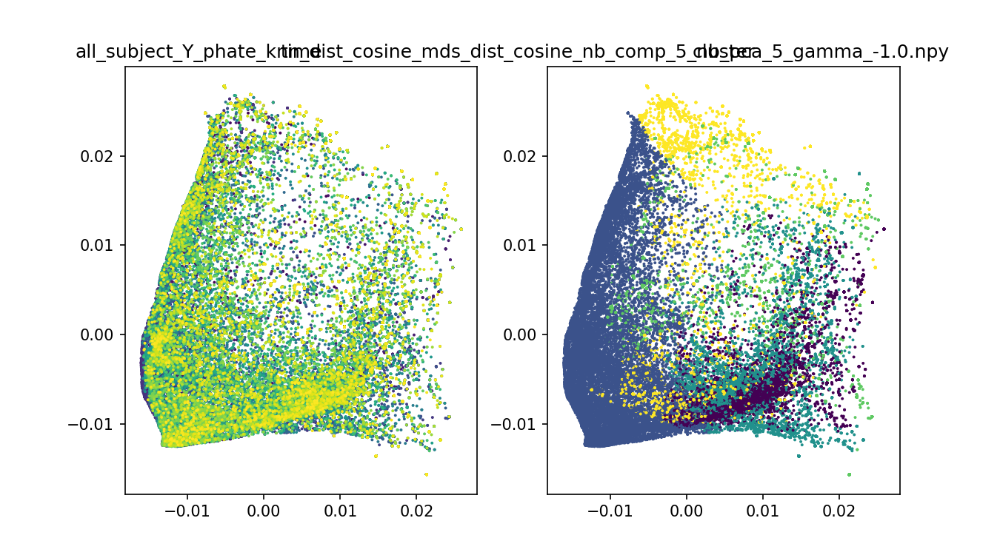

<IPython.core.display.Javascript object>


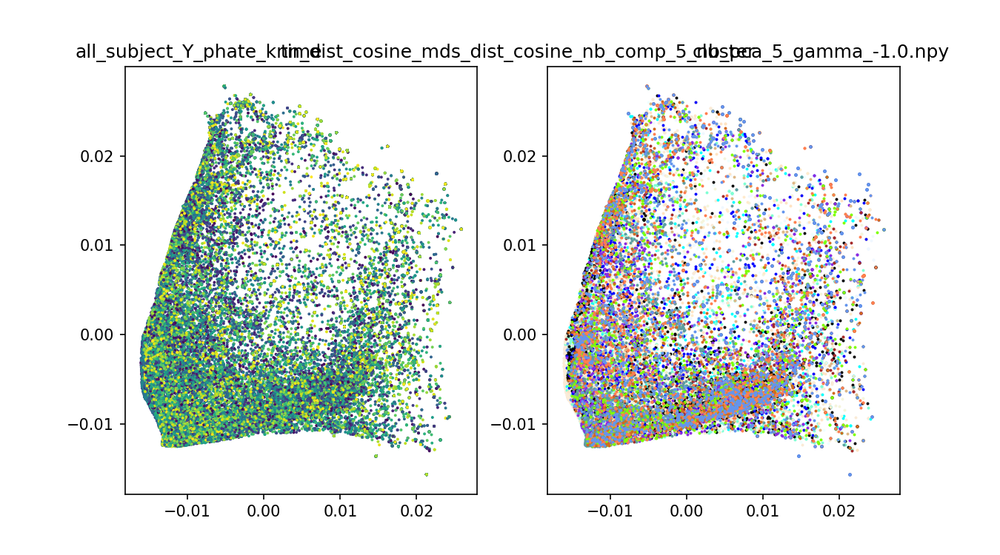

<ipython-input-12-d7a44cbf49df>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9,5))


<IPython.core.display.Javascript object>


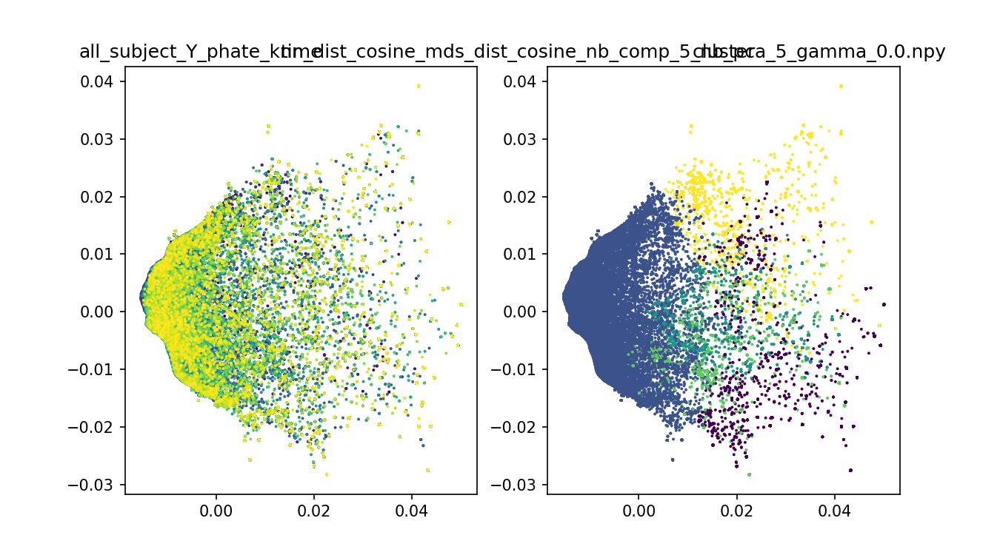

<IPython.core.display.Javascript object>


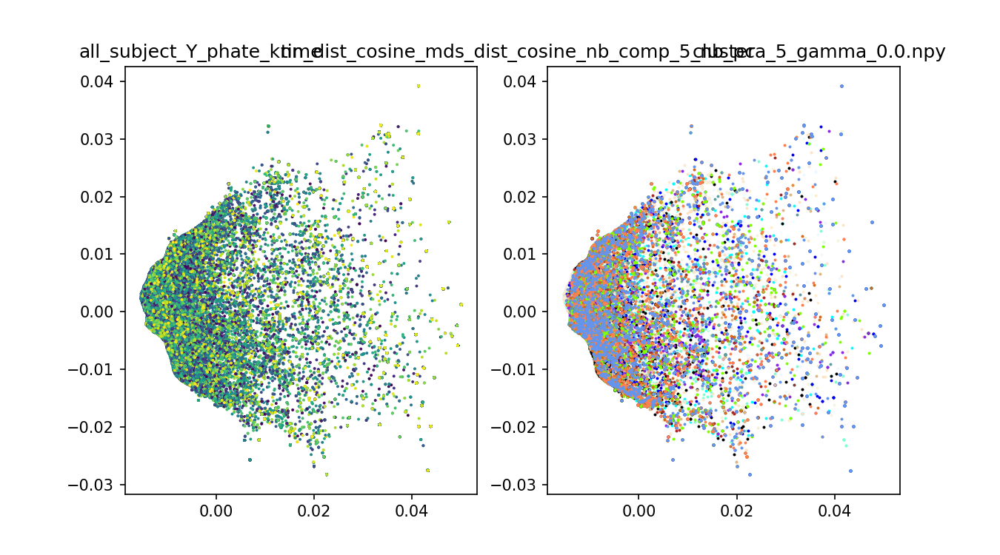

<IPython.core.display.Javascript object>


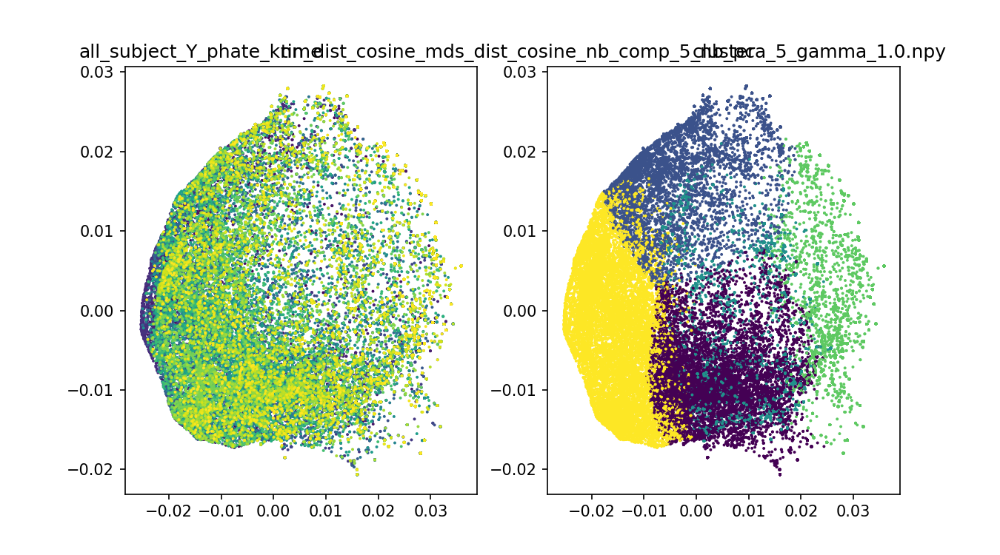

<IPython.core.display.Javascript object>


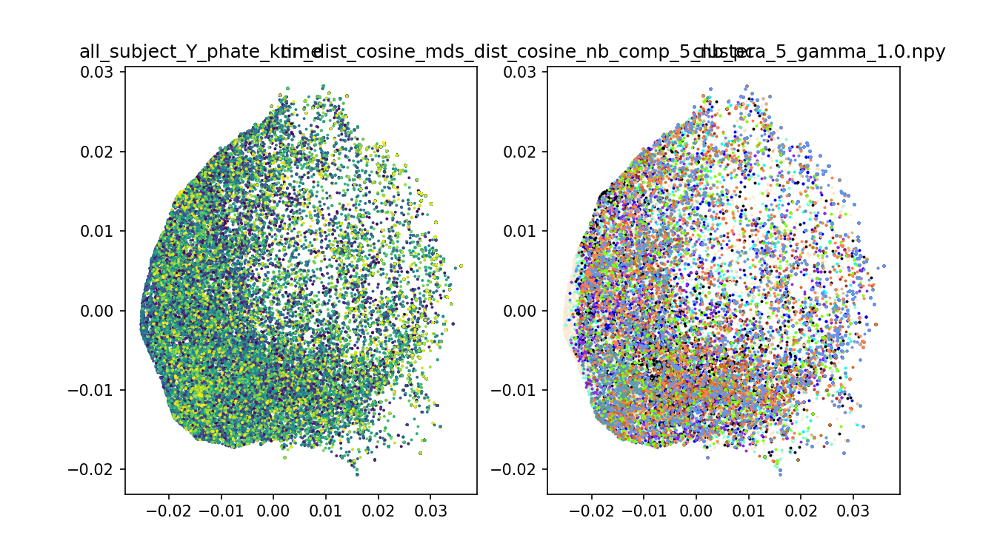

In [47]:
knn_dist = 'cosine'
mds_dist = 'cosine'
knn_dist_name=knn_dist
nb_cluster= 5
for n_components in range(2,6):
    for n_pca in [5]:
        for gamma in [-1.0,0.0,1.0]:
            file = "all_subject_Y_phate_knn_dist_"+knn_dist_name+"_mds_dist_"+mds_dist+"_nb_comp_"+str(n_components)+"_nb_pca_"+str(n_pca)+"_gamma_"+str(gamma)+".npy"
            data=np.load(file)
            plot_figure_2D(data,file,KMeans(n_clusters=nb_cluster, random_state=123).fit_predict(data))
            plot_figure_2D_patient(data,file,avalanches_sum)